# Tentang DATA

In [ ]:
!pip install mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mne #library untuk pemrosesan sinyal elektroensefalografi (EEG)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 53.7 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/TA

Mounted at /content/drive
/content/drive/MyDrive/TA


# DATA 1 (chb05_13)

In [ ]:
file1 = "/content/drive/MyDrive/TA/EDF/chb05_13.edf"
data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data
data1

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-4-eba94003e4ce>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data1 = mne.io.read_raw_edf(file1) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_13.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data1.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data1.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df1 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df1['Time'] = times  # Menambahkan kolom waktu
df1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,-3.965812e-05,-5.333333e-05,-4.942613e-05,1.013919e-04,-1.631258e-04,-7.833944e-05,-9.572650e-06,6.505495e-05,-4.395604e-05,...,-5.294261e-05,2.910867e-05,-1.334310e-04,-6.700855e-05,5.372405e-05,-5.958486e-05,-8.849817e-05,3.614164e-05,-5.294261e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.758242e-06,-9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,0.015625


In [ ]:
channels = data1.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df1.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
df1.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.044600e-07,1.803487e-07,2.022360e-07,1.632228e-07,2.267632e-07,1.934452e-07,1.775438e-07,1.523916e-07,2.114876e-07,1.937458e-07,...,1.865940e-07,1.822425e-07,2.034726e-07,1.977662e-07,1.884844e-07,1.803822e-07,1.860267e-07,2.018972e-07,1.865940e-07,1799.998047
std,6.868818e-05,9.157041e-05,6.960559e-05,7.611238e-05,7.891207e-05,9.157680e-05,6.233631e-05,7.236429e-05,7.617723e-05,7.449498e-05,...,7.343264e-05,6.901959e-05,7.562751e-05,5.978743e-05,6.960559e-05,6.419684e-05,8.457167e-05,5.332798e-05,7.343264e-05,1039.231048
min,-1.046545e-03,-9.441758e-04,-1.148132e-03,-1.011380e-03,-1.082882e-03,-1.286838e-03,-1.422027e-03,-1.647082e-03,-1.212210e-03,-1.055922e-03,...,-1.309109e-03,-1.418901e-03,-9.047131e-04,-9.027595e-04,-1.135238e-03,-7.519414e-04,-1.333724e-03,-8.984615e-04,-1.309109e-03,0.000000
25%,-3.340659e-05,-4.864469e-05,-3.457875e-05,-4.004884e-05,-4.161172e-05,-4.434676e-05,-2.832723e-05,-3.496947e-05,-3.028083e-05,-2.754579e-05,...,-2.637363e-05,-2.598291e-05,-3.418803e-05,-2.871795e-05,-3.418803e-05,-3.301587e-05,-3.965812e-05,-1.973138e-05,-2.637363e-05,899.999023
50%,1.953602e-07,9.768010e-07,1.953602e-07,1.367521e-06,-9.768010e-07,5.860806e-07,5.860806e-07,2.148962e-06,-1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.262515e-05,4.903541e-05,3.457875e-05,4.278388e-05,4.004884e-05,4.630037e-05,2.949939e-05,3.731380e-05,3.028083e-05,2.832723e-05,...,2.754579e-05,2.715507e-05,3.496947e-05,2.949939e-05,3.496947e-05,3.418803e-05,4.122100e-05,2.012210e-05,2.754579e-05,2699.997070
max,1.035604e-03,1.161807e-03,1.135629e-03,9.613675e-04,8.414164e-04,1.312234e-03,1.682247e-03,1.403272e-03,1.333333e-03,1.204396e-03,...,1.471258e-03,1.375140e-03,1.048889e-03,8.429792e-04,1.148523e-03,7.519414e-04,1.328254e-03,9.773871e-04,1.471258e-03,3599.996094


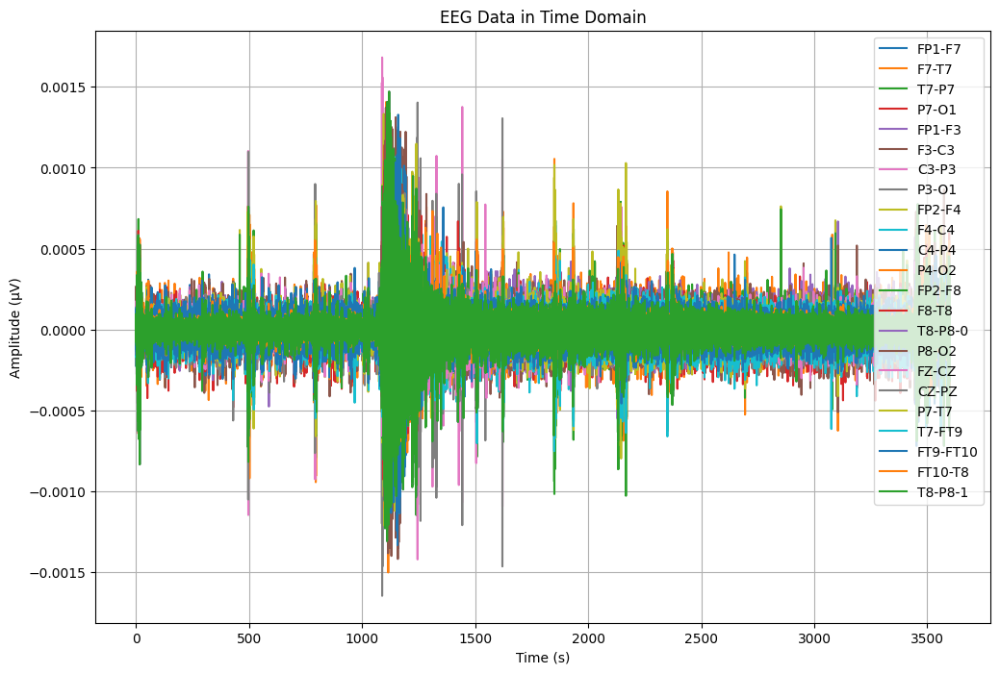

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df1['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

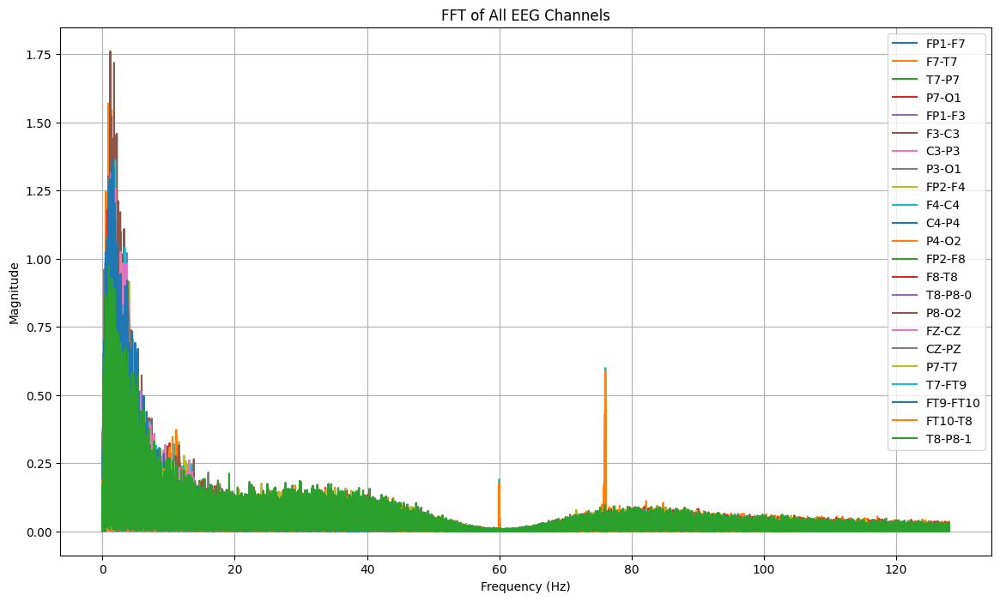

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv"
df1.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv


In [ ]:
dataTA1 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_13.csv")
dataTA1

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,-3.965812e-05,-5.333333e-05,-4.942613e-05,1.013919e-04,-1.631258e-04,-7.833944e-05,-9.572650e-06,6.505495e-05,-4.395604e-05,...,-5.294261e-05,2.910867e-05,-1.334310e-04,-6.700855e-05,5.372405e-05,-5.958486e-05,-8.849817e-05,3.614164e-05,-5.294261e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.758242e-06,-9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-6.661783e-05,6.192918e-05,-7.599512e-05,5.294261e-05,-4.395604e-05,9.572650e-06,3.321123e-06,3.711844e-06,-7.794872e-05,1.758242e-06,...,4.708181e-05,3.145299e-05,6.349206e-05,-4.043956e-05,7.638584e-05,-3.965812e-05,9.768010e-07,-3.536020e-05,4.708181e-05,3599.980469
921596,-6.935287e-05,7.638584e-05,-1.314774e-04,9.162393e-05,-5.020757e-05,4.493284e-06,7.619048e-06,5.665446e-06,-7.794872e-05,-2.539683e-06,...,1.973138e-05,3.028083e-05,6.349206e-05,-3.965812e-05,1.318681e-04,-4.200244e-05,2.148962e-06,-2.246642e-05,1.973138e-05,3599.984375
921597,-7.443223e-05,-4.884005e-06,-8.771673e-05,1.349939e-04,-5.606838e-05,1.953602e-07,9.181929e-06,1.387057e-05,-7.404151e-05,-5.665446e-06,...,5.333333e-05,3.809524e-05,6.153846e-05,-3.496947e-05,8.810745e-05,2.910867e-05,5.274725e-06,-5.411477e-05,5.333333e-05,3599.988281
921598,-7.169719e-05,-2.090354e-05,-7.619048e-06,6.818071e-05,-5.411477e-05,1.367521e-06,1.308913e-05,6.056166e-06,-6.935287e-05,-2.539683e-06,...,5.255189e-05,5.333333e-05,5.919414e-05,-3.848596e-05,8.009768e-06,3.575092e-05,-1.953602e-07,-5.411477e-05,5.255189e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: F3-C3, Max Frequency: 1.19 Hz, Magnitude: 1.761195, Time: 1148.261719 s
Channel: F7-T7, Max Frequency: 0.90 Hz, Magnitude: 1.569781, Time: 1193.691406 s
Channel: FP1-F3, Max Frequency: 1.78 Hz, Magnitude: 1.488424, Time: 1165.964844 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: FT9-FT10, Max Frequency: 1.47 Hz, Magnitude: 1.361519, Time: 1156.460938 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.246094 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: T7-P7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: P7-T7, Max Frequency: 1.25 Hz, Magnitude: 1.205981, Time: 1239.550781 s
Channel: T7-FT9, Max Freq

In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA1[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA1[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz


# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA1[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.42 Hz, Magnitude: 1.003392, Time: 1088.500000 s
Channel: P3-O1, Max Frequency: 0.97 Hz, Magnitude: 1.297437, Time: 1088.500000 s
Channel: FP2-F4, Max Frequency: 1.67 Hz, Magnitude: 1.208834, Time: 1095.398438 s
Channel: P4-O2, Max Frequency: 1.42 Hz, Magnitude: 1.119024, Time: 1115.199219 s
Channel: T8-P8-0, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: T8-P8-1, Max Frequency: 0.98 Hz, Magnitude: 0.975898, Time: 1119.421875 s
Channel: FZ-CZ, Max Frequency: 1.25 Hz, Magnitude: 1.316148, Time: 1122.058594 s
Channel: F4-C4, Max Frequency: 1.94 Hz, Magnitude: 1.361550, Time: 1122.894531 s
Channel: F8-T8, Max Frequency: 1.38 Hz, Magnitude: 1.084825, Time: 1123.195312 s
Channel: FT10-T8, Max Frequency: 1.15 Hz, Magnitude: 0.770020, Time: 1123.199219 s
Channel: P7-O1, Max Frequency: 1.93 Hz, Magnitude: 1.329667, Time: 1139.24

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 966   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1316    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut = dataTA1.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_13.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA1 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_13.csv")
TA1.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000003,0.000061,-0.000005,-0.000032,-1.621490e-05,0.000047,8.791209e-06,-0.000013,0.000021,0.000060,...,-0.000010,-1.367521e-06,0.000051,1.934066e-05,5.665446e-06,-0.000008,-8.009768e-06,-7.228327e-06,-0.000010,966.000000
1,0.000006,0.000050,0.000001,-0.000032,-1.035409e-05,0.000044,4.102564e-06,-0.000012,0.000026,0.000046,...,-0.000013,9.768010e-07,0.000045,1.738706e-05,-9.768010e-07,-0.000015,-2.148962e-06,-3.321123e-06,-0.000013,966.003906
2,0.000005,0.000041,0.000009,-0.000034,-9.768010e-07,0.000038,1.953602e-07,-0.000015,0.000037,0.000032,...,-0.000011,-3.711844e-06,0.000035,1.074481e-05,-8.400488e-06,-0.000027,1.953602e-07,1.191697e-05,-0.000011,966.007812
3,0.000003,0.000032,0.000016,-0.000035,5.274725e-06,0.000030,-5.860806e-07,-0.000018,0.000044,0.000021,...,-0.000010,-1.191697e-05,0.000028,-1.953602e-07,-1.543346e-05,-0.000012,2.539683e-06,4.884005e-06,-0.000010,966.011719
4,-0.000003,0.000022,0.000025,-0.000029,8.400488e-06,0.000021,-5.860806e-07,-0.000014,0.000051,0.000007,...,-0.000004,-9.963370e-06,0.000024,-6.446886e-06,-2.442002e-05,-0.000002,8.009768e-06,-9.768010e-07,-0.000004,966.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA1.shape

(89600, 24)

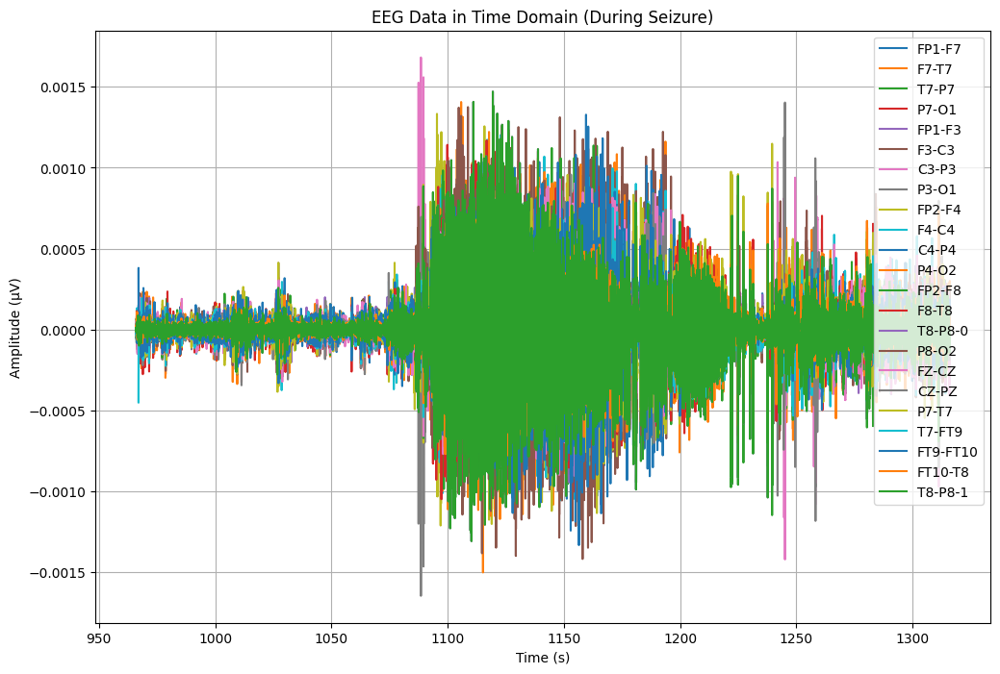

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA1['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA1.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA1[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


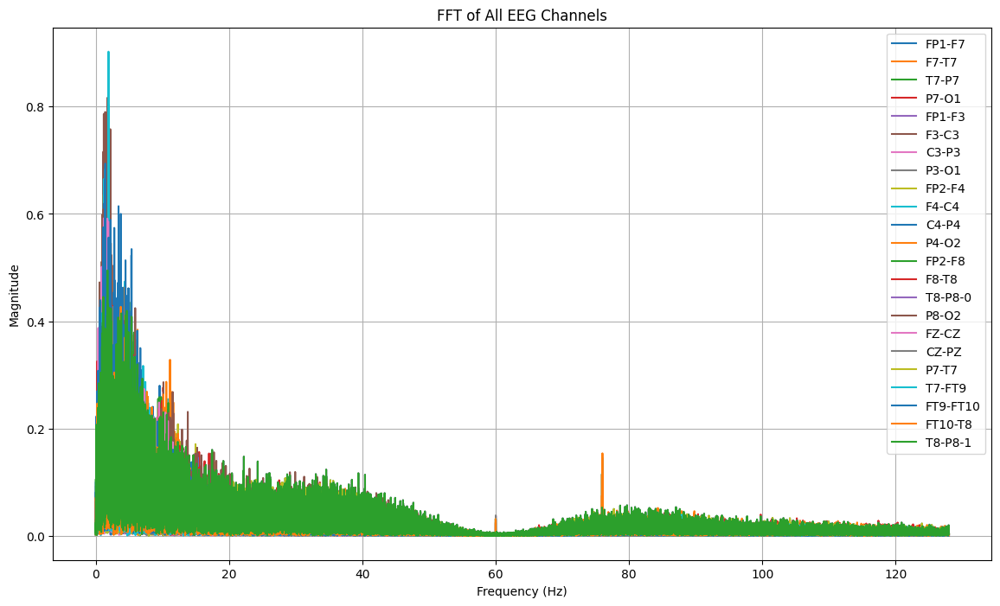

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA1[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1086:
        return "tidak kejang"
    elif 1086 <= row['Time'] < 1196:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_1 = TA1.copy()
TA_1['seizure'] = TA_1.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_1[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  966.000000  tidak kejang  0.000003  0.000061 -0.000005 -0.000032   
1  966.003906  tidak kejang  0.000006  0.000050  0.000001 -0.000032   
2  966.007812  tidak kejang  0.000005  0.000041  0.000009 -0.000034   
3  966.011719  tidak kejang  0.000003  0.000032  0.000016 -0.000035   
4  966.015625  tidak kejang -0.000003  0.000022  0.000025 -0.000029   

         FP1-F3     F3-C3         C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -1.621490e-05  0.000047  8.791209e-06 -0.000013  ...  0.000022 -0.000010   
1 -1.035409e-05  0.000044  4.102564e-06 -0.000012  ...  0.000014 -0.000013   
2 -9.768010e-07  0.000038  1.953602e-07 -0.000015  ...  0.000011 -0.000011   
3  5.274725e-06  0.000030 -5.860806e-07 -0.000018  ...  0.000008 -0.000010   
4  8.400488e-06  0.000021 -5.860806e-07 -0.000014  ...  0.000003 -0.000004   

          P8-O2     FZ-CZ         CZ-PZ         P7-T7    T7-FT9      FT9-FT10  \
0 -1.367521e-06  0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_1['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,28160


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_1)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 350.0 detik


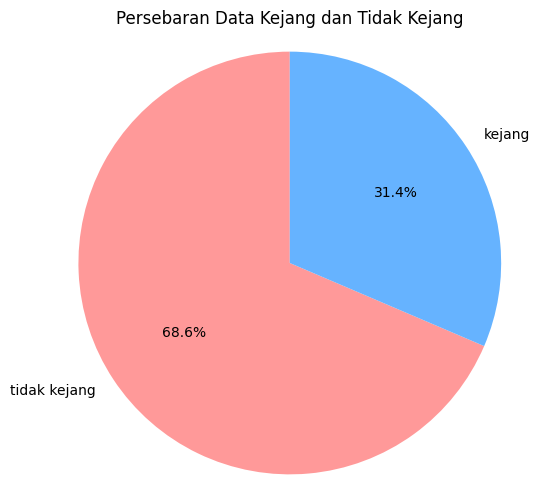

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_1['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_1.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb05_13.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.93      0.95      5666
tidak kejang       0.97      0.99      0.98     12254

    accuracy                           0.97     17920
   macro avg       0.98      0.96      0.97     17920
weighted avg       0.97      0.97      0.97     17920

Akurasi: 0.9722098214285714
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.93      0.95      5666
tidak kejang       0.97      0.99      0.98     12254

    accuracy                           0.97     17920
   macro avg       0.98      0.96      0.97     17920
weighted avg       0.97      0.97      0.97     17920



# DATA 2 (chb05_16)

In [ ]:
# mengimport file edf
file2 = "/content/drive/MyDrive/TA/EDF/chb05_16.edf"
data2 = mne.io.read_raw_edf(file2) # membaca file edf dan menyimpannya di data
data2


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_16.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-28-f98efcf54b85>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data2 = mne.io.read_raw_edf(file2) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_16.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data2.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data2.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data2.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df2 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df2['Time'] = times  # Menambahkan kolom waktu
df2.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.295238e-04,-6.153846e-05,-1.660562e-05,-3.770452e-05,3.965812e-05,-3.184371e-05,-5.665446e-06,1.152625e-05,6.974359e-05,-5.020757e-05,...,8.791209e-06,3.379731e-05,-5.997558e-05,1.504274e-05,1.699634e-05,2.402930e-05,-1.010012e-04,-2.148962e-06,8.791209e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.758242e-06,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df2.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df2.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.147733e-07,1.973337e-07,1.806743e-07,1.641780e-07,2.197505e-07,1.903371e-07,2.000653e-07,1.633344e-07,1.945106e-07,2.022211e-07,...,1.833617e-07,1.888796e-07,2.048051e-07,1.922437e-07,2.100461e-07,1.867097e-07,1.748296e-07,2.068368e-07,1.833617e-07,1799.998047
std,8.331571e-05,9.427935e-05,6.947073e-05,8.151265e-05,8.547155e-05,9.779073e-05,7.600458e-05,8.847979e-05,7.283248e-05,6.937179e-05,...,6.908791e-05,6.404262e-05,7.621358e-05,5.559944e-05,6.947073e-05,6.815813e-05,9.869685e-05,5.005606e-05,6.908791e-05,1039.231048
min,-1.390379e-03,-1.422808e-03,-1.234481e-03,-1.438437e-03,-1.269255e-03,-1.585348e-03,-1.341148e-03,-1.337631e-03,-1.175482e-03,-1.342711e-03,...,-1.331380e-03,-1.629890e-03,-1.365372e-03,-1.082491e-03,-1.122344e-03,-9.387057e-04,-1.154383e-03,-7.527228e-04,-1.331380e-03,0.000000
25%,-3.731380e-05,-4.864469e-05,-3.496947e-05,-4.239316e-05,-4.122100e-05,-4.590965e-05,-2.989011e-05,-3.926740e-05,-2.871795e-05,-2.598291e-05,...,-2.637363e-05,-2.637363e-05,-3.301587e-05,-2.598291e-05,-3.536020e-05,-3.614164e-05,-4.434676e-05,-2.051282e-05,-2.637363e-05,899.999023
50%,-5.860806e-07,1.953602e-07,1.953602e-07,1.367521e-06,-5.860806e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.614164e-05,4.942613e-05,3.575092e-05,4.473748e-05,3.965812e-05,4.747253e-05,3.067155e-05,4.122100e-05,2.871795e-05,2.637363e-05,...,2.715507e-05,2.676435e-05,3.340659e-05,2.676435e-05,3.536020e-05,3.614164e-05,4.669109e-05,2.051282e-05,2.715507e-05,2699.997070
max,1.465788e-03,1.438046e-03,1.122735e-03,1.210647e-03,1.234872e-03,1.517753e-03,1.452112e-03,1.763516e-03,1.209866e-03,1.307937e-03,...,1.254017e-03,1.340757e-03,1.444689e-03,8.636874e-04,1.234872e-03,8.601709e-04,1.450159e-03,8.195360e-04,1.254017e-03,3599.996094


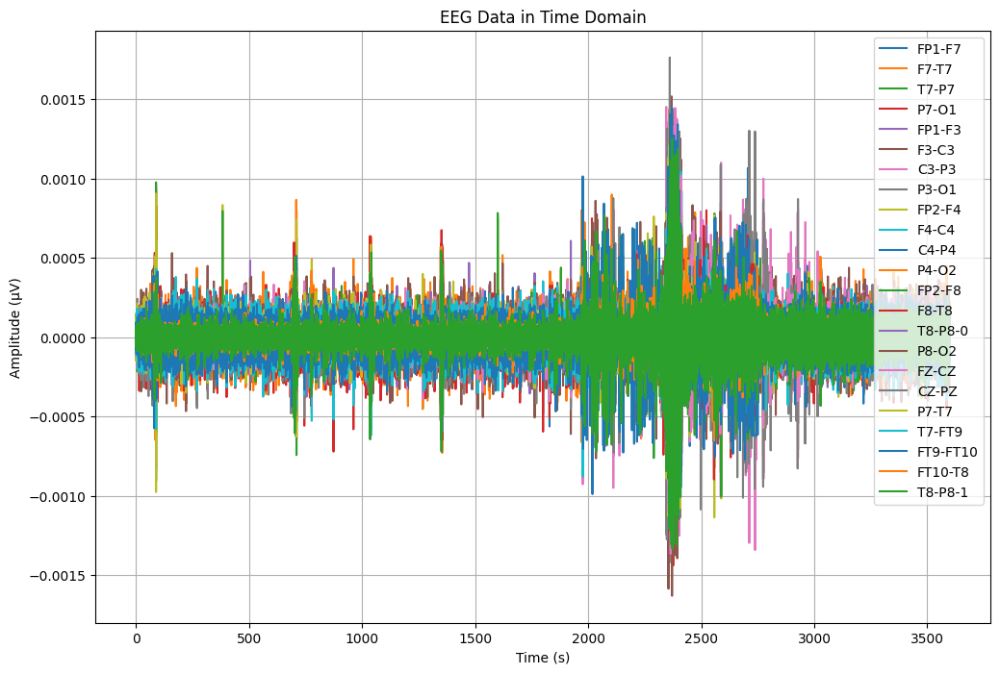

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df2['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df2[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


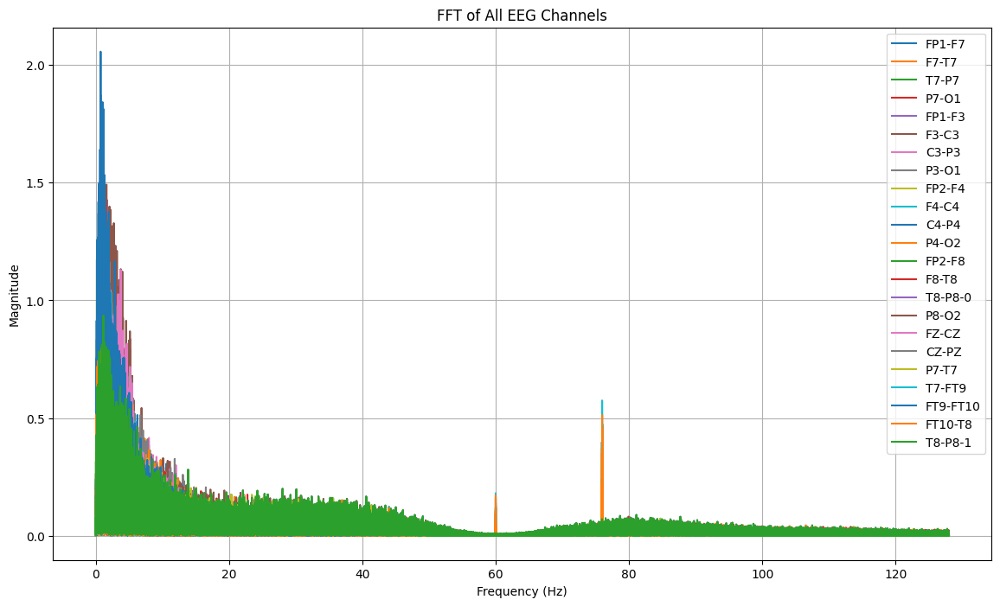

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df2[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv"
df2.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv


In [ ]:
#Import Data CSV
dataTA2 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_16.csv")
dataTA2


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.295238e-04,-6.153846e-05,-1.660562e-05,-3.770452e-05,3.965812e-05,-3.184371e-05,-5.665446e-06,1.152625e-05,6.974359e-05,-5.020757e-05,...,8.791209e-06,3.379731e-05,-5.997558e-05,1.504274e-05,1.699634e-05,2.402930e-05,-1.010012e-04,-2.148962e-06,8.791209e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,0.011719
4,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.758242e-06,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-4.747253e-05,4.004884e-05,5.665446e-06,-5.137973e-05,6.349206e-05,2.832723e-05,9.181929e-06,-1.557021e-04,4.669109e-05,7.873016e-05,...,6.837607e-06,-8.498168e-05,2.832723e-05,-8.810745e-05,-5.274725e-06,-5.098901e-05,5.684982e-05,1.738706e-05,6.837607e-06,3599.980469
921596,-4.942613e-05,2.949939e-05,1.191697e-05,-5.567766e-05,7.091575e-05,1.973138e-05,9.768010e-07,-1.564835e-04,4.473748e-05,7.638584e-05,...,1.269841e-05,-8.420024e-05,2.598291e-05,-9.240537e-05,-1.152625e-05,-3.379731e-05,5.802198e-05,5.860806e-07,1.269841e-05,3599.984375
921597,-4.981685e-05,2.168498e-05,1.582418e-05,-5.841270e-05,7.912088e-05,1.269841e-05,-5.665446e-06,-1.580464e-04,4.161172e-05,7.794872e-05,...,1.738706e-05,-8.302808e-05,2.285714e-05,-9.045177e-05,-1.543346e-05,-4.434676e-05,6.075702e-05,1.308913e-05,1.738706e-05,3599.988281
921598,-4.551893e-05,1.347985e-05,2.129426e-05,-6.310134e-05,8.849817e-05,8.400488e-06,-1.504274e-05,-1.572650e-04,4.278388e-05,7.990232e-05,...,2.324786e-05,-8.224664e-05,2.168498e-05,-9.435897e-05,-2.090354e-05,-4.356532e-05,6.192918e-05,1.894994e-05,2.324786e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA2[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA2[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA2[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data2, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.74 Hz, Magnitude: 2.056949, Time: 2370.316406 s
Channel: F3-C3, Max Frequency: 1.62 Hz, Magnitude: 1.492192, Time: 2355.171875 s
Channel: FP1-F3, Max Frequency: 1.72 Hz, Magnitude: 1.426072, Time: 2387.539062 s
Channel: F7-T7, Max Frequency: 1.23 Hz, Magnitude: 1.416079, Time: 2359.757812 s
Channel: FP1-F7, Max Frequency: 0.78 Hz, Magnitude: 1.411653, Time: 2369.507812 s
Channel: P7-O1, Max Frequency: 1.58 Hz, Magnitude: 1.351388, Time: 2375.929688 s
Channel: FP2-F8, Max Frequency: 1.00 Hz, Magnitude: 1.341561, Time: 2379.664062 s
Channel: P3-O1, Max Frequency: 1.16 Hz, Magnitude: 1.304284, Time: 2360.917969 s
Channel: P7-T7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976562 s
Channel: T7-P7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976562 s
Channel: C3-P3, Max Frequency: 1.19 Hz, Magnitude: 1.283451, Time: 2345.421875 s
Channel: FZ-CZ, Max Freq

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.19 Hz, Magnitude: 1.283451, Time: 2345.421875 s
Channel: F3-C3, Max Frequency: 1.62 Hz, Magnitude: 1.492192, Time: 2355.171875 s
Channel: FP2-F4, Max Frequency: 1.05 Hz, Magnitude: 1.105651, Time: 2358.261719 s
Channel: F7-T7, Max Frequency: 1.23 Hz, Magnitude: 1.416079, Time: 2359.757812 s
Channel: P3-O1, Max Frequency: 1.16 Hz, Magnitude: 1.304284, Time: 2360.917969 s
Channel: F8-T8, Max Frequency: 0.77 Hz, Magnitude: 1.101666, Time: 2366.562500 s
Channel: FP1-F7, Max Frequency: 0.78 Hz, Magnitude: 1.411653, Time: 2369.507812 s
Channel: T7-FT9, Max Frequency: 1.04 Hz, Magnitude: 1.122467, Time: 2370.296875 s
Channel: FT9-FT10, Max Frequency: 0.74 Hz, Magnitude: 2.056949, Time: 2370.316406 s
Channel: P8-O2, Max Frequency: 0.48 Hz, Magnitude: 0.794810, Time: 2370.898438 s
Channel: T7-P7, Max Frequency: 1.07 Hz, Magnitude: 1.294956, Time: 2371.976

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2197   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2533    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut = dataTA2.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_16.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA2 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_16.csv")
TA2.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000056,0.000019,0.000060,-0.000024,0.000047,0.000022,0.000069,-0.000028,0.000035,0.000028,...,0.000010,0.000046,2.539683e-06,-0.000005,-0.000059,1.504274e-05,-0.000127,0.000046,0.000010,2197.000000
1,0.000059,0.000003,0.000059,-0.000021,0.000050,0.000021,0.000067,-0.000038,0.000031,0.000032,...,0.000011,0.000049,5.860806e-07,-0.000003,-0.000059,9.768010e-07,-0.000151,0.000077,0.000011,2197.003906
2,0.000059,-0.000013,0.000059,-0.000025,0.000044,0.000023,0.000062,-0.000052,0.000028,0.000034,...,0.000010,0.000047,-9.768010e-07,-0.000008,-0.000058,8.009768e-06,-0.000179,0.000097,0.000010,2197.007812
3,0.000058,-0.000018,0.000045,-0.000026,0.000036,0.000025,0.000060,-0.000063,0.000017,0.000035,...,-0.000007,0.000046,5.860806e-07,-0.000010,-0.000045,1.660562e-05,-0.000206,0.000120,-0.000007,2197.011719
4,0.000053,-0.000017,0.000025,-0.000021,0.000028,0.000022,0.000061,-0.000073,0.000004,0.000030,...,0.000007,0.000047,9.768010e-07,-0.000008,-0.000024,-2.148962e-06,-0.000226,0.000126,0.000007,2197.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA2.shape

(86016, 24)

In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA2)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 336.0 detik


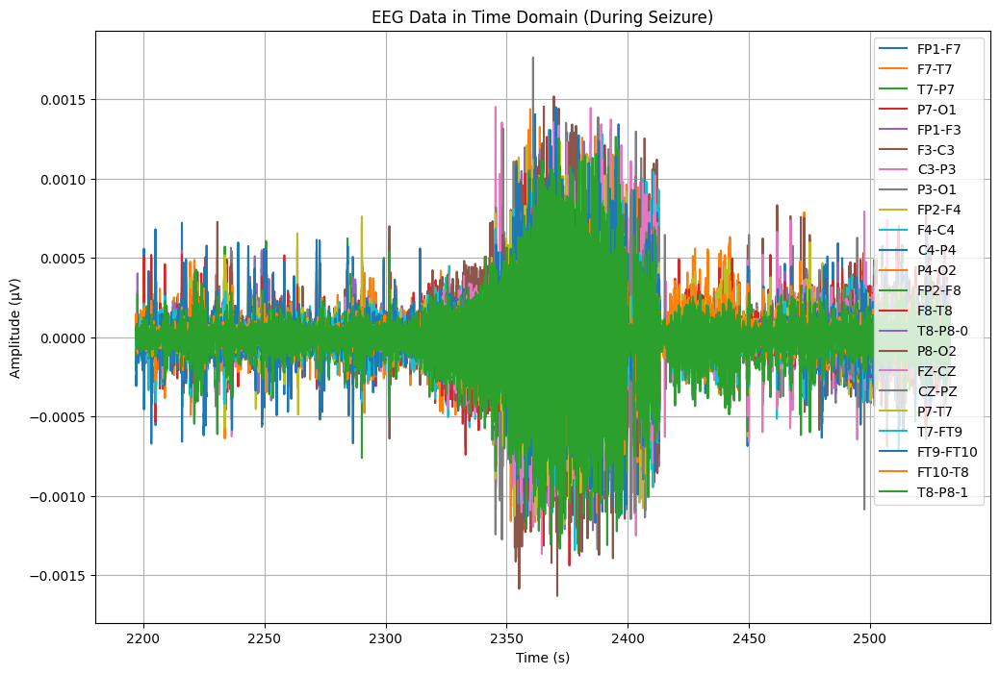

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA2['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA2.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA2[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


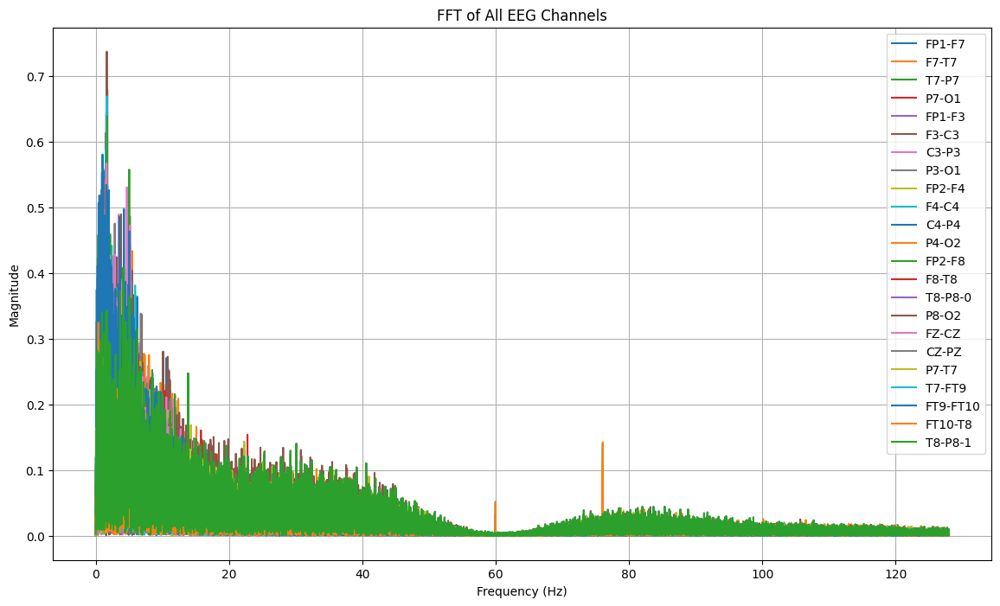

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA2[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2317:
        return "tidak kejang"
    elif 2317 <= row['Time'] < 2413:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_2 = TA2.copy()
TA_2['seizure'] = TA_2.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_2[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2197.000000  tidak kejang  0.000056  0.000019  0.000060 -0.000024   
1  2197.003906  tidak kejang  0.000059  0.000003  0.000059 -0.000021   
2  2197.007812  tidak kejang  0.000059 -0.000013  0.000059 -0.000025   
3  2197.011719  tidak kejang  0.000058 -0.000018  0.000045 -0.000026   
4  2197.015625  tidak kejang  0.000053 -0.000017  0.000025 -0.000021   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000047  0.000022  0.000069 -0.000028  ...  0.000059  0.000010  0.000046   
1  0.000050  0.000021  0.000067 -0.000038  ...  0.000070  0.000011  0.000049   
2  0.000044  0.000023  0.000062 -0.000052  ...  0.000078  0.000010  0.000047   
3  0.000036  0.000025  0.000060 -0.000063  ...  0.000096 -0.000007  0.000046   
4  0.000028  0.000022  0.000061 -0.000073  ...  0.000081  0.000007  0.000047   

          FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10   FT10-T8  \
0  2.539683e-

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_2['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,24576


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_2)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 336.0 detik


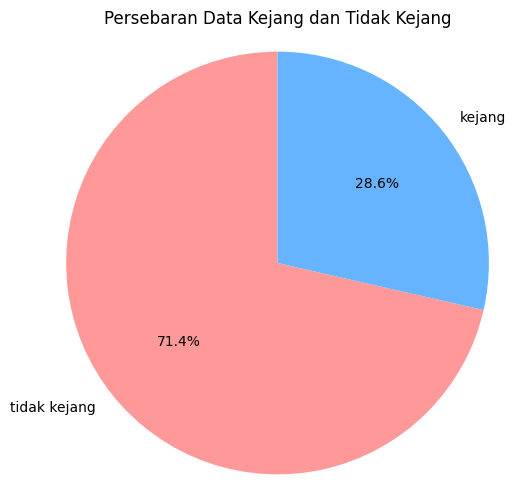

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_2['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_2.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb05_16.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_2.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_2['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.92      0.95      4949
tidak kejang       0.97      1.00      0.98     12255

    accuracy                           0.97     17204
   macro avg       0.98      0.96      0.97     17204
weighted avg       0.97      0.97      0.97     17204

Akurasi: 0.9740757963264357
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.92      0.95      4949
tidak kejang       0.97      1.00      0.98     12255

    accuracy                           0.97     17204
   macro avg       0.98      0.96      0.97     17204
weighted avg       0.97      0.97      0.97     17204



# DATA 3 (chb05_17)

In [ ]:
# mengimport file edf
file3 = "/content/drive/MyDrive/TA/EDF/chb05_17.edf"
data3 = mne.io.read_raw_edf(file3) # membaca file edf dan menyimpannya di data
data3


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_17.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-52-6fb3f9dd50c1>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data3 = mne.io.read_raw_edf(file3) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_17.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data3.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data3.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data3.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df3 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df3['Time'] = times  # Menambahkan kolom waktu
df3.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.489621e-05,5.665446e-06,1.465201e-05,5.294261e-05,-2.150916e-04,1.963370e-04,-1.017827e-04,1.389011e-04,2.385348e-04,1.308913e-05,...,2.520147e-05,-2.402930e-05,-4.278388e-05,2.129426e-05,-1.426129e-05,-1.025641e-04,9.357753e-05,6.036630e-05,2.520147e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-5.860806e-07,9.768010e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df3.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df3.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.047424e-07,2.057709e-07,1.746672e-07,1.357885e-07,2.185830e-07,1.711496e-07,1.982529e-07,1.562097e-07,1.936207e-07,1.890784e-07,...,1.636833e-07,1.884141e-07,1.905478e-07,1.894922e-07,2.160532e-07,1.654775e-07,1.911808e-07,2.156445e-07,1.636833e-07,1799.998047
std,8.538011e-05,9.432272e-05,7.291423e-05,7.774539e-05,8.557387e-05,9.124290e-05,7.942061e-05,8.731339e-05,7.501448e-05,6.897427e-05,...,7.486569e-05,6.422872e-05,7.365610e-05,5.401147e-05,7.291423e-05,6.692400e-05,9.454810e-05,5.147112e-05,7.486569e-05,1039.231048
min,-1.487668e-03,-1.080537e-03,-1.419292e-03,-1.302466e-03,-1.391160e-03,-1.373578e-03,-1.321612e-03,-1.632234e-03,-1.344664e-03,-1.193846e-03,...,-1.390379e-03,-1.311453e-03,-1.186813e-03,-9.586325e-04,-1.289963e-03,-1.075849e-03,-1.221587e-03,-8.183639e-04,-1.390379e-03,0.000000
25%,-3.731380e-05,-5.098901e-05,-3.575092e-05,-4.083028e-05,-4.317460e-05,-4.590965e-05,-3.106227e-05,-3.614164e-05,-3.262515e-05,-2.949939e-05,...,-3.145299e-05,-2.832723e-05,-3.536020e-05,-2.793651e-05,-3.614164e-05,-3.457875e-05,-4.512821e-05,-2.246642e-05,-3.145299e-05,899.999023
50%,-1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,-5.860806e-07,9.768010e-07,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,3.692308e-05,5.137973e-05,3.653236e-05,4.356532e-05,4.278388e-05,4.708181e-05,3.145299e-05,3.848596e-05,3.223443e-05,2.989011e-05,...,3.301587e-05,2.871795e-05,3.575092e-05,2.871795e-05,3.614164e-05,3.653236e-05,4.551893e-05,2.207570e-05,3.301587e-05,2699.997070
max,1.289573e-03,1.465397e-03,1.290354e-03,1.188767e-03,1.148132e-03,1.458364e-03,1.497436e-03,1.302857e-03,1.257924e-03,1.410696e-03,...,1.551355e-03,1.259096e-03,1.427106e-03,7.449084e-04,1.419683e-03,8.629060e-04,1.469304e-03,8.488400e-04,1.551355e-03,3599.996094


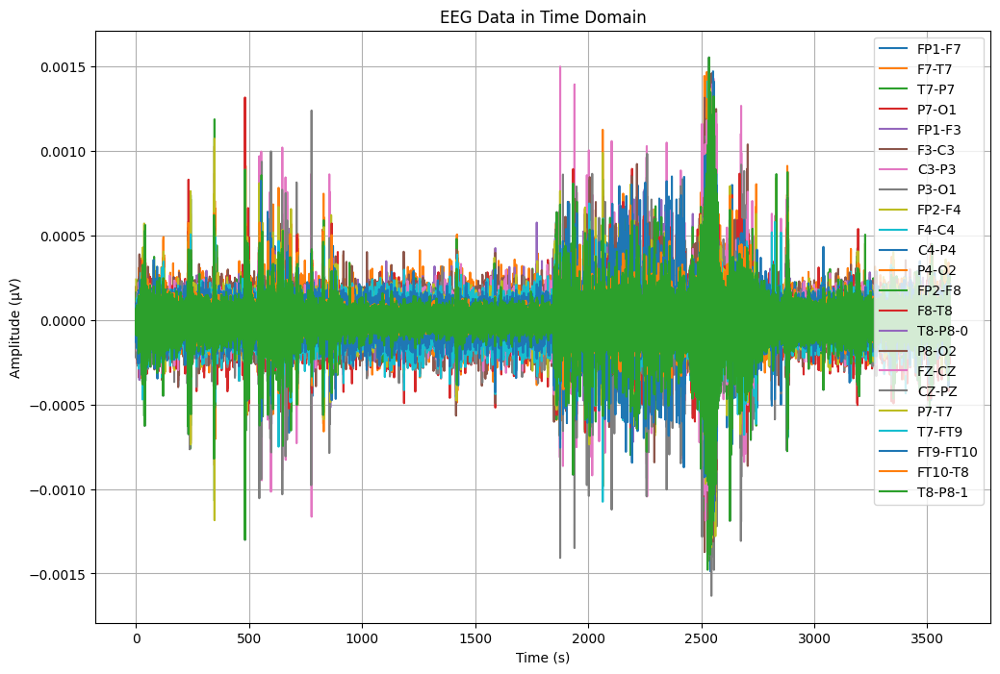

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df3['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df3[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


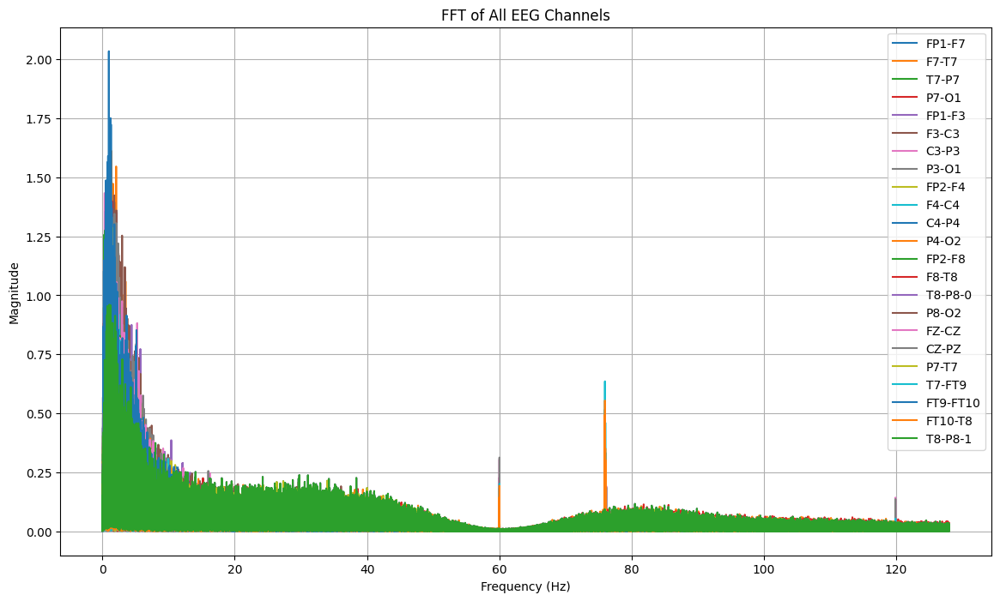

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df3[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv"
df3.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv


In [ ]:
#Import Data CSV
dataTA3 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_17.csv")
dataTA3


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.489621e-05,5.665446e-06,1.465201e-05,5.294261e-05,-2.150916e-04,1.963370e-04,-1.017827e-04,1.389011e-04,2.385348e-04,1.308913e-05,...,2.520147e-05,-2.402930e-05,-4.278388e-05,2.129426e-05,-1.426129e-05,-1.025641e-04,9.357753e-05,6.036630e-05,2.520147e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-5.860806e-07,9.768010e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.832723e-05,9.181929e-06,6.446886e-06,-2.832723e-05,-3.223443e-05,5.255189e-05,-1.504274e-05,1.113553e-05,2.793651e-05,5.098901e-05,...,-3.457875e-05,3.301587e-05,2.129426e-05,-4.004884e-05,-6.056166e-06,1.953602e-07,8.400488e-06,-1.191697e-05,-3.457875e-05,3599.980469
921596,2.402930e-05,1.934066e-05,-6.056166e-06,-3.145299e-05,-3.223443e-05,4.903541e-05,-1.347985e-05,2.930403e-06,3.340659e-05,4.200244e-05,...,-5.958486e-05,2.637363e-05,1.504274e-05,-4.473748e-05,6.446886e-06,-4.884005e-06,1.738706e-05,1.758242e-06,-5.958486e-05,3599.984375
921597,1.660562e-05,-2.148962e-06,6.837607e-06,-2.715507e-05,-3.731380e-05,4.239316e-05,-1.465201e-05,4.493284e-06,3.692308e-05,4.122100e-05,...,-3.223443e-05,1.973138e-05,1.621490e-05,-4.864469e-05,-6.446886e-06,2.637363e-05,2.051282e-05,-3.145299e-05,-3.223443e-05,3599.988281
921598,1.230769e-05,-1.426129e-05,6.837607e-06,-1.582418e-05,-3.457875e-05,3.496947e-05,-1.582418e-05,5.274725e-06,4.161172e-05,3.536020e-05,...,-1.738706e-05,2.871795e-05,1.582418e-05,-4.786325e-05,-6.446886e-06,2.285714e-05,2.090354e-05,-3.692308e-05,-1.738706e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA3[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA3[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA3[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data1, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 2.034359, Time: 2552.613281 s
Channel: F7-T7, Max Frequency: 1.33 Hz, Magnitude: 1.612365, Time: 2525.171875 s
Channel: P7-O1, Max Frequency: 1.23 Hz, Magnitude: 1.476835, Time: 2539.363281 s
Channel: C3-P3, Max Frequency: 0.33 Hz, Magnitude: 1.433202, Time: 1876.148438 s
Channel: F3-C3, Max Frequency: 1.76 Hz, Magnitude: 1.423620, Time: 2546.742188 s
Channel: FP1-F7, Max Frequency: 1.32 Hz, Magnitude: 1.379596, Time: 2541.363281 s
Channel: FP1-F3, Max Frequency: 2.17 Hz, Magnitude: 1.351633, Time: 2539.757812 s
Channel: P3-O1, Max Frequency: 1.81 Hz, Magnitude: 1.345232, Time: 2545.164062 s
Channel: FP2-F4, Max Frequency: 1.46 Hz, Magnitude: 1.286753, Time: 2544.828125 s
Channel: FP2-F8, Max Frequency: 0.41 Hz, Magnitude: 1.275725, Time: 2528.382812 s
Channel: FZ-CZ, Max Frequency: 1.76 Hz, Magnitude: 1.269166, Time: 2554.394531 s
Channel: F8-T8, Max Fre

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F8-T8, Max Frequency: 1.00 Hz, Magnitude: 1.196004, Time: 481.675781 s
Channel: C3-P3, Max Frequency: 0.33 Hz, Magnitude: 1.433202, Time: 1876.148438 s
Channel: T7-FT9, Max Frequency: 1.19 Hz, Magnitude: 1.110401, Time: 2064.250000 s
Channel: F7-T7, Max Frequency: 1.33 Hz, Magnitude: 1.612365, Time: 2525.171875 s
Channel: FP2-F8, Max Frequency: 0.41 Hz, Magnitude: 1.275725, Time: 2528.382812 s
Channel: F4-C4, Max Frequency: 1.39 Hz, Magnitude: 1.016439, Time: 2528.664062 s
Channel: P4-O2, Max Frequency: 1.47 Hz, Magnitude: 0.949000, Time: 2529.328125 s
Channel: T7-P7, Max Frequency: 2.01 Hz, Magnitude: 1.050341, Time: 2534.210938 s
Channel: P7-T7, Max Frequency: 2.01 Hz, Magnitude: 1.050341, Time: 2534.210938 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.960444, Time: 2534.644531 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.960444, Time: 2534.6445

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2331   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2691    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut3 = dataTA3.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut3.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_17.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA3 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_17.csv")
TA3.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000053,0.000120,0.000019,-0.000075,-9.768010e-07,0.000099,0.000106,-0.000088,0.000021,0.000048,...,0.000013,-0.000045,0.000064,0.000037,-0.000019,-0.000060,-0.000078,0.000084,0.000013,2331.000000
1,0.000058,0.000139,-0.000008,-0.000069,2.539683e-06,0.000097,0.000105,-0.000083,0.000023,0.000043,...,0.000038,-0.000023,0.000059,0.000043,0.000008,-0.000094,-0.000080,0.000082,0.000038,2331.003906
2,0.000058,0.000169,-0.000025,-0.000088,1.953602e-07,0.000091,0.000096,-0.000072,0.000022,0.000040,...,0.000055,-0.000022,0.000054,0.000041,0.000026,-0.000121,-0.000084,0.000055,0.000055,2331.007812
3,0.000050,0.000113,0.000026,-0.000083,-9.963370e-06,0.000089,0.000083,-0.000055,0.000020,0.000039,...,0.000074,-0.000021,0.000053,0.000045,-0.000026,-0.000059,-0.000078,0.000027,0.000074,2331.011719
4,0.000044,0.000081,0.000039,-0.000080,-1.738706e-05,0.000083,0.000078,-0.000057,0.000011,0.000035,...,0.000059,-0.000019,0.000047,0.000047,-0.000039,-0.000046,-0.000075,0.000035,0.000059,2331.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA3.shape


(92160, 24)

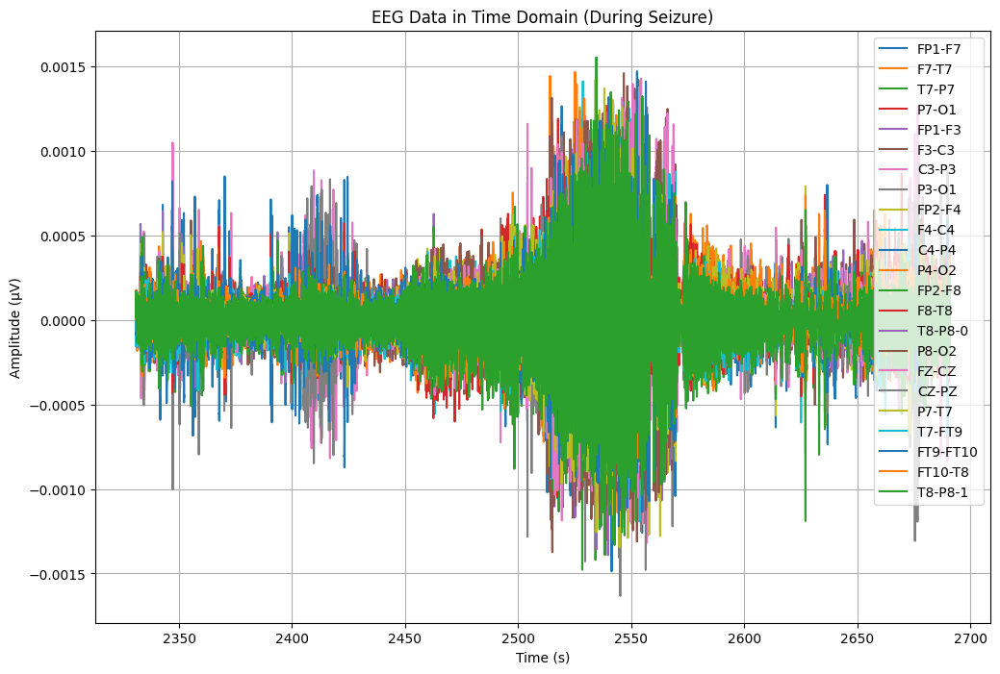

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA3['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA3.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA3[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


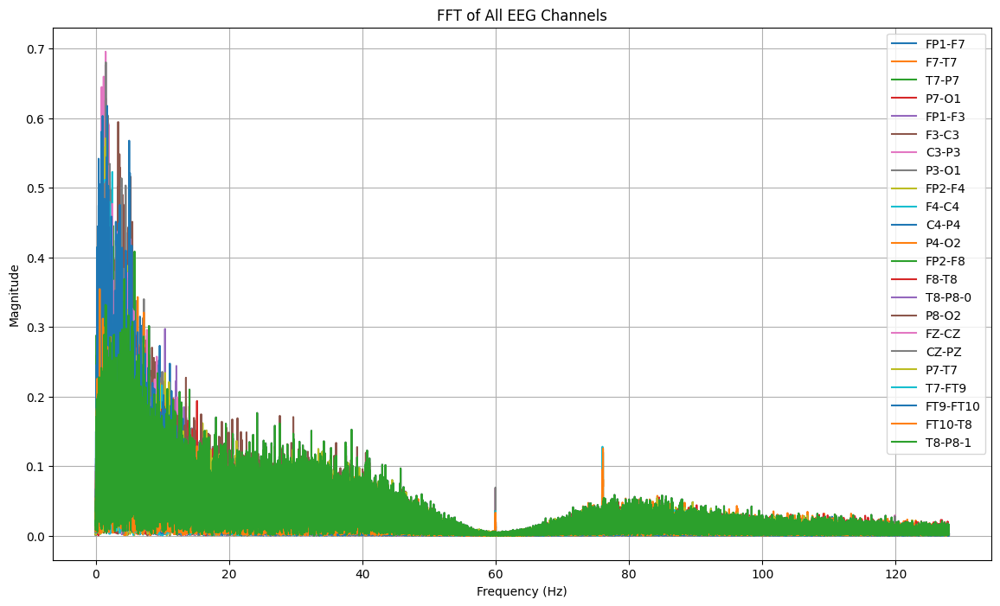

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA3[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2451:
        return "tidak kejang"
    elif 2451 <= row['Time'] < 2571:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_3 = TA3.copy()
TA_3['seizure'] = TA_3.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_3[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2331.000000  tidak kejang  0.000053  0.000120  0.000019 -0.000075   
1  2331.003906  tidak kejang  0.000058  0.000139 -0.000008 -0.000069   
2  2331.007812  tidak kejang  0.000058  0.000169 -0.000025 -0.000088   
3  2331.011719  tidak kejang  0.000050  0.000113  0.000026 -0.000083   
4  2331.015625  tidak kejang  0.000044  0.000081  0.000039 -0.000080   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -9.768010e-07  0.000099  0.000106 -0.000088  ...  0.000133  0.000013   
1  2.539683e-06  0.000097  0.000105 -0.000083  ...  0.000114  0.000038   
2  1.953602e-07  0.000091  0.000096 -0.000072  ...  0.000087  0.000055   
3 -9.963370e-06  0.000089  0.000083 -0.000055  ...  0.000069  0.000074   
4 -1.738706e-05  0.000083  0.000078 -0.000057  ...  0.000062  0.000059   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0 -0.000045  0.000064  0.000037 -0.000019 -0.00

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_3['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,30720


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_3)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 360.0 detik


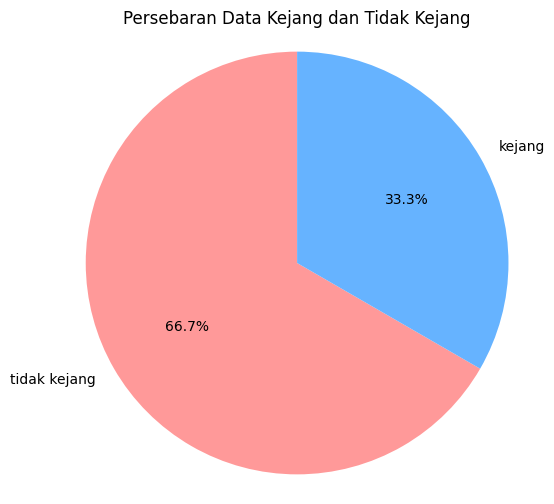

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_3['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_3.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb05_17.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_1.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_1['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.93      0.95      5666
tidak kejang       0.97      0.99      0.98     12254

    accuracy                           0.97     17920
   macro avg       0.98      0.96      0.97     17920
weighted avg       0.97      0.97      0.97     17920

Akurasi: 0.9722098214285714
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.93      0.95      5666
tidak kejang       0.97      0.99      0.98     12254

    accuracy                           0.97     17920
   macro avg       0.98      0.96      0.97     17920
weighted avg       0.97      0.97      0.97     17920



# DATA 4 (chb05_22)

In [ ]:
# mengimport file edf
file4 = "/content/drive/MyDrive/TA/EDF/chb05_22.edf"
data4 = mne.io.read_raw_edf(file4) # membaca file edf dan menyimpannya di data
data4


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_22.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-4-54e038bb07ed>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data4 = mne.io.read_raw_edf(file4) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_22.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data4.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data4.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data4.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df4 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df4['Time'] = times  # Menambahkan kolom waktu
df4.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,2.559219e-05,-1.777778e-05,1.699634e-05,-7.521368e-05,1.230769e-05,-9.982906e-05,9.592186e-05,-5.880342e-05,-6.075702e-05,6.700855e-05,...,1.582418e-05,7.912088e-05,9.768010e-07,5.958486e-05,-1.660562e-05,3.711844e-06,-3.338706e-04,7.286935e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-9.768010e-07,9.768010e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.758242e-06,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df4.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df4.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.026663e-07,1.981392e-07,1.581612e-07,1.883814e-07,2.272207e-07,1.657823e-07,1.940124e-07,1.689060e-07,2.302350e-07,1.572823e-07,...,1.696064e-07,1.897012e-07,1.618390e-07,1.818838e-07,2.325592e-07,1.569678e-07,2.224418e-07,2.279910e-07,1.696064e-07,1799.998047
std,1.073628e-04,1.145983e-04,8.602412e-05,9.235884e-05,1.038931e-04,1.179088e-04,6.501976e-05,8.064252e-05,9.079373e-05,8.931952e-05,...,9.065014e-05,7.521492e-05,9.129845e-05,6.210484e-05,8.602412e-05,8.344717e-05,1.124880e-04,6.196082e-05,9.065014e-05,1039.231048
min,-1.468913e-03,-1.316142e-03,-1.239170e-03,-9.465201e-04,-1.302857e-03,-1.398193e-03,-8.519658e-04,-1.009426e-03,-9.008059e-04,-1.214945e-03,...,-1.132503e-03,-8.488400e-04,-1.378657e-03,-8.660317e-04,-1.086007e-03,-1.010989e-03,-9.840293e-04,-6.913797e-04,-1.132503e-03,0.000000
25%,-5.177045e-05,-6.349206e-05,-4.395604e-05,-5.294261e-05,-5.567766e-05,-6.192918e-05,-3.614164e-05,-4.630037e-05,-4.669109e-05,-4.161172e-05,...,-4.590965e-05,-3.926740e-05,-4.630037e-05,-3.145299e-05,-4.630037e-05,-4.590965e-05,-5.841270e-05,-3.106227e-05,-4.590965e-05,899.999023
50%,1.953602e-07,1.953602e-07,9.768010e-07,5.860806e-07,-1.758242e-06,2.539683e-06,1.953602e-07,1.367521e-06,-1.367521e-06,1.367521e-06,...,5.860806e-07,5.860806e-07,1.758242e-06,5.860806e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,-5.860806e-07,5.860806e-07,1799.998047
75%,5.059829e-05,6.388278e-05,4.669109e-05,5.411477e-05,5.372405e-05,6.466422e-05,3.692308e-05,4.786325e-05,4.356532e-05,4.395604e-05,...,4.669109e-05,3.965812e-05,4.903541e-05,3.223443e-05,4.434676e-05,4.747253e-05,5.724054e-05,2.949939e-05,4.669109e-05,2699.997070
max,1.315360e-03,1.340757e-03,1.086398e-03,1.011380e-03,1.170403e-03,1.606447e-03,7.116972e-04,1.168059e-03,1.252845e-03,1.518535e-03,...,1.126252e-03,9.148718e-04,1.451722e-03,8.859585e-04,1.239560e-03,1.049280e-03,1.020757e-03,1.074286e-03,1.126252e-03,3599.996094


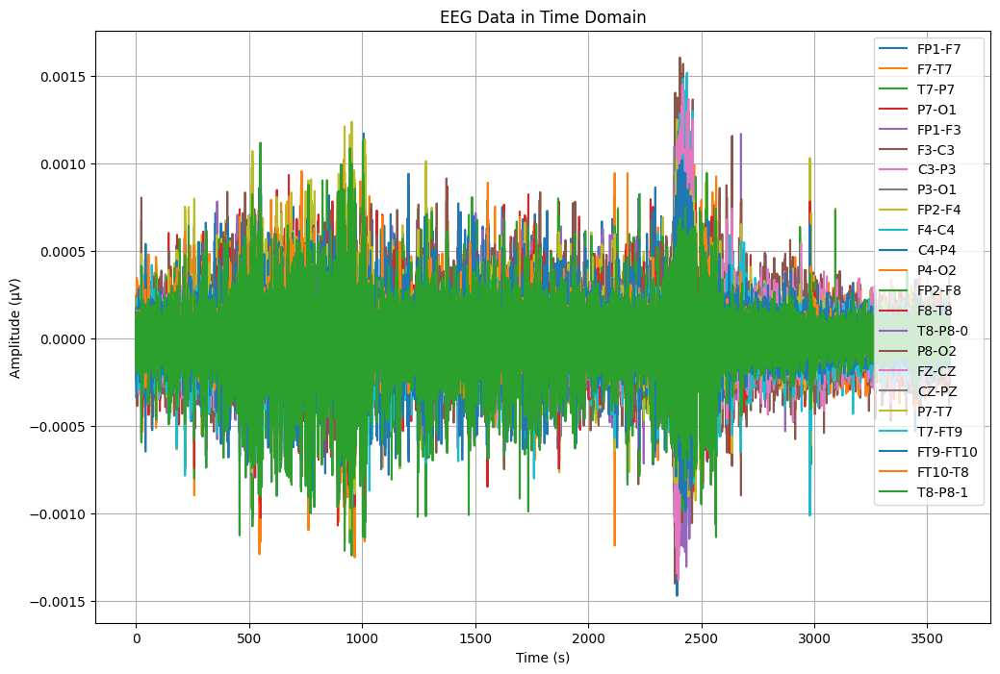

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df4['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df4[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


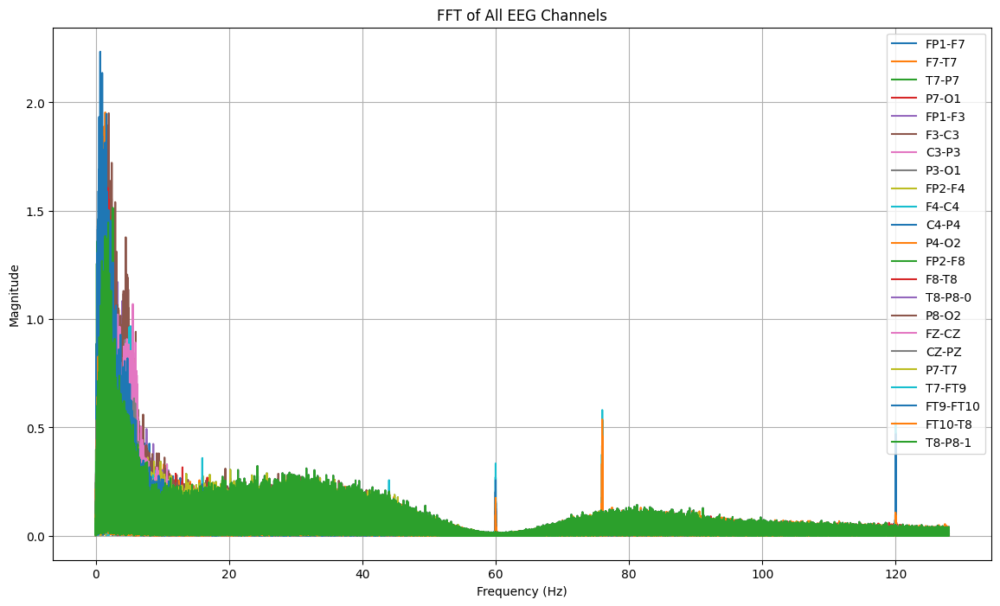

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df4[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv"
df4.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv


In [ ]:
#Import Data CSV
dataTA4 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_22.csv")
dataTA4

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,2.559219e-05,-1.777778e-05,1.699634e-05,-7.521368e-05,1.230769e-05,-9.982906e-05,9.592186e-05,-5.880342e-05,-6.075702e-05,6.700855e-05,...,1.582418e-05,7.912088e-05,9.768010e-07,5.958486e-05,-1.660562e-05,3.711844e-06,-3.338706e-04,7.286935e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-5.860806e-07,-9.768010e-07,9.768010e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.758242e-06,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.809524e-05,-7.208791e-05,2.930403e-06,6.544567e-05,1.465201e-05,-6.153846e-05,-2.285714e-05,2.793651e-05,3.926740e-05,9.768010e-07,...,1.855922e-05,-2.520147e-05,-8.263736e-05,-5.860806e-07,-2.539683e-06,5.059829e-05,5.958486e-05,2.930403e-06,1.855922e-05,3599.980469
921596,-4.122100e-05,-7.013431e-05,3.711844e-06,6.661783e-05,1.191697e-05,-6.583639e-05,-1.582418e-05,2.910867e-05,3.965812e-05,1.953602e-07,...,2.481074e-05,-1.621490e-05,-7.755800e-05,2.148962e-06,-3.321123e-06,7.013431e-05,4.551893e-05,-1.035409e-05,2.481074e-05,3599.984375
921597,-4.864469e-05,-6.700855e-05,3.321123e-06,7.013431e-05,3.711844e-06,-6.700855e-05,-1.113553e-05,3.262515e-05,4.043956e-05,9.768010e-07,...,2.910867e-05,-1.816850e-05,-7.091575e-05,9.963370e-06,-2.930403e-06,7.404151e-05,4.590965e-05,-1.035409e-05,2.910867e-05,3599.988281
921598,-5.059829e-05,-6.114774e-05,3.711844e-06,7.208791e-05,9.768010e-07,-6.192918e-05,-3.711844e-06,2.989011e-05,4.317460e-05,2.539683e-06,...,3.262515e-05,-1.230769e-05,-6.896215e-05,2.012210e-05,-3.321123e-06,6.192918e-05,4.043956e-05,3.321123e-06,3.262515e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA4[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA4[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA4[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data4, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.68 Hz, Magnitude: 2.234297, Time: 2414.652344 s
Channel: F7-T7, Max Frequency: 1.43 Hz, Magnitude: 1.954128, Time: 2415.195312 s
Channel: F3-C3, Max Frequency: 1.96 Hz, Magnitude: 1.950264, Time: 2405.835938 s
Channel: FP1-F7, Max Frequency: 0.86 Hz, Magnitude: 1.689892, Time: 2393.363281 s
Channel: FP1-F3, Max Frequency: 1.92 Hz, Magnitude: 1.654394, Time: 2434.503906 s
Channel: F8-T8, Max Frequency: 1.34 Hz, Magnitude: 1.634592, Time: 2392.808594 s
Channel: F4-C4, Max Frequency: 1.47 Hz, Magnitude: 1.611405, Time: 2436.789062 s
Channel: FZ-CZ, Max Frequency: 1.47 Hz, Magnitude: 1.595905, Time: 2416.230469 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.593170, Time: 2399.457031 s
Channel: FP2-F4, Max Frequency: 0.74 Hz, Magnitude: 1.464458, Time: 2392.785156 s
Channel: T8-P8-0, Max Frequency: 1.88 Hz, Magnitude: 1.446066, Time: 2565.691406 s
Channel: T8-P8-1, Max

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-P7, Max Frequency: 1.29 Hz, Magnitude: 1.258311, Time: 953.695312 s
Channel: P7-T7, Max Frequency: 1.29 Hz, Magnitude: 1.258311, Time: 953.695312 s
Channel: FT10-T8, Max Frequency: 0.67 Hz, Magnitude: 0.898744, Time: 1003.132812 s
Channel: P8-O2, Max Frequency: 1.97 Hz, Magnitude: 1.074100, Time: 1372.953125 s
Channel: P3-O1, Max Frequency: 1.60 Hz, Magnitude: 1.339623, Time: 2391.660156 s
Channel: P7-O1, Max Frequency: 0.67 Hz, Magnitude: 1.418500, Time: 2391.664062 s
Channel: FP2-F4, Max Frequency: 0.74 Hz, Magnitude: 1.464458, Time: 2392.785156 s
Channel: F8-T8, Max Frequency: 1.34 Hz, Magnitude: 1.634592, Time: 2392.808594 s
Channel: FP1-F7, Max Frequency: 0.86 Hz, Magnitude: 1.689892, Time: 2393.363281 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.593170, Time: 2399.457031 s
Channel: F3-C3, Max Frequency: 1.96 Hz, Magnitude: 1.950264, Time: 2405.835938

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2228   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2585    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut4 = dataTA4.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut4.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_22.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA4 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_22.csv")
TA4.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000097,-0.000072,0.000034,0.000097,-0.000049,-0.000064,-0.000022,0.000098,-0.000034,0.000017,...,0.000077,-0.000067,-4.102564e-06,0.000032,-0.000034,0.000097,0.000038,0.000033,0.000077,2228.000000
1,-0.000096,-0.000038,0.000005,0.000102,-0.000049,-0.000063,-0.000019,0.000105,-0.000024,0.000017,...,0.000064,-0.000059,-5.860806e-07,0.000040,-0.000004,0.000060,0.000045,0.000035,0.000064,2228.003906
2,-0.000081,-0.000016,-0.000022,0.000106,-0.000042,-0.000064,-0.000015,0.000108,-0.000008,0.000026,...,0.000053,-0.000053,-2.539683e-06,0.000047,0.000023,0.000020,0.000047,0.000048,0.000053,2228.007812
3,-0.000061,-0.000051,0.000003,0.000109,-0.000028,-0.000062,-0.000014,0.000105,-0.000008,0.000044,...,0.000059,-0.000059,-1.758242e-06,0.000043,-0.000003,0.000056,0.000051,0.000036,0.000059,2228.011719
4,-0.000060,-0.000085,0.000022,0.000121,-0.000022,-0.000062,-0.000021,0.000104,-0.000012,0.000045,...,0.000056,-0.000058,1.367521e-06,0.000039,-0.000021,0.000105,0.000054,0.000017,0.000056,2228.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA4.shape

(91392, 24)

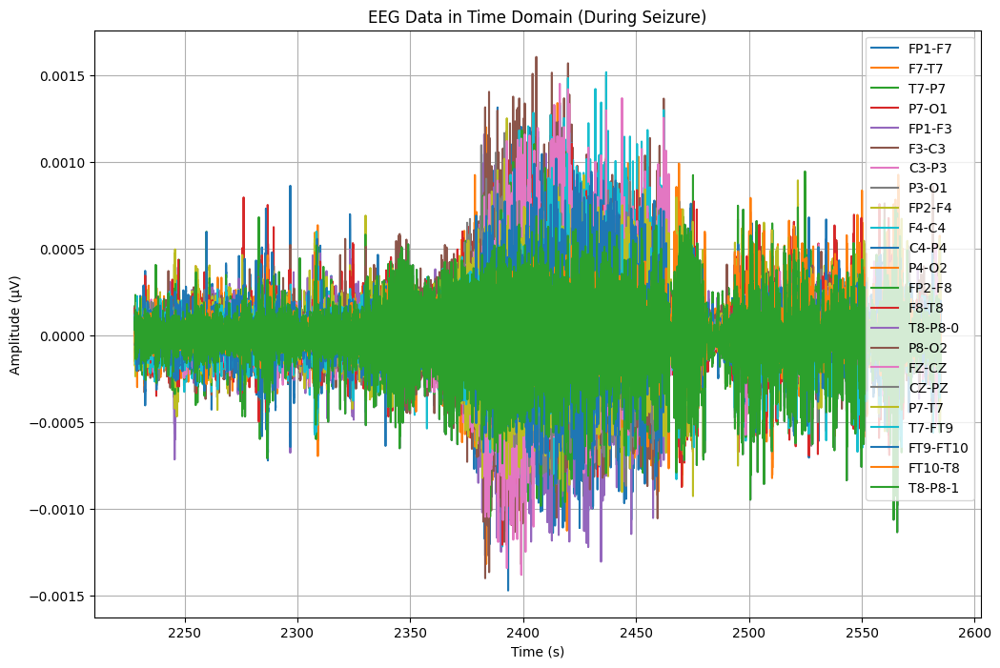

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA4['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA4.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA4[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


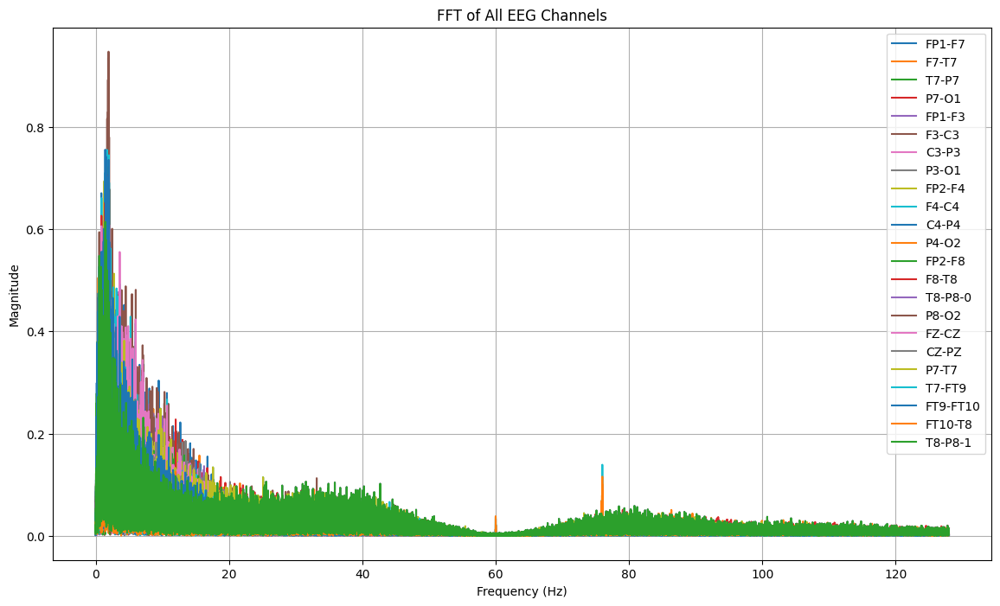

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA4[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2348:
        return "tidak kejang"
    elif 2348 <= row['Time'] < 2465:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_4 = TA4.copy()
TA_4['seizure'] = TA_4.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_4[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2228.000000  tidak kejang -0.000097 -0.000072  0.000034  0.000097   
1  2228.003906  tidak kejang -0.000096 -0.000038  0.000005  0.000102   
2  2228.007812  tidak kejang -0.000081 -0.000016 -0.000022  0.000106   
3  2228.011719  tidak kejang -0.000061 -0.000051  0.000003  0.000109   
4  2228.015625  tidak kejang -0.000060 -0.000085  0.000022  0.000121   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000049 -0.000064 -0.000022  0.000098  ...  0.000050  0.000077 -0.000067   
1 -0.000049 -0.000063 -0.000019  0.000105  ...  0.000051  0.000064 -0.000059   
2 -0.000042 -0.000064 -0.000015  0.000108  ...  0.000049  0.000053 -0.000053   
3 -0.000028 -0.000062 -0.000014  0.000105  ...  0.000040  0.000059 -0.000059   
4 -0.000022 -0.000062 -0.000021  0.000104  ...  0.000030  0.000056 -0.000058   

          FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0 -4.102

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_4['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,29952


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_4)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 357.0 detik


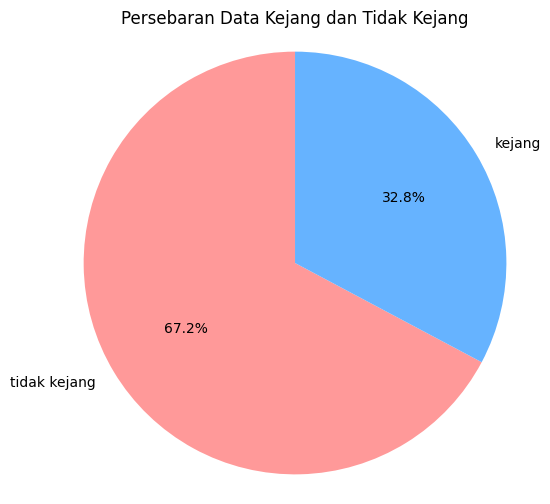

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_4['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_4.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb05_22.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_4.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_4['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.86      0.92      6119
tidak kejang       0.93      0.99      0.96     12160

    accuracy                           0.95     18279
   macro avg       0.96      0.92      0.94     18279
weighted avg       0.95      0.95      0.95     18279

Akurasi: 0.9467695169319985
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.86      0.92      6119
tidak kejang       0.93      0.99      0.96     12160

    accuracy                           0.95     18279
   macro avg       0.96      0.92      0.94     18279
weighted avg       0.95      0.95      0.95     18279



# DATA 5 (chb05_06)

In [ ]:
# mengimport file edf
file5 = "/content/drive/MyDrive/TA/EDF/chb05_06.edf"
data5 = mne.io.read_raw_edf(file5) # membaca file edf dan menyimpannya di data
data5


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb05_06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-4-4df7912b5c69>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data5 = mne.io.read_raw_edf(file5) # membaca file edf dan menyimpannya di data


<RawEDF | chb05_06.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data5.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data5.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data5.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df5 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df5['Time'] = times  # Menambahkan kolom waktu
df5.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.197558e-04,5.020757e-05,2.793651e-05,3.340659e-05,-1.127228e-04,5.665446e-06,5.372405e-05,4.512821e-05,1.894994e-05,1.387057e-05,...,-5.528694e-05,9.084249e-05,-2.148962e-06,6.974359e-05,-2.754579e-05,-9.162393e-05,1.850061e-04,-7.794872e-05,-5.528694e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.367521e-06,-1.367521e-06,5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,-2.930403e-06,1.367521e-06,5.860806e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df5.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df5.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.211958e-07,1.853030e-07,1.895532e-07,1.565981e-07,2.216528e-07,1.915904e-07,1.844466e-07,1.530856e-07,1.952830e-07,1.743344e-07,...,1.934316e-07,1.906314e-07,1.870023e-07,1.958079e-07,2.011672e-07,1.712013e-07,1.615194e-07,2.144710e-07,1.934316e-07,1799.998047
std,7.841277e-05,9.052202e-05,5.870792e-05,6.954047e-05,8.058388e-05,1.035991e-04,6.137087e-05,7.483343e-05,6.557304e-05,6.895106e-05,...,5.566048e-05,5.319267e-05,7.587799e-05,5.122940e-05,5.870792e-05,5.727516e-05,8.023936e-05,4.206899e-05,5.566048e-05,1039.231048
min,-1.191502e-03,-9.887179e-04,-9.664469e-04,-7.804640e-04,-1.265739e-03,-7.050549e-04,-1.307546e-03,-1.498999e-03,-8.160195e-04,-6.593407e-04,...,-8.406349e-04,-7.632723e-04,-8.480586e-04,-5.483761e-04,-6.984127e-04,-8.730647e-04,-1.047717e-03,-5.593162e-04,-8.406349e-04,0.000000
25%,-3.496947e-05,-4.551893e-05,-2.949939e-05,-3.653236e-05,-4.122100e-05,-4.512821e-05,-2.715507e-05,-3.536020e-05,-2.910867e-05,-2.832723e-05,...,-2.637363e-05,-2.481074e-05,-3.496947e-05,-2.637363e-05,-2.949939e-05,-2.910867e-05,-3.965812e-05,-1.934066e-05,-2.637363e-05,899.999023
50%,-1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,-5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,1799.998047
75%,3.379731e-05,4.630037e-05,2.989011e-05,3.887668e-05,4.043956e-05,4.630037e-05,2.793651e-05,3.731380e-05,2.910867e-05,2.989011e-05,...,2.676435e-05,2.559219e-05,3.575092e-05,2.676435e-05,2.989011e-05,3.028083e-05,4.122100e-05,1.934066e-05,2.676435e-05,2699.997070
max,1.323956e-03,1.288791e-03,6.988034e-04,7.960928e-04,1.012552e-03,1.799463e-03,1.572063e-03,1.102027e-03,8.492308e-04,1.502515e-03,...,7.449084e-04,7.726496e-04,1.416166e-03,7.316239e-04,9.668376e-04,5.515018e-04,8.804884e-04,7.097436e-04,7.449084e-04,3599.996094


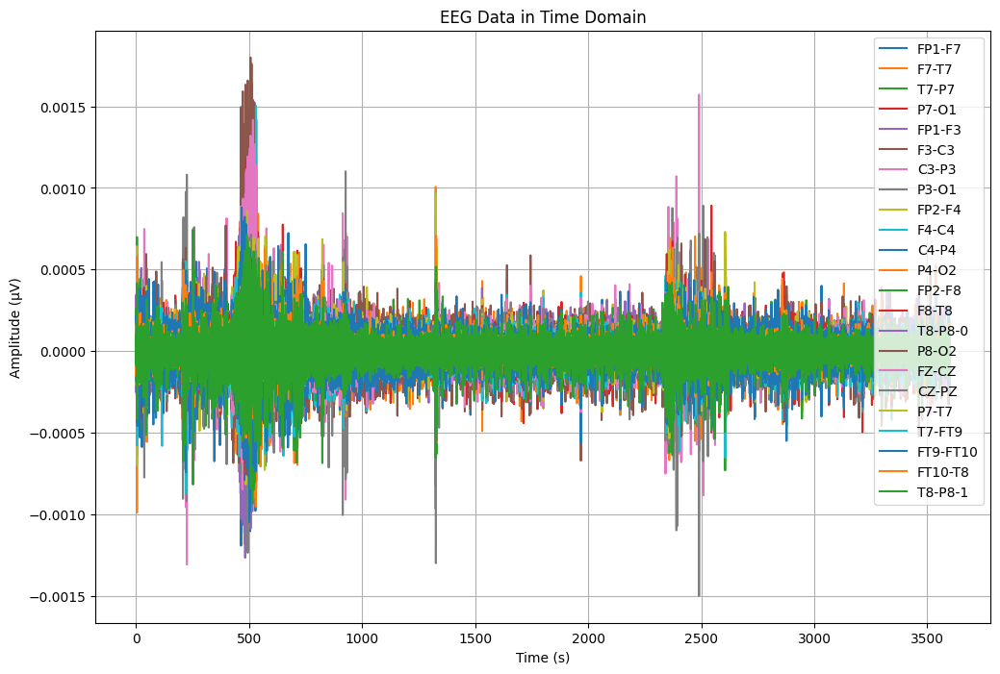

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df5['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df5[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


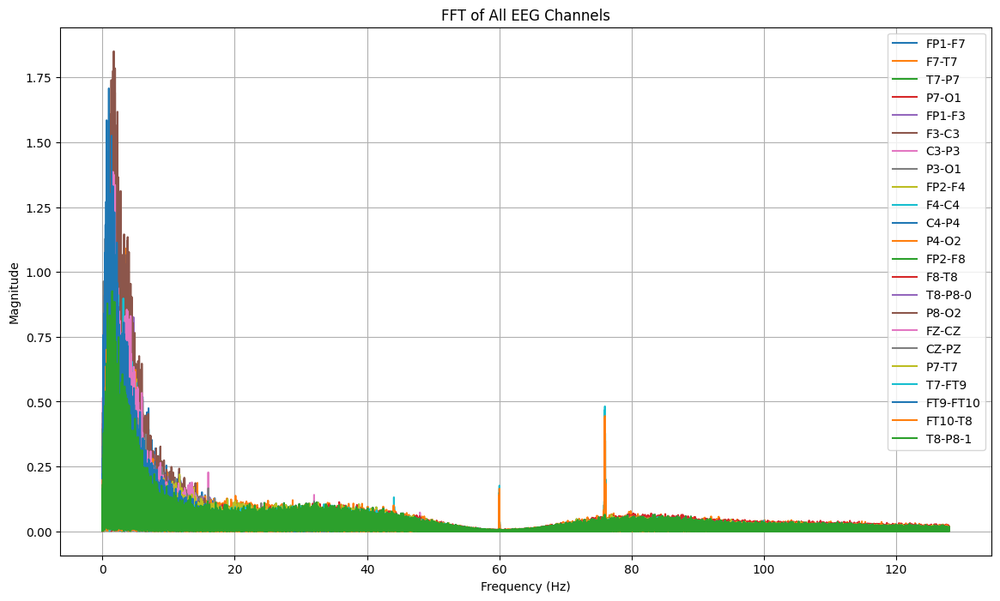

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df5[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv"
df5.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv


In [ ]:
#Import Data CSV
dataTA5 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb05_06.csv")
dataTA5


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.197558e-04,5.020757e-05,2.793651e-05,3.340659e-05,-1.127228e-04,5.665446e-06,5.372405e-05,4.512821e-05,1.894994e-05,1.387057e-05,...,-5.528694e-05,9.084249e-05,-2.148962e-06,6.974359e-05,-2.754579e-05,-9.162393e-05,1.850061e-04,-7.794872e-05,-5.528694e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.367521e-06,-1.367521e-06,5.860806e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.758242e-06,-2.930403e-06,1.367521e-06,5.860806e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,7.208791e-05,1.240537e-04,-8.400488e-06,-2.557265e-04,4.043956e-05,4.102564e-06,-9.963370e-06,-1.021734e-04,-3.809524e-05,-3.770452e-05,...,-3.379731e-05,1.758242e-06,-3.496947e-05,-5.606838e-05,8.791209e-06,-1.135043e-04,-1.361661e-04,-4.551893e-05,-3.379731e-05,3599.980469
921596,7.052503e-05,1.068620e-04,-1.426129e-05,-2.463492e-04,4.043956e-05,-1.758242e-06,-3.301587e-05,-8.888889e-05,-4.434676e-05,-3.653236e-05,...,-2.989011e-05,-6.056166e-06,-3.848596e-05,-6.075702e-05,1.465201e-05,-1.095971e-04,-1.295238e-04,-3.184371e-05,-2.989011e-05,3599.984375
921597,6.700855e-05,9.279609e-05,-2.168498e-05,-2.357998e-04,4.083028e-05,-7.619048e-06,-5.450549e-05,-7.599512e-05,-3.848596e-05,-3.340659e-05,...,-2.715507e-05,-1.855922e-05,-4.083028e-05,-7.052503e-05,2.207570e-05,-9.631258e-05,-1.232723e-04,-2.520147e-05,-2.715507e-05,3599.988281
921598,6.192918e-05,7.521368e-05,-2.910867e-05,-2.174359e-04,4.004884e-05,-1.621490e-05,-7.365079e-05,-5.802198e-05,-3.301587e-05,-3.340659e-05,...,-2.207570e-05,-2.402930e-05,-3.926740e-05,-7.990232e-05,2.949939e-05,-6.427350e-05,-1.166300e-04,-4.043956e-05,-2.207570e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA5[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA5[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA5[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data5, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: F3-C3, Max Frequency: 1.71 Hz, Magnitude: 1.851268, Time: 506.011719 s
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 1.708117, Time: 500.902344 s
Channel: F7-T7, Max Frequency: 1.34 Hz, Magnitude: 1.544761, Time: 518.628906 s
Channel: FP1-F3, Max Frequency: 1.27 Hz, Magnitude: 1.388824, Time: 482.476562 s
Channel: FZ-CZ, Max Frequency: 1.59 Hz, Magnitude: 1.385849, Time: 517.070312 s
Channel: FP1-F7, Max Frequency: 2.06 Hz, Magnitude: 1.281214, Time: 493.921875 s
Channel: P7-O1, Max Frequency: 0.93 Hz, Magnitude: 1.253924, Time: 495.101562 s
Channel: F4-C4, Max Frequency: 1.55 Hz, Magnitude: 1.236548, Time: 530.316406 s
Channel: P3-O1, Max Frequency: 1.60 Hz, Magnitude: 1.221586, Time: 2490.269531 s
Channel: FP2-F4, Max Frequency: 1.56 Hz, Magnitude: 1.211121, Time: 495.117188 s
Channel: F8-T8, Max Frequency: 1.55 Hz, Magnitude: 1.190038, Time: 487.542969 s
Channel: T7-FT9, Max Frequency: 0.

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.96 Hz, Magnitude: 1.039995, Time: 220.660156 s
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.700995, Time: 251.808594 s
Channel: CZ-PZ, Max Frequency: 1.75 Hz, Magnitude: 0.814548, Time: 480.941406 s
Channel: FP1-F3, Max Frequency: 1.27 Hz, Magnitude: 1.388824, Time: 482.476562 s
Channel: F8-T8, Max Frequency: 1.55 Hz, Magnitude: 1.190038, Time: 487.542969 s
Channel: FP2-F8, Max Frequency: 1.43 Hz, Magnitude: 0.900028, Time: 490.906250 s
Channel: FP1-F7, Max Frequency: 2.06 Hz, Magnitude: 1.281214, Time: 493.921875 s
Channel: P7-O1, Max Frequency: 0.93 Hz, Magnitude: 1.253924, Time: 495.101562 s
Channel: FP2-F4, Max Frequency: 1.56 Hz, Magnitude: 1.211121, Time: 495.117188 s
Channel: P8-O2, Max Frequency: 1.13 Hz, Magnitude: 0.906928, Time: 497.351562 s
Channel: FT9-FT10, Max Frequency: 0.97 Hz, Magnitude: 1.708117, Time: 500.902344 s
C

In [ ]:
# potong data (potong dulu datanya)
# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 297   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 654    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut5 = dataTA5.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut5.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_06.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA5 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb05_06.csv")
TA5.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.619048e-06,0.000083,0.000047,0.000062,-0.000037,0.000035,0.000058,0.000129,0.000022,-0.000056,...,0.000042,0.000026,-0.000022,0.000088,-0.000047,0.000014,0.000034,-0.000024,0.000042,297.000000
1,9.768010e-07,0.000119,0.000017,0.000054,-0.000019,0.000027,0.000062,0.000121,0.000016,-0.000060,...,0.000028,0.000020,-0.000030,0.000090,-0.000017,-0.000040,0.000029,0.000003,0.000028,297.003906
2,9.181929e-06,0.000067,0.000068,0.000040,-0.000006,0.000016,0.000068,0.000106,0.000005,-0.000062,...,0.000006,0.000006,-0.000039,0.000087,-0.000067,0.000004,0.000038,0.000012,0.000006,297.007812
3,2.207570e-05,0.000040,0.000094,0.000026,0.000010,0.000009,0.000074,0.000091,-0.000014,-0.000063,...,0.000014,-0.000006,-0.000046,0.000086,-0.000094,0.000058,0.000016,-0.000013,0.000014,297.011719
4,3.028083e-05,0.000036,0.000095,0.000020,0.000027,0.000003,0.000076,0.000076,-0.000030,-0.000060,...,0.000017,-0.000012,-0.000052,0.000084,-0.000095,0.000044,0.000019,-0.000013,0.000017,297.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA5.shape

(91392, 24)

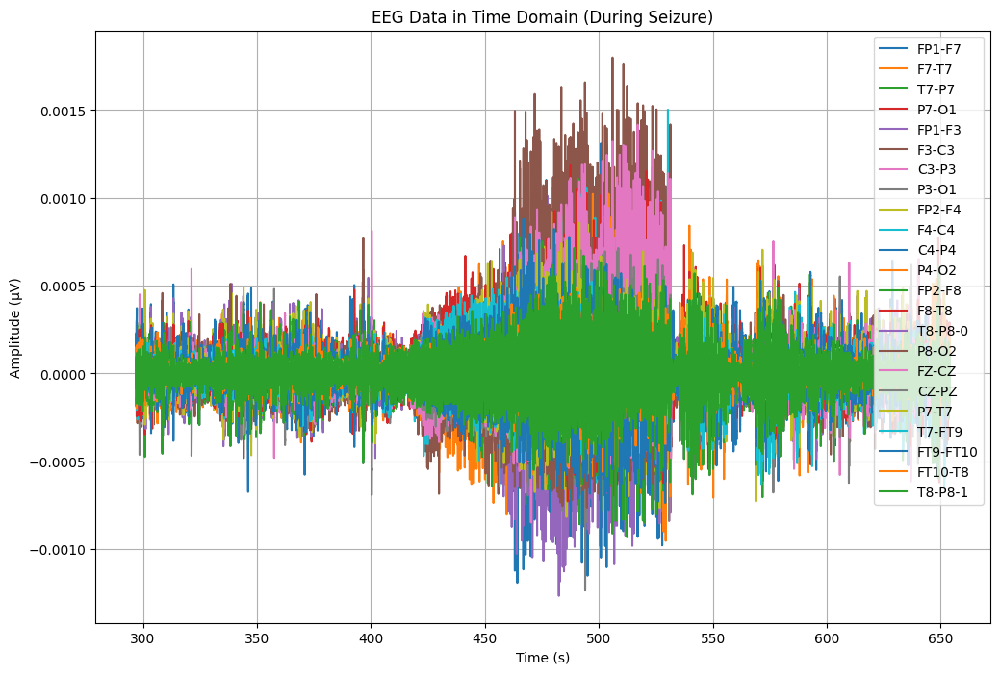

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA5['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA5.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA5[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


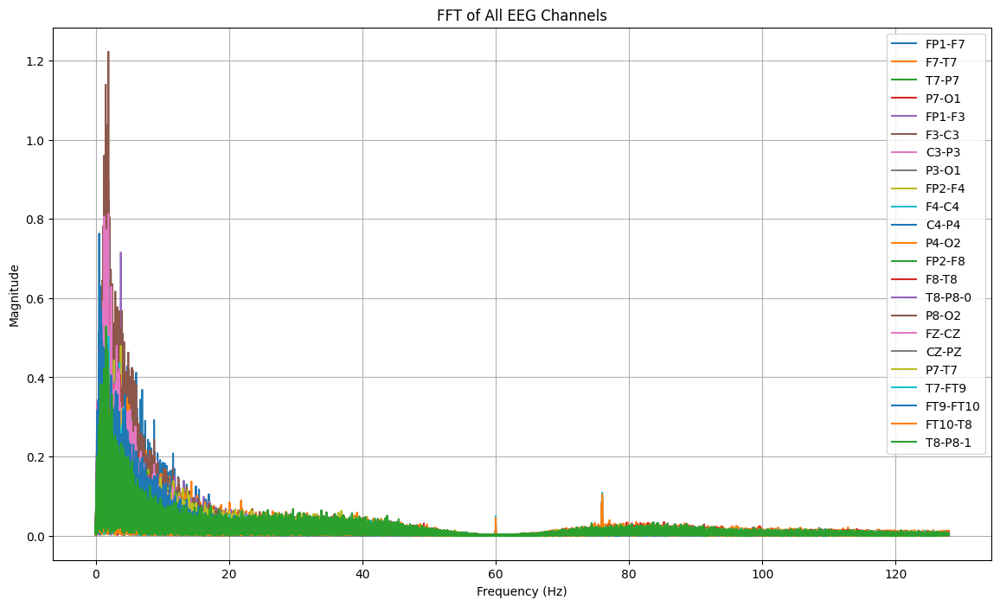

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA5[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 417:
        return "tidak kejang"
    elif 417 <= row['Time'] < 532:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_5 = TA5.copy()
TA_5['seizure'] = TA_5.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_5[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure        FP1-F7     F7-T7     T7-P7     P7-O1  \
0  297.000000  tidak kejang -7.619048e-06  0.000083  0.000047  0.000062   
1  297.003906  tidak kejang  9.768010e-07  0.000119  0.000017  0.000054   
2  297.007812  tidak kejang  9.181929e-06  0.000067  0.000068  0.000040   
3  297.011719  tidak kejang  2.207570e-05  0.000040  0.000094  0.000026   
4  297.015625  tidak kejang  3.028083e-05  0.000036  0.000095  0.000020   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000037  0.000035  0.000058  0.000129  ... -0.000087  0.000042  0.000026   
1 -0.000019  0.000027  0.000062  0.000121  ... -0.000069  0.000028  0.000020   
2 -0.000006  0.000016  0.000068  0.000106  ... -0.000053  0.000006  0.000006   
3  0.000010  0.000009  0.000074  0.000091  ... -0.000063  0.000014 -0.000006   
4  0.000027  0.000003  0.000076  0.000076  ... -0.000062  0.000017 -0.000012   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_5['seizure'].value_counts()


,count
seizure,
tidak kejang,61952
kejang,29440


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_5)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 357.0 detik


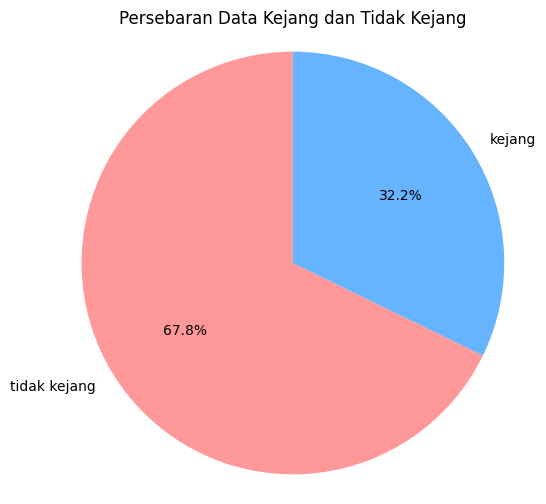

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_5['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_5.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb05_06.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_5.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_5['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.93      0.96      6018
tidak kejang       0.96      1.00      0.98     12261

    accuracy                           0.97     18279
   macro avg       0.98      0.96      0.97     18279
weighted avg       0.97      0.97      0.97     18279

Akurasi: 0.9725367908528912
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.93      0.96      6018
tidak kejang       0.96      1.00      0.98     12261

    accuracy                           0.97     18279
   macro avg       0.98      0.96      0.97     18279
weighted avg       0.97      0.97      0.97     18279



# DATA 6 (chb07_13)

In [ ]:
# mengimport file edf
file6 = "/content/drive/MyDrive/TA/EDF/chb07_13.edf"
data6 = mne.io.read_raw_edf(file6) # membaca file edf dan menyimpannya di data
data6


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb07_13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-28-d6d2ccd1dabe>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data6 = mne.io.read_raw_edf(file6) # membaca file edf dan menyimpannya di data


<RawEDF | chb07_13.edf, 23 x 953856 (3726.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data6.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data6.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data6.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df6 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df6['Time'] = times  # Menambahkan kolom waktu
df6.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.660562e-05,-2.246642e-05,3.653236e-05,-2.598291e-05,-2.285714e-05,2.012210e-05,-4.122100e-05,4.864469e-05,-1.582418e-05,-1.387057e-05,...,3.321123e-06,-1.269841e-05,-2.129426e-05,-1.777778e-05,-3.614164e-05,8.791209e-06,5.137973e-05,-8.341880e-05,3.321123e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,-1.367521e-06,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.367521e-06,-9.768010e-07,5.860806e-07,0.011719
4,9.768010e-07,-1.367521e-06,9.768010e-07,1.953602e-07,3.321123e-06,-2.930403e-06,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,...,-9.768010e-07,2.148962e-06,1.953602e-07,1.953602e-07,-5.860806e-07,2.148962e-06,1.758242e-06,-1.758242e-06,-9.768010e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df6.shape)


(953856, 24)


In [ ]:
# mendeskripsikan data
df6.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,...,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,9.538560e+05,953856.000000
mean,2.413435e-07,2.258246e-07,1.886813e-07,1.372840e-07,2.696574e-07,1.662475e-07,2.083968e-07,1.543697e-07,2.752504e-07,1.576381e-07,...,1.604272e-07,2.057220e-07,2.041093e-07,1.949534e-07,2.020391e-07,1.614853e-07,1.946864e-07,1.944537e-07,1.604272e-07,1862.998047
std,9.629219e-05,8.849421e-05,8.425704e-05,7.403967e-05,8.662357e-05,6.182276e-05,5.511084e-05,5.531840e-05,8.364737e-05,5.528698e-05,...,4.025401e-05,4.364874e-05,4.771618e-05,3.577954e-05,8.425704e-05,7.936321e-05,8.385351e-05,4.909519e-05,4.025401e-05,1075.604115
min,-1.108278e-03,-1.583785e-03,-1.826813e-03,-2.218706e-03,-1.160635e-03,-1.457973e-03,-1.715067e-03,-1.706471e-03,-9.988767e-04,-1.151648e-03,...,-1.002393e-03,-1.165324e-03,-9.660562e-04,-5.972161e-04,-1.993651e-03,-1.566203e-03,-1.198144e-03,-1.132503e-03,-1.002393e-03,0.000000
25%,-2.012210e-05,-2.129426e-05,-2.129426e-05,-1.426129e-05,-2.129426e-05,-1.699634e-05,-1.269841e-05,-1.426129e-05,-2.090354e-05,-1.699634e-05,...,-1.543346e-05,-1.894994e-05,-1.230769e-05,-1.387057e-05,-2.129426e-05,-1.660562e-05,-2.129426e-05,-1.426129e-05,-1.543346e-05,931.499023
50%,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1862.998047
75%,1.738706e-05,2.051282e-05,2.168498e-05,1.504274e-05,1.816850e-05,1.699634e-05,1.308913e-05,1.465201e-05,1.777778e-05,1.738706e-05,...,1.621490e-05,1.894994e-05,1.230769e-05,1.426129e-05,2.168498e-05,1.777778e-05,2.090354e-05,1.465201e-05,1.621490e-05,2794.497070
max,1.044591e-03,1.564640e-03,1.994042e-03,2.310916e-03,1.406789e-03,1.295824e-03,1.852601e-03,1.640440e-03,1.448987e-03,1.292308e-03,...,8.144567e-04,1.197363e-03,8.836142e-04,7.757753e-04,1.827204e-03,1.506032e-03,1.139927e-03,1.289573e-03,8.144567e-04,3725.996094


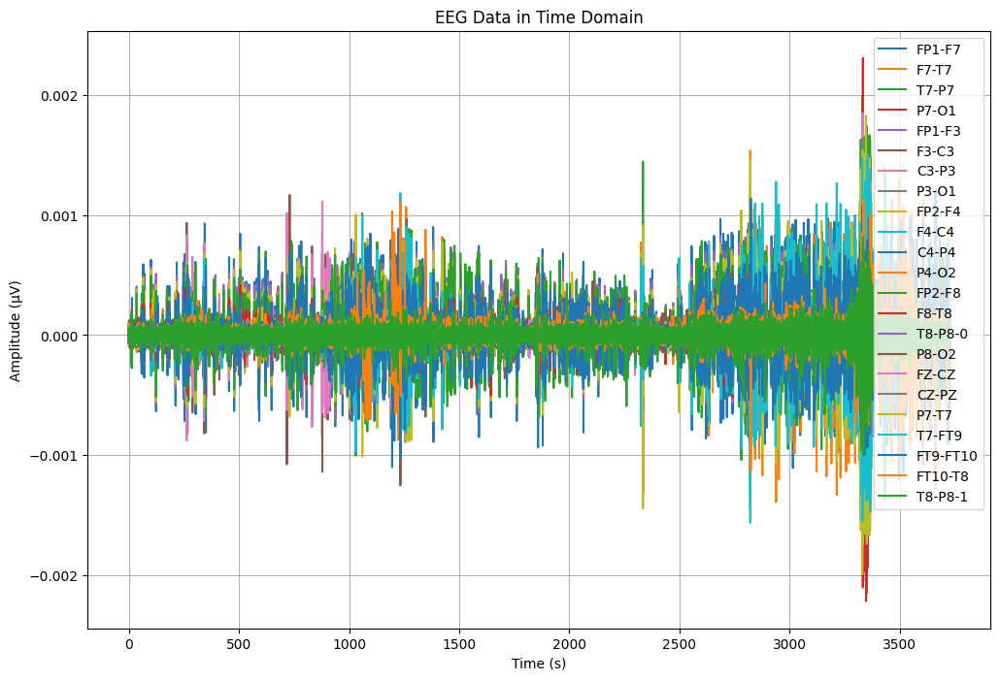

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df6['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df6[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


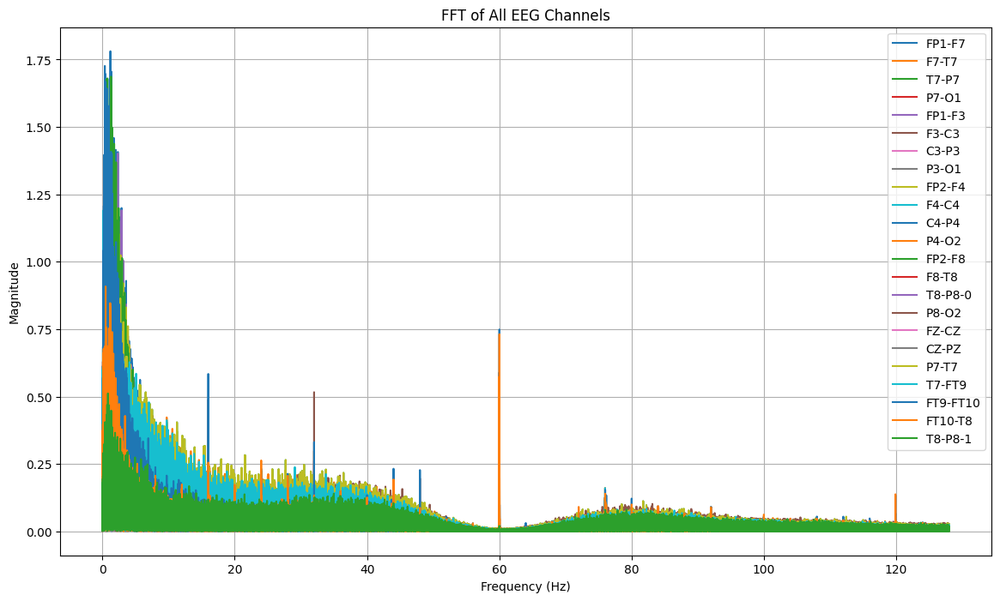

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df6[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb07_13.csv"
df6.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb07_13.csv


In [ ]:
#Import Data CSV
dataTA6 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb07_13.csv")
dataTA6


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.660562e-05,-2.246642e-05,3.653236e-05,-2.598291e-05,-2.285714e-05,2.012210e-05,-4.122100e-05,4.864469e-05,-1.582418e-05,-1.387057e-05,...,3.321123e-06,-1.269841e-05,-2.129426e-05,-1.777778e-05,-3.614164e-05,8.791209e-06,5.137973e-05,-8.341880e-05,3.321123e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,-1.367521e-06,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.367521e-06,-9.768010e-07,5.860806e-07,0.011719
4,9.768010e-07,-1.367521e-06,9.768010e-07,1.953602e-07,3.321123e-06,-2.930403e-06,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,...,-9.768010e-07,2.148962e-06,1.953602e-07,1.953602e-07,-5.860806e-07,2.148962e-06,1.758242e-06,-1.758242e-06,-9.768010e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
953851,-6.935287e-05,1.627350e-04,4.825397e-05,-8.810745e-05,5.860806e-07,5.294261e-05,1.387057e-05,-1.504274e-05,-6.036630e-05,4.434676e-05,...,7.619048e-06,-4.512821e-05,3.340659e-05,-1.035409e-05,-4.786325e-05,-1.682051e-04,1.049084e-04,-1.660562e-05,7.619048e-06,3725.980469
953852,-6.427350e-05,1.576557e-04,4.161172e-05,-8.341880e-05,2.539683e-06,4.942613e-05,8.400488e-06,-9.963370e-06,-2.559219e-05,4.669109e-05,...,2.930403e-06,-2.910867e-05,3.145299e-05,-1.816850e-05,-4.122100e-05,-1.619536e-04,7.833944e-05,-1.465201e-05,2.930403e-06,3725.984375
953853,-5.098901e-05,1.533578e-04,4.083028e-05,-9.435897e-05,8.400488e-06,4.708181e-05,6.056166e-06,-1.387057e-05,1.953602e-07,2.637363e-05,...,-7.228327e-06,-3.301587e-05,2.363858e-05,-2.520147e-05,-4.043956e-05,-1.537485e-04,7.560440e-05,-2.481074e-05,-7.228327e-06,3725.988281
953854,-5.177045e-05,1.521856e-04,3.926740e-05,-8.849817e-05,6.446886e-06,4.708181e-05,-1.758242e-06,-9.768010e-07,-3.145299e-05,2.285714e-05,...,-1.113553e-05,-1.934066e-05,2.246642e-05,-3.106227e-05,-3.887668e-05,-1.525763e-04,7.482295e-05,-2.871795e-05,-1.113553e-05,3725.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA6[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA6[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA6[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data6, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F7, Max Frequency: 1.20 Hz, Magnitude: 1.781025, Time: 3014.566406 s
Channel: FP2-F8, Max Frequency: 1.30 Hz, Magnitude: 1.686930, Time: 3326.695312 s
Channel: FT9-FT10, Max Frequency: 0.48 Hz, Magnitude: 1.667548, Time: 3495.562500 s
Channel: FP1-F3, Max Frequency: 1.10 Hz, Magnitude: 1.437490, Time: 3326.691406 s
Channel: FP2-F4, Max Frequency: 0.98 Hz, Magnitude: 1.408796, Time: 3326.691406 s
Channel: T7-FT9, Max Frequency: 0.37 Hz, Magnitude: 1.272054, Time: 2821.175781 s
Channel: P7-O1, Max Frequency: 1.26 Hz, Magnitude: 1.246104, Time: 3332.414062 s
Channel: F7-T7, Max Frequency: 0.37 Hz, Magnitude: 1.243065, Time: 3354.648438 s
Channel: F3-C3, Max Frequency: 1.14 Hz, Magnitude: 1.027386, Time: 3330.554688 s
Channel: F8-T8, Max Frequency: 1.10 Hz, Magnitude: 1.009996, Time: 3348.617188 s
Channel: T7-P7, Max Frequency: 1.74 Hz, Magnitude: 0.990918, Time: 3329.671875 s
Channel: P7-T7, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.37 Hz, Magnitude: 1.272054, Time: 2821.175781 s
Channel: FP1-F7, Max Frequency: 1.20 Hz, Magnitude: 1.781025, Time: 3014.566406 s
Channel: FP1-F3, Max Frequency: 1.10 Hz, Magnitude: 1.437490, Time: 3326.691406 s
Channel: FP2-F4, Max Frequency: 0.98 Hz, Magnitude: 1.408796, Time: 3326.691406 s
Channel: C4-P4, Max Frequency: 1.09 Hz, Magnitude: 0.751092, Time: 3326.695312 s
Channel: FP2-F8, Max Frequency: 1.30 Hz, Magnitude: 1.686930, Time: 3326.695312 s
Channel: FZ-CZ, Max Frequency: 1.09 Hz, Magnitude: 0.821392, Time: 3329.414062 s
Channel: T7-P7, Max Frequency: 1.74 Hz, Magnitude: 0.990918, Time: 3329.671875 s
Channel: P7-T7, Max Frequency: 1.74 Hz, Magnitude: 0.990918, Time: 3329.671875 s
Channel: F3-C3, Max Frequency: 1.14 Hz, Magnitude: 1.027386, Time: 3330.554688 s
Channel: C3-P3, Max Frequency: 0.80 Hz, Magnitude: 0.772233, Time: 3330.6132

In [ ]:
# potong data (potong dulu datanya)

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 3165   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3501    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut6 = dataTA6.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut6.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb07_13.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA6 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb07_13.csv")
TA6.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000014,-0.000006,-9.963370e-06,-0.000011,0.000034,-0.000020,0.000004,-0.000033,-7.619048e-06,0.000029,...,0.000006,-1.367521e-06,0.000008,0.000009,1.035409e-05,5.860806e-07,0.000004,-0.000017,0.000006,3165.000000
1,0.000017,-0.000015,1.953602e-07,-0.000003,0.000002,0.000020,0.000006,-0.000028,-2.754579e-05,0.000049,...,0.000002,5.860806e-07,0.000009,0.000006,1.953602e-07,1.465201e-05,0.000006,-0.000021,0.000002,3165.003906
2,0.000021,-0.000028,1.660562e-05,-0.000006,0.000005,0.000017,0.000004,-0.000022,-1.738706e-05,0.000047,...,-0.000009,2.930403e-06,0.000010,0.000003,-1.621490e-05,2.637363e-05,-0.000017,0.000006,-0.000009,3165.007812
3,0.000017,-0.000033,2.207570e-05,0.000003,0.000013,0.000009,-0.000004,-0.000010,-9.768010e-07,0.000038,...,-0.000015,-8.791209e-06,0.000010,0.000003,-2.168498e-05,3.536020e-05,-0.000022,0.000022,-0.000015,3165.011719
4,0.000020,-0.000036,2.324786e-05,-0.000008,0.000034,-0.000010,-0.000003,-0.000020,1.269841e-05,0.000019,...,-0.000016,-5.274725e-06,0.000007,0.000003,-2.285714e-05,3.887668e-05,-0.000015,0.000008,-0.000016,3165.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA6.shape


(86016, 24)

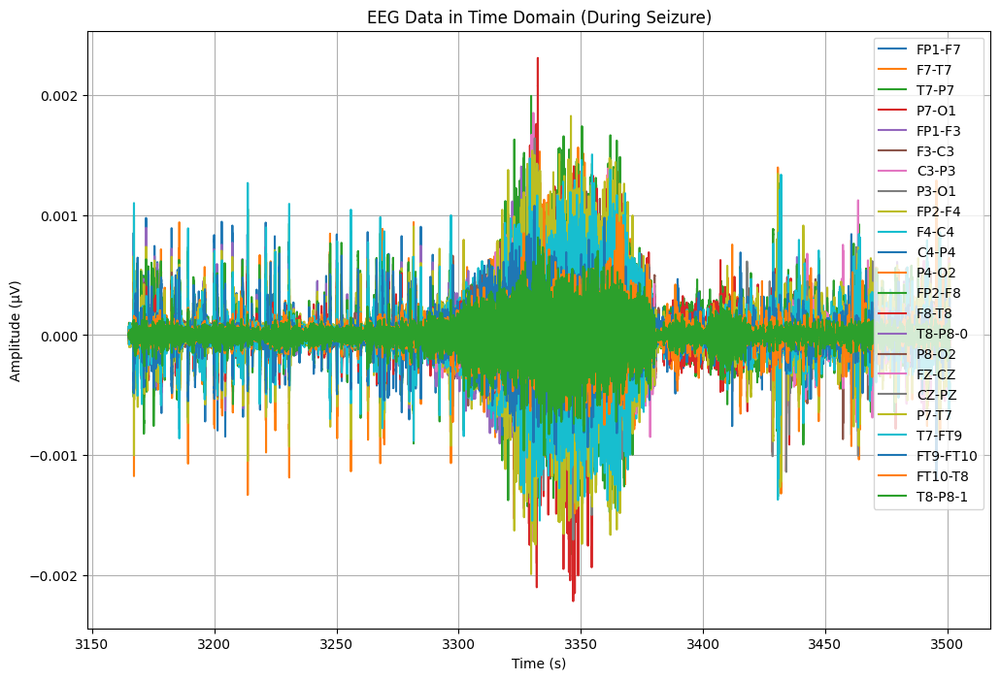

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA6['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA6.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA6[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


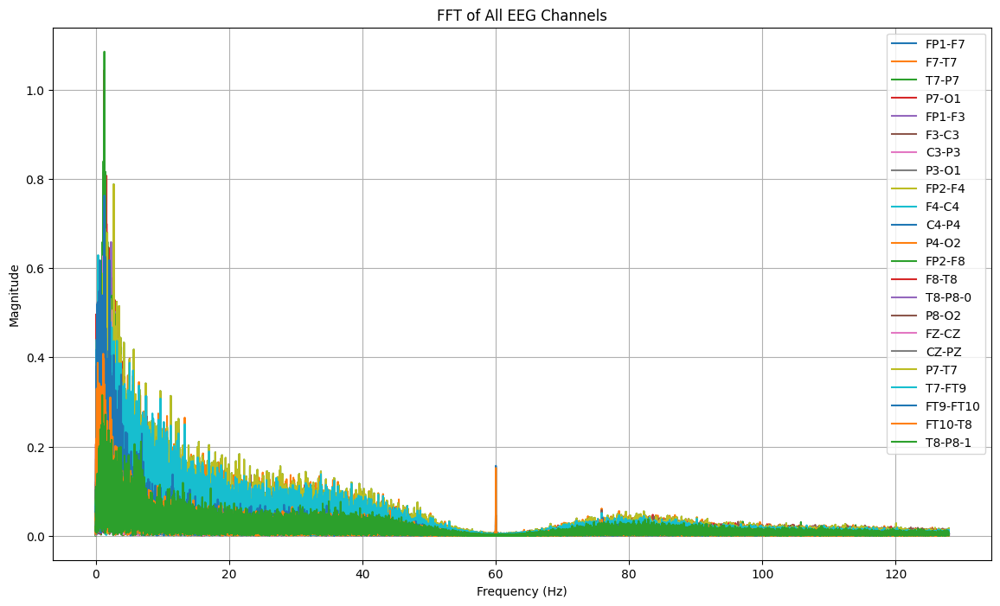

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA6[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 3285:
        return "tidak kejang"
    elif 3285 <= row['Time'] < 3381:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_6 = TA6.copy()
TA_6['seizure'] = TA_6.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_6[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7         T7-P7     P7-O1  \
0  3165.000000  tidak kejang  0.000014 -0.000006 -9.963370e-06 -0.000011   
1  3165.003906  tidak kejang  0.000017 -0.000015  1.953602e-07 -0.000003   
2  3165.007812  tidak kejang  0.000021 -0.000028  1.660562e-05 -0.000006   
3  3165.011719  tidak kejang  0.000017 -0.000033  2.207570e-05  0.000003   
4  3165.015625  tidak kejang  0.000020 -0.000036  2.324786e-05 -0.000008   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0  0.000034 -0.000020  0.000004 -0.000033  ... -0.000002  0.000006   
1  0.000002  0.000020  0.000006 -0.000028  ... -0.000006  0.000002   
2  0.000005  0.000017  0.000004 -0.000022  ...  0.000006 -0.000009   
3  0.000013  0.000009 -0.000004 -0.000010  ...  0.000022 -0.000015   
4  0.000034 -0.000010 -0.000003 -0.000020  ...  0.000021 -0.000016   

          P8-O2     FZ-CZ     CZ-PZ         P7-T7        T7-FT9  FT9-FT10  \
0 -1.367521e-06  0.000008  0.000009  1.035409

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_6['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,24576


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_6)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 336.0 detik


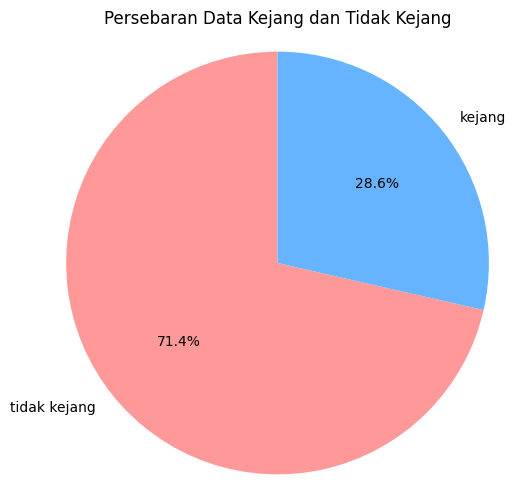

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_6['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_6.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb07_13.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_6.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_6['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      4949
tidak kejang       0.96      0.99      0.98     12255

    accuracy                           0.96     17204
   macro avg       0.97      0.94      0.96     17204
weighted avg       0.96      0.96      0.96     17204

Akurasi: 0.9642524994187398
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      4949
tidak kejang       0.96      0.99      0.98     12255

    accuracy                           0.96     17204
   macro avg       0.97      0.94      0.96     17204
weighted avg       0.96      0.96      0.96     17204



# DATA 7 (chb08_02)

In [ ]:
# mengimport file edf
file7 = "/content/drive/MyDrive/TA/EDF/chb08_02.edf"
data7 = mne.io.read_raw_edf(file7) # membaca file edf dan menyimpannya di data
data7


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-52-63dfc346e2fa>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data7 = mne.io.read_raw_edf(file7) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_02.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data7.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data7.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data7.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df7 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df7['Time'] = times  # Menambahkan kolom waktu
df7.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.611722e-04,2.637363e-05,-1.953602e-07,7.873016e-05,-4.161172e-05,7.833944e-05,-3.936508e-04,3.006593e-04,1.799267e-04,8.029304e-05,...,5.958486e-05,9.123321e-05,1.113553e-05,7.755800e-05,5.860806e-07,5.411477e-05,2.676435e-05,5.528694e-05,5.958486e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,-9.768010e-07,1.953602e-07,0.007812
3,-9.768010e-07,1.953602e-07,-1.367521e-06,3.321123e-06,-9.768010e-07,1.953602e-07,-1.953602e-07,2.148962e-06,-9.768010e-07,-1.758242e-06,...,5.860806e-07,1.758242e-06,1.953602e-07,-5.860806e-07,1.758242e-06,-2.539683e-06,2.930403e-06,-1.953602e-07,5.860806e-07,0.011719
4,-4.102564e-06,5.274725e-06,1.953602e-07,-2.930403e-06,-9.768010e-07,2.148962e-06,-1.953602e-07,-2.539683e-06,5.860806e-07,-2.930403e-06,...,-1.953602e-07,-5.665446e-06,1.953602e-07,9.768010e-07,1.953602e-07,-2.539683e-06,-1.269841e-05,1.660562e-05,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df7.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df7.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.318728e-07,2.196959e-07,1.860047e-07,1.838294e-07,2.351021e-07,2.097926e-07,2.076279e-07,1.803932e-07,2.478683e-07,1.852233e-07,...,1.602776e-07,2.002667e-07,1.938352e-07,1.931064e-07,2.047157e-07,1.761133e-07,1.914661e-07,2.166484e-07,1.602776e-07,1799.998047
std,9.269253e-05,6.887162e-05,4.984497e-05,6.403133e-05,7.609287e-05,4.999011e-05,4.748712e-05,6.143013e-05,9.631416e-05,5.414624e-05,...,7.950239e-05,8.577232e-05,4.836922e-05,5.240893e-05,4.984497e-05,4.157206e-05,8.347219e-05,5.645186e-05,7.950239e-05,1039.231048
min,-9.394872e-04,-1.029353e-03,-1.527131e-03,-1.581050e-03,-8.547009e-04,-5.343101e-04,-7.800733e-04,-1.143834e-03,-1.061783e-03,-6.737973e-04,...,-1.665836e-03,-1.571673e-03,-8.464957e-04,-1.291917e-03,-1.586520e-03,-1.034823e-03,-1.288010e-03,-1.084054e-03,-1.665836e-03,0.000000
25%,-2.910867e-05,-2.832723e-05,-2.363858e-05,-3.145299e-05,-2.832723e-05,-2.363858e-05,-1.973138e-05,-2.989011e-05,-3.145299e-05,-2.168498e-05,...,-3.809524e-05,-3.887668e-05,-1.934066e-05,-2.285714e-05,-2.402930e-05,-1.738706e-05,-2.910867e-05,-2.168498e-05,-3.809524e-05,899.999023
50%,-5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,2.715507e-05,2.715507e-05,2.442002e-05,3.223443e-05,2.520147e-05,2.246642e-05,2.012210e-05,3.028083e-05,2.559219e-05,2.168498e-05,...,3.926740e-05,3.965812e-05,2.012210e-05,2.285714e-05,2.402930e-05,1.855922e-05,2.949939e-05,2.168498e-05,3.926740e-05,2699.997070
max,1.058266e-03,9.480830e-04,1.586911e-03,1.532991e-03,1.033260e-03,6.288645e-04,1.266520e-03,7.871062e-04,1.585348e-03,1.257143e-03,...,1.520098e-03,1.573626e-03,1.184860e-03,8.312576e-04,1.527521e-03,1.462271e-03,1.227057e-03,1.306764e-03,1.520098e-03,3599.996094


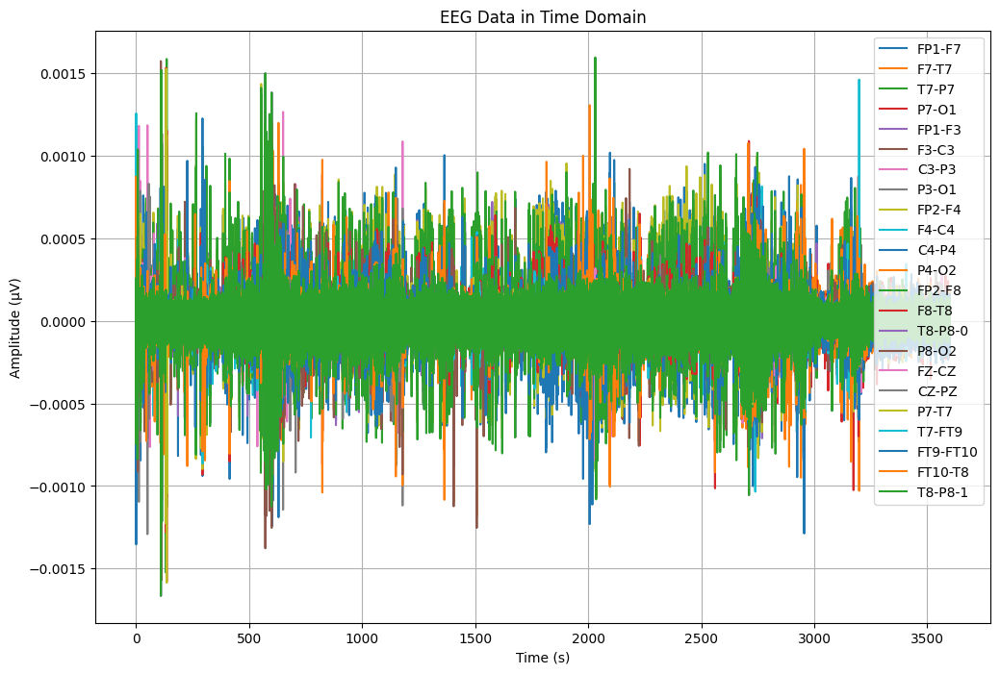

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df7['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df7[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


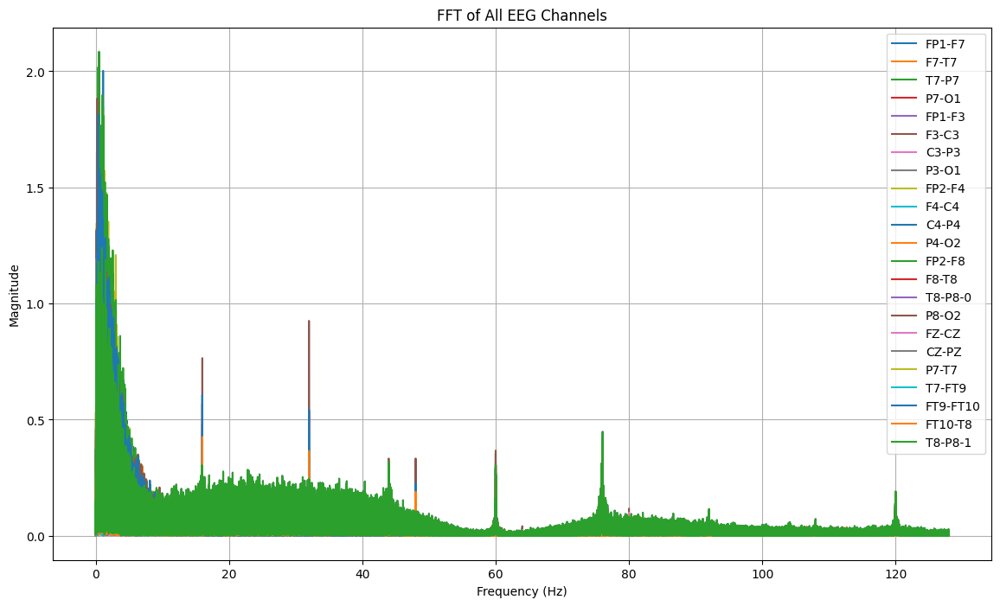

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df7[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_02.csv"
df7.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_02.csv


In [ ]:
#Import Data CSV
dataTA7 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_02.csv")
dataTA7


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.611722e-04,2.637363e-05,-1.953602e-07,7.873016e-05,-4.161172e-05,7.833944e-05,-3.936508e-04,3.006593e-04,1.799267e-04,8.029304e-05,...,5.958486e-05,9.123321e-05,1.113553e-05,7.755800e-05,5.860806e-07,5.411477e-05,2.676435e-05,5.528694e-05,5.958486e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,-9.768010e-07,1.953602e-07,0.007812
3,-9.768010e-07,1.953602e-07,-1.367521e-06,3.321123e-06,-9.768010e-07,1.953602e-07,-1.953602e-07,2.148962e-06,-9.768010e-07,-1.758242e-06,...,5.860806e-07,1.758242e-06,1.953602e-07,-5.860806e-07,1.758242e-06,-2.539683e-06,2.930403e-06,-1.953602e-07,5.860806e-07,0.011719
4,-4.102564e-06,5.274725e-06,1.953602e-07,-2.930403e-06,-9.768010e-07,2.148962e-06,-1.953602e-07,-2.539683e-06,5.860806e-07,-2.930403e-06,...,-1.953602e-07,-5.665446e-06,1.953602e-07,9.768010e-07,1.953602e-07,-2.539683e-06,-1.269841e-05,1.660562e-05,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.418803e-05,-2.090354e-05,2.363858e-05,1.381197e-04,6.661783e-05,1.504274e-05,-3.106227e-05,5.489621e-05,6.739927e-05,-9.181929e-06,...,1.213187e-04,-4.200244e-05,1.543346e-05,3.809524e-05,-2.324786e-05,-4.630037e-05,1.248352e-04,2.051282e-05,1.213187e-04,3599.980469
921596,-4.200244e-05,-1.621490e-05,2.051282e-05,1.467155e-04,6.388278e-05,1.504274e-05,-3.536020e-05,6.427350e-05,6.388278e-05,-1.308913e-05,...,1.240537e-04,-3.536020e-05,1.621490e-05,4.122100e-05,-2.012210e-05,-4.903541e-05,1.256166e-04,1.777778e-05,1.240537e-04,3599.984375
921597,-4.278388e-05,-1.347985e-05,1.777778e-05,1.502320e-04,6.271062e-05,1.504274e-05,-3.731380e-05,6.974359e-05,5.763126e-05,-1.660562e-05,...,1.244444e-04,-2.676435e-05,1.660562e-05,4.122100e-05,-1.738706e-05,-4.864469e-05,1.224908e-04,1.465201e-05,1.244444e-04,3599.988281
921598,-4.239316e-05,-1.465201e-05,1.894994e-05,1.514042e-04,6.075702e-05,1.387057e-05,-3.496947e-05,7.169719e-05,5.020757e-05,-2.207570e-05,...,1.221001e-04,-1.816850e-05,1.543346e-05,3.653236e-05,-1.855922e-05,-4.122100e-05,1.154579e-04,7.619048e-06,1.221001e-04,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA7[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA7[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA7[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data7, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP2-F8, Max Frequency: 0.50 Hz, Magnitude: 2.084656, Time: 2031.410156 s
Channel: FP1-F7, Max Frequency: 1.12 Hz, Magnitude: 2.002100, Time: 293.636719 s
Channel: P8-O2, Max Frequency: 0.26 Hz, Magnitude: 1.883129, Time: 109.480469 s
Channel: FT9-FT10, Max Frequency: 0.41 Hz, Magnitude: 1.814928, Time: 2955.582031 s
Channel: P4-O2, Max Frequency: 0.24 Hz, Magnitude: 1.788789, Time: 601.679688 s
Channel: FP2-F4, Max Frequency: 0.82 Hz, Magnitude: 1.716919, Time: 2031.410156 s
Channel: F8-T8, Max Frequency: 0.32 Hz, Magnitude: 1.610685, Time: 2711.152344 s
Channel: F7-T7, Max Frequency: 0.70 Hz, Magnitude: 1.453715, Time: 3198.687500 s
Channel: FP1-F3, Max Frequency: 1.12 Hz, Magnitude: 1.376697, Time: 293.636719 s
Channel: T8-P8-0, Max Frequency: 0.93 Hz, Magnitude: 1.239195, Time: 109.480469 s
Channel: T8-P8-1, Max Frequency: 0.93 Hz, Magnitude: 1.239195, Time: 109.480469 s
Channel: CZ-PZ, Max Frequ

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F4-C4, Max Frequency: 0.34 Hz, Magnitude: 1.043585, Time: 0.058594 s
Channel: C4-P4, Max Frequency: 0.61 Hz, Magnitude: 1.109265, Time: 0.058594 s
Channel: FZ-CZ, Max Frequency: 0.33 Hz, Magnitude: 0.954908, Time: 50.304688 s
Channel: CZ-PZ, Max Frequency: 0.27 Hz, Magnitude: 1.220125, Time: 50.304688 s
Channel: T8-P8-0, Max Frequency: 0.93 Hz, Magnitude: 1.239195, Time: 109.480469 s
Channel: P8-O2, Max Frequency: 0.26 Hz, Magnitude: 1.883129, Time: 109.480469 s
Channel: T8-P8-1, Max Frequency: 0.93 Hz, Magnitude: 1.239195, Time: 109.480469 s
Channel: T7-P7, Max Frequency: 0.33 Hz, Magnitude: 0.885812, Time: 135.265625 s
Channel: P7-O1, Max Frequency: 1.18 Hz, Magnitude: 1.075557, Time: 135.265625 s
Channel: P7-T7, Max Frequency: 0.33 Hz, Magnitude: 0.885812, Time: 135.265625 s
Channel: FP1-F7, Max Frequency: 1.12 Hz, Magnitude: 2.002100, Time: 293.636719 s
Channel: FP1

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2550   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2961    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut7 = dataTA7.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut7.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_02.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA7 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_02.csv")
TA7.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000047,-0.000027,0.000070,0.000056,-0.000029,0.000044,-0.000015,0.000051,-0.000007,-0.000004,...,-0.000002,-5.880342e-05,-0.000032,-0.000030,-0.000070,4.043956e-05,0.000059,0.000025,-0.000002,2550.000000
1,-0.000046,-0.000015,0.000045,0.000069,-0.000028,0.000029,-0.000005,0.000055,-0.000008,0.000002,...,0.000055,-6.231990e-05,-0.000030,-0.000028,-0.000044,2.715507e-05,0.000060,-0.000028,0.000055,2550.003906
2,-0.000036,0.000008,0.000005,0.000092,-0.000047,0.000065,-0.000007,0.000059,0.000015,-0.000005,...,0.000054,-5.098901e-05,-0.000018,-0.000024,-0.000005,5.860806e-07,0.000064,-0.000032,0.000054,2550.007812
3,-0.000006,-0.000008,0.000015,0.000082,-0.000006,0.000049,-0.000010,0.000051,0.000008,0.000016,...,0.000028,-2.481074e-05,-0.000015,-0.000023,-0.000015,1.230769e-05,0.000056,-0.000032,0.000028,2550.011719
4,0.000011,0.000006,0.000013,0.000059,0.000026,0.000035,-0.000012,0.000042,-0.000002,0.000046,...,0.000031,-5.860806e-07,-0.000017,-0.000023,-0.000013,3.321123e-06,0.000047,-0.000067,0.000031,2550.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA7.shape


(105216, 24)

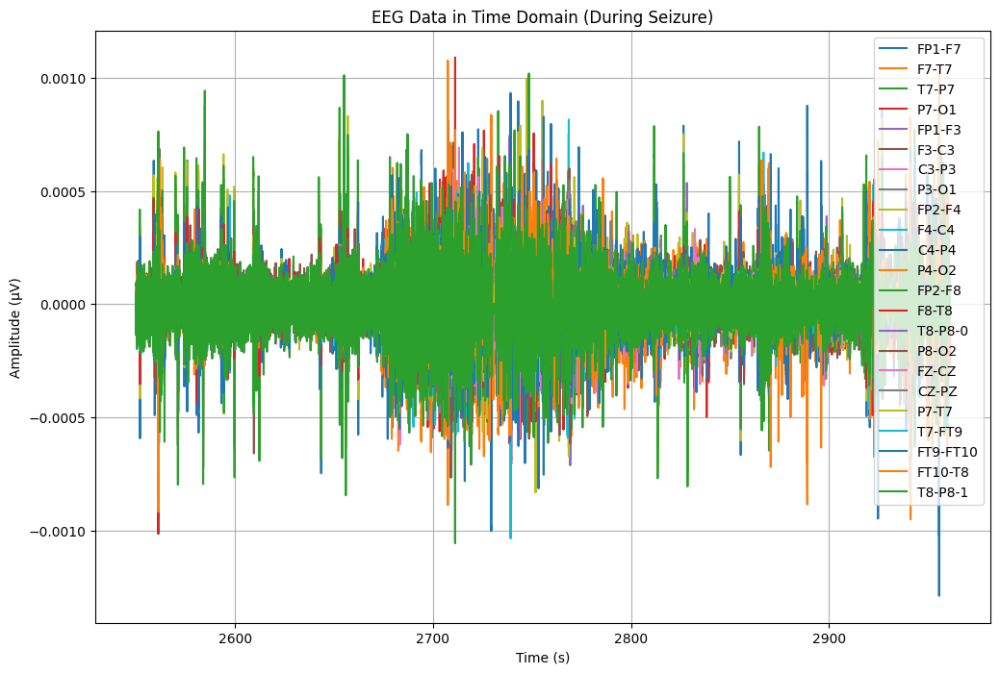

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA7['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA7.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA7[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


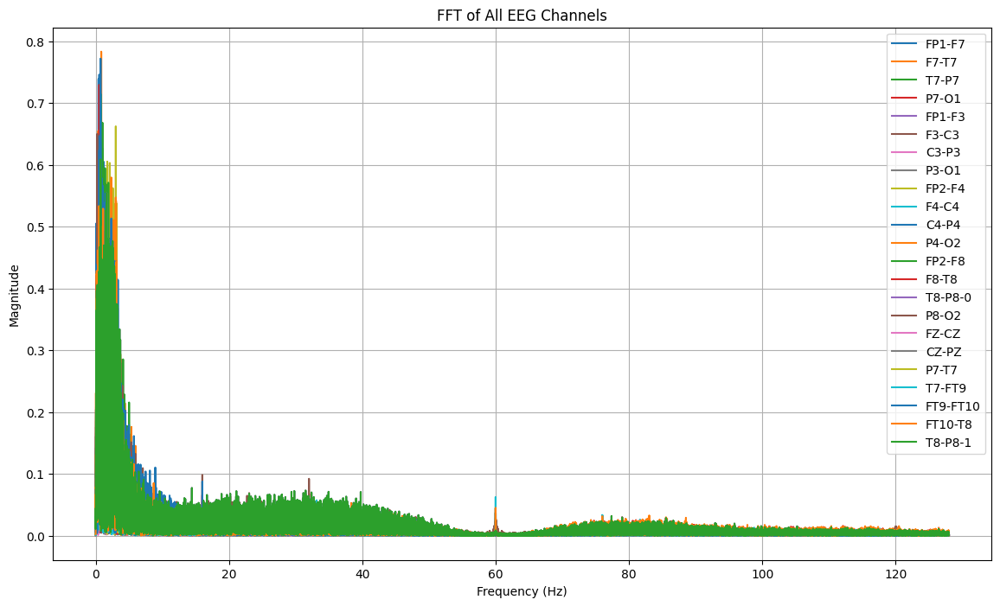

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA7[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2670:
        return "tidak kejang"
    elif 2670 <= row['Time'] < 2841:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_7 = TA7.copy()
TA_7['seizure'] = TA_7.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_7[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2550.000000  tidak kejang -0.000047 -0.000027  0.000070  0.000056   
1  2550.003906  tidak kejang -0.000046 -0.000015  0.000045  0.000069   
2  2550.007812  tidak kejang -0.000036  0.000008  0.000005  0.000092   
3  2550.011719  tidak kejang -0.000006 -0.000008  0.000015  0.000082   
4  2550.015625  tidak kejang  0.000011  0.000006  0.000013  0.000059   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000029  0.000044 -0.000015  0.000051  ...  0.000031 -0.000002   
1 -0.000028  0.000029 -0.000005  0.000055  ... -0.000017  0.000055   
2 -0.000047  0.000065 -0.000007  0.000059  ... -0.000018  0.000054   
3 -0.000006  0.000049 -0.000010  0.000051  ... -0.000024  0.000028   
4  0.000026  0.000035 -0.000012  0.000042  ... -0.000054  0.000031   

          P8-O2     FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0 -5.880342e-05 -0.000032 -0.000030 -0.000070  4.043956e-05  0.000059   


In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_7['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,43776


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_7)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 411.0 detik


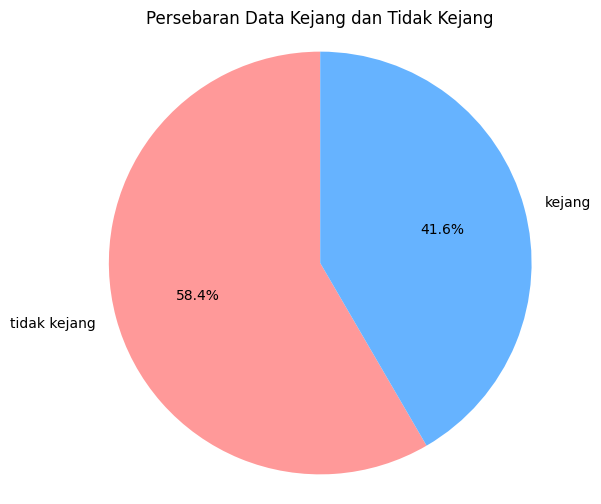

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_7['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_7.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_02.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_7.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_7['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.96      0.97      8743
tidak kejang       0.97      0.99      0.98     12301

    accuracy                           0.98     21044
   macro avg       0.98      0.97      0.98     21044
weighted avg       0.98      0.98      0.98     21044

Akurasi: 0.977333206614712
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.96      0.97      8743
tidak kejang       0.97      0.99      0.98     12301

    accuracy                           0.98     21044
   macro avg       0.98      0.97      0.98     21044
weighted avg       0.98      0.98      0.98     21044



# DATA 8 (chb08_05)

In [ ]:
# mengimport file edf
file8 = "/content/drive/MyDrive/TA/EDF/chb08_05.edf"
data8 = mne.io.read_raw_edf(file8) # membaca file edf dan menyimpannya di data
data8


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-76-fd50d4c87032>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data8 = mne.io.read_raw_edf(file8) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_05.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data8.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data8.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data8.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df8 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df8['Time'] = times  # Menambahkan kolom waktu
df8.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.083028e-05,-8.009768e-06,-3.301587e-05,8.732601e-05,-1.582418e-05,-1.699634e-05,4.004884e-05,-1.758242e-06,1.113553e-05,-1.660562e-05,...,1.758242e-06,3.184371e-05,1.973138e-05,-5.860806e-07,3.340659e-05,-2.148962e-06,7.365079e-05,-8.009768e-06,1.758242e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df8.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df8.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.068444e-07,1.957769e-07,2.001323e-07,2.447361e-07,2.155487e-07,1.600372e-07,1.520706e-07,2.111298e-07,2.496379e-07,2.005325e-07,...,1.728705e-07,2.108686e-07,1.753922e-07,2.284531e-07,1.905881e-07,1.994090e-07,1.390021e-07,2.094144e-07,1.728705e-07,1799.998047
std,1.295482e-04,1.244356e-04,1.282158e-04,1.340388e-04,1.177698e-04,1.060375e-04,6.701137e-05,1.075411e-04,1.018580e-04,7.726423e-05,...,9.052635e-05,1.190813e-04,9.519011e-05,6.522006e-05,1.282158e-04,1.203857e-04,1.017265e-04,1.033799e-04,9.052635e-05,1039.231048
min,-1.389206e-03,-1.674823e-03,-1.156337e-03,-1.309499e-03,-1.386081e-03,-1.042247e-03,-1.214945e-03,-1.237607e-03,-1.442344e-03,-1.154774e-03,...,-1.633407e-03,-1.584176e-03,-1.178999e-03,-1.123516e-03,-1.706862e-03,-1.113748e-03,-1.137192e-03,-1.795946e-03,-1.633407e-03,0.000000
25%,-3.340659e-05,-3.848596e-05,-2.989011e-05,-4.356532e-05,-3.223443e-05,-2.949939e-05,-2.246642e-05,-3.965812e-05,-3.067155e-05,-2.442002e-05,...,-3.965812e-05,-4.747253e-05,-2.559219e-05,-2.442002e-05,-3.028083e-05,-2.715507e-05,-3.575092e-05,-2.832723e-05,-3.965812e-05,899.999023
50%,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.367521e-06,-1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.367521e-06,1.953602e-07,1.953602e-07,1799.998047
75%,3.262515e-05,3.731380e-05,3.067155e-05,4.317460e-05,2.989011e-05,2.910867e-05,2.285714e-05,3.887668e-05,2.715507e-05,2.442002e-05,...,4.043956e-05,4.669109e-05,2.598291e-05,2.442002e-05,3.028083e-05,2.793651e-05,3.575092e-05,2.910867e-05,4.043956e-05,2699.997070
max,1.844396e-03,1.191502e-03,1.707253e-03,1.373968e-03,1.569719e-03,1.740855e-03,1.068816e-03,1.329817e-03,1.192674e-03,1.322784e-03,...,1.631453e-03,1.566593e-03,1.014115e-03,9.699634e-04,1.156728e-03,1.656068e-03,1.123516e-03,1.926447e-03,1.631453e-03,3599.996094


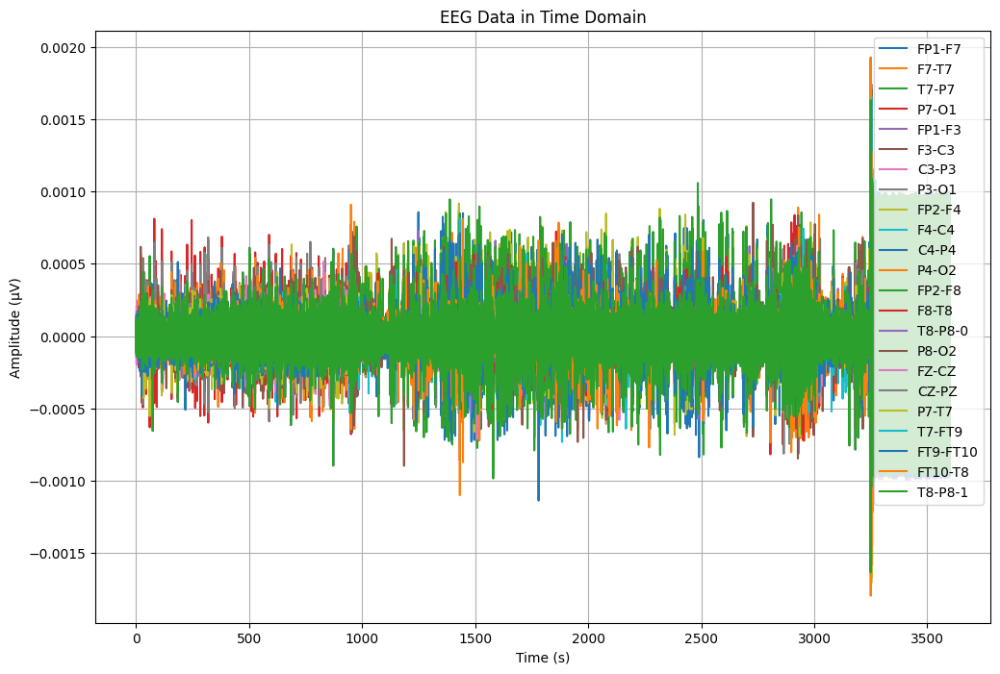

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df8['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df8[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


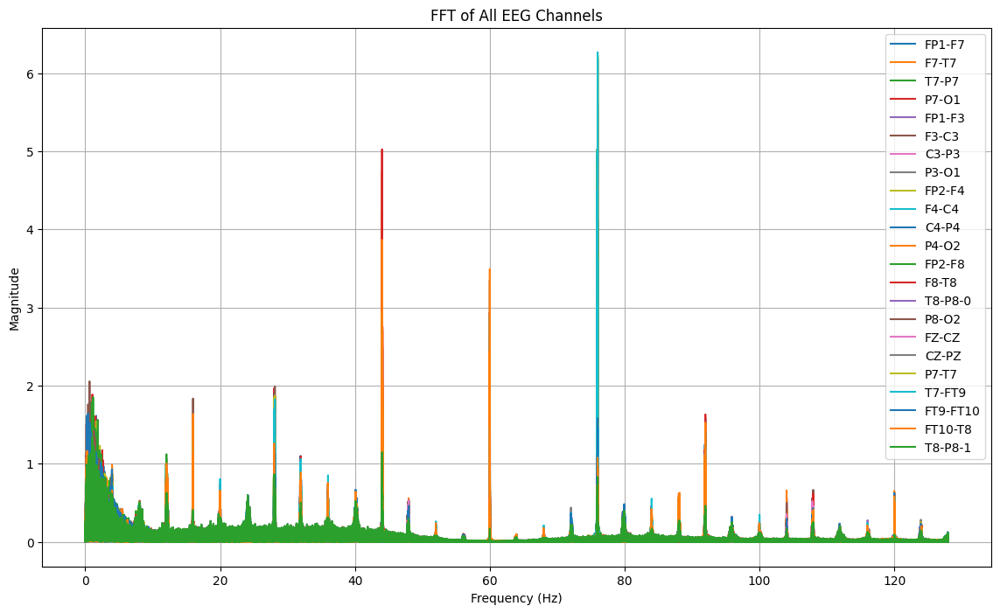

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df8[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_05.csv"
df8.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_05.csv


In [ ]:
#Import Data CSV
dataTA8 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_05.csv")
dataTA8


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.083028e-05,-8.009768e-06,-3.301587e-05,8.732601e-05,-1.582418e-05,-1.699634e-05,4.004884e-05,-1.758242e-06,1.113553e-05,-1.660562e-05,...,1.758242e-06,3.184371e-05,1.973138e-05,-5.860806e-07,3.340659e-05,-2.148962e-06,7.365079e-05,-8.009768e-06,1.758242e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,3.709890e-04,-3.577045e-04,-5.343101e-04,8.672039e-04,3.530159e-04,-8.832234e-04,1.953602e-07,8.746276e-04,1.035409e-05,4.493284e-06,...,-3.496947e-05,3.991209e-04,8.771673e-05,-1.693773e-04,5.347009e-04,-5.429060e-04,2.363858e-05,4.936752e-04,-3.496947e-05,3599.980469
921596,3.037851e-04,-2.908913e-04,1.138950e-04,1.822711e-04,3.162882e-04,-2.330647e-04,1.953602e-07,2.248596e-04,-8.654457e-05,4.102564e-06,...,-1.076435e-04,-1.404640e-04,-8.341880e-05,-5.724054e-05,-1.135043e-04,7.013431e-05,1.758242e-06,4.780464e-04,-1.076435e-04,3599.984375
921597,-3.018315e-04,3.139438e-04,-2.697924e-04,5.958486e-05,-1.912576e-04,-2.795604e-04,1.953602e-07,2.717460e-04,-4.669109e-05,4.102564e-06,...,9.045177e-05,-1.369475e-04,-7.091575e-05,-1.074481e-05,2.701832e-04,-4.835165e-04,-1.758242e-06,3.268376e-04,9.045177e-05,3599.988281
921598,-1.451526e-04,1.572650e-04,-1.869597e-04,9.279609e-05,-7.521368e-05,-1.365568e-04,1.953602e-07,1.287424e-04,3.340659e-05,3.711844e-06,...,1.486691e-04,3.940415e-04,1.166300e-04,1.369475e-04,1.873504e-04,-2.244689e-04,-3.321123e-06,-4.030281e-04,1.486691e-04,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA8[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA8[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA8[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data8, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: T7-FT9, Max Frequency: 75.99 Hz, Magnitude: 6.266073, Time: 3252.750000 s
Channel: P7-T7, Max Frequency: 75.99 Hz, Magnitude: 6.224966, Time: 3252.753906 s
Channel: T7-P7, Max Frequency: 75.99 Hz, Magnitude: 6.224966, Time: 3252.753906 s
Channel: FP2-F8, Max Frequency: 75.99 Hz, Magnitude: 6.177423, Time: 3255.136719 s
Channel: C4-P4, Max Frequency: 75.99 Hz, Magnitude: 6.173354, Time: 3252.718750 s
Channel: F7-T7, Max Frequency: 75.99 Hz, Magnitude: 5.642439, Time: 3252.750000 s
Channel: FP1-F7, Max Frequency: 75.99 Hz, Magnitude: 5.579952, Time: 3249.625000 s
Channel: FP1-F3, Max Frequency: 75.99 Hz, Magnitude: 5.036314, Time: 3255.136719 s
Channel: F8-T8, Max Frequency: 44.02 Hz, Magnitude: 5.023997, Time: 3250.507812 s
Channel: P4-O2, Max Frequency: 75.99 Hz, Magnitude: 4.828461, Time: 3253.894531 s
Channel: P7-O1, Max Frequency: 44.02 Hz, Magnitude: 4.216241, Time: 3248.367188 s
Channel: FT10-T

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT9-FT10, Max Frequency: 44.02 Hz, Magnitude: 1.777452, Time: 1780.613281 s
Channel: FP2-F4, Max Frequency: 1.16 Hz, Magnitude: 1.629470, Time: 3247.230469 s
Channel: F4-C4, Max Frequency: 44.02 Hz, Magnitude: 1.314581, Time: 3247.343750 s
Channel: P7-O1, Max Frequency: 44.02 Hz, Magnitude: 4.216241, Time: 3248.367188 s
Channel: P3-O1, Max Frequency: 44.02 Hz, Magnitude: 2.336875, Time: 3248.367188 s
Channel: T8-P8-0, Max Frequency: 1.03 Hz, Magnitude: 1.344929, Time: 3249.550781 s
Channel: T8-P8-1, Max Frequency: 1.03 Hz, Magnitude: 1.344929, Time: 3249.550781 s
Channel: FP1-F7, Max Frequency: 75.99 Hz, Magnitude: 5.579952, Time: 3249.625000 s
Channel: FT10-T8, Max Frequency: 44.02 Hz, Magnitude: 3.865387, Time: 3250.503906 s
Channel: F8-T8, Max Frequency: 44.02 Hz, Magnitude: 5.023997, Time: 3250.507812 s
Channel: C4-P4, Max Frequency: 75.99 Hz, Magnitude: 6.173354, T

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2736   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3166    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut8 = dataTA8.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut8.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_05.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA8 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_05.csv")
TA8.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.504274e-05,-0.000051,-0.000027,-0.000053,-5.860806e-07,-0.000029,-0.000035,-0.000050,0.000003,-0.000057,...,-0.000069,-0.000042,-1.894994e-05,0.000013,0.000028,5.958486e-05,-0.000081,0.000010,-0.000069,2736.000000
1,1.582418e-05,-0.000064,-0.000007,-0.000063,-1.660562e-05,-0.000009,-0.000038,-0.000054,-0.000019,-0.000029,...,-0.000063,-0.000028,-1.504274e-05,0.000013,0.000007,8.498168e-05,-0.000084,-0.000021,-0.000063,2736.003906
2,-8.791209e-06,0.000014,-0.000055,-0.000087,-3.926740e-05,0.000010,-0.000062,-0.000045,-0.000044,-0.000008,...,-0.000084,-0.000046,-7.228327e-06,0.000012,0.000055,-3.809524e-05,-0.000052,0.000035,-0.000084,2736.007812
3,-5.860806e-07,0.000022,-0.000078,-0.000071,-4.903541e-05,0.000023,-0.000057,-0.000046,-0.000044,0.000002,...,-0.000006,-0.000059,1.953602e-07,0.000016,0.000078,-4.981685e-05,-0.000071,-0.000005,-0.000006,2736.011719
4,2.481074e-05,-0.000013,-0.000064,-0.000061,-3.301587e-05,0.000004,-0.000024,-0.000062,-0.000037,-0.000013,...,-0.000014,-0.000026,2.930403e-06,0.000019,0.000065,5.860806e-07,-0.000086,-0.000044,-0.000014,2736.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA8.shape


(110080, 24)

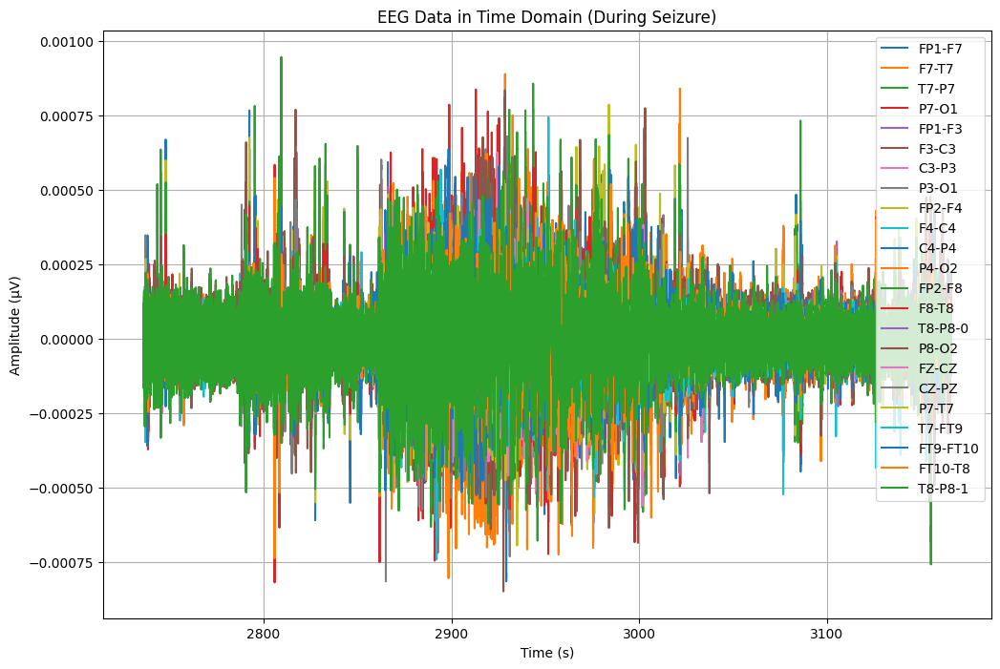

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA8['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA8.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA8[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


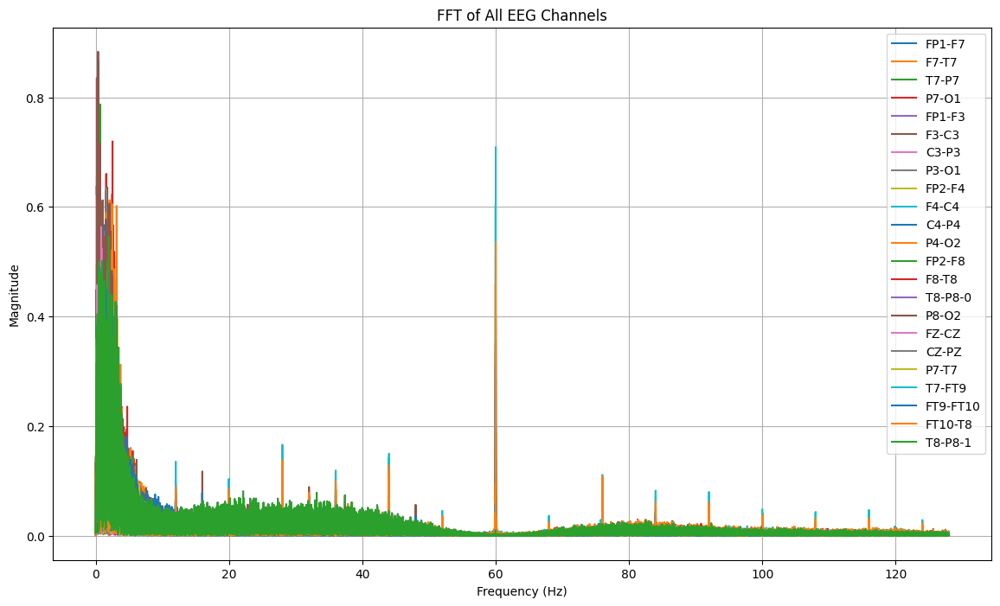

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA8[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2856:
        return "tidak kejang"
    elif 2856 <= row['Time'] < 3046:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_8 = TA8.copy()
TA_8['seizure'] = TA_8.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_8[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure        FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2736.000000  tidak kejang  1.504274e-05 -0.000051 -0.000027 -0.000053   
1  2736.003906  tidak kejang  1.582418e-05 -0.000064 -0.000007 -0.000063   
2  2736.007812  tidak kejang -8.791209e-06  0.000014 -0.000055 -0.000087   
3  2736.011719  tidak kejang -5.860806e-07  0.000022 -0.000078 -0.000071   
4  2736.015625  tidak kejang  2.481074e-05 -0.000013 -0.000064 -0.000061   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -5.860806e-07 -0.000029 -0.000035 -0.000050  ...  0.000031 -0.000069   
1 -1.660562e-05 -0.000009 -0.000038 -0.000054  ...  0.000002 -0.000063   
2 -3.926740e-05  0.000010 -0.000062 -0.000045  ...  0.000041 -0.000084   
3 -4.903541e-05  0.000023 -0.000057 -0.000046  ... -0.000008 -0.000006   
4 -3.301587e-05  0.000004 -0.000024 -0.000062  ... -0.000038 -0.000014   

      P8-O2         FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0 -0.000042 -1.894994e-05

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_8['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,48640


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_8)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 430.0 detik


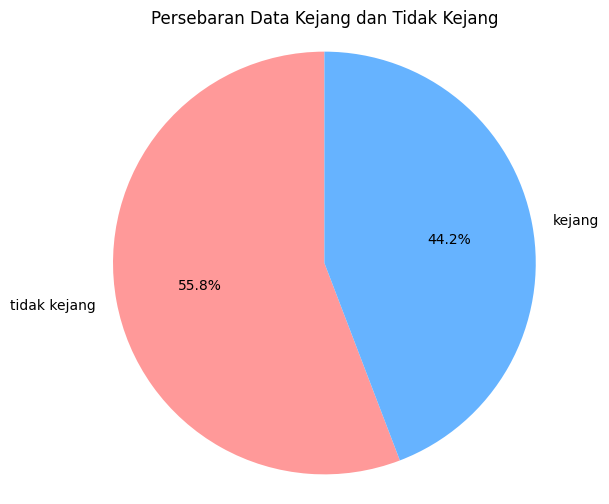

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_8['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_8.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_05.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_8.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_8['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.93      0.95      9727
tidak kejang       0.95      0.98      0.97     12289

    accuracy                           0.96     22016
   macro avg       0.96      0.96      0.96     22016
weighted avg       0.96      0.96      0.96     22016

Akurasi: 0.960437863372093
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.93      0.95      9727
tidak kejang       0.95      0.98      0.97     12289

    accuracy                           0.96     22016
   macro avg       0.96      0.96      0.96     22016
weighted avg       0.96      0.96      0.96     22016



# DATA 9 (chb08_11)

In [ ]:
# mengimport file edf
file9 = "/content/drive/MyDrive/TA/EDF/chb08_11.edf"
data9 = mne.io.read_raw_edf(file9) # membaca file edf dan menyimpannya di data
data9


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-3-ce9e7af4cfec>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data9 = mne.io.read_raw_edf(file9) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_11.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data9.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data9.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data9.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df9 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df9['Time'] = times  # Menambahkan kolom waktu
df9.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.269841e-05,-1.041270e-04,2.381441e-04,-8.009768e-06,5.450549e-05,-6.837607e-06,-1.699634e-05,8.263736e-05,1.619536e-04,-8.791209e-06,...,-1.123321e-04,9.963370e-06,2.285714e-05,-4.590965e-05,-2.377534e-04,1.986813e-04,-1.855922e-05,1.037363e-04,-1.123321e-04,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,...,-5.860806e-07,2.539683e-06,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-5.860806e-07,-5.860806e-07,0.011719
4,-9.768010e-07,3.321123e-06,1.953602e-07,-9.768010e-07,-5.860806e-07,1.367521e-06,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,...,-6.446886e-06,-5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,6.446886e-06,-6.446886e-06,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df9.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df9.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.595972e-07,2.506648e-07,1.177779e-07,2.454908e-07,2.447700e-07,2.035053e-07,1.942431e-07,1.966876e-07,2.520973e-07,1.893218e-07,...,1.455374e-07,2.174162e-07,1.964248e-07,1.972036e-07,2.729425e-07,9.324761e-08,1.935821e-07,2.988918e-07,1.455374e-07,1799.998047
std,1.123584e-04,1.043355e-04,1.081849e-04,8.314816e-05,1.136199e-04,6.035296e-05,4.184058e-05,5.541886e-05,1.021967e-04,4.865488e-05,...,8.284152e-05,7.139008e-05,4.673871e-05,3.896794e-05,1.081849e-04,1.006060e-04,9.024695e-05,6.719972e-05,8.284152e-05,1039.231048
min,-8.433700e-04,-1.537289e-03,-1.611136e-03,-6.206593e-04,-9.426129e-04,-6.835653e-04,-6.331624e-04,-7.296703e-04,-1.629499e-03,-9.730891e-04,...,-1.874481e-03,-1.165714e-03,-6.499634e-04,-6.917705e-04,-9.308913e-04,-1.626374e-03,-7.519414e-04,-9.301099e-04,-1.874481e-03,0.000000
25%,-4.200244e-05,-4.747253e-05,-5.997558e-05,-5.020757e-05,-4.708181e-05,-3.184371e-05,-2.246642e-05,-3.028083e-05,-3.848596e-05,-2.090354e-05,...,-4.239316e-05,-3.965812e-05,-2.207570e-05,-2.051282e-05,-6.427350e-05,-3.575092e-05,-3.809524e-05,-2.989011e-05,-4.239316e-05,899.999023
50%,-2.148962e-06,-1.367521e-06,2.930403e-06,-5.860806e-07,-2.148962e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,-2.539683e-06,2.930403e-06,1.953602e-07,-1.367521e-06,1.367521e-06,1799.998047
75%,3.536020e-05,4.512821e-05,6.466422e-05,4.903541e-05,4.004884e-05,3.145299e-05,2.285714e-05,3.028083e-05,3.145299e-05,2.129426e-05,...,4.434676e-05,3.965812e-05,2.168498e-05,2.090354e-05,6.036630e-05,4.239316e-05,3.887668e-05,2.715507e-05,4.434676e-05,2699.997070
max,1.391941e-03,1.594725e-03,9.312821e-04,7.621001e-04,1.177436e-03,6.542613e-04,6.495726e-04,8.957265e-04,1.431404e-03,8.390720e-04,...,7.105250e-04,8.300855e-04,1.261050e-03,3.811477e-04,1.611526e-03,1.540806e-03,7.746032e-04,1.286447e-03,7.105250e-04,3599.996094


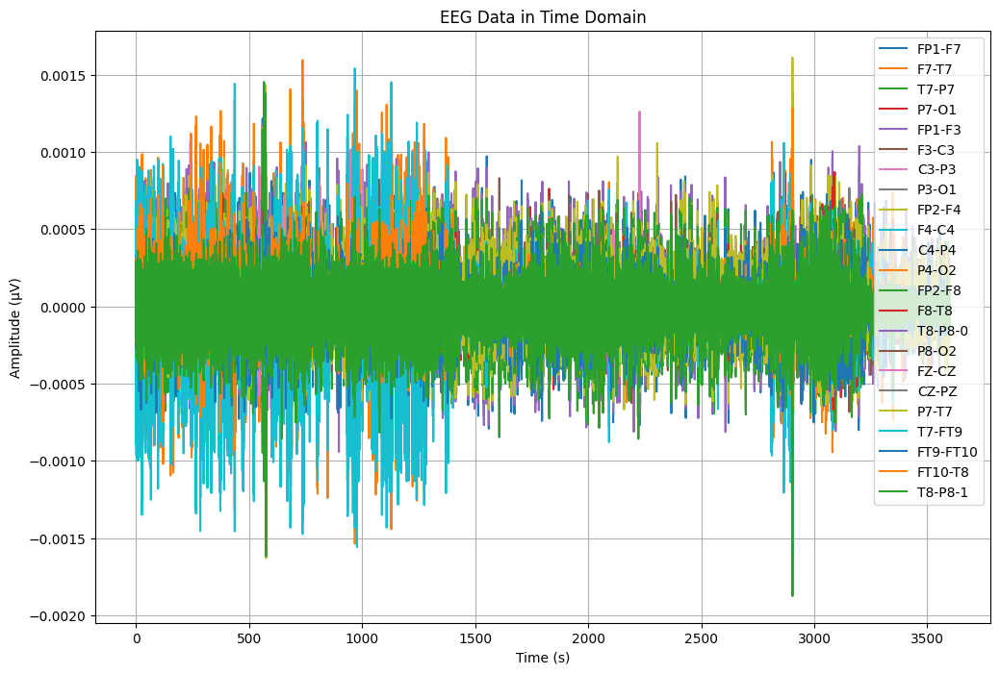

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df9['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df9[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


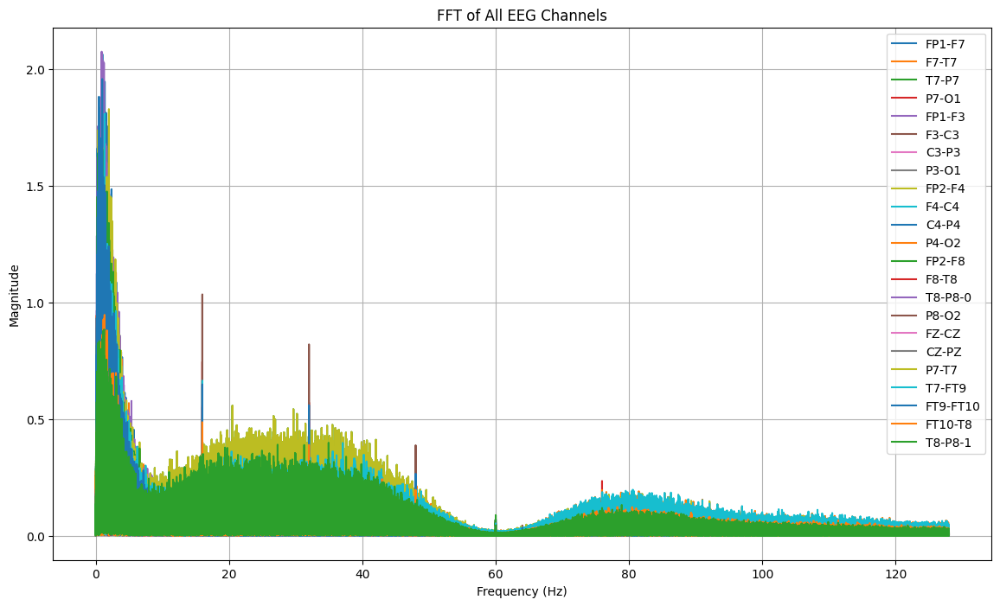

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df9[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_11.csv"
df9.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_11.csv


In [ ]:
#Import Data CSV
dataTA9 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_11.csv")
dataTA9


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.269841e-05,-1.041270e-04,2.381441e-04,-8.009768e-06,5.450549e-05,-6.837607e-06,-1.699634e-05,8.263736e-05,1.619536e-04,-8.791209e-06,...,-1.123321e-04,9.963370e-06,2.285714e-05,-4.590965e-05,-2.377534e-04,1.986813e-04,-1.855922e-05,1.037363e-04,-1.123321e-04,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,...,-5.860806e-07,2.539683e-06,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-5.860806e-07,-5.860806e-07,0.011719
4,-9.768010e-07,3.321123e-06,1.953602e-07,-9.768010e-07,-5.860806e-07,1.367521e-06,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,...,-6.446886e-06,-5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,6.446886e-06,-6.446886e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-4.551893e-05,1.582418e-05,2.090354e-05,2.910867e-05,-8.791209e-06,3.145299e-05,-1.504274e-05,1.308913e-05,-2.148962e-06,3.496947e-05,...,2.637363e-05,5.098901e-05,4.122100e-05,-1.582418e-05,-2.051282e-05,-2.930403e-06,-2.090354e-05,8.400488e-06,2.637363e-05,3599.980469
921596,-3.496947e-05,4.747253e-05,-3.692308e-05,5.763126e-05,-8.009768e-06,2.910867e-05,-1.035409e-05,2.246642e-05,-1.035409e-05,5.177045e-05,...,2.871795e-05,5.255189e-05,4.122100e-05,-1.934066e-05,3.731380e-05,-4.161172e-05,-2.207570e-05,2.148962e-06,2.871795e-05,3599.984375
921597,-3.184371e-05,3.887668e-05,-1.699634e-05,4.825397e-05,-1.367521e-06,1.894994e-05,-8.009768e-06,2.793651e-05,1.035409e-05,4.278388e-05,...,1.504274e-05,5.489621e-05,3.770452e-05,-2.129426e-05,1.738706e-05,-3.496947e-05,-2.051282e-05,2.148962e-06,1.504274e-05,3599.988281
921598,-3.301587e-05,-6.056166e-06,3.536020e-05,3.848596e-05,2.168498e-05,-1.152625e-05,-3.321123e-06,2.715507e-05,4.630037e-05,2.285714e-05,...,4.493284e-06,5.098901e-05,3.457875e-05,-2.168498e-05,-3.496947e-05,5.274725e-06,-1.816850e-05,1.035409e-05,4.493284e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA9[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA9[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA9[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data9, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F3, Max Frequency: 0.90 Hz, Magnitude: 2.074426, Time: 559.378906 s
Channel: FP1-F7, Max Frequency: 1.01 Hz, Magnitude: 2.063422, Time: 2903.667969 s
Channel: FT9-FT10, Max Frequency: 0.98 Hz, Magnitude: 1.957143, Time: 602.988281 s
Channel: FP2-F4, Max Frequency: 1.98 Hz, Magnitude: 1.828329, Time: 574.855469 s
Channel: T7-FT9, Max Frequency: 1.33 Hz, Magnitude: 1.807877, Time: 2903.660156 s
Channel: FP2-F8, Max Frequency: 0.64 Hz, Magnitude: 1.684171, Time: 574.855469 s
Channel: F7-T7, Max Frequency: 0.44 Hz, Magnitude: 1.538784, Time: 736.300781 s
Channel: F8-T8, Max Frequency: 0.60 Hz, Magnitude: 1.217178, Time: 2903.648438 s
Channel: T7-P7, Max Frequency: 1.42 Hz, Magnitude: 1.142945, Time: 2903.660156 s
Channel: P7-T7, Max Frequency: 1.42 Hz, Magnitude: 1.142945, Time: 2903.660156 s
Channel: F3-C3, Max Frequency: 0.58 Hz, Magnitude: 1.091470, Time: 3155.304688 s
Channel: P4-O2, Max Frequen

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P4-O2, Max Frequency: 1.00 Hz, Magnitude: 1.077237, Time: 544.687500 s
Channel: C3-P3, Max Frequency: 0.94 Hz, Magnitude: 0.672631, Time: 559.320312 s
Channel: C4-P4, Max Frequency: 1.68 Hz, Magnitude: 0.740036, Time: 559.320312 s
Channel: FP1-F3, Max Frequency: 0.90 Hz, Magnitude: 2.074426, Time: 559.378906 s
Channel: FP2-F4, Max Frequency: 1.98 Hz, Magnitude: 1.828329, Time: 574.855469 s
Channel: FP2-F8, Max Frequency: 0.64 Hz, Magnitude: 1.684171, Time: 574.855469 s
Channel: FT9-FT10, Max Frequency: 0.98 Hz, Magnitude: 1.957143, Time: 602.988281 s
Channel: F7-T7, Max Frequency: 0.44 Hz, Magnitude: 1.538784, Time: 736.300781 s
Channel: P3-O1, Max Frequency: 0.65 Hz, Magnitude: 1.022641, Time: 810.730469 s
Channel: F4-C4, Max Frequency: 0.42 Hz, Magnitude: 0.832061, Time: 948.496094 s
Channel: P7-O1, Max Frequency: 0.95 Hz, Magnitude: 0.997358, Time: 1827.324219 s
Chan

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2868   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3242    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut9 = dataTA9.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut9.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_11.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA9 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_11.csv")
TA9.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000165,-0.000169,-0.000053,-4.102564e-06,0.000011,-0.000042,-8.400488e-06,-0.000022,0.000132,-0.000013,...,0.000114,-0.000031,-0.000016,-0.000021,0.000053,0.000092,-0.000232,0.000094,0.000114,2868.000000
1,0.000169,-0.000215,-0.000019,-1.953602e-07,-0.000004,-0.000058,5.860806e-07,-0.000005,0.000199,-0.000039,...,0.000049,-0.000042,-0.000022,-0.000033,0.000019,0.000148,-0.000360,0.000243,0.000049,2868.003906
2,0.000267,-0.000166,-0.000141,-4.004884e-05,0.000001,-0.000017,-3.340659e-05,-0.000029,0.000189,-0.000049,...,0.000099,-0.000024,-0.000017,-0.000037,0.000141,-0.000106,-0.000258,0.000171,0.000099,2868.007812
3,0.000026,0.000080,-0.000210,-2.832723e-05,-0.000024,-0.000038,-3.223443e-05,-0.000038,0.000147,-0.000042,...,0.000121,0.000027,-0.000021,-0.000033,0.000210,-0.000224,-0.000239,0.000156,0.000121,2868.011719
4,0.000114,-0.000191,-0.000092,3.145299e-05,-0.000031,-0.000073,-8.009768e-06,-0.000024,0.000166,-0.000043,...,0.000116,0.000049,-0.000021,-0.000028,0.000092,0.000054,-0.000392,0.000184,0.000116,2868.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA9.shape


(95744, 24)

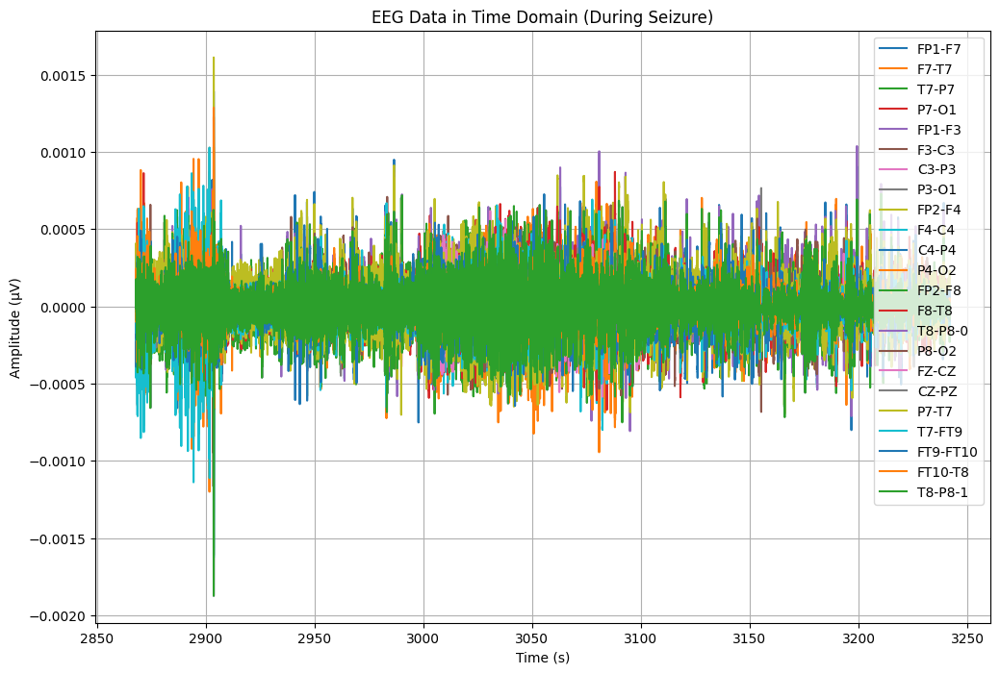

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA9['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA9.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA9[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


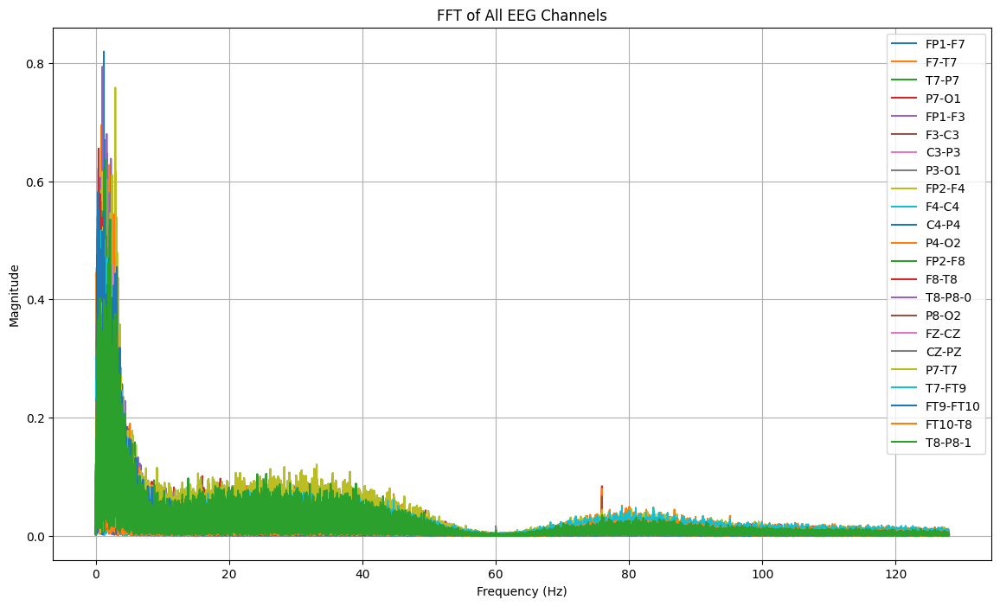

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA9[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2988:
        return "tidak kejang"
    elif 2988 <= row['Time'] < 3122:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_9 = TA9.copy()
TA_9['seizure'] = TA_9.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_9[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())



          Time       seizure    FP1-F7     F7-T7     T7-P7         P7-O1  \
0  2868.000000  tidak kejang  0.000165 -0.000169 -0.000053 -4.102564e-06   
1  2868.003906  tidak kejang  0.000169 -0.000215 -0.000019 -1.953602e-07   
2  2868.007812  tidak kejang  0.000267 -0.000166 -0.000141 -4.004884e-05   
3  2868.011719  tidak kejang  0.000026  0.000080 -0.000210 -2.832723e-05   
4  2868.015625  tidak kejang  0.000114 -0.000191 -0.000092  3.145299e-05   

     FP1-F3     F3-C3         C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0  0.000011 -0.000042 -8.400488e-06 -0.000022  ...  0.000161  0.000114   
1 -0.000004 -0.000058  5.860806e-07 -0.000005  ...  0.000027  0.000049   
2  0.000001 -0.000017 -3.340659e-05 -0.000029  ... -0.000004  0.000099   
3 -0.000024 -0.000038 -3.223443e-05 -0.000038  ... -0.000129  0.000121   
4 -0.000031 -0.000073 -8.009768e-06 -0.000024  ... -0.000122  0.000116   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0 -0.000031 -0.000016 -

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_9['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,34304


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_9)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 374.0 detik


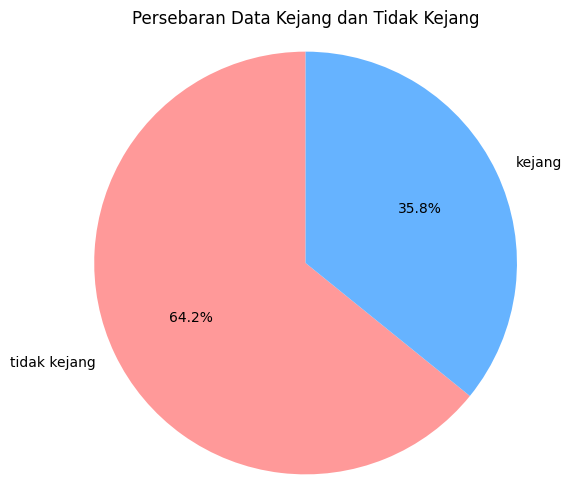

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_9['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_9.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_11.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_9.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_9['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))



              precision    recall  f1-score   support

      kejang       0.98      0.89      0.94      6894
tidak kejang       0.94      0.99      0.97     12255

    accuracy                           0.96     19149
   macro avg       0.96      0.94      0.95     19149
weighted avg       0.96      0.96      0.96     19149

Akurasi: 0.9563945897958118
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.89      0.94      6894
tidak kejang       0.94      0.99      0.97     12255

    accuracy                           0.96     19149
   macro avg       0.96      0.94      0.95     19149
weighted avg       0.96      0.96      0.96     19149



# DATA 10 (chb08_13)

In [ ]:
# mengimport file edf
file10 = "/content/drive/MyDrive/TA/EDF/chb08_13.edf"
data10 = mne.io.read_raw_edf(file10) # membaca file edf dan menyimpannya di data
data10


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-27-0f0457fd6ae0>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data10 = mne.io.read_raw_edf(file10) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_13.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data10.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data10.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data10.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df10 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df10['Time'] = times  # Menambahkan kolom waktu
df10.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-6.446886e-06,-5.665446e-06,6.388278e-05,-1.353846e-04,-1.002198e-04,7.130647e-05,-4.981685e-05,-4.884005e-06,-2.871795e-05,-8.009768e-06,...,8.537241e-05,-7.677656e-05,-1.777778e-05,1.191697e-05,-6.349206e-05,1.426129e-05,-4.200244e-05,-6.446886e-06,8.537241e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,5.860806e-07,-9.768010e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,5.860806e-07,...,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,9.768010e-07,-1.758242e-06,-1.367521e-06,3.321123e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.758242e-06,2.148962e-06,1.953602e-07,-1.953602e-07,-5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df10.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df10.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.481231e-07,2.407361e-07,1.431272e-07,2.382949e-07,2.386549e-07,2.050714e-07,2.017306e-07,1.833096e-07,2.512579e-07,1.881279e-07,...,1.505143e-07,2.163233e-07,1.923191e-07,1.966817e-07,2.475932e-07,1.310457e-07,1.801820e-07,2.814535e-07,1.505143e-07,1799.998047
std,9.867320e-05,7.984920e-05,9.267316e-05,7.717736e-05,1.057126e-04,5.902802e-05,4.303330e-05,5.273376e-05,8.966201e-05,4.501741e-05,...,6.983931e-05,6.354813e-05,4.529127e-05,4.082090e-05,9.267316e-05,6.194230e-05,8.805674e-05,4.766130e-05,6.983931e-05,1039.231048
min,-1.062564e-03,-1.550183e-03,-7.535043e-04,-6.421490e-04,-1.068425e-03,-9.207326e-04,-9.793407e-04,-9.891087e-04,-8.230525e-04,-8.738462e-04,...,-9.133089e-04,-7.808547e-04,-6.026862e-04,-4.909402e-04,-8.277411e-04,-1.203223e-03,-7.429548e-04,-8.843956e-04,-9.133089e-04,0.000000
25%,-3.692308e-05,-4.239316e-05,-5.489621e-05,-4.551893e-05,-4.395604e-05,-3.262515e-05,-2.402930e-05,-2.949939e-05,-3.340659e-05,-2.051282e-05,...,-3.692308e-05,-3.575092e-05,-2.207570e-05,-2.207570e-05,-5.645910e-05,-3.262515e-05,-3.614164e-05,-2.442002e-05,-3.692308e-05,899.999023
50%,-1.758242e-06,-9.768010e-07,1.367521e-06,1.953602e-07,-1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.367521e-06,5.860806e-07,-5.860806e-07,9.768010e-07,1799.998047
75%,3.223443e-05,4.122100e-05,5.684982e-05,4.551893e-05,3.887668e-05,3.262515e-05,2.402930e-05,3.028083e-05,2.871795e-05,2.129426e-05,...,3.809524e-05,3.575092e-05,2.246642e-05,2.246642e-05,5.528694e-05,3.457875e-05,3.731380e-05,2.402930e-05,3.809524e-05,2699.997070
max,8.629060e-04,1.283712e-03,8.281319e-04,7.390476e-04,1.187595e-03,6.734066e-04,8.695482e-04,1.207131e-03,9.910623e-04,5.761172e-04,...,8.250061e-04,1.156728e-03,8.937729e-04,7.730403e-04,7.538950e-04,1.349353e-03,7.367033e-04,1.124689e-03,8.250061e-04,3599.996094


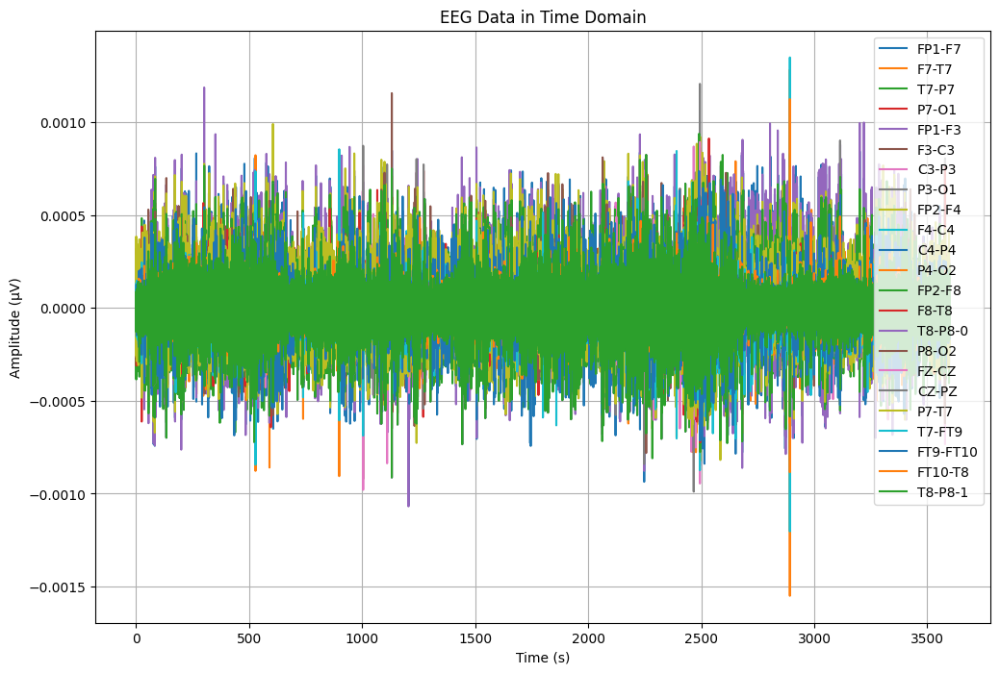

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df10['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df10[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


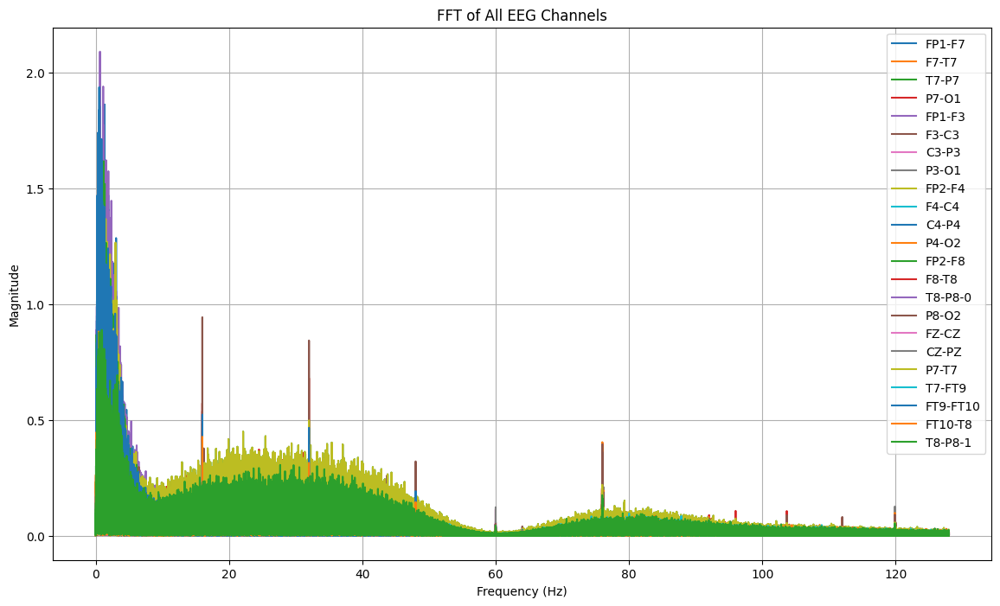

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df10[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_13.csv"
df10.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_13.csv


In [ ]:
#Import Data CSV
dataTA10 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_13.csv")
dataTA10


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-6.446886e-06,-5.665446e-06,6.388278e-05,-1.353846e-04,-1.002198e-04,7.130647e-05,-4.981685e-05,-4.884005e-06,-2.871795e-05,-8.009768e-06,...,8.537241e-05,-7.677656e-05,-1.777778e-05,1.191697e-05,-6.349206e-05,1.426129e-05,-4.200244e-05,-6.446886e-06,8.537241e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,5.860806e-07,5.860806e-07,-9.768010e-07,-5.860806e-07,5.860806e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,5.860806e-07,...,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,9.768010e-07,-1.758242e-06,-1.367521e-06,3.321123e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.758242e-06,2.148962e-06,1.953602e-07,-1.953602e-07,-5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,3.262515e-05,6.056166e-06,8.537241e-05,-1.152625e-05,5.997558e-05,-9.181929e-06,2.168498e-05,3.926740e-05,6.153846e-05,-3.653236e-05,...,1.064713e-04,1.953602e-07,-2.442002e-05,-2.930403e-06,-8.498168e-05,1.113553e-05,-1.894994e-05,-4.161172e-05,1.064713e-04,3599.980469
921596,2.520147e-05,1.699634e-05,5.763126e-05,4.102564e-06,6.192918e-05,-7.619048e-06,1.543346e-05,3.496947e-05,4.825397e-05,-3.262515e-05,...,8.615385e-05,-4.493284e-06,-2.129426e-05,-4.102564e-06,-5.724054e-05,-3.711844e-06,-5.860806e-07,-2.285714e-05,8.615385e-05,3599.984375
921597,1.660562e-05,2.637363e-05,4.004884e-05,1.543346e-05,5.880342e-05,-7.228327e-06,1.387057e-05,3.340659e-05,3.496947e-05,-3.067155e-05,...,7.638584e-05,-1.367521e-06,-2.012210e-05,-9.768010e-07,-3.965812e-05,-1.660562e-05,6.446886e-06,-1.621490e-05,7.638584e-05,3599.988281
921598,1.035409e-05,3.887668e-05,2.324786e-05,2.129426e-05,4.903541e-05,-3.711844e-06,1.699634e-05,3.223443e-05,5.059829e-05,-2.989011e-05,...,6.661783e-05,1.308913e-05,-1.699634e-05,5.860806e-07,-2.285714e-05,-3.614164e-05,8.400488e-06,-2.324786e-05,6.661783e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA10[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA10[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA10[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data10, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F3, Max Frequency: 0.65 Hz, Magnitude: 2.092038, Time: 301.097656 s
Channel: FT9-FT10, Max Frequency: 0.53 Hz, Magnitude: 1.938402, Time: 1745.777344 s
Channel: FP1-F7, Max Frequency: 1.34 Hz, Magnitude: 1.863835, Time: 1205.023438 s
Channel: FP2-F8, Max Frequency: 0.65 Hz, Magnitude: 1.663504, Time: 2490.613281 s
Channel: FP2-F4, Max Frequency: 0.97 Hz, Magnitude: 1.547106, Time: 605.382812 s
Channel: F7-T7, Max Frequency: 0.72 Hz, Magnitude: 1.397595, Time: 2892.339844 s
Channel: P8-O2, Max Frequency: 0.81 Hz, Magnitude: 1.210282, Time: 1131.144531 s
Channel: T7-FT9, Max Frequency: 0.94 Hz, Magnitude: 1.146203, Time: 2892.339844 s
Channel: P4-O2, Max Frequency: 0.85 Hz, Magnitude: 1.108564, Time: 3114.476562 s
Channel: P7-T7, Max Frequency: 0.94 Hz, Magnitude: 1.094053, Time: 2892.339844 s
Channel: T7-P7, Max Frequency: 0.94 Hz, Magnitude: 1.094053, Time: 2892.339844 s
Channel: F8-T8, Max Freq

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 0.65 Hz, Magnitude: 2.092038, Time: 301.097656 s
Channel: FP2-F4, Max Frequency: 0.97 Hz, Magnitude: 1.547106, Time: 605.382812 s
Channel: F3-C3, Max Frequency: 0.99 Hz, Magnitude: 1.002002, Time: 1004.218750 s
Channel: C3-P3, Max Frequency: 0.96 Hz, Magnitude: 0.747837, Time: 1004.464844 s
Channel: T8-P8-0, Max Frequency: 0.91 Hz, Magnitude: 0.889674, Time: 1131.144531 s
Channel: P8-O2, Max Frequency: 0.81 Hz, Magnitude: 1.210282, Time: 1131.144531 s
Channel: T8-P8-1, Max Frequency: 0.91 Hz, Magnitude: 0.889674, Time: 1131.144531 s
Channel: FP1-F7, Max Frequency: 1.34 Hz, Magnitude: 1.863835, Time: 1205.023438 s
Channel: P7-O1, Max Frequency: 1.12 Hz, Magnitude: 0.942907, Time: 1271.742188 s
Channel: CZ-PZ, Max Frequency: 0.75 Hz, Magnitude: 0.696419, Time: 1271.746094 s
Channel: FT9-FT10, Max Frequency: 0.53 Hz, Magnitude: 1.938402, Time: 1745.7

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2297   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2697    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut10 = dataTA10.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut10.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_13.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA10 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_13.csv")
TA10.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000043,-0.000042,0.000119,-0.000149,0.000071,-0.000028,-0.000009,-0.000063,0.000003,0.000027,...,-0.000020,0.000050,-0.000030,1.953602e-07,-0.000118,2.832723e-05,-0.000016,0.000005,-0.000020,2297.000000
1,0.000038,-0.000010,0.000026,-0.000057,0.000077,-0.000029,-0.000003,-0.000047,0.000021,0.000021,...,0.000023,0.000041,-0.000034,6.056166e-06,-0.000025,1.953602e-07,-0.000013,-0.000048,0.000023,2297.003906
2,0.000050,-0.000028,-0.000022,0.000032,0.000081,-0.000034,-0.000009,-0.000006,0.000016,0.000021,...,0.000017,0.000064,-0.000034,1.582418e-05,0.000022,6.056166e-06,-0.000021,-0.000003,0.000017,2297.007812
3,0.000054,-0.000035,-0.000044,0.000038,0.000078,-0.000042,-0.000005,-0.000015,0.000001,0.000013,...,-0.000047,0.000069,-0.000038,1.855922e-05,0.000044,2.129426e-05,-0.000037,0.000052,-0.000047,2297.011719
4,0.000058,0.000002,-0.000078,0.000051,0.000075,-0.000042,0.000012,-0.000010,-0.000026,0.000021,...,-0.000044,0.000016,-0.000042,1.934066e-05,0.000078,-3.028083e-05,-0.000023,0.000077,-0.000044,2297.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA10.shape


(102400, 24)

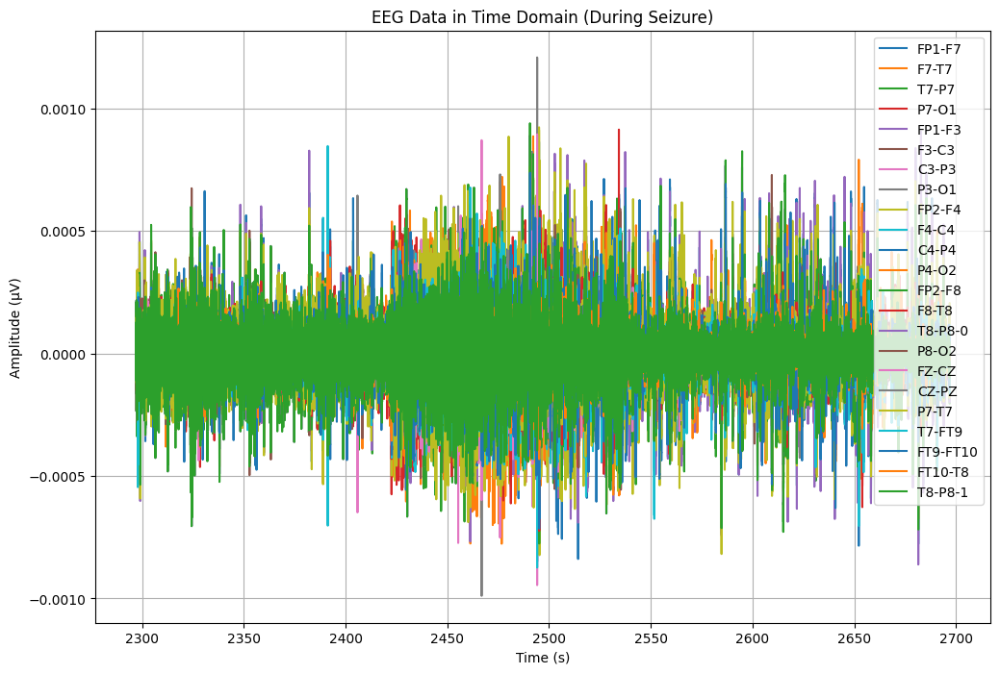

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA10['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA10.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA10[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


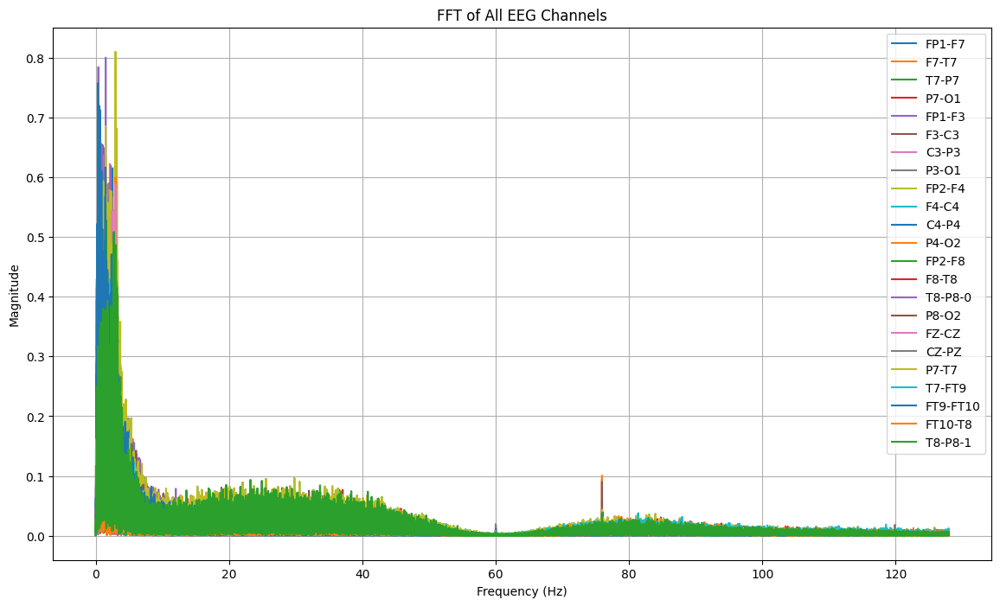

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA10[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2417:
        return "tidak kejang"
    elif 2417 <= row['Time'] < 2577:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_10 = TA10.copy()
TA_10['seizure'] = TA_10.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_10[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2297.000000  tidak kejang  0.000043 -0.000042  0.000119 -0.000149   
1  2297.003906  tidak kejang  0.000038 -0.000010  0.000026 -0.000057   
2  2297.007812  tidak kejang  0.000050 -0.000028 -0.000022  0.000032   
3  2297.011719  tidak kejang  0.000054 -0.000035 -0.000044  0.000038   
4  2297.015625  tidak kejang  0.000058  0.000002 -0.000078  0.000051   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000071 -0.000028 -0.000009 -0.000063  ...  0.000042 -0.000020  0.000050   
1  0.000077 -0.000029 -0.000003 -0.000047  ... -0.000006  0.000023  0.000041   
2  0.000081 -0.000034 -0.000009 -0.000006  ...  0.000029  0.000017  0.000064   
3  0.000078 -0.000042 -0.000005 -0.000015  ...  0.000078 -0.000047  0.000069   
4  0.000075 -0.000042  0.000012 -0.000010  ...  0.000110 -0.000044  0.000016   

      FZ-CZ         CZ-PZ     P7-T7        T7-FT9  FT9-FT10   FT10-T8  \
0 -0.000030  

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_10['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,40960


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_10)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 400.0 detik


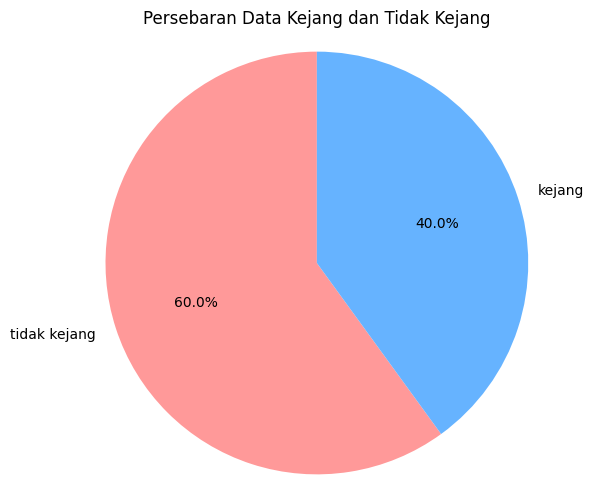

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_10['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_10.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_13.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_10.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_10['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      8205
tidak kejang       0.93      0.99      0.96     12275

    accuracy                           0.95     20480
   macro avg       0.96      0.94      0.95     20480
weighted avg       0.95      0.95      0.95     20480

Akurasi: 0.9501953125
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      8205
tidak kejang       0.93      0.99      0.96     12275

    accuracy                           0.95     20480
   macro avg       0.96      0.94      0.95     20480
weighted avg       0.95      0.95      0.95     20480



# DATA 11 (chb11_82)

In [ ]:
# mengimport file edf
file11 = "/content/drive/MyDrive/TA/EDF/chb11_82.edf"
data11 = mne.io.read_raw_edf(file11) # membaca file edf dan menyimpannya di data
data11


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb11_82.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-51-1bb0ef246e02>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8', '-'}. Applying running numbers for duplicates.
  data11 = mne.io.read_raw_edf(file11) # membaca file edf dan menyimpannya di data


<RawEDF | chb11_82.edf, 28 x 921600 (3600.0 s), ~32 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data11.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data11.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data11.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 '--0',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 '--1',
 'FZ-CZ',
 'CZ-PZ',
 '--2',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 '--3',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 '--4',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df11 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df11['Time'] = times  # Menambahkan kolom waktu
df11.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,6.622711e-05,-6.857143e-05,-4.102564e-06,4.200244e-05,1.953602e-07,-2.442002e-05,6.056166e-06,-3.145299e-05,8.537241e-05,1.953602e-07,...,1.619536e-04,-6.974359e-05,3.106227e-05,1.953602e-07,4.493284e-06,2.100122e-04,-1.572650e-04,-5.997558e-05,-6.974359e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,0.011719
4,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df11.shape)


(921600, 29)


In [ ]:
# mendeskripsikan data
df11.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.852891e-07,2.376687e-07,1.818113e-07,1.710830e-07,1.953602e-07,3.083927e-07,2.056840e-07,2.100881e-07,1.737637e-07,1.953602e-07,...,2.500051e-07,1.726665e-07,1.865262e-07,1.953602e-07,2.089091e-07,1.584775e-07,2.181030e-07,1.999173e-07,1.726665e-07,1799.998047
std,4.320906e-05,3.703641e-05,3.358578e-05,3.644742e-05,2.911677e-22,4.199102e-05,2.101991e-05,1.736408e-05,2.463345e-05,2.911677e-22,...,3.352085e-05,3.140812e-05,2.701736e-05,2.911677e-22,3.358578e-05,3.868148e-05,5.570771e-05,3.149197e-05,3.140812e-05,1039.231048
min,-5.854945e-04,-4.971917e-04,-5.429060e-04,-1.469304e-03,1.953602e-07,-7.034921e-04,-3.885714e-04,-1.553114e-04,-3.237118e-04,1.953602e-07,...,-5.436874e-04,-4.338950e-04,-3.920879e-04,1.953602e-07,-1.483370e-03,-9.820757e-04,-7.851526e-04,-3.432479e-04,-4.338950e-04,0.000000
25%,-1.777778e-05,-1.934066e-05,-1.894994e-05,-2.012210e-05,1.953602e-07,-1.777778e-05,-1.191697e-05,-9.963370e-06,-1.347985e-05,1.953602e-07,...,-1.777778e-05,-1.855922e-05,-1.543346e-05,1.953602e-07,-1.894994e-05,-1.582418e-05,-2.246642e-05,-1.660562e-05,-1.855922e-05,899.999023
50%,-9.768010e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,1799.998047
75%,1.543346e-05,1.894994e-05,1.934066e-05,2.090354e-05,1.953602e-07,1.426129e-05,1.191697e-05,9.963370e-06,1.387057e-05,1.953602e-07,...,1.738706e-05,1.855922e-05,1.543346e-05,1.953602e-07,1.934066e-05,1.660562e-05,2.207570e-05,1.816850e-05,1.855922e-05,2699.997070
max,6.593407e-04,5.026618e-04,1.483761e-03,5.522833e-04,1.953602e-07,8.261783e-04,2.752625e-04,2.186081e-04,2.803419e-04,1.953602e-07,...,5.323565e-04,4.483516e-04,5.956532e-04,1.953602e-07,5.432967e-04,4.921123e-04,9.062759e-04,6.648107e-04,4.483516e-04,3599.996094


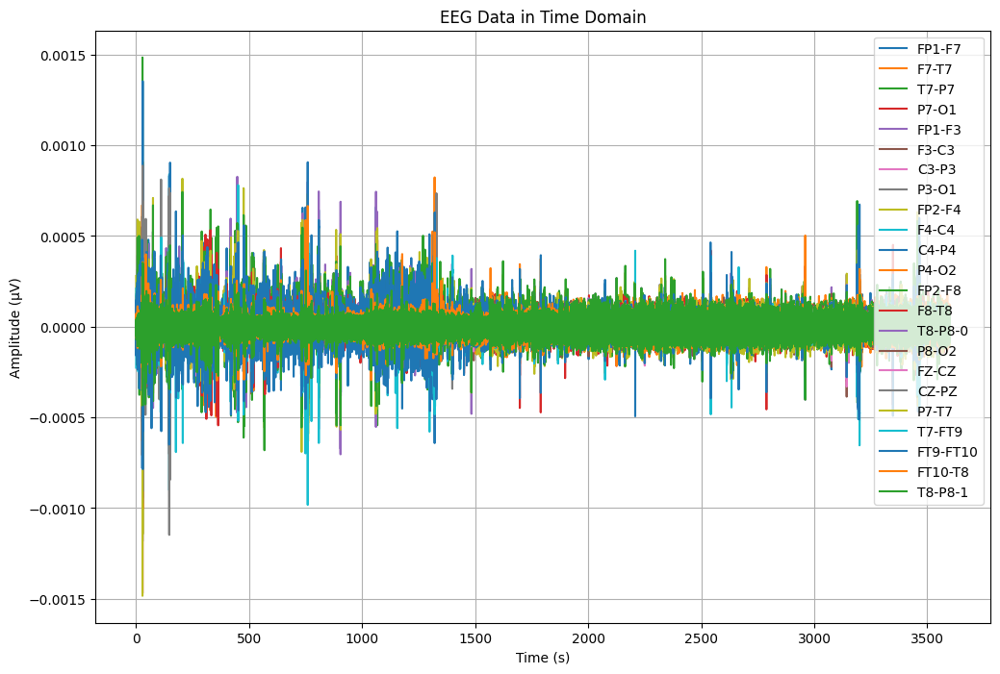

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df11['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df11[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


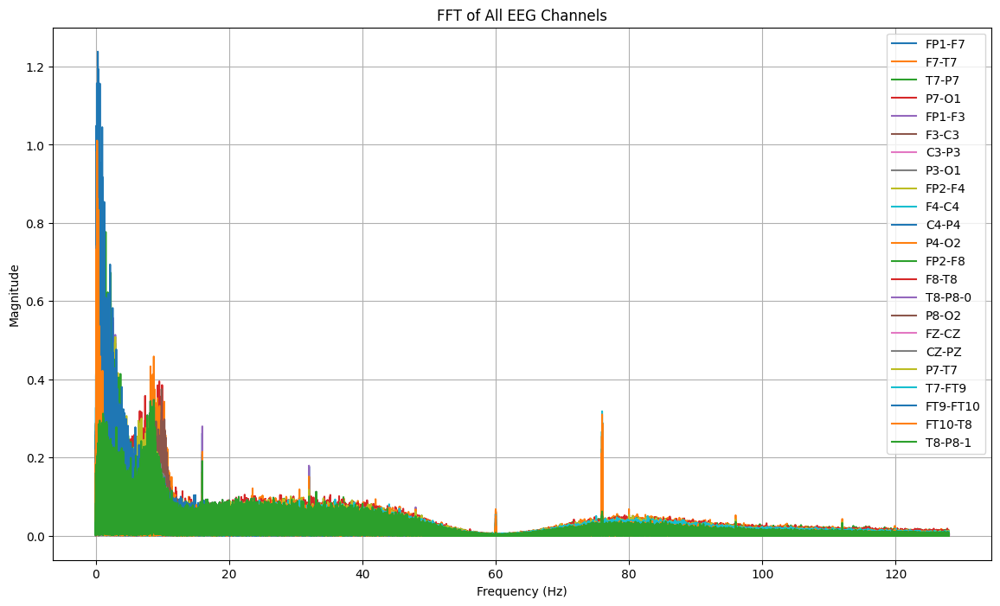

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_82.csv"
df11.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_82.csv


In [ ]:
#Import Data CSV
dataTA11 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_82.csv")
dataTA11


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,6.622711e-05,-6.857143e-05,-4.102564e-06,4.200244e-05,1.953602e-07,-2.442002e-05,6.056166e-06,-3.145299e-05,8.537241e-05,1.953602e-07,...,1.619536e-04,-6.974359e-05,3.106227e-05,1.953602e-07,4.493284e-06,2.100122e-04,-1.572650e-04,-5.997558e-05,-6.974359e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,1.953602e-07,0.011719
4,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-9.572650e-06,1.191697e-05,1.013919e-04,-6.974359e-05,1.953602e-07,-2.324786e-05,-5.665446e-06,2.715507e-05,3.575092e-05,1.953602e-07,...,5.860806e-07,2.168498e-05,-2.168498e-05,1.953602e-07,-1.010012e-04,-7.619048e-06,1.953602e-07,1.953602e-07,2.168498e-05,3599.980469
921596,-1.074481e-05,3.575092e-05,7.716728e-05,-7.873016e-05,1.953602e-07,-2.715507e-05,-5.274725e-06,2.754579e-05,2.832723e-05,1.953602e-07,...,-1.308913e-05,2.481074e-05,-2.402930e-05,1.953602e-07,-7.677656e-05,-2.637363e-05,-2.148962e-06,-1.855922e-05,2.481074e-05,3599.984375
921597,-8.791209e-06,4.708181e-05,6.388278e-05,-8.615385e-05,1.953602e-07,-2.285714e-05,-3.321123e-06,2.481074e-05,1.738706e-05,1.953602e-07,...,-2.871795e-05,2.598291e-05,-2.402930e-05,1.953602e-07,-6.349206e-05,-4.356532e-05,-5.665446e-06,-2.442002e-05,2.598291e-05,3599.988281
921598,-5.665446e-06,4.161172e-05,6.310134e-05,-8.810745e-05,1.953602e-07,-1.660562e-05,1.953602e-07,2.246642e-05,4.884005e-06,1.953602e-07,...,-1.894994e-05,6.837607e-06,-2.832723e-05,1.953602e-07,-6.271062e-05,-4.043956e-05,-5.860806e-07,-1.347985e-05,6.837607e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA11[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA11[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA11[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data11, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.32 Hz, Magnitude: 1.238263, Time: 759.187500 s
Channel: FP2-F8, Max Frequency: 0.35 Hz, Magnitude: 1.131214, Time: 204.769531 s
Channel: T7-FT9, Max Frequency: 0.18 Hz, Magnitude: 1.043418, Time: 759.203125 s
Channel: FT10-T8, Max Frequency: 0.22 Hz, Magnitude: 1.010750, Time: 759.304688 s
Channel: FP2-F4, Max Frequency: 0.25 Hz, Magnitude: 0.939988, Time: 29.414062 s
Channel: FP1-F7, Max Frequency: 0.55 Hz, Magnitude: 0.867302, Time: 1061.261719 s
Channel: FP1-F3, Max Frequency: 0.55 Hz, Magnitude: 0.857826, Time: 447.582031 s
Channel: F4-C4, Max Frequency: 0.35 Hz, Magnitude: 0.781808, Time: 29.308594 s
Channel: CZ-PZ, Max Frequency: 0.15 Hz, Magnitude: 0.701372, Time: 28.308594 s
Channel: F7-T7, Max Frequency: 0.32 Hz, Magnitude: 0.656225, Time: 759.429688 s
Channel: F8-T8, Max Frequency: 0.46 Hz, Magnitude: 0.517399, Time: 363.054688 s
Channel: P4-O2, Max Frequency: 8.

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-P7, Max Frequency: 0.95 Hz, Magnitude: 0.408613, Time: 28.152344 s
Channel: P7-O1, Max Frequency: 0.84 Hz, Magnitude: 0.445338, Time: 28.152344 s
Channel: P7-T7, Max Frequency: 0.95 Hz, Magnitude: 0.408613, Time: 28.152344 s
Channel: CZ-PZ, Max Frequency: 0.15 Hz, Magnitude: 0.701372, Time: 28.308594 s
Channel: F4-C4, Max Frequency: 0.35 Hz, Magnitude: 0.781808, Time: 29.308594 s
Channel: C4-P4, Max Frequency: 0.36 Hz, Magnitude: 0.422662, Time: 29.339844 s
Channel: P4-O2, Max Frequency: 8.72 Hz, Magnitude: 0.458539, Time: 29.351562 s
Channel: P8-O2, Max Frequency: 9.89 Hz, Magnitude: 0.374982, Time: 29.386719 s
Channel: FP2-F4, Max Frequency: 0.25 Hz, Magnitude: 0.939988, Time: 29.414062 s
Channel: P3-O1, Max Frequency: 9.85 Hz, Magnitude: 0.279491, Time: 110.437500 s
Channel: T8-P8-0, Max Frequency: 8.72 Hz, Magnitude: 0.347583, Time: 150.414062 s
Channel: T8-P8-1,

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 178   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 440    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut11 = dataTA11.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut11.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_82.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA11 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_82.csv")
TA11.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000004,-0.000016,-0.000044,0.000005,1.953602e-07,-0.000005,-0.000032,-0.000006,-0.000014,1.953602e-07,...,-0.000027,-0.000013,-1.758242e-06,1.953602e-07,0.000044,0.000039,-0.000022,-0.000017,-0.000013,178.000000
1,-0.000009,-0.000024,-0.000052,0.000018,1.953602e-07,-0.000015,-0.000031,-0.000008,-0.000013,1.953602e-07,...,-0.000011,-0.000028,-5.860806e-07,1.953602e-07,0.000052,0.000044,-0.000026,-0.000002,-0.000028,178.003906
2,-0.000018,-0.000039,-0.000039,0.000020,1.953602e-07,-0.000031,-0.000019,-0.000010,-0.000014,1.953602e-07,...,-0.000028,-0.000037,1.543346e-05,1.953602e-07,0.000039,0.000045,-0.000029,-0.000003,-0.000037,178.007812
3,-0.000015,-0.000059,-0.000014,0.000018,1.953602e-07,-0.000028,-0.000012,-0.000010,-0.000019,1.953602e-07,...,-0.000015,-0.000033,-2.539683e-06,1.953602e-07,0.000014,0.000061,-0.000029,0.000011,-0.000033,178.011719
4,-0.000009,-0.000048,-0.000029,0.000024,1.953602e-07,-0.000008,-0.000022,-0.000012,-0.000020,1.953602e-07,...,-0.000008,-0.000022,-1.660562e-05,1.953602e-07,0.000030,0.000054,-0.000022,0.000004,-0.000022,178.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA11.shape


(67072, 29)

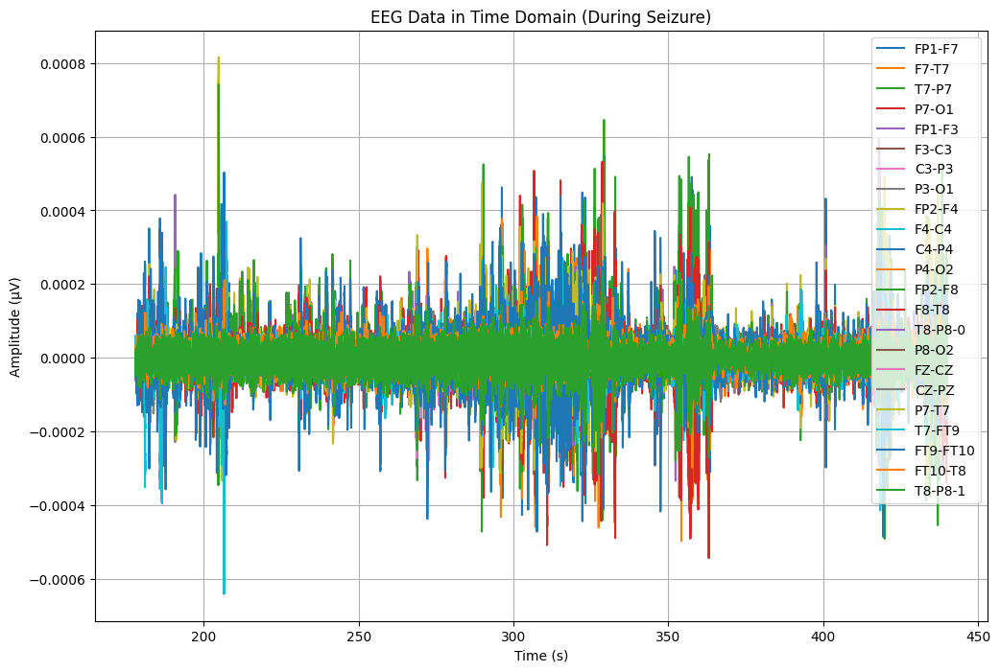

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA11['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA11.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA11[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


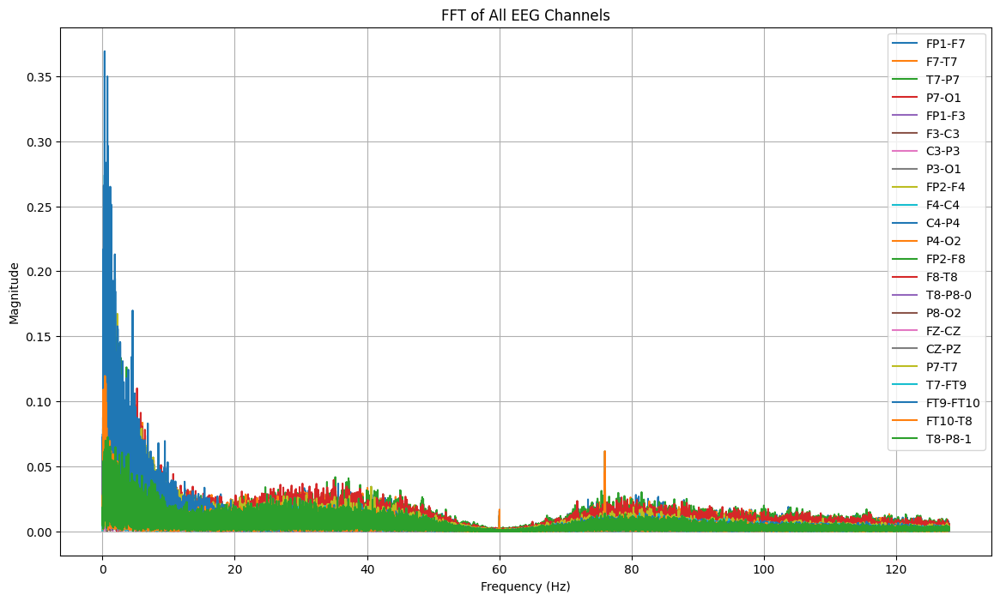

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 298:
        return "tidak kejang"
    elif 298 <= row['Time'] < 320:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_11 = TA11.copy()
TA_11['seizure'] = TA_11.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_11[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  178.000000  tidak kejang -0.000004 -0.000016 -0.000044  0.000005 -0.000005   
1  178.003906  tidak kejang -0.000009 -0.000024 -0.000052  0.000018 -0.000015   
2  178.007812  tidak kejang -0.000018 -0.000039 -0.000039  0.000020 -0.000031   
3  178.011719  tidak kejang -0.000015 -0.000059 -0.000014  0.000018 -0.000028   
4  178.015625  tidak kejang -0.000009 -0.000048 -0.000029  0.000024 -0.000008   

      F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0         P8-O2  \
0 -0.000032 -0.000006 -0.000014  ... -0.000027 -0.000013 -1.758242e-06   
1 -0.000031 -0.000008 -0.000013  ... -0.000011 -0.000028 -5.860806e-07   
2 -0.000019 -0.000010 -0.000014  ... -0.000028 -0.000037  1.543346e-05   
3 -0.000012 -0.000010 -0.000019  ... -0.000015 -0.000033 -2.539683e-06   
4 -0.000022 -0.000012 -0.000020  ... -0.000008 -0.000022 -1.660562e-05   

          FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   

In [ ]:
import pandas as pd

# Misal kita sudah membaca CSV
# df = pd.read_csv('path/to/your/csv.csv')

# Mencari baris pertama di mana 'kejang' dimulai pada kolom 'seizure'
seizure_start_row = TA_11[TA_11['seizure'] == 'kejang'].index[0]

# Menampilkan baris keberapa label 'kejang' dimulai
print(f"Label kejang dimulai pada baris ke-{seizure_start_row}")



Label kejang dimulai pada baris ke-30720


In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_11['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,5632


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_11)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 262.0 detik


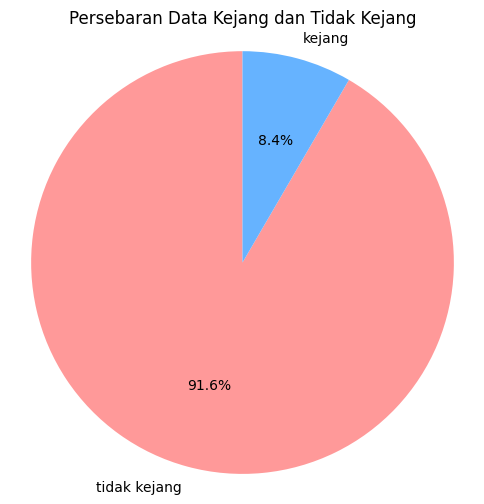

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_11['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_11.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb11_82.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_11.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_11['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.97      0.67      0.79      1176
tidak kejang       0.97      1.00      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.97      0.83      0.89     13415
weighted avg       0.97      0.97      0.97     13415

Akurasi: 0.9693626537458069
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.67      0.79      1176
tidak kejang       0.97      1.00      0.98     12239

    accuracy                           0.97     13415
   macro avg       0.97      0.83      0.89     13415
weighted avg       0.97      0.97      0.97     13415



# DATA 12 (chb11_92)

In [ ]:
# mengimport file edf
file12 = "/content/drive/MyDrive/TA/EDF/chb11_92.edf"
data12 = mne.io.read_raw_edf(file12) # membaca file edf dan menyimpannya di data
data12


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb11_92.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-76-c2e92285a110>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8', '-'}. Applying running numbers for duplicates.
  data12 = mne.io.read_raw_edf(file12) # membaca file edf dan menyimpannya di data


<RawEDF | chb11_92.edf, 28 x 921600 (3600.0 s), ~32 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data12.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data12.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data12.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 '--0',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 '--1',
 'FZ-CZ',
 'CZ-PZ',
 '--2',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 '--3',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 '--4',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df12 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df12['Time'] = times  # Menambahkan kolom waktu
df12.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.802198e-05,5.020757e-05,2.637363e-05,6.622711e-05,1.953602e-07,-2.442002e-05,6.056166e-06,4.356532e-05,5.958486e-05,1.953602e-07,...,3.379731e-05,-5.665446e-06,1.621490e-05,1.953602e-07,-2.598291e-05,-8.459096e-05,9.592186e-05,2.832723e-05,-5.665446e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df12.shape)


(921600, 29)


In [ ]:
# mendeskripsikan data
df12.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.502671e-07,2.371557e-07,1.609191e-07,1.654279e-07,1.953602e-07,2.597464e-07,1.971595e-07,1.795792e-07,1.485136e-07,1.953602e-07,...,2.067452e-07,1.644553e-07,1.767425e-07,1.953602e-07,2.298013e-07,1.305471e-07,2.040238e-07,2.384938e-07,1.644553e-07,1799.998047
std,7.456002e-05,5.131920e-05,5.070621e-05,4.785068e-05,2.911677e-22,6.959877e-05,2.465969e-05,1.975801e-05,2.517862e-05,2.911677e-22,...,5.019231e-05,3.908611e-05,3.598466e-05,2.911677e-22,5.070621e-05,6.173397e-05,9.229235e-05,3.816182e-05,3.908611e-05,1039.231048
min,-8.117216e-04,-5.096947e-04,-1.451331e-03,-1.550183e-03,1.953602e-07,-7.917949e-04,-7.234188e-04,-3.905250e-04,-6.855189e-04,1.953602e-07,...,-7.007570e-04,-1.260269e-03,-9.691819e-04,1.953602e-07,-1.608010e-03,-1.084835e-03,-1.022320e-03,-7.624908e-04,-1.260269e-03,0.000000
25%,-2.051282e-05,-2.129426e-05,-1.855922e-05,-1.934066e-05,1.953602e-07,-2.051282e-05,-1.308913e-05,-9.963370e-06,-1.191697e-05,1.953602e-07,...,-1.934066e-05,-1.621490e-05,-1.465201e-05,1.953602e-07,-1.934066e-05,-1.777778e-05,-3.028083e-05,-1.504274e-05,-1.621490e-05,899.999023
50%,-5.860806e-07,-5.860806e-07,5.860806e-07,9.768010e-07,1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.367521e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1799.998047
75%,1.894994e-05,1.973138e-05,1.973138e-05,2.090354e-05,1.953602e-07,1.699634e-05,1.308913e-05,1.074481e-05,1.308913e-05,1.953602e-07,...,1.934066e-05,1.660562e-05,1.504274e-05,1.953602e-07,1.894994e-05,2.090354e-05,2.910867e-05,1.465201e-05,1.660562e-05,2699.997070
max,1.118046e-03,7.746032e-04,1.608400e-03,1.455238e-03,1.953602e-07,1.271600e-03,2.987057e-04,2.924542e-04,3.307448e-04,1.953602e-07,...,7.914042e-04,1.231746e-03,9.914530e-04,1.953602e-07,1.451722e-03,7.831990e-04,1.114530e-03,1.294652e-03,1.231746e-03,3599.996094


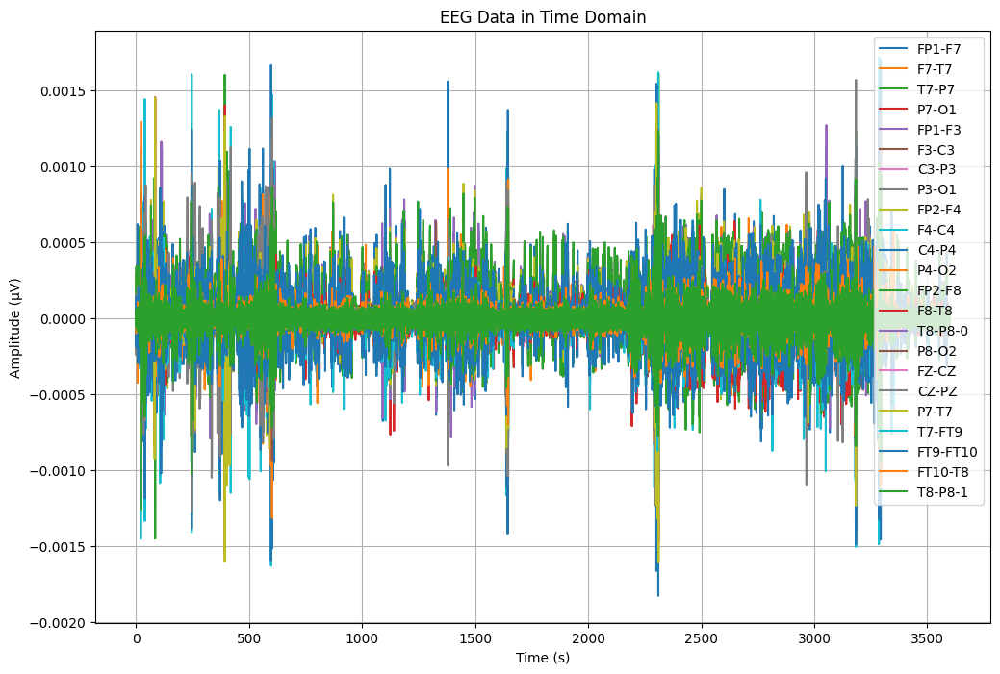

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df12['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df12[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


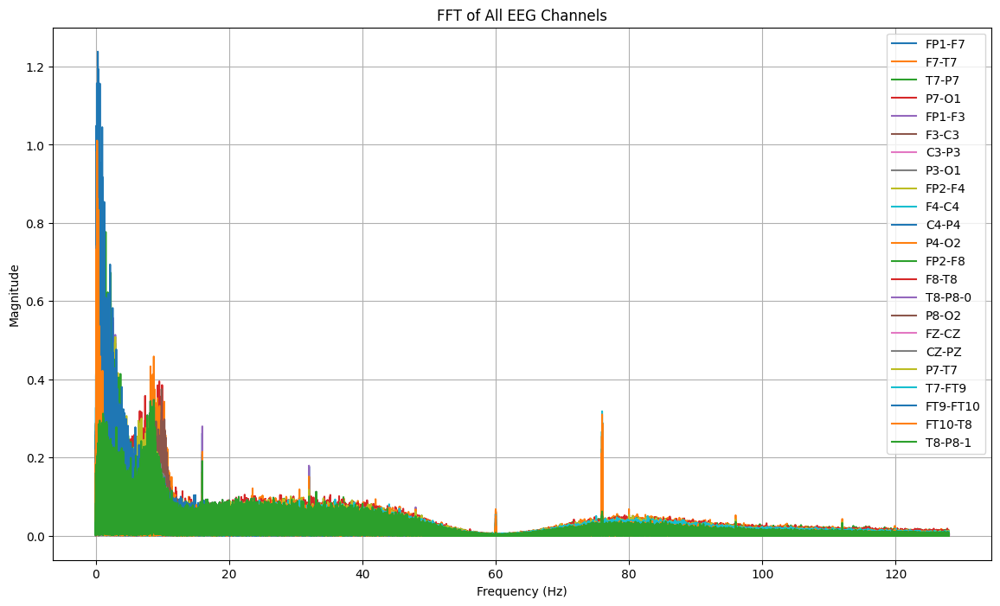

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df11[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv"
df12.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv


In [ ]:
#Import Data CSV
dataTA12 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb11_92.csv")
dataTA12


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.802198e-05,5.020757e-05,2.637363e-05,6.622711e-05,1.953602e-07,-2.442002e-05,6.056166e-06,4.356532e-05,5.958486e-05,1.953602e-07,...,3.379731e-05,-5.665446e-06,1.621490e-05,1.953602e-07,-2.598291e-05,-8.459096e-05,9.592186e-05,2.832723e-05,-5.665446e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,1.074481e-05,2.481074e-05,3.028083e-05,-5.841270e-05,1.953602e-07,1.953602e-07,1.426129e-05,-1.230769e-05,6.446886e-06,1.953602e-07,...,-2.481074e-05,-2.539683e-06,2.012210e-05,1.953602e-07,-2.989011e-05,-1.621490e-05,-4.884005e-06,-1.855922e-05,-2.539683e-06,3599.980469
921596,4.884005e-06,1.894994e-05,3.184371e-05,-5.528694e-05,1.953602e-07,-2.148962e-06,1.035409e-05,-8.009768e-06,1.953602e-07,1.953602e-07,...,-1.953602e-07,-2.207570e-05,1.504274e-05,1.953602e-07,-3.145299e-05,-1.934066e-05,9.768010e-07,8.791209e-06,-2.207570e-05,3599.984375
921597,4.102564e-06,3.321123e-06,3.575092e-05,-4.239316e-05,1.953602e-07,-5.860806e-07,6.837607e-06,-3.321123e-06,-5.860806e-07,1.953602e-07,...,-1.426129e-05,4.493284e-06,9.963370e-06,1.953602e-07,-3.536020e-05,-1.953602e-07,9.768010e-07,-1.465201e-05,4.493284e-06,3599.988281
921598,1.113553e-05,4.102564e-06,1.894994e-05,-2.754579e-05,1.953602e-07,4.102564e-06,3.711844e-06,-1.367521e-06,1.953602e-07,1.953602e-07,...,-1.387057e-05,8.009768e-06,1.191697e-05,1.953602e-07,-1.855922e-05,-1.113553e-05,3.711844e-06,-1.465201e-05,8.009768e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA12[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA12[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA12[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data12, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.65 Hz, Magnitude: 2.083672, Time: 502.046875 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.781071, Time: 113.324219 s
Channel: T7-FT9, Max Frequency: 0.43 Hz, Magnitude: 1.491207, Time: 106.203125 s
Channel: FP2-F8, Max Frequency: 0.23 Hz, Magnitude: 1.484996, Time: 261.937500 s
Channel: FP1-F3, Max Frequency: 0.56 Hz, Magnitude: 1.439436, Time: 3053.742188 s
Channel: F7-T7, Max Frequency: 0.81 Hz, Magnitude: 1.348722, Time: 110.546875 s
Channel: FP2-F4, Max Frequency: 0.40 Hz, Magnitude: 1.326101, Time: 2309.582031 s
Channel: T7-P7, Max Frequency: 0.69 Hz, Magnitude: 0.903036, Time: 2311.191406 s
Channel: P7-T7, Max Frequency: 0.69 Hz, Magnitude: 0.903036, Time: 2311.191406 s
Channel: F8-T8, Max Frequency: 0.65 Hz, Magnitude: 0.901270, Time: 22.238281 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 0.837472, Time: 392.394531 s
Channel: FT10-T8, Max Frequenc

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 1.17 Hz, Magnitude: 0.324955, Time: 22.222656 s
Channel: F3-C3, Max Frequency: 0.72 Hz, Magnitude: 0.374176, Time: 22.234375 s
Channel: F8-T8, Max Frequency: 0.65 Hz, Magnitude: 0.901270, Time: 22.238281 s
Channel: T8-P8-0, Max Frequency: 0.16 Hz, Magnitude: 0.617105, Time: 22.242188 s
Channel: T8-P8-1, Max Frequency: 0.16 Hz, Magnitude: 0.617105, Time: 22.242188 s
Channel: FT10-T8, Max Frequency: 0.13 Hz, Magnitude: 0.776607, Time: 22.261719 s
Channel: T7-FT9, Max Frequency: 0.43 Hz, Magnitude: 1.491207, Time: 106.203125 s
Channel: F7-T7, Max Frequency: 0.81 Hz, Magnitude: 1.348722, Time: 110.546875 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.781071, Time: 113.324219 s
Channel: FP2-F8, Max Frequency: 0.23 Hz, Magnitude: 1.484996, Time: 261.937500 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 0.837472, Time: 392.394531 s
Channel:

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2575   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2847    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut12 = dataTA12.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut12.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_92.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA12 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb11_92.csv")
TA12.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,...,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000061,-0.000037,-0.000079,0.000021,1.953602e-07,-0.000117,-0.000048,0.000073,5.802198e-05,1.953602e-07,...,-0.000215,-0.000080,0.000029,1.953602e-07,0.000080,0.000035,0.000091,-0.000168,-0.000080,2575.000000
1,0.000057,0.000026,-0.000035,-0.000058,1.953602e-07,-0.000063,0.000003,0.000063,-1.308913e-05,1.953602e-07,...,0.000070,-0.000156,-0.000028,1.953602e-07,0.000036,-0.000037,0.000089,0.000013,-0.000156,2575.003906
2,0.000072,-0.000032,-0.000018,-0.000020,1.953602e-07,-0.000072,-0.000006,0.000036,4.317460e-05,1.953602e-07,...,-0.000243,-0.000137,0.000035,1.953602e-07,0.000018,-0.000027,0.000117,-0.000063,-0.000137,2575.007812
3,0.000097,0.000095,-0.000086,-0.000058,1.953602e-07,-0.000064,0.000057,0.000044,9.181929e-06,1.953602e-07,...,-0.000142,-0.000129,0.000014,1.953602e-07,0.000087,-0.000031,0.000043,-0.000062,-0.000129,2575.011719
4,0.000071,-0.000043,0.000040,-0.000047,1.953602e-07,-0.000005,0.000038,-0.000013,1.953602e-07,1.953602e-07,...,-0.000046,-0.000130,0.000042,1.953602e-07,-0.000040,0.000049,-0.000040,0.000050,-0.000130,2575.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA12.shape


(69632, 29)

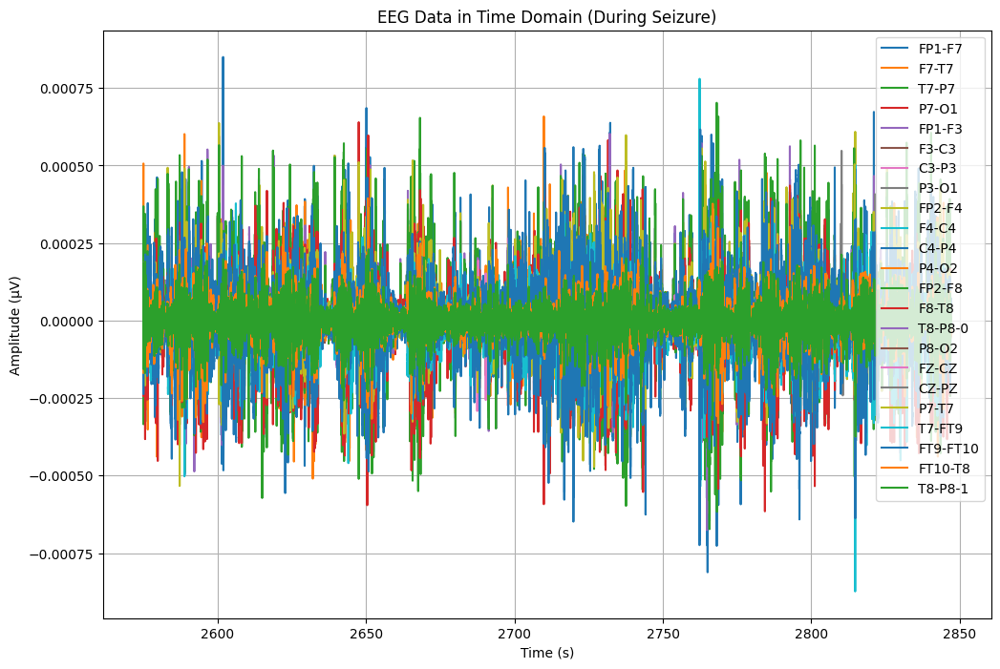

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA12['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA12.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA12[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


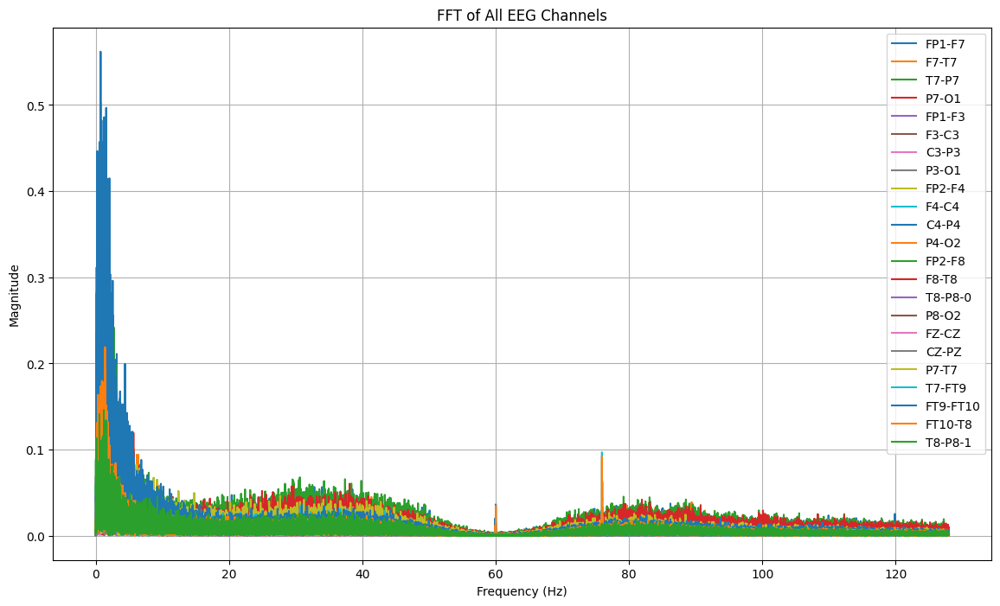

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA12[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2695:
        return "tidak kejang"
    elif 2695 <= row['Time'] < 2727:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_12 = TA12.copy()
TA_12['seizure'] = TA_12.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_12[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2575.000000  tidak kejang  0.000061 -0.000037 -0.000079  0.000021   
1  2575.003906  tidak kejang  0.000057  0.000026 -0.000035 -0.000058   
2  2575.007812  tidak kejang  0.000072 -0.000032 -0.000018 -0.000020   
3  2575.011719  tidak kejang  0.000097  0.000095 -0.000086 -0.000058   
4  2575.015625  tidak kejang  0.000071 -0.000043  0.000040 -0.000047   

     FP1-F3     F3-C3     C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000117 -0.000048  0.000073  5.802198e-05  ... -0.000215 -0.000080   
1 -0.000063  0.000003  0.000063 -1.308913e-05  ...  0.000070 -0.000156   
2 -0.000072 -0.000006  0.000036  4.317460e-05  ... -0.000243 -0.000137   
3 -0.000064  0.000057  0.000044  9.181929e-06  ... -0.000142 -0.000129   
4 -0.000005  0.000038 -0.000013  1.953602e-07  ... -0.000046 -0.000130   

      P8-O2     FZ-CZ         CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0  0.000029 -0.000014  1.152625e-05  0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_12['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,8192


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_12)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 272.0 detik


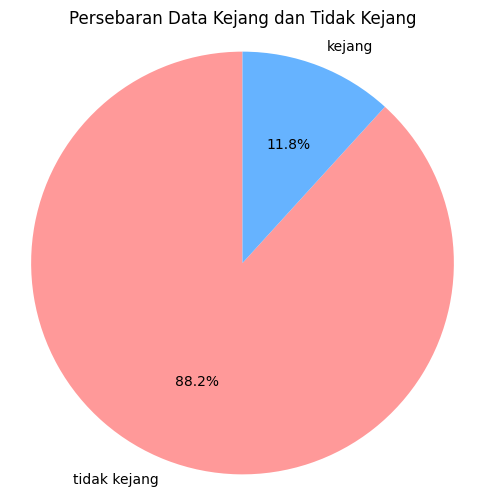

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_12['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_12.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb11_92.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_12.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_12['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.99      0.74      0.84      1691
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     13927
   macro avg       0.98      0.87      0.91     13927
weighted avg       0.97      0.97      0.96     13927

Akurasi: 0.9667552236662598
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.74      0.84      1691
tidak kejang       0.96      1.00      0.98     12236

    accuracy                           0.97     13927
   macro avg       0.98      0.87      0.91     13927
weighted avg       0.97      0.97      0.96     13927



# DATA 13 (chb01_03)

In [ ]:
# mengimport file edf
file13 = "/content/drive/MyDrive/TA/EDF/chb01_03 (1).edf"
data13 = mne.io.read_raw_edf(file13) # membaca file edf dan menyimpannya di data
data13


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_03 (1).edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-7-934fd0162745>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data13 = mne.io.read_raw_edf(file13) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_03 (1).edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data13.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data13.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data13.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df13 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df13['Time'] = times  # Menambahkan kolom waktu
df13.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.777778e-05,3.926740e-05,-3.711844e-06,8.400488e-06,-5.860806e-07,4.102564e-06,3.770452e-05,-1.504274e-05,-1.738706e-05,-4.512821e-05,...,-5.997558e-05,1.803175e-04,-1.855922e-05,8.537241e-05,4.102564e-06,2.090354e-05,-9.181929e-06,-3.965812e-05,-5.997558e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,2.148962e-06,5.860806e-07,5.860806e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df13.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df13.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.792972e-07,1.699668e-07,2.115262e-07,2.129045e-07,1.915001e-07,1.780686e-07,2.059151e-07,2.027239e-07,1.950278e-07,1.785070e-07,...,1.954594e-07,1.878718e-07,1.776434e-07,2.107020e-07,1.791942e-07,1.945534e-07,2.217894e-07,2.154592e-07,1.954594e-07,1799.998047
std,4.071426e-05,3.289431e-05,3.995194e-05,3.321602e-05,4.711351e-05,4.723402e-05,3.430131e-05,4.248185e-05,4.595016e-05,4.620191e-05,...,4.641400e-05,4.979114e-05,5.520218e-05,5.049616e-05,3.995194e-05,2.462092e-05,4.820836e-05,2.545986e-05,4.641400e-05,1039.231048
min,-4.800000e-04,-2.819048e-04,-3.139438e-04,-2.057143e-04,-5.132112e-04,-4.311600e-04,-3.166789e-04,-3.862271e-04,-5.362637e-04,-5.542369e-04,...,-7.210745e-04,-3.784127e-04,-5.401709e-04,-4.917216e-04,-3.092552e-04,-2.260317e-04,-5.124298e-04,-2.893284e-04,-7.210745e-04,0.000000
25%,-1.816850e-05,-1.660562e-05,-1.973138e-05,-1.738706e-05,-2.363858e-05,-2.402930e-05,-1.816850e-05,-2.246642e-05,-2.285714e-05,-2.207570e-05,...,-2.129426e-05,-2.637363e-05,-2.715507e-05,-2.754579e-05,-1.934066e-05,-1.347985e-05,-2.363858e-05,-1.269841e-05,-2.129426e-05,899.999023
50%,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.894994e-05,1.738706e-05,1.973138e-05,1.777778e-05,2.402930e-05,2.559219e-05,1.816850e-05,2.285714e-05,2.285714e-05,2.324786e-05,...,2.168498e-05,2.676435e-05,2.832723e-05,2.715507e-05,2.012210e-05,1.426129e-05,2.363858e-05,1.269841e-05,2.168498e-05,2699.997070
max,4.995360e-04,3.057387e-04,3.096459e-04,1.986813e-04,5.565812e-04,3.494994e-04,3.631746e-04,3.432479e-04,4.514774e-04,3.952137e-04,...,4.764835e-04,4.796093e-04,5.952625e-04,4.694505e-04,3.143346e-04,3.170696e-04,4.854701e-04,5.003175e-04,4.764835e-04,3599.996094


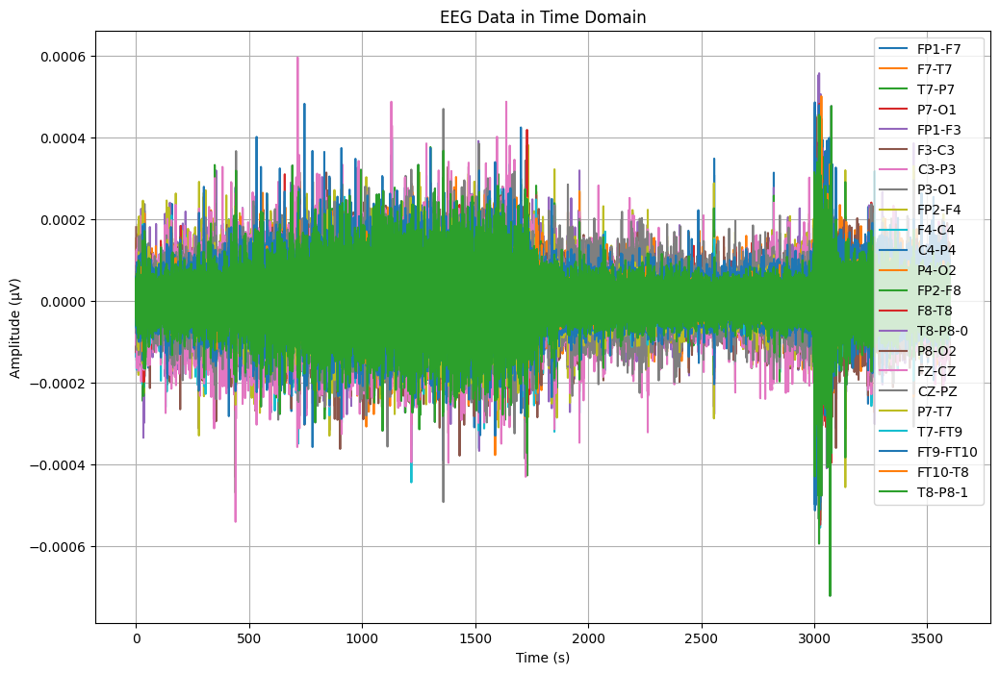

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df13['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df13[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


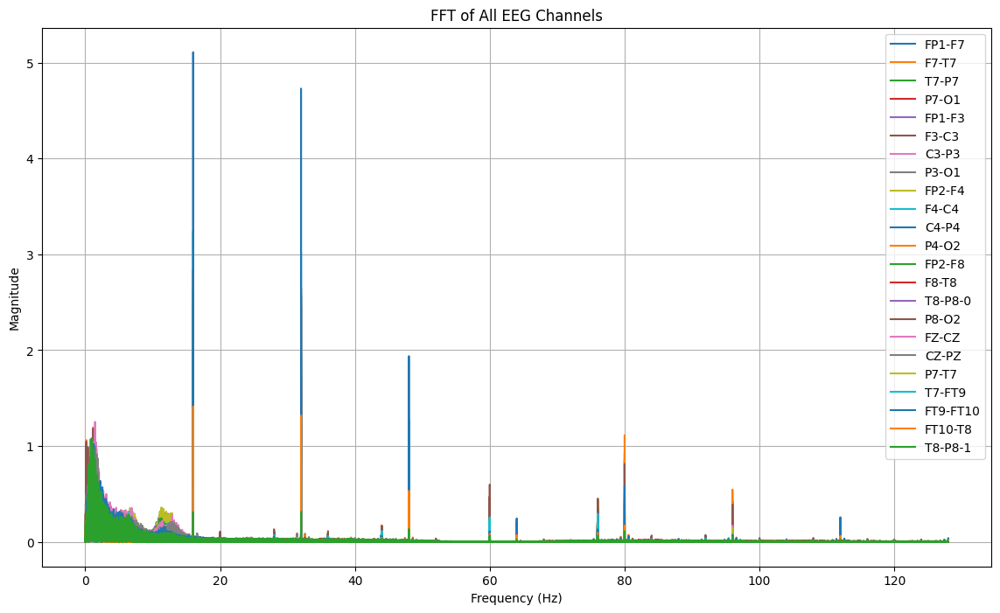

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df13[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv"
df13.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv


In [ ]:
#Import Data CSV
dataTA13 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_03.csv")
dataTA13


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.777778e-05,3.926740e-05,-3.711844e-06,8.400488e-06,-5.860806e-07,4.102564e-06,3.770452e-05,-1.504274e-05,-1.738706e-05,-4.512821e-05,...,-5.997558e-05,1.803175e-04,-1.855922e-05,8.537241e-05,4.102564e-06,2.090354e-05,-9.181929e-06,-3.965812e-05,-5.997558e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,2.148962e-06,5.860806e-07,5.860806e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.379731e-05,-3.965812e-05,6.349206e-05,2.363858e-05,1.504274e-05,-2.754579e-05,2.012210e-05,5.274725e-06,1.660562e-05,-2.148962e-06,...,-1.367521e-06,-5.137973e-05,1.347985e-05,-3.106227e-05,-6.310134e-05,-5.665446e-06,8.810745e-05,4.786325e-05,-1.367521e-06,3599.980469
921596,-2.754579e-05,-2.676435e-05,6.505495e-05,1.035409e-05,2.285714e-05,-1.191697e-05,1.855922e-05,-9.181929e-06,2.637363e-05,4.884005e-06,...,9.963370e-06,-6.935287e-05,2.637363e-05,-2.676435e-05,-6.466422e-05,-4.884005e-06,7.912088e-05,4.864469e-05,9.963370e-06,3599.984375
921597,-1.777778e-05,-2.324786e-05,5.919414e-05,1.465201e-05,3.418803e-05,-2.539683e-06,9.181929e-06,-9.181929e-06,3.067155e-05,4.493284e-06,...,1.934066e-05,-4.512821e-05,2.246642e-05,-2.598291e-05,-5.880342e-05,8.009768e-06,4.864469e-05,4.356532e-05,1.934066e-05,3599.988281
921598,-8.791209e-06,-2.246642e-05,6.036630e-05,1.191697e-05,4.239316e-05,2.930403e-06,1.465201e-05,-1.973138e-05,3.575092e-05,8.400488e-06,...,2.637363e-05,-2.793651e-05,2.442002e-05,-1.855922e-05,-5.997558e-05,2.598291e-05,2.793651e-05,3.848596e-05,2.637363e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA13[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA13[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA13[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data13, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.107724, Time: 3003.339844 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 3.242629, Time: 3268.210938 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 2.835942, Time: 3026.292969 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.628186, Time: 439.832031 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.597257, Time: 3027.472656 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.577463, Time: 1720.910156 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.045068, Time: 1359.230469 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.894707, Time: 3026.625000 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 1.838531, Time: 3021.804688 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.747145, Time: 3074.574219 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.631361, Time: 1053.695312 s
Channel: C3-P3

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.628186, Time: 439.832031 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 1.358953, Time: 439.859375 s
Channel: FZ-CZ, Max Frequency: 1.45 Hz, Magnitude: 1.252469, Time: 714.753906 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.631361, Time: 1053.695312 s
Channel: T7-P7, Max Frequency: 0.99 Hz, Magnitude: 0.982646, Time: 1252.812500 s
Channel: P7-T7, Max Frequency: 0.99 Hz, Magnitude: 0.982646, Time: 1252.812500 s
Channel: CZ-PZ, Max Frequency: 0.80 Hz, Magnitude: 1.072837, Time: 1359.226562 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.045068, Time: 1359.230469 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 1.487110, Time: 1359.449219 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.577463, Time: 1720.910156 s
Channel: F7-T7, Max Frequency: 1.37 Hz, Magnitude: 0.695057, Time: 1730.84375

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2876   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3156    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut13 = dataTA13.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut13.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_03.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA13 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_03.csv")
TA13


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000020,-0.000017,-0.000021,-0.000022,-5.665446e-06,-0.000042,-0.000024,-9.181929e-06,0.000032,-3.731380e-05,...,-0.000046,-0.000028,-0.000044,-0.000074,0.000021,2.207570e-05,0.000028,-0.000012,-0.000046,2876.000000
1,-0.000018,-0.000012,-0.000019,-0.000023,-5.860806e-07,-0.000036,-0.000023,-1.308913e-05,0.000030,-3.653236e-05,...,-0.000039,-0.000021,-0.000038,-0.000069,0.000019,1.543346e-05,0.000024,-0.000009,-0.000039,2876.003906
2,-0.000017,-0.000007,-0.000014,-0.000025,3.711844e-06,-0.000030,-0.000020,-1.816850e-05,0.000026,-3.848596e-05,...,-0.000031,-0.000019,-0.000036,-0.000057,0.000014,1.308913e-05,0.000017,-0.000010,-0.000031,2876.007812
3,-0.000018,-0.000002,-0.000010,-0.000025,6.446886e-06,-0.000027,-0.000018,-1.621490e-05,0.000018,-4.317460e-05,...,-0.000019,-0.000018,-0.000037,-0.000044,0.000010,6.446886e-06,0.000010,-0.000009,-0.000019,2876.011719
4,-0.000017,0.000002,-0.000007,-0.000024,6.056166e-06,-0.000023,-0.000013,-1.582418e-05,0.000010,-4.512821e-05,...,-0.000006,-0.000003,-0.000037,-0.000027,0.000008,5.860806e-07,0.000003,-0.000008,-0.000006,2876.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71675,-0.000020,0.000025,0.000022,0.000044,1.934066e-05,0.000005,0.000047,1.953602e-07,0.000007,2.090354e-05,...,0.000064,0.000046,0.000025,0.000055,-0.000022,-5.684982e-05,0.000060,0.000002,0.000064,3155.980469
71676,-0.000018,0.000032,0.000022,0.000016,1.855922e-05,0.000015,0.000046,-2.793651e-05,0.000010,1.816850e-05,...,0.000060,0.000026,0.000025,0.000051,-0.000021,-4.864469e-05,0.000045,-0.000004,0.000060,3155.984375
71677,-0.000002,0.000032,0.000010,0.000005,3.067155e-05,0.000028,0.000031,-4.512821e-05,0.000013,4.102564e-06,...,0.000055,0.000059,0.000018,0.000045,-0.000009,-1.699634e-05,-0.000003,-0.000021,0.000055,3155.988281
71678,0.000006,0.000034,0.000007,-0.000008,3.887668e-05,0.000037,0.000026,-6.271062e-05,0.000009,-5.860806e-07,...,0.000042,0.000071,0.000017,0.000038,-0.000006,-5.860806e-07,-0.000018,-0.000035,0.000042,3155.992188


In [ ]:
# melihat ukuran file yang sudah dipotong
TA13.shape


(71680, 24)

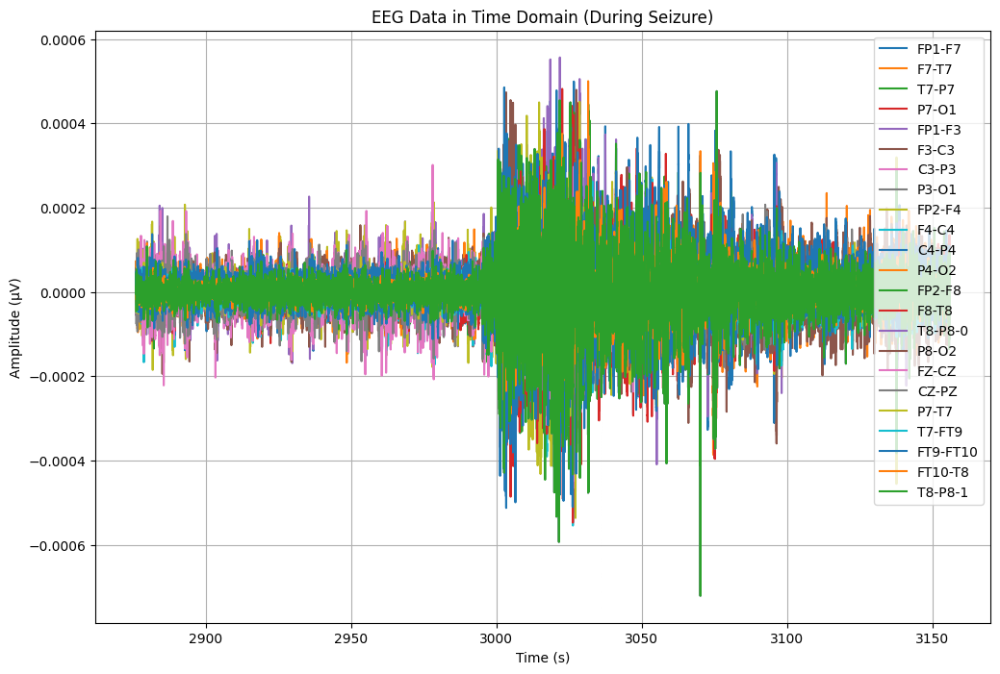

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA13['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA13.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA13[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


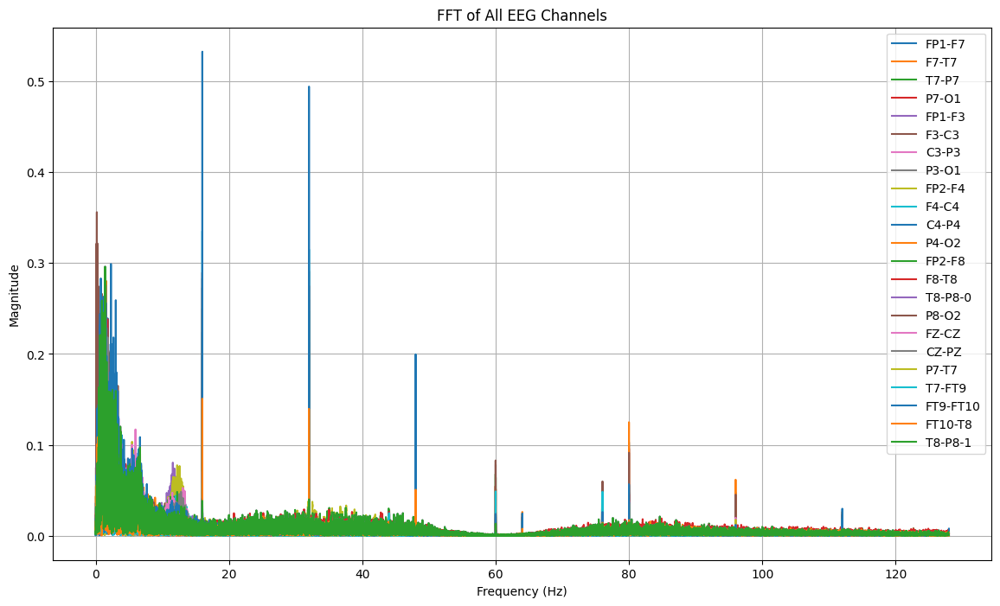

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA13[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2996:
        return "tidak kejang"
    elif 2996 <= row['Time'] < 3036:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_13 = TA13.copy()
TA_13['seizure'] = TA_13.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_13[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2876.000000  tidak kejang -0.000020 -0.000017 -0.000021 -0.000022   
1  2876.003906  tidak kejang -0.000018 -0.000012 -0.000019 -0.000023   
2  2876.007812  tidak kejang -0.000017 -0.000007 -0.000014 -0.000025   
3  2876.011719  tidak kejang -0.000018 -0.000002 -0.000010 -0.000025   
4  2876.015625  tidak kejang -0.000017  0.000002 -0.000007 -0.000024   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -5.665446e-06 -0.000042 -0.000024 -0.000009  ... -0.000021 -0.000046   
1 -5.860806e-07 -0.000036 -0.000023 -0.000013  ... -0.000024 -0.000039   
2  3.711844e-06 -0.000030 -0.000020 -0.000018  ... -0.000022 -0.000031   
3  6.446886e-06 -0.000027 -0.000018 -0.000016  ... -0.000017 -0.000019   
4  6.056166e-06 -0.000023 -0.000013 -0.000016  ... -0.000015 -0.000006   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10   FT10-T8  \
0 -0.000028 -0.000044 -0.000074  0.000021  

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_13['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,10240


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_13)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 280.0 detik


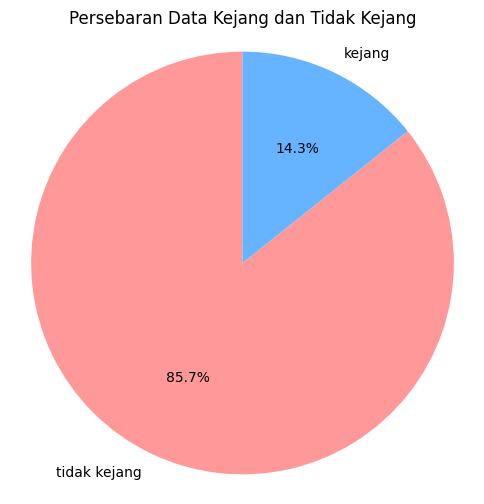

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_13['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_13.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_03.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_13.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_13['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.86      0.91      2100
tidak kejang       0.98      1.00      0.99     12236

    accuracy                           0.98     14336
   macro avg       0.98      0.93      0.95     14336
weighted avg       0.98      0.98      0.98     14336

Akurasi: 0.9765625
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.86      0.91      2100
tidak kejang       0.98      1.00      0.99     12236

    accuracy                           0.98     14336
   macro avg       0.98      0.93      0.95     14336
weighted avg       0.98      0.98      0.98     14336



# DATA 14 (chb01_04)

In [ ]:
# mengimport file edf
file14 = "/content/drive/MyDrive/TA/EDF/chb01_04.edf"
data14 = mne.io.read_raw_edf(file14) # membaca file edf dan menyimpannya di data
data14


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-103-be135fe16ab0>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data14 = mne.io.read_raw_edf(file14) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_04.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data14.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data14.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data14.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df14 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df14['Time'] = times  # Menambahkan kolom waktu
df14.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,9.318681e-05,5.724054e-05,-7.794872e-05,-2.539683e-06,7.833944e-05,2.051282e-05,-1.543346e-05,-1.347985e-05,8.420024e-05,1.816850e-05,...,-2.930403e-06,4.434676e-05,-3.028083e-05,5.880342e-05,7.833944e-05,-1.816850e-05,-5.684982e-05,-1.543346e-05,-2.930403e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,1.953602e-07,...,-1.953602e-07,3.321123e-06,1.953602e-07,9.768010e-07,1.953602e-07,2.148962e-06,-5.860806e-07,-1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df14.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df14.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.755783e-07,1.818995e-07,2.024013e-07,2.087170e-07,1.891615e-07,1.691472e-07,2.055577e-07,2.034612e-07,2.072951e-07,1.842766e-07,...,1.800481e-07,1.976118e-07,1.851174e-07,2.034112e-07,1.883191e-07,1.949799e-07,2.437063e-07,2.048764e-07,1.800481e-07,1799.998047
std,3.688918e-05,2.816281e-05,2.539512e-05,2.382374e-05,4.107482e-05,3.417111e-05,2.412722e-05,2.873010e-05,3.915086e-05,3.500844e-05,...,3.417669e-05,4.492561e-05,3.829465e-05,3.631725e-05,2.539512e-05,2.252803e-05,4.896572e-05,2.855657e-05,3.417669e-05,1039.231048
min,-5.108669e-04,-4.968010e-04,-3.315263e-04,-3.682540e-04,-6.655922e-04,-3.323077e-04,-2.123565e-04,-2.678388e-04,-4.327228e-04,-4.710134e-04,...,-5.010989e-04,-1.285665e-03,-4.932845e-04,-3.291819e-04,-4.456166e-04,-4.889866e-04,-9.172161e-04,-5.616606e-04,-5.010989e-04,0.000000
25%,-1.387057e-05,-1.308913e-05,-1.387057e-05,-1.308913e-05,-1.816850e-05,-1.738706e-05,-1.347985e-05,-1.660562e-05,-1.777778e-05,-1.660562e-05,...,-1.699634e-05,-2.246642e-05,-1.816850e-05,-1.973138e-05,-1.347985e-05,-1.191697e-05,-2.129426e-05,-1.191697e-05,-1.699634e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.465201e-05,1.387057e-05,1.387057e-05,1.347985e-05,1.816850e-05,1.855922e-05,1.347985e-05,1.660562e-05,1.699634e-05,1.738706e-05,...,1.777778e-05,2.285714e-05,1.934066e-05,1.934066e-05,1.426129e-05,1.308913e-05,2.090354e-05,1.191697e-05,1.777778e-05,2699.997070
max,8.390720e-04,5.151648e-04,4.460073e-04,2.268132e-04,6.734066e-04,2.725275e-04,3.791941e-04,2.154823e-04,5.319658e-04,4.514774e-04,...,5.968254e-04,6.941148e-04,3.330891e-04,3.799756e-04,3.319170e-04,5.538462e-04,8.273504e-04,9.363614e-04,5.968254e-04,3599.996094


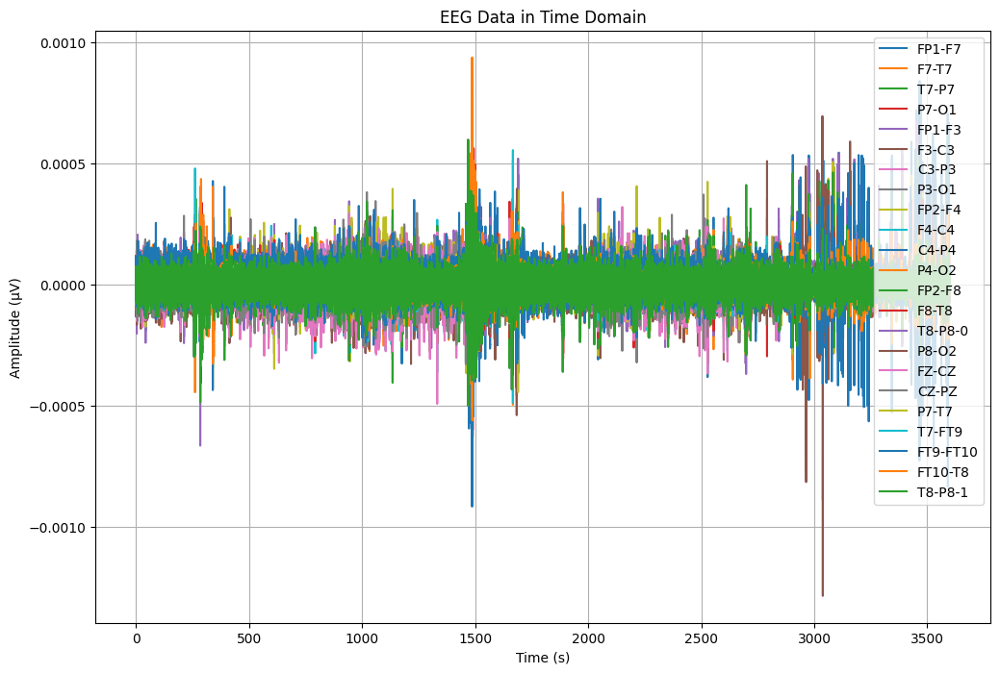

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df14['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df14[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


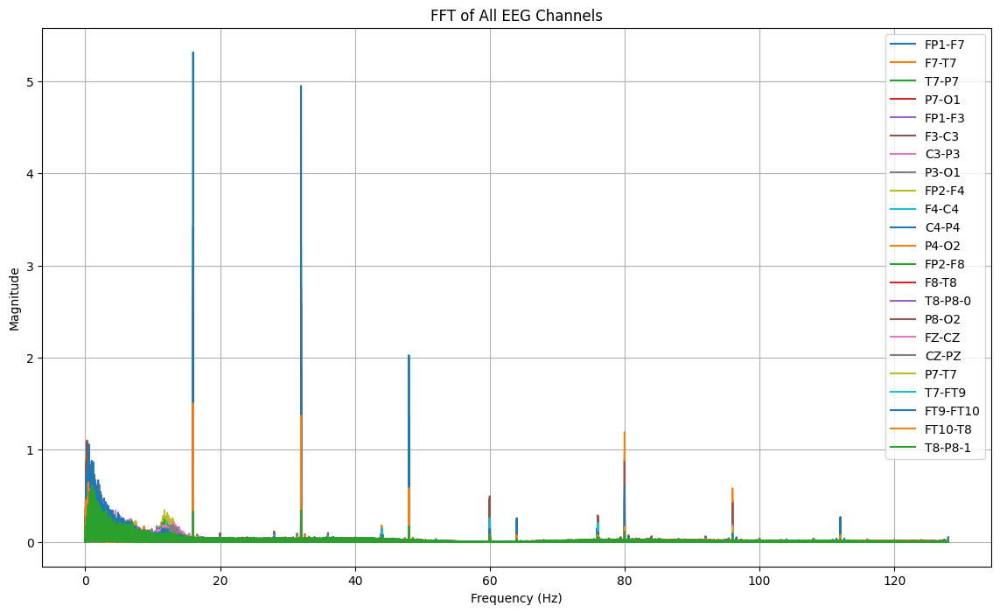

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df14[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv"
df14.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv


In [ ]:
#Import Data CSV
dataTA14 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_04.csv")
dataTA14


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,9.318681e-05,5.724054e-05,-7.794872e-05,-2.539683e-06,7.833944e-05,2.051282e-05,-1.543346e-05,-1.347985e-05,8.420024e-05,1.816850e-05,...,-2.930403e-06,4.434676e-05,-3.028083e-05,5.880342e-05,7.833944e-05,-1.816850e-05,-5.684982e-05,-1.543346e-05,-2.930403e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,1.953602e-07,...,-1.953602e-07,3.321123e-06,1.953602e-07,9.768010e-07,1.953602e-07,2.148962e-06,-5.860806e-07,-1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.894994e-05,-1.367521e-06,-1.758242e-06,1.230769e-05,-9.572650e-06,-1.035409e-05,4.884005e-06,5.274725e-06,-1.621490e-05,2.637363e-05,...,5.860806e-07,3.321123e-06,1.973138e-05,-1.758242e-06,2.148962e-06,-1.035409e-05,2.754579e-05,4.493284e-06,5.860806e-07,3599.980469
921596,-1.387057e-05,-9.768010e-07,-3.321123e-06,2.148962e-06,-7.228327e-06,-7.228327e-06,5.665446e-06,-6.446886e-06,-8.791209e-06,2.598291e-05,...,1.758242e-06,3.321123e-06,1.855922e-05,1.367521e-06,3.711844e-06,-3.711844e-06,1.543346e-05,5.274725e-06,1.758242e-06,3599.984375
921597,-2.930403e-06,-1.953602e-07,-9.963370e-06,2.148962e-06,-2.930403e-06,-5.860806e-07,5.860806e-07,-8.400488e-06,-2.148962e-06,2.207570e-05,...,4.884005e-06,1.953602e-07,1.543346e-05,-1.367521e-06,1.035409e-05,5.860806e-07,-9.572650e-06,6.446886e-06,4.884005e-06,3599.988281
921598,4.493284e-06,1.367521e-06,-1.152625e-05,-9.768010e-07,-1.367521e-06,6.056166e-06,-1.758242e-06,-9.181929e-06,-1.953602e-07,2.051282e-05,...,6.837607e-06,-6.837607e-06,1.543346e-05,1.953602e-07,1.191697e-05,9.768010e-07,-2.442002e-05,9.963370e-06,6.837607e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA14[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA14[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA14[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data14, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.314103, Time: 1486.300781 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 3.429051, Time: 1666.906250 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 2.983072, Time: 1486.621094 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.807857, Time: 1474.886719 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.719783, Time: 1484.769531 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 2.599424, Time: 3038.003906 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.182354, Time: 1468.871094 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.998998, Time: 3465.816406 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 1.972107, Time: 3452.851562 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.919343, Time: 3038.003906 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 1.759863, Time: 1689.507812 s
Channel: FP2-

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 1.473278, Time: 283.757812 s
Channel: CZ-PZ, Max Frequency: 1.04 Hz, Magnitude: 0.685250, Time: 1020.804688 s
Channel: FZ-CZ, Max Frequency: 32.00 Hz, Magnitude: 0.786043, Time: 1331.996094 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 2.182354, Time: 1468.871094 s
Channel: T8-P8-0, Max Frequency: 1.01 Hz, Magnitude: 0.609284, Time: 1468.910156 s
Channel: T8-P8-1, Max Frequency: 1.01 Hz, Magnitude: 0.609284, Time: 1468.910156 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 2.807857, Time: 1474.886719 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 2.719783, Time: 1484.769531 s
Channel: F4-C4, Max Frequency: 16.00 Hz, Magnitude: 0.767657, Time: 1485.937500 s
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 5.314103, Time: 1486.300781 s
Channel: FT10-T8, Max Frequency: 16.00 Hz, Magnitude: 1.503549, Time

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1347   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1614    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut14 = dataTA14.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut14.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_04.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA14 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_04.csv")
TA14.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-6.056166e-06,-5.860806e-07,-0.000012,0.000005,-0.000011,0.000013,-1.347985e-05,-0.000004,-0.000005,-9.768010e-07,...,0.000012,-8.791209e-06,-9.768010e-07,1.953602e-07,0.000012,8.009768e-06,-0.000022,0.000008,0.000012,1347.000000
1,-6.446886e-06,-2.539683e-06,-0.000007,0.000006,-0.000012,0.000014,-8.400488e-06,-0.000004,-0.000004,-1.953602e-07,...,0.000012,3.711844e-06,9.768010e-07,2.539683e-06,0.000007,9.963370e-06,-0.000022,0.000007,0.000012,1347.003906
2,-7.619048e-06,1.758242e-06,-0.000006,0.000006,-0.000013,0.000018,-5.274725e-06,-0.000004,-0.000006,9.768010e-07,...,0.000013,-6.837607e-06,2.930403e-06,3.321123e-06,0.000006,6.056166e-06,-0.000022,0.000004,0.000013,1347.007812
3,-5.665446e-06,8.791209e-06,-0.000011,0.000008,-0.000011,0.000019,-5.274725e-06,-0.000003,-0.000007,5.860806e-07,...,0.000014,-1.660562e-05,4.884005e-06,2.930403e-06,0.000011,-4.493284e-06,-0.000018,0.000004,0.000014,1347.011719
4,1.953602e-07,6.056166e-06,-0.000007,0.000010,-0.000005,0.000019,-5.860806e-07,-0.000004,-0.000002,1.367521e-06,...,0.000013,-5.860806e-07,8.400488e-06,7.228327e-06,0.000008,9.768010e-07,-0.000018,0.000004,0.000013,1347.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA14.shape


(68352, 24)

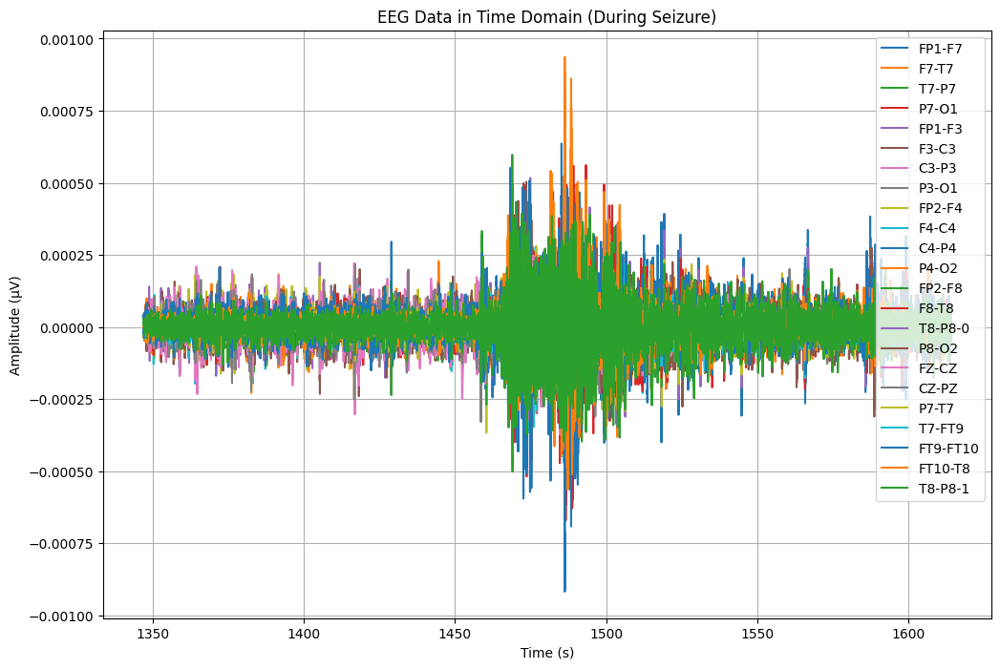

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA14['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA14.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA14[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


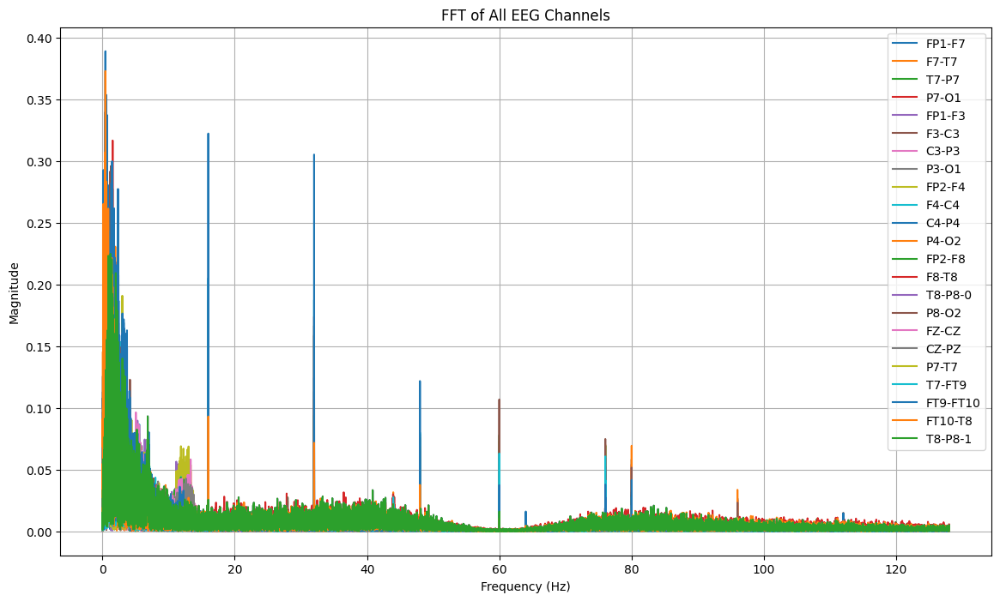

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA14[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1467:
        return "tidak kejang"
    elif 1467 <= row['Time'] < 1494:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_14 = TA14.copy()
TA_14['seizure'] = TA_14.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_14[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure        FP1-F7         F7-T7     T7-P7     P7-O1  \
0  1347.000000  tidak kejang -6.056166e-06 -5.860806e-07 -0.000012  0.000005   
1  1347.003906  tidak kejang -6.446886e-06 -2.539683e-06 -0.000007  0.000006   
2  1347.007812  tidak kejang -7.619048e-06  1.758242e-06 -0.000006  0.000006   
3  1347.011719  tidak kejang -5.665446e-06  8.791209e-06 -0.000011  0.000008   
4  1347.015625  tidak kejang  1.953602e-07  6.056166e-06 -0.000007  0.000010   

     FP1-F3     F3-C3         C3-P3     P3-O1  ...         F8-T8   T8-P8-0  \
0 -0.000011  0.000013 -1.347985e-05 -0.000004  ...  1.953602e-07  0.000012   
1 -0.000012  0.000014 -8.400488e-06 -0.000004  ... -1.367521e-06  0.000012   
2 -0.000013  0.000018 -5.274725e-06 -0.000004  ...  4.884005e-06  0.000013   
3 -0.000011  0.000019 -5.274725e-06 -0.000003  ...  1.152625e-05  0.000014   
4 -0.000005  0.000019 -5.860806e-07 -0.000004  ...  4.493284e-06  0.000013   

          P8-O2         FZ-CZ         CZ-PZ     P7

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_14['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,6912


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_14)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 267.0 detik


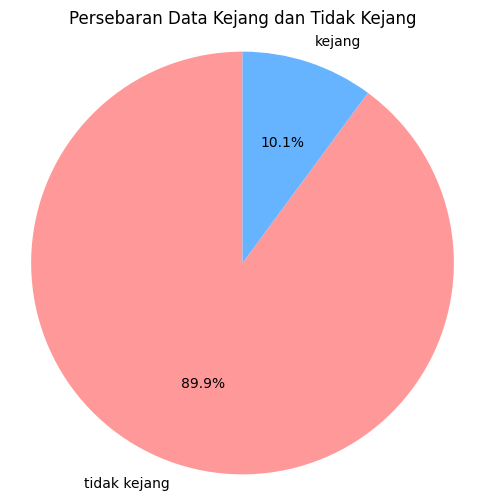

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_14['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_14.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_04.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_14.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_14['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.83      0.90      1426
tidak kejang       0.98      1.00      0.99     12245

    accuracy                           0.98     13671
   macro avg       0.98      0.91      0.94     13671
weighted avg       0.98      0.98      0.98     13671

Akurasi: 0.9800307219662059
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.83      0.90      1426
tidak kejang       0.98      1.00      0.99     12245

    accuracy                           0.98     13671
   macro avg       0.98      0.91      0.94     13671
weighted avg       0.98      0.98      0.98     13671



# DATA 15 (chb01_15)

In [ ]:
# mengimport file edf
file15 = "/content/drive/MyDrive/TA/EDF/chb01_15.edf"
data15 = mne.io.read_raw_edf(file15) # membaca file edf dan menyimpannya di data
data15


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_15.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-127-e74d1e0c8ed7>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data15 = mne.io.read_raw_edf(file15) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_15.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data15.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data15.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data15.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df15 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df15['Time'] = times  # Menambahkan kolom waktu
df15.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.457875e-05,-7.951160e-05,1.010012e-04,2.623687e-04,1.191697e-05,1.426129e-05,1.119414e-04,1.803175e-04,-5.665446e-06,6.349206e-05,...,7.365079e-05,7.163858e-04,7.443223e-05,1.932112e-04,-1.006105e-04,3.350427e-04,-2.170452e-04,3.321123e-06,7.365079e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,6.056166e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df15.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df15.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.684732e-07,1.814166e-07,2.066299e-07,1.951575e-07,1.863278e-07,1.805653e-07,2.115325e-07,1.965011e-07,1.923637e-07,1.826253e-07,...,1.896397e-07,1.677083e-07,1.764372e-07,2.086924e-07,1.840905e-07,1.663758e-07,2.318681e-07,2.089625e-07,1.896397e-07,1799.998047
std,4.321249e-05,3.708270e-05,4.448748e-05,4.502868e-05,5.276279e-05,5.288570e-05,4.422320e-05,5.724097e-05,5.184163e-05,5.643165e-05,...,5.422112e-05,6.109327e-05,6.658366e-05,6.530754e-05,4.448748e-05,3.510210e-05,5.435756e-05,3.199263e-05,5.422112e-05,1039.231048
min,-4.631990e-04,-4.526496e-04,-3.338706e-04,-3.338706e-04,-4.100611e-04,-3.467643e-04,-3.291819e-04,-4.092796e-04,-4.557753e-04,-5.061783e-04,...,-6.929426e-04,-6.069841e-04,-5.557998e-04,-7.355311e-04,-3.514530e-04,-6.945055e-04,-7.120879e-04,-3.995116e-04,-6.929426e-04,0.000000
25%,-1.894994e-05,-1.816850e-05,-2.207570e-05,-2.285714e-05,-2.598291e-05,-2.520147e-05,-2.285714e-05,-2.871795e-05,-2.559219e-05,-2.715507e-05,...,-2.715507e-05,-3.301587e-05,-3.184371e-05,-3.379731e-05,-2.129426e-05,-1.621490e-05,-2.598291e-05,-1.660562e-05,-2.715507e-05,899.999023
50%,5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1799.998047
75%,2.051282e-05,1.894994e-05,2.168498e-05,2.285714e-05,2.598291e-05,2.637363e-05,2.207570e-05,2.871795e-05,2.559219e-05,2.793651e-05,...,2.754579e-05,3.301587e-05,3.301587e-05,3.262515e-05,2.246642e-05,1.699634e-05,2.520147e-05,1.660562e-05,2.754579e-05,2699.997070
max,3.803663e-04,3.561416e-04,3.518437e-04,3.096459e-04,4.147497e-04,3.936508e-04,3.873993e-04,4.198291e-04,4.534310e-04,4.928938e-04,...,3.967766e-04,7.163858e-04,4.874237e-04,6.284737e-04,3.342613e-04,6.241758e-04,8.703297e-04,4.549939e-04,3.967766e-04,3599.996094


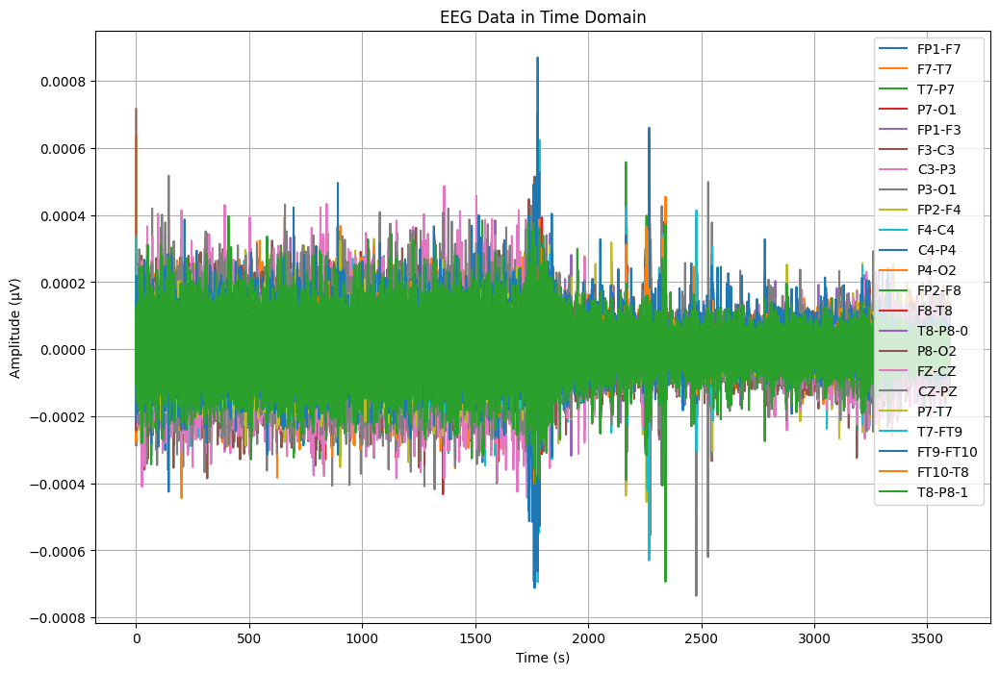

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df15['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df15[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


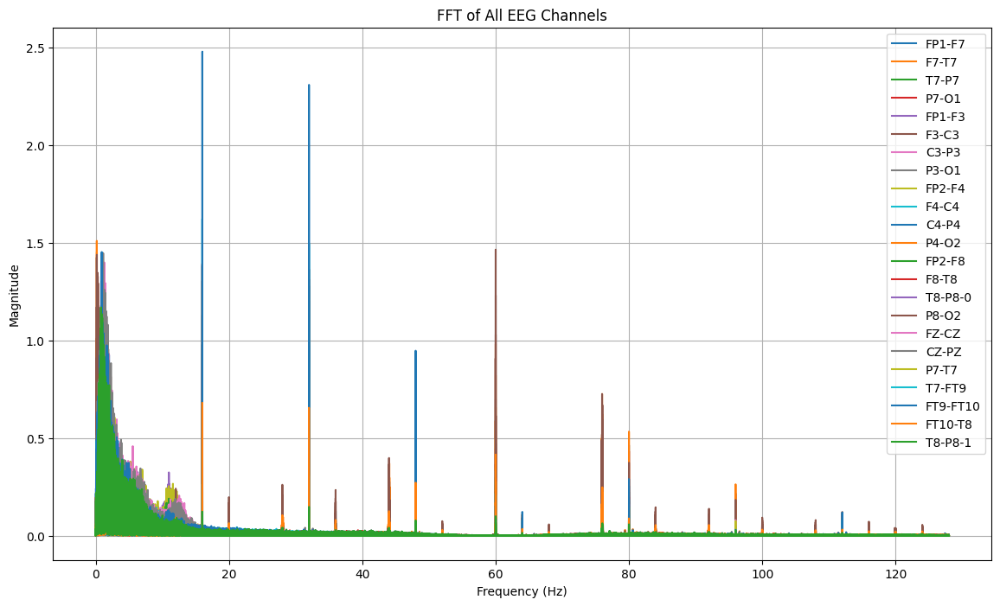

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df15[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv"
df15.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv


In [ ]:
#Import Data CSV
dataTA15 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_15.csv")
dataTA15


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.457875e-05,-7.951160e-05,1.010012e-04,2.623687e-04,1.191697e-05,1.426129e-05,1.119414e-04,1.803175e-04,-5.665446e-06,6.349206e-05,...,7.365079e-05,7.163858e-04,7.443223e-05,1.932112e-04,-1.006105e-04,3.350427e-04,-2.170452e-04,3.321123e-06,7.365079e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,6.056166e-06,1.953602e-07,5.860806e-07,1.953602e-07,1.367521e-06,1.953602e-07,-1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-3.301587e-05,1.347985e-05,-5.860806e-07,5.665446e-06,-7.091575e-05,-4.493284e-06,3.301587e-05,2.832723e-05,-5.489621e-05,-6.837607e-06,...,-1.035409e-05,-7.951160e-05,-2.754579e-05,3.692308e-05,9.768010e-07,-1.758242e-06,3.028083e-05,-1.758242e-06,-1.035409e-05,3599.980469
921596,-2.285714e-05,9.963370e-06,2.539683e-06,5.274725e-06,-6.583639e-05,9.768010e-07,3.379731e-05,2.598291e-05,-5.255189e-05,-2.930403e-06,...,-9.963370e-06,-3.340659e-05,-1.816850e-05,4.473748e-05,-2.148962e-06,1.074481e-05,2.637363e-05,-1.113553e-05,-9.963370e-06,3599.984375
921597,-1.465201e-05,5.665446e-06,4.102564e-06,8.791209e-06,-6.036630e-05,5.274725e-06,2.989011e-05,2.871795e-05,-5.255189e-05,-1.953602e-07,...,-1.269841e-05,-1.758242e-06,-1.582418e-05,4.669109e-05,-3.711844e-06,2.129426e-05,2.090354e-05,-1.973138e-05,-1.269841e-05,3599.988281
921598,-1.074481e-05,5.665446e-06,3.321123e-06,9.181929e-06,-5.645910e-05,9.963370e-06,2.402930e-05,2.989011e-05,-4.942613e-05,1.367521e-06,...,-1.699634e-05,-3.457875e-05,-1.426129e-05,3.731380e-05,-2.930403e-06,1.621490e-05,2.012210e-05,-1.113553e-05,-1.699634e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA15[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA15[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA15[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data15, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")



Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.480624, Time: 1776.585938 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.623409, Time: 1776.593750 s
Channel: P4-O2, Max Frequency: 0.17 Hz, Magnitude: 1.510924, Time: 0.000000 s
Channel: P8-O2, Max Frequency: 60.01 Hz, Magnitude: 1.466102, Time: 0.000000 s
Channel: F4-C4, Max Frequency: 1.05 Hz, Magnitude: 1.449670, Time: 1766.085938 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.447949, Time: 2478.320312 s
Channel: FZ-CZ, Max Frequency: 1.29 Hz, Magnitude: 1.400654, Time: 1766.082031 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.393849, Time: 1769.906250 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.306506, Time: 657.398438 s
Channel: P3-O1, Max Frequency: 0.90 Hz, Magnitude: 1.291815, Time: 71.000000 s
Channel: T8-P8-0, Max Frequency: 0.79 Hz, Magnitude: 1.170239, Time: 2342.023438 s
Channel: T8-P8-1, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P4-O2, Max Frequency: 0.17 Hz, Magnitude: 1.510924, Time: 0.000000 s
Channel: P8-O2, Max Frequency: 60.01 Hz, Magnitude: 1.466102, Time: 0.000000 s
Channel: P3-O1, Max Frequency: 0.90 Hz, Magnitude: 1.291815, Time: 71.000000 s
Channel: C3-P3, Max Frequency: 1.05 Hz, Magnitude: 1.069378, Time: 144.050781 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.306506, Time: 657.398438 s
Channel: T7-P7, Max Frequency: 0.95 Hz, Magnitude: 1.032298, Time: 902.410156 s
Channel: P7-T7, Max Frequency: 0.95 Hz, Magnitude: 1.032298, Time: 902.410156 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 0.979376, Time: 1737.484375 s
Channel: FP1-F3, Max Frequency: 1.57 Hz, Magnitude: 1.122266, Time: 1737.917969 s
Channel: P7-O1, Max Frequency: 0.99 Hz, Magnitude: 1.092219, Time: 1751.242188 s
Channel: FZ-CZ, Max Frequency: 1.29 Hz, Magnitude: 1.400654, Time: 1766.082031 s
Channel

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1612   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1892    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut15 = dataTA15.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut15.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_15.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA15 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_15.csv")
TA15.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000102,0.000072,0.000152,0.000037,0.000021,0.000153,0.000117,0.000073,0.000139,-0.000014,...,0.000102,0.000029,0.000155,0.000012,-0.000151,1.113553e-05,0.000040,-0.000012,0.000102,1612.000000
1,0.000100,0.000076,0.000146,0.000032,0.000026,0.000143,0.000112,0.000074,0.000136,-0.000020,...,0.000095,0.000005,0.000144,0.000009,-0.000145,-5.860806e-07,0.000044,-0.000008,0.000095,1612.003906
2,0.000099,0.000076,0.000142,0.000032,0.000032,0.000132,0.000109,0.000078,0.000131,-0.000025,...,0.000088,0.000024,0.000133,0.000009,-0.000142,-2.148962e-06,0.000042,-0.000008,0.000088,1612.007812
3,0.000097,0.000069,0.000146,0.000033,0.000038,0.000122,0.000104,0.000082,0.000124,-0.000031,...,0.000087,0.000047,0.000123,0.000010,-0.000146,3.321123e-06,0.000040,-0.000013,0.000087,1612.011719
4,0.000088,0.000060,0.000154,0.000031,0.000042,0.000112,0.000096,0.000085,0.000119,-0.000032,...,0.000086,0.000015,0.000110,0.000005,-0.000154,5.274725e-06,0.000046,-0.000009,0.000086,1612.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA15.shape


(71680, 24)

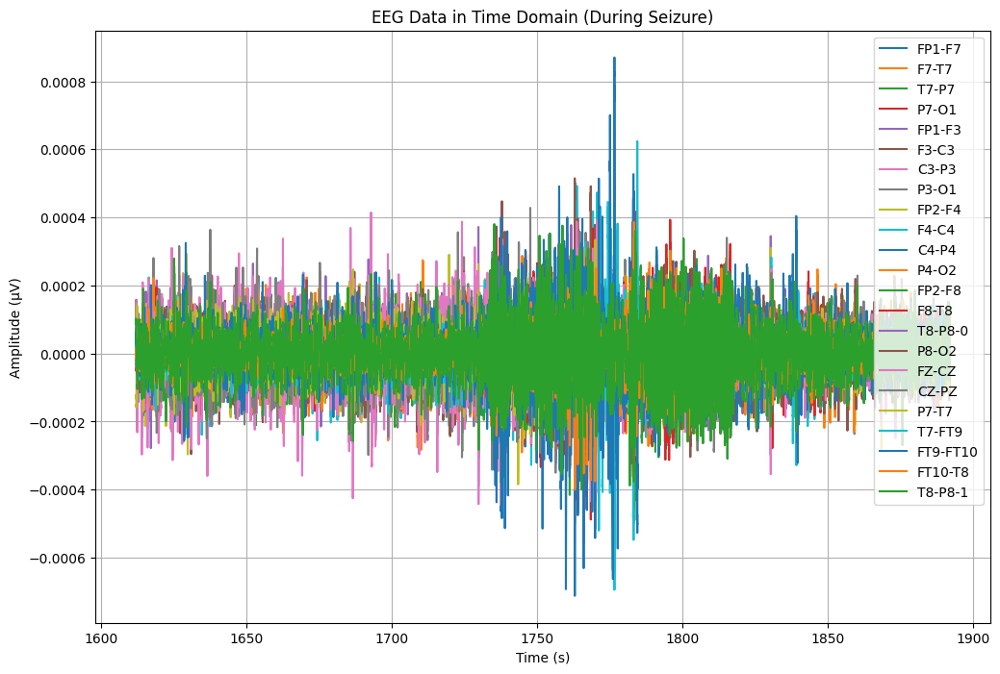

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA15['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA15.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA15[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


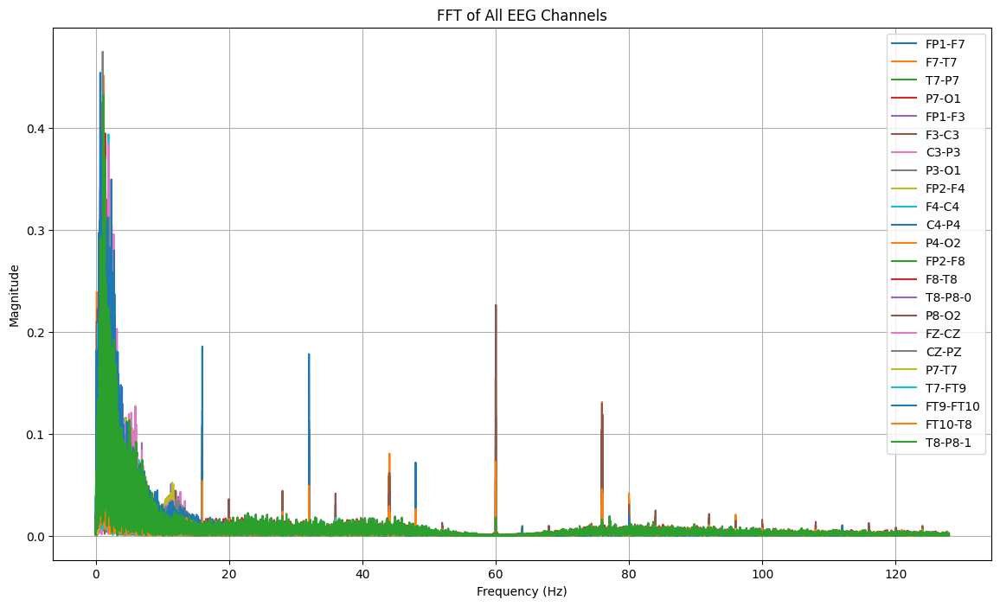

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA15[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1732:
        return "tidak kejang"
    elif 1732 <= row['Time'] < 1772:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_15 = TA15.copy()
TA_15['seizure'] = TA_15.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_15[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1612.000000  tidak kejang  0.000102  0.000072  0.000152  0.000037   
1  1612.003906  tidak kejang  0.000100  0.000076  0.000146  0.000032   
2  1612.007812  tidak kejang  0.000099  0.000076  0.000142  0.000032   
3  1612.011719  tidak kejang  0.000097  0.000069  0.000146  0.000033   
4  1612.015625  tidak kejang  0.000088  0.000060  0.000154  0.000031   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000021  0.000153  0.000117  0.000073  ... -0.000045  0.000102  0.000029   
1  0.000026  0.000143  0.000112  0.000074  ... -0.000042  0.000095  0.000005   
2  0.000032  0.000132  0.000109  0.000078  ... -0.000045  0.000088  0.000024   
3  0.000038  0.000122  0.000104  0.000082  ... -0.000051  0.000087  0.000047   
4  0.000042  0.000112  0.000096  0.000085  ... -0.000042  0.000086  0.000015   

      FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_15['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,10240


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_15)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 280.0 detik


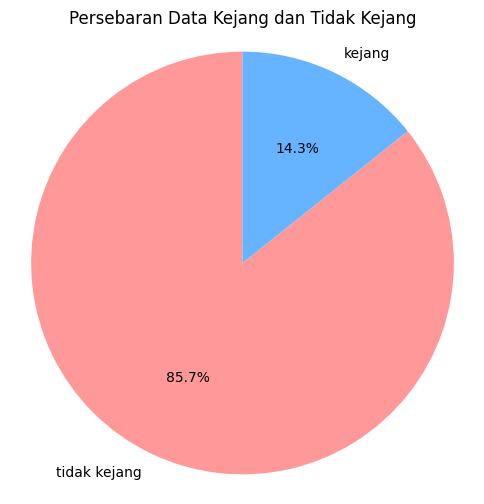

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_15['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_15.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_15.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_15.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_15['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       1.00      0.89      0.94      2100
tidak kejang       0.98      1.00      0.99     12236

    accuracy                           0.98     14336
   macro avg       0.99      0.95      0.97     14336
weighted avg       0.98      0.98      0.98     14336

Akurasi: 0.98388671875
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       1.00      0.89      0.94      2100
tidak kejang       0.98      1.00      0.99     12236

    accuracy                           0.98     14336
   macro avg       0.99      0.95      0.97     14336
weighted avg       0.98      0.98      0.98     14336



# DATA 16 (chb01_16)

In [ ]:
# mengimport file edf
file16 = "/content/drive/MyDrive/TA/EDF/chb01_16.edf"
data16 = mne.io.read_raw_edf(file16) # membaca file edf dan menyimpannya di data
data16


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_16.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-151-b0e01ee86623>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data16 = mne.io.read_raw_edf(file16) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_16.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data16.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data16.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data16.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df16 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df16['Time'] = times  # Menambahkan kolom waktu
df16.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.043956e-05,5.958486e-05,1.582418e-05,-6.036630e-05,-4.200244e-05,9.318681e-05,-4.512821e-05,-3.145299e-05,9.181929e-06,5.665446e-06,...,-2.559219e-05,-3.674725e-04,5.333333e-05,-5.137973e-05,-1.543346e-05,-3.770452e-05,-5.860806e-07,7.833944e-05,-2.559219e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,-7.228327e-06,-5.860806e-07,-9.768010e-07,1.953602e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,-5.860806e-07,5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df16.shape)


(921600, 24)


In [ ]:
# mendeskripsikan data
df16.describe()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.674065e-07,1.664119e-07,2.056963e-07,2.046737e-07,1.930712e-07,1.619069e-07,2.055776e-07,1.991729e-07,2.032098e-07,1.660320e-07,...,1.926617e-07,2.008687e-07,1.672017e-07,2.115898e-07,1.850241e-07,1.830620e-07,2.108894e-07,2.097371e-07,1.926617e-07,1799.998047
std,4.499182e-05,3.889350e-05,4.279833e-05,4.412269e-05,5.432335e-05,5.511390e-05,4.313423e-05,5.617577e-05,5.341219e-05,5.878084e-05,...,5.524322e-05,5.775020e-05,6.744579e-05,6.591931e-05,4.279833e-05,2.736749e-05,5.450405e-05,3.212783e-05,5.524322e-05,1039.231048
min,-5.936996e-04,-6.827839e-04,-3.381685e-04,-3.026129e-04,-5.858852e-04,-5.210256e-04,-3.596581e-04,-5.089133e-04,-4.471795e-04,-5.456410e-04,...,-6.280830e-04,-7.089621e-04,-4.729670e-04,-7.597558e-04,-3.534066e-04,-4.256899e-04,-6.921612e-04,-3.877900e-04,-6.280830e-04,0.000000
25%,-2.168498e-05,-1.934066e-05,-2.090354e-05,-2.285714e-05,-2.910867e-05,-2.871795e-05,-2.246642e-05,-2.754579e-05,-2.871795e-05,-3.067155e-05,...,-2.754579e-05,-3.184371e-05,-3.496947e-05,-3.340659e-05,-2.051282e-05,-1.465201e-05,-2.715507e-05,-1.699634e-05,-2.754579e-05,899.999023
50%,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,2.363858e-05,2.129426e-05,2.090354e-05,2.246642e-05,2.871795e-05,3.067155e-05,2.207570e-05,2.754579e-05,2.832723e-05,3.262515e-05,...,2.754579e-05,3.223443e-05,3.731380e-05,3.262515e-05,2.129426e-05,1.543346e-05,2.676435e-05,1.699634e-05,2.754579e-05,2699.997070
max,6.823932e-04,4.147497e-04,3.537973e-04,3.190232e-04,5.483761e-04,3.854457e-04,3.756777e-04,4.421001e-04,4.839072e-04,3.709890e-04,...,4.362393e-04,8.093773e-04,4.624176e-04,1.218071e-03,3.385592e-04,4.299878e-04,6.194872e-04,4.393651e-04,4.362393e-04,3599.996094


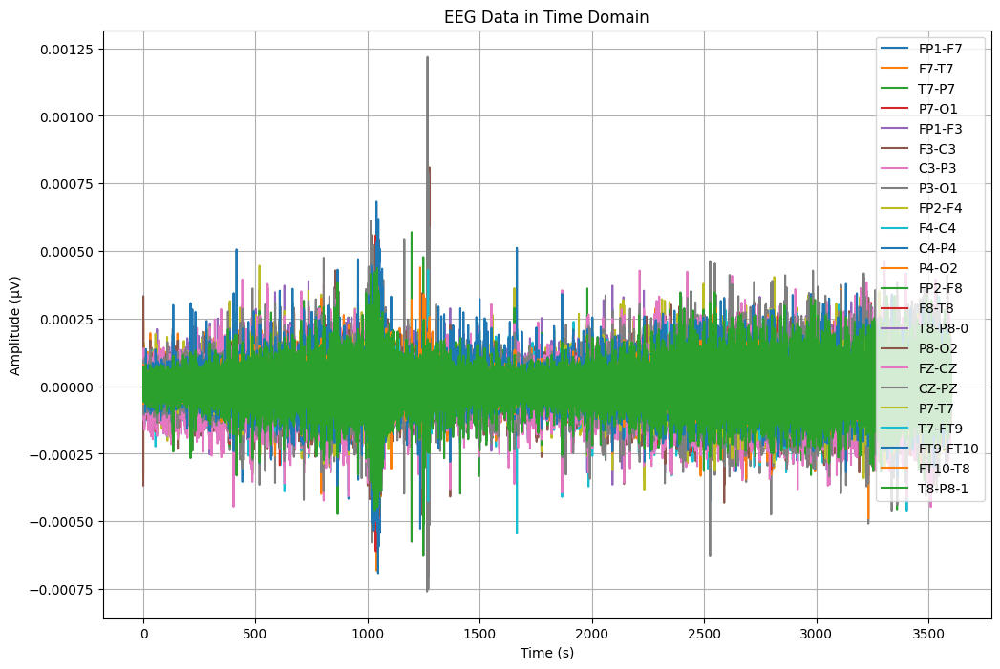

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df16['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df16[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


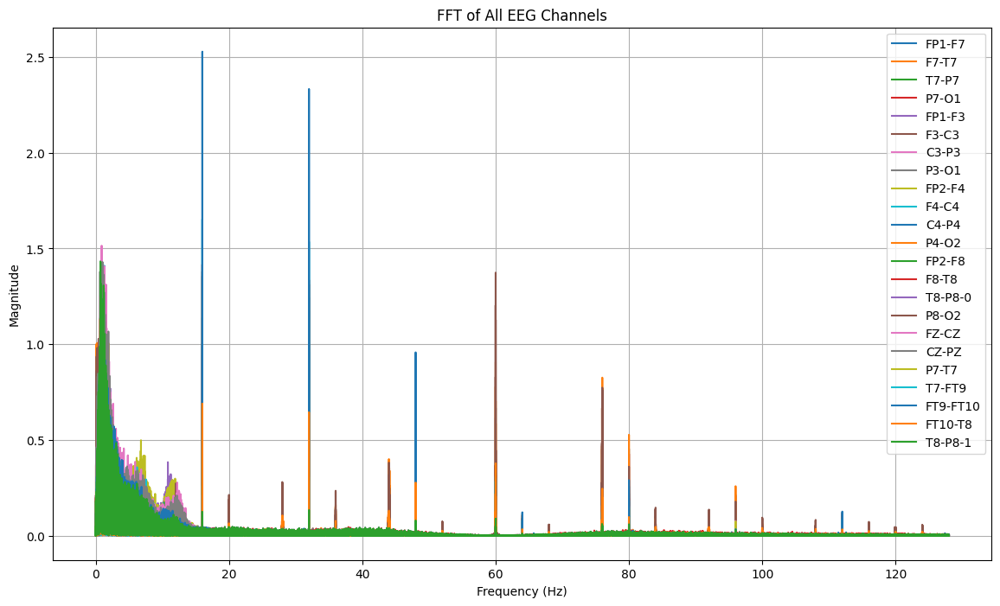

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df16[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv"
df16.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv


In [ ]:
#Import Data CSV
dataTA16 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_16.csv")
dataTA16


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.043956e-05,5.958486e-05,1.582418e-05,-6.036630e-05,-4.200244e-05,9.318681e-05,-4.512821e-05,-3.145299e-05,9.181929e-06,5.665446e-06,...,-2.559219e-05,-3.674725e-04,5.333333e-05,-5.137973e-05,-1.543346e-05,-3.770452e-05,-5.860806e-07,7.833944e-05,-2.559219e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,-7.228327e-06,-5.860806e-07,-9.768010e-07,1.953602e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,5.860806e-07,9.768010e-07,1.953602e-07,5.860806e-07,1.953602e-07,-5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.715507e-05,2.637363e-05,5.684982e-05,2.910867e-05,3.321123e-06,-9.768010e-07,1.113553e-05,1.271795e-04,2.207570e-05,-6.056166e-06,...,-1.973138e-05,-1.387057e-05,-1.621490e-05,-3.926740e-05,-5.645910e-05,-3.711844e-06,-8.400488e-06,-1.308913e-05,-1.973138e-05,3599.980469
921596,2.832723e-05,2.715507e-05,5.411477e-05,2.090354e-05,4.884005e-06,1.367521e-06,7.619048e-06,1.181929e-04,2.363858e-05,-4.884005e-06,...,-1.934066e-05,-3.575092e-05,-1.269841e-05,-4.317460e-05,-5.372405e-05,-1.367521e-06,-1.308913e-05,-1.465201e-05,-1.934066e-05,3599.984375
921597,3.692308e-05,2.637363e-05,4.356532e-05,2.090354e-05,4.884005e-06,3.711844e-06,5.860806e-07,1.185836e-04,2.246642e-05,-5.274725e-06,...,-2.012210e-05,8.400488e-06,-8.400488e-06,-4.512821e-05,-4.317460e-05,5.274725e-06,-2.989011e-05,-2.051282e-05,-2.012210e-05,3599.988281
921598,4.122100e-05,2.051282e-05,4.122100e-05,1.973138e-05,3.321123e-06,4.102564e-06,-2.539683e-06,1.178022e-04,2.051282e-05,-8.009768e-06,...,-1.699634e-05,3.848596e-05,-6.446886e-06,-4.551893e-05,-4.083028e-05,1.426129e-05,-3.770452e-05,-3.262515e-05,-1.699634e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA16[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA16[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA16[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data16, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.528138, Time: 1046.738281 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.652329, Time: 1269.304688 s
Channel: FZ-CZ, Max Frequency: 0.90 Hz, Magnitude: 1.514784, Time: 1021.570312 s
Channel: T8-P8-0, Max Frequency: 0.72 Hz, Magnitude: 1.432572, Time: 1248.382812 s
Channel: T8-P8-1, Max Frequency: 0.72 Hz, Magnitude: 1.432572, Time: 1248.382812 s
Channel: CZ-PZ, Max Frequency: 1.02 Hz, Magnitude: 1.429834, Time: 1267.085938 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.416581, Time: 1044.218750 s
Channel: F4-C4, Max Frequency: 1.30 Hz, Magnitude: 1.410236, Time: 1665.312500 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 1.379728, Time: 1276.054688 s
Channel: F3-C3, Max Frequency: 1.21 Hz, Magnitude: 1.379514, Time: 1040.378906 s
Channel: P3-O1, Max Frequency: 0.66 Hz, Magnitude: 1.379471, Time: 3232.273438 s
Channel: P4-O2, Ma

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: C3-P3, Max Frequency: 0.91 Hz, Magnitude: 0.936430, Time: 804.257812 s
Channel: FZ-CZ, Max Frequency: 0.90 Hz, Magnitude: 1.514784, Time: 1021.570312 s
Channel: T7-P7, Max Frequency: 0.96 Hz, Magnitude: 1.019501, Time: 1035.867188 s
Channel: P7-T7, Max Frequency: 0.96 Hz, Magnitude: 1.019501, Time: 1035.867188 s
Channel: FP2-F4, Max Frequency: 0.97 Hz, Magnitude: 1.017499, Time: 1039.519531 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.003745, Time: 1039.531250 s
Channel: F7-T7, Max Frequency: 1.22 Hz, Magnitude: 0.868094, Time: 1040.347656 s
Channel: F3-C3, Max Frequency: 1.21 Hz, Magnitude: 1.379514, Time: 1040.378906 s
Channel: FP1-F3, Max Frequency: 1.20 Hz, Magnitude: 1.185412, Time: 1040.421875 s
Channel: P7-O1, Max Frequency: 1.17 Hz, Magnitude: 1.018006, Time: 1042.687500 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.416581, Time: 1044.21875

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 895   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1186    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut16 = dataTA16.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut16.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_16.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA16 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_16.csv")
TA16.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000006,0.000017,-0.000013,0.000046,4.942613e-05,-0.000058,0.000006,0.000060,0.000038,-0.000084,...,0.000043,0.000074,-0.000109,0.000102,0.000014,-0.000029,-0.000050,-1.074481e-05,0.000043,895.000000
1,-0.000007,0.000037,-0.000029,0.000038,3.301587e-05,-0.000062,0.000014,0.000055,0.000033,-0.000092,...,0.000040,0.000041,-0.000123,0.000104,0.000029,-0.000048,-0.000040,-7.228327e-06,0.000040,895.003906
2,-0.000030,0.000041,-0.000018,0.000034,1.621490e-05,-0.000062,0.000019,0.000053,0.000029,-0.000099,...,0.000029,0.000009,-0.000134,0.000106,0.000019,-0.000045,-0.000031,8.400488e-06,0.000029,895.007812
3,-0.000035,0.000019,0.000004,0.000032,-5.860806e-07,-0.000058,0.000024,0.000056,0.000015,-0.000100,...,0.000028,0.000043,-0.000137,0.000115,-0.000004,-0.000018,-0.000027,4.884005e-06,0.000028,895.011719
4,-0.000037,0.000006,0.000016,0.000032,-1.973138e-05,-0.000053,0.000029,0.000062,-0.000002,-0.000100,...,0.000023,0.000060,-0.000139,0.000123,-0.000015,-0.000007,-0.000013,1.953602e-07,0.000023,895.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA16.shape


(74496, 24)

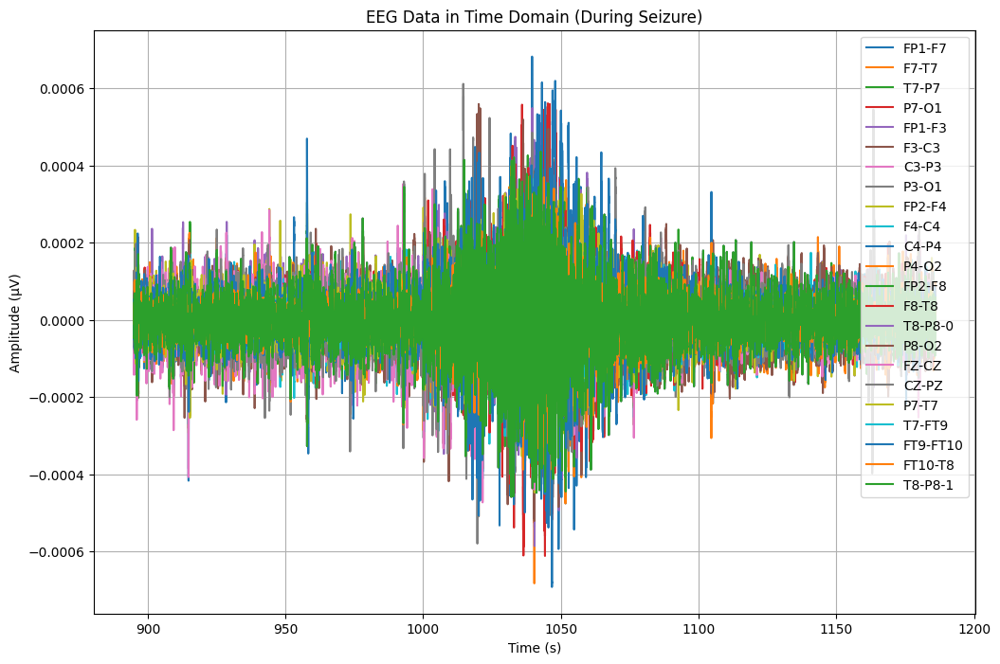

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA16['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA16.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA16[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


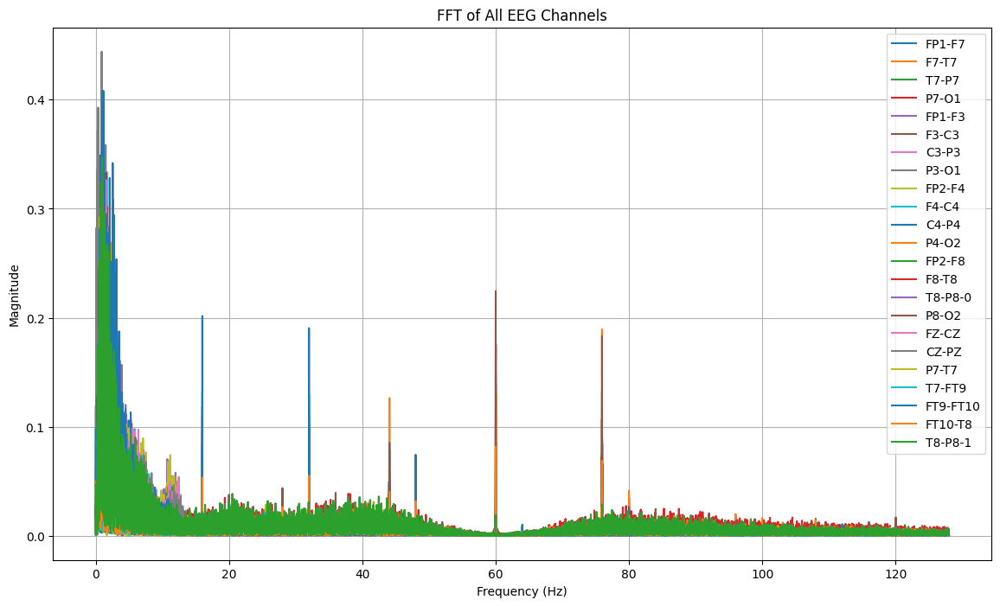

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA16[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1015:
        return "tidak kejang"
    elif 1015 <= row['Time'] < 1066:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_16 = TA16.copy()
TA_16['seizure'] = TA_16.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_16[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  895.000000  tidak kejang  0.000006  0.000017 -0.000013  0.000046   
1  895.003906  tidak kejang -0.000007  0.000037 -0.000029  0.000038   
2  895.007812  tidak kejang -0.000030  0.000041 -0.000018  0.000034   
3  895.011719  tidak kejang -0.000035  0.000019  0.000004  0.000032   
4  895.015625  tidak kejang -0.000037  0.000006  0.000016  0.000032   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0  4.942613e-05 -0.000058  0.000006  0.000060  ... -0.000051  0.000043   
1  3.301587e-05 -0.000062  0.000014  0.000055  ... -0.000049  0.000040   
2  1.621490e-05 -0.000062  0.000019  0.000053  ... -0.000030  0.000029   
3 -5.860806e-07 -0.000058  0.000024  0.000056  ... -0.000035  0.000028   
4 -1.973138e-05 -0.000053  0.000029  0.000062  ... -0.000037  0.000023   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10       FT10-T8  \
0  0.000074 -0.000109  0.000102  0.000014 -0.0000

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_16['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13056


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_16)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 291.0 detik


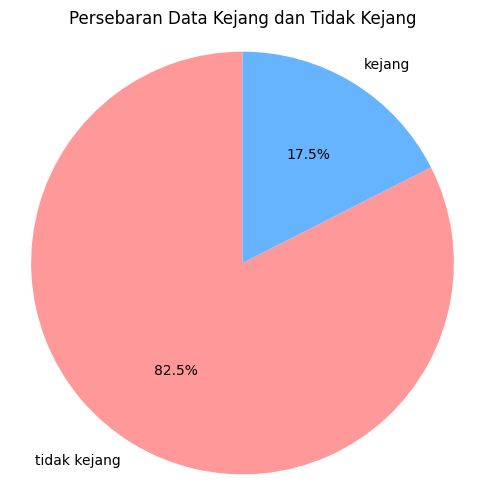

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_16['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_16.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_16.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_16.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_16['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))

# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))


              precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      2680
tidak kejang       0.98      1.00      0.99     12220

    accuracy                           0.98     14900
   macro avg       0.98      0.95      0.96     14900
weighted avg       0.98      0.98      0.98     14900

Akurasi: 0.978255033557047
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.90      0.94      2680
tidak kejang       0.98      1.00      0.99     12220

    accuracy                           0.98     14900
   macro avg       0.98      0.95      0.96     14900
weighted avg       0.98      0.98      0.98     14900



# DATA 17 (chb01_18)

In [ ]:
file17 = "/content/drive/MyDrive/TA/EDF/chb01_18.edf"
data17 = mne.io.read_raw_edf(file17) # membaca file edf dan menyimpannya di data
data17

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_18.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-175-3478a89c8d85>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data17 = mne.io.read_raw_edf(file17) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_18.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data17.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data17.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df17 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df17['Time'] = times  # Menambahkan kolom waktu
df17.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.536020e-05,6.349206e-05,-6.837607e-06,1.621490e-05,5.177045e-05,1.191697e-05,8.791209e-06,3.575092e-05,5.059829e-05,2.598291e-05,...,9.768010e-07,-1.924298e-04,-4.434676e-05,1.894994e-05,7.228327e-06,-1.619536e-04,1.347985e-05,1.025641e-04,9.768010e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,-6.837607e-06,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,0.015625


In [ ]:
channels = data17.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df17.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
df17.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.016492e-07,1.771550e-07,1.836827e-07,1.931832e-07,1.999067e-07,1.708295e-07,1.961784e-07,1.962331e-07,1.916620e-07,1.810461e-07,...,1.726313e-07,1.951516e-07,1.832557e-07,1.961899e-07,2.070377e-07,1.951817e-07,2.011053e-07,2.080438e-07,1.726313e-07,1799.998047
std,3.490810e-05,2.922000e-05,2.769049e-05,3.025611e-05,3.708658e-05,3.246304e-05,2.527418e-05,3.026389e-05,3.203059e-05,3.314178e-05,...,3.408141e-05,3.811200e-05,3.649301e-05,4.196750e-05,2.769049e-05,2.301585e-05,4.825242e-05,2.499980e-05,3.408141e-05,1039.231048
min,-6.175336e-04,-5.003175e-04,-3.041758e-04,-3.455922e-04,-4.608547e-04,-4.889866e-04,-3.842735e-04,-3.178510e-04,-3.366056e-04,-6.386325e-04,...,-6.312088e-04,-3.936508e-04,-4.311600e-04,-1.018803e-03,-5.061783e-04,-5.749451e-04,-1.495482e-03,-4.366300e-04,-6.312088e-04,0.000000
25%,-1.308913e-05,-1.191697e-05,-1.269841e-05,-1.347985e-05,-1.660562e-05,-1.543346e-05,-1.269841e-05,-1.621490e-05,-1.465201e-05,-1.582418e-05,...,-1.543346e-05,-2.168498e-05,-1.855922e-05,-1.973138e-05,-1.308913e-05,-1.035409e-05,-1.855922e-05,-1.113553e-05,-1.543346e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1799.998047
75%,1.308913e-05,1.269841e-05,1.347985e-05,1.387057e-05,1.660562e-05,1.660562e-05,1.308913e-05,1.621490e-05,1.504274e-05,1.660562e-05,...,1.660562e-05,2.207570e-05,1.934066e-05,1.973138e-05,1.308913e-05,1.035409e-05,1.816850e-05,1.152625e-05,1.660562e-05,2699.997070
max,7.597558e-04,3.819292e-04,5.065690e-04,4.737485e-04,5.757265e-04,4.510867e-04,4.874237e-04,3.545788e-04,5.405617e-04,3.377778e-04,...,4.573382e-04,6.343346e-04,5.776801e-04,1.011380e-03,3.045665e-04,4.819536e-04,7.152137e-04,1.629499e-03,4.573382e-04,3599.996094


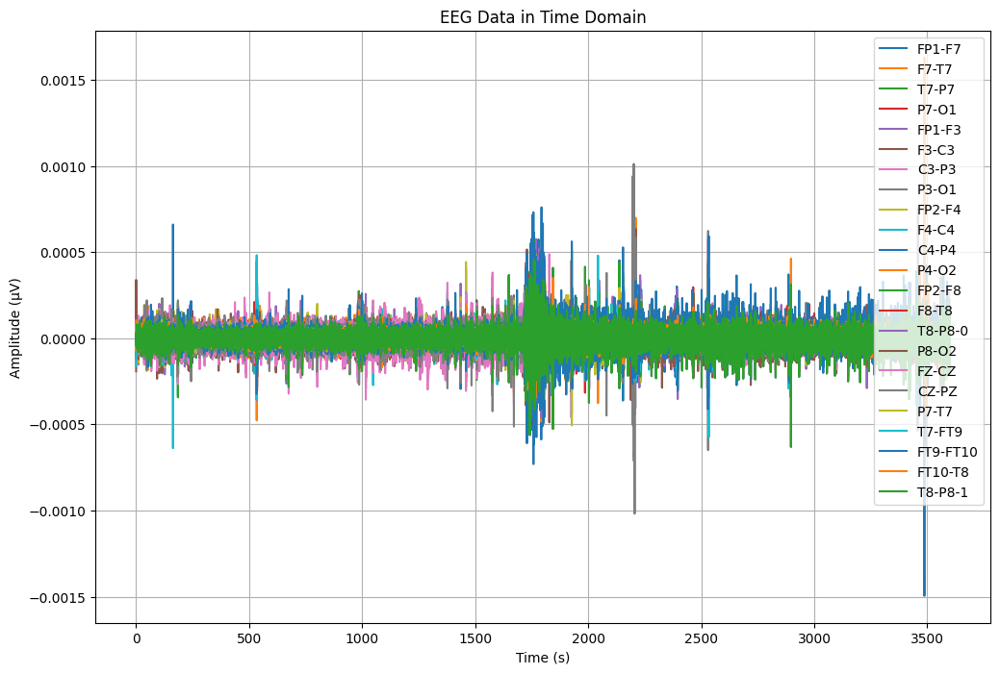

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df17['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df17[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

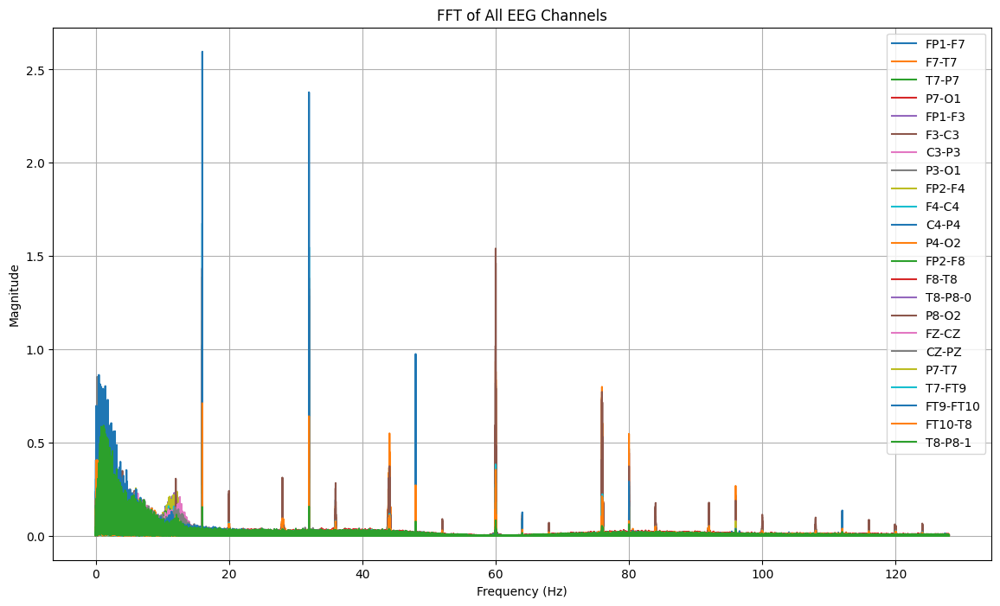

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df17[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv"
df17.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv


In [ ]:
dataTA17 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_18.csv")
dataTA17

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,3.536020e-05,6.349206e-05,-6.837607e-06,1.621490e-05,5.177045e-05,1.191697e-05,8.791209e-06,3.575092e-05,5.059829e-05,2.598291e-05,...,9.768010e-07,-1.924298e-04,-4.434676e-05,1.894994e-05,7.228327e-06,-1.619536e-04,1.347985e-05,1.025641e-04,9.768010e-07,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,-6.837607e-06,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,2.148962e-06,-1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,5.860806e-07,1.758242e-06,1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.559219e-05,5.274725e-06,1.543346e-05,-1.934066e-05,-5.665446e-06,8.009768e-06,-1.113553e-05,-1.465201e-05,-3.184371e-05,5.724054e-05,...,-4.434676e-05,-8.791209e-06,4.434676e-05,-2.246642e-05,-1.504274e-05,-3.692308e-05,4.669109e-05,6.583639e-05,-4.434676e-05,3599.980469
921596,-1.934066e-05,1.113553e-05,1.543346e-05,-2.481074e-05,5.860806e-07,1.621490e-05,-1.113553e-05,-2.246642e-05,-2.754579e-05,6.739927e-05,...,-3.965812e-05,-5.645910e-05,5.098901e-05,-2.051282e-05,-1.504274e-05,-3.575092e-05,4.512821e-05,6.622711e-05,-3.965812e-05,3599.984375
921597,-1.269841e-05,1.660562e-05,9.181929e-06,-2.363858e-05,6.056166e-06,2.285714e-05,-1.621490e-05,-2.285714e-05,-2.442002e-05,7.365079e-05,...,-3.653236e-05,-8.732601e-05,5.567766e-05,-1.894994e-05,-8.791209e-06,-3.536020e-05,3.848596e-05,6.857143e-05,-3.653236e-05,3599.988281
921598,-4.102564e-06,1.738706e-05,6.446886e-06,-2.285714e-05,1.035409e-05,2.793651e-05,-1.934066e-05,-2.246642e-05,-2.363858e-05,8.107448e-05,...,-3.262515e-05,-3.301587e-05,6.818071e-05,-1.269841e-05,-6.056166e-06,-2.402930e-05,2.871795e-05,6.271062e-05,-3.262515e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA17[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA17[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA17[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data17, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.595869, Time: 3487.343750 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.675268, Time: 2533.523438 s
Channel: P8-O2, Max Frequency: 60.00 Hz, Magnitude: 1.540294, Time: 2209.945312 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.436182, Time: 1762.371094 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.387693, Time: 1827.984375 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.215149, Time: 3559.687500 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.023885, Time: 1793.527344 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.020163, Time: 163.214844 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 0.947442, Time: 1769.488281 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.944413, Time: 1827.984375 s
Channel: P4-O2, Max Frequency: 60.00 Hz, Magnitude: 0.936111, Time: 2209.945312 s
Channel: CZ-PZ

In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA17[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA17[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz


# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA17[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data17, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F4-C4, Max Frequency: 0.89 Hz, Magnitude: 0.572209, Time: 163.214844 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.020163, Time: 163.214844 s
Channel: P7-O1, Max Frequency: 32.00 Hz, Magnitude: 0.850356, Time: 1753.640625 s
Channel: FP2-F4, Max Frequency: 0.52 Hz, Magnitude: 0.514145, Time: 1756.652344 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 0.693477, Time: 1758.941406 s
Channel: F7-T7, Max Frequency: 1.42 Hz, Magnitude: 0.541769, Time: 1762.347656 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.436182, Time: 1762.371094 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 0.947442, Time: 1769.488281 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 1.023885, Time: 1793.527344 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.387693, Time: 1827.984375 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.944413, Time: 1827

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1600   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1930    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut17 = dataTA17.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut17.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_18.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA17 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_18.csv")
TA17.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000010,-0.000012,0.000012,-0.000019,-0.000017,0.000007,0.000004,-1.758242e-06,0.000024,0.000025,...,0.000004,-0.000014,0.000014,1.035409e-05,-0.000011,1.113553e-05,0.000008,0.000012,0.000004,1600.000000
1,0.000013,-0.000012,0.000013,-0.000014,-0.000013,0.000006,0.000005,9.768010e-07,0.000024,0.000029,...,0.000011,0.000004,0.000017,1.504274e-05,-0.000012,1.543346e-05,0.000008,0.000009,0.000011,1600.003906
2,0.000009,-0.000006,0.000010,-0.000012,-0.000009,0.000005,0.000003,1.758242e-06,0.000031,0.000030,...,0.000013,-0.000019,0.000013,1.758242e-06,-0.000009,9.768010e-07,0.000013,0.000024,0.000013,1600.007812
3,0.000010,-0.000006,0.000008,-0.000009,-0.000005,0.000004,0.000002,1.367521e-06,0.000033,0.000028,...,0.000015,-0.000034,0.000012,-6.056166e-06,-0.000007,-8.009768e-06,0.000017,0.000035,0.000015,1600.011719
4,0.000011,-0.000008,0.000006,-0.000006,-0.000003,0.000003,0.000002,1.953602e-07,0.000034,0.000028,...,0.000022,-0.000028,0.000015,-9.768010e-07,-0.000006,2.539683e-06,0.000012,0.000026,0.000022,1600.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA17.shape

(84480, 24)

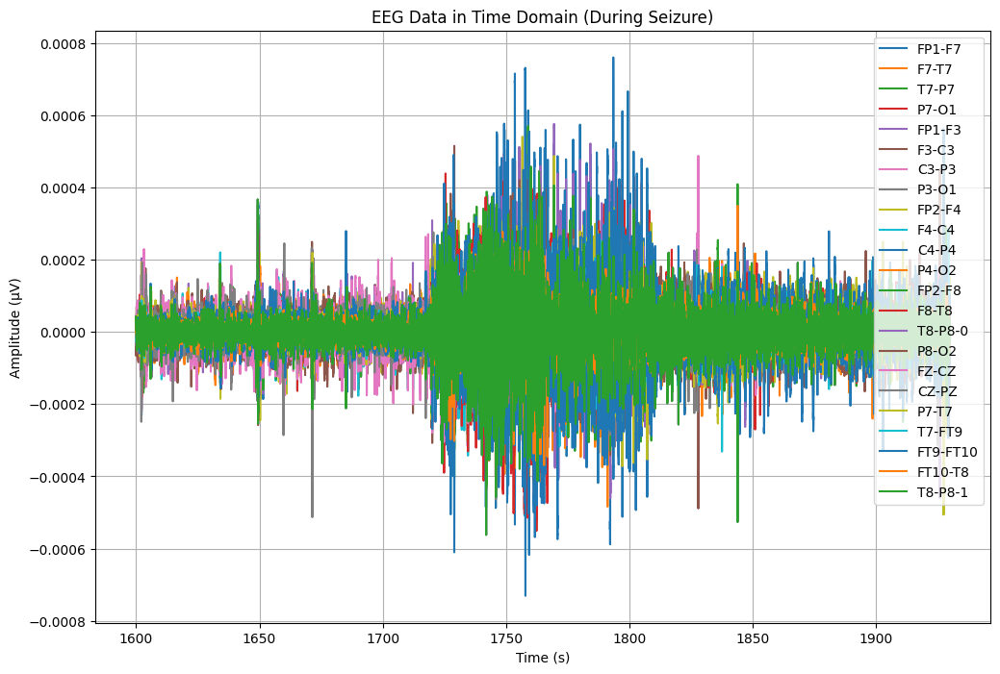

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA17['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA17.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA17[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


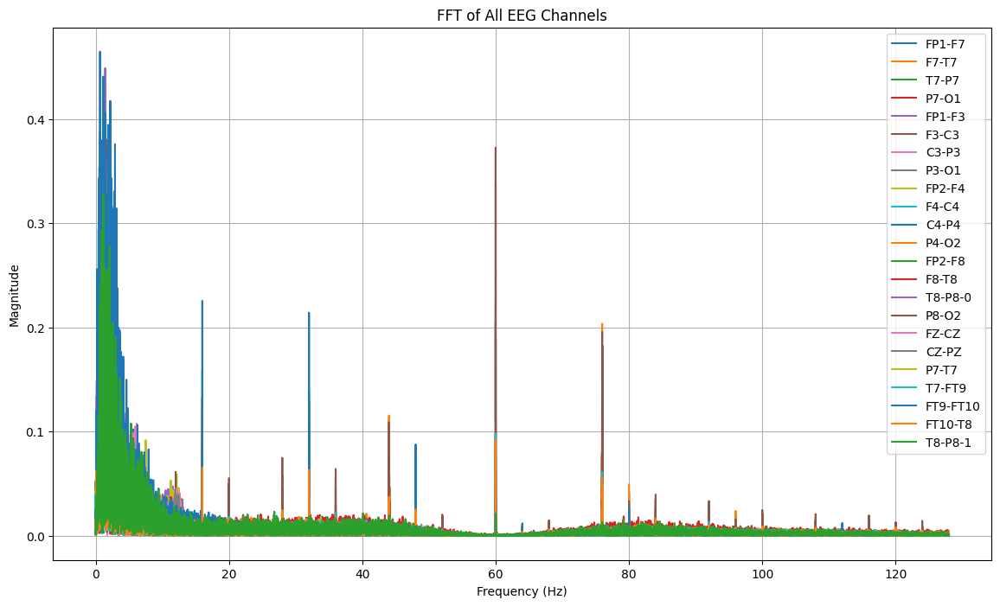

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA17[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1720:
        return "tidak kejang"
    elif 1720 <= row['Time'] < 1810:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_17 = TA17.copy()
TA_17['seizure'] = TA_17.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_17[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1600.000000  tidak kejang  0.000010 -0.000012  0.000012 -0.000019   
1  1600.003906  tidak kejang  0.000013 -0.000012  0.000013 -0.000014   
2  1600.007812  tidak kejang  0.000009 -0.000006  0.000010 -0.000012   
3  1600.011719  tidak kejang  0.000010 -0.000006  0.000008 -0.000009   
4  1600.015625  tidak kejang  0.000011 -0.000008  0.000006 -0.000006   

     FP1-F3     F3-C3     C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000017  0.000007  0.000004 -1.758242e-06  ...  0.000008  0.000004   
1 -0.000013  0.000006  0.000005  9.768010e-07  ...  0.000002  0.000011   
2 -0.000009  0.000005  0.000003  1.758242e-06  ...  0.000014  0.000013   
3 -0.000005  0.000004  0.000002  1.367521e-06  ...  0.000023  0.000015   
4 -0.000003  0.000003  0.000002  1.953602e-07  ...  0.000016  0.000022   

      P8-O2     FZ-CZ         CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0 -0.000014  0.000014  1.035409e-05 -0.000011  1.

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_17['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,23040


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_17)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 330.0 detik


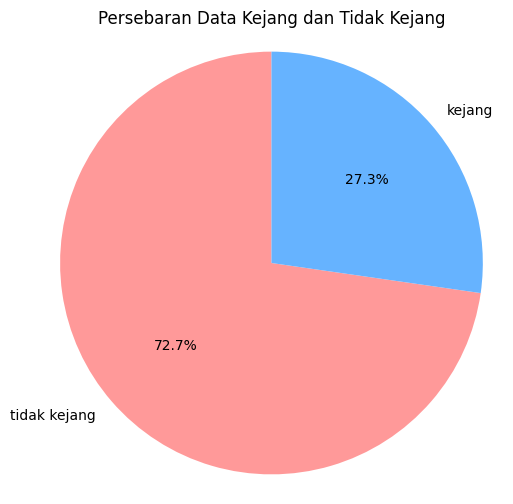

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_17['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_17.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_18.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_17.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_17['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4677
tidak kejang       0.98      1.00      0.99     12219

    accuracy                           0.98     16896
   macro avg       0.99      0.97      0.98     16896
weighted avg       0.98      0.98      0.98     16896

Akurasi: 0.9833688446969697
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4677
tidak kejang       0.98      1.00      0.99     12219

    accuracy                           0.98     16896
   macro avg       0.99      0.97      0.98     16896
weighted avg       0.98      0.98      0.98     16896



# DATA 18 (chb01_21)

In [ ]:
file18 = "/content/drive/MyDrive/TA/EDF/chb01_21.edf"
data18 = mne.io.read_raw_edf(file18) # membaca file edf dan menyimpannya di data
data18

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_21.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-199-9ea486a8993b>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data18 = mne.io.read_raw_edf(file18) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_21.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data18.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data18.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df18 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df18['Time'] = times  # Menambahkan kolom waktu
df18.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,-2.793651e-05,-6.837607e-06,-1.504274e-05,9.768010e-07,-7.482295e-05,-2.930403e-06,-2.363858e-05,4.200244e-05,-5.450549e-05,...,-2.637363e-05,-3.770452e-05,-5.528694e-05,-5.997558e-05,7.228327e-06,-6.192918e-05,3.926740e-05,7.912088e-05,-2.637363e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,-9.768010e-07,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.015625


In [ ]:
channels = data18.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df18.shape) #23 baris dan 921600 kolom

(921600, 24)


In [ ]:
df18.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.153329e-07,1.841028e-07,1.794524e-07,1.889385e-07,1.935592e-07,1.983830e-07,1.933502e-07,1.925341e-07,1.973638e-07,1.911376e-07,...,1.534892e-07,1.941947e-07,1.942498e-07,1.565264e-07,2.112680e-07,1.932714e-07,1.966567e-07,2.107864e-07,1.534892e-07,1799.998047
std,6.289710e-05,4.110748e-05,3.335726e-05,2.810327e-05,6.073348e-05,3.917120e-05,2.836364e-05,3.046516e-05,5.338453e-05,4.021296e-05,...,4.299551e-05,3.737323e-05,4.253606e-05,4.854325e-05,3.335726e-05,3.194406e-05,6.756242e-05,3.227766e-05,4.299551e-05,1039.231048
min,-8.586081e-04,-5.745543e-04,-5.643956e-04,-5.061783e-04,-6.823932e-04,-6.870818e-04,-3.729426e-04,-3.498901e-04,-7.601465e-04,-6.644200e-04,...,-5.784615e-04,-5.182906e-04,-9.008059e-04,-1.884249e-03,-6.175336e-04,-6.714530e-04,-7.964835e-04,-4.190476e-04,-5.784615e-04,0.000000
25%,-1.777778e-05,-1.621490e-05,-1.621490e-05,-1.347985e-05,-2.129426e-05,-1.777778e-05,-1.387057e-05,-1.621490e-05,-1.934066e-05,-1.855922e-05,...,-1.973138e-05,-1.816850e-05,-2.012210e-05,-2.285714e-05,-1.621490e-05,-1.387057e-05,-2.676435e-05,-1.426129e-05,-1.973138e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1799.998047
75%,1.738706e-05,1.660562e-05,1.660562e-05,1.387057e-05,2.051282e-05,1.816850e-05,1.387057e-05,1.621490e-05,1.855922e-05,1.934066e-05,...,2.168498e-05,1.934066e-05,2.090354e-05,2.285714e-05,1.660562e-05,1.426129e-05,2.598291e-05,1.426129e-05,2.168498e-05,2699.997070
max,9.504274e-04,5.436874e-04,6.179243e-04,4.772650e-04,9.484737e-04,4.319414e-04,6.081563e-04,2.990965e-04,6.741880e-04,7.390476e-04,...,4.194383e-04,5.136020e-04,1.012161e-03,1.074676e-03,5.647863e-04,4.901587e-04,7.245910e-04,6.300366e-04,4.194383e-04,3599.996094


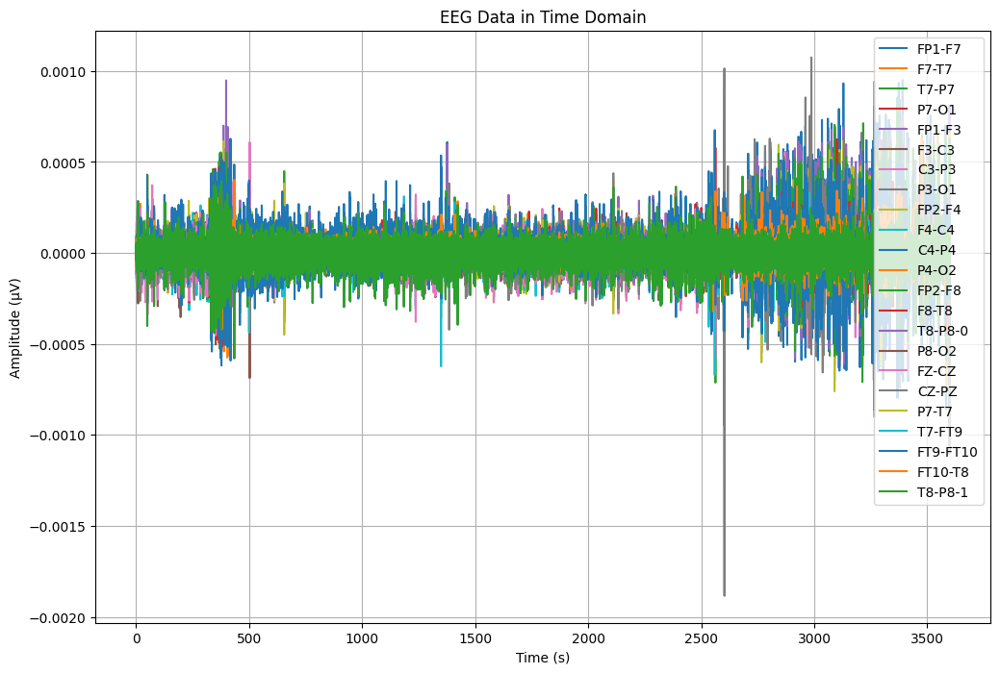

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df18['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df18[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

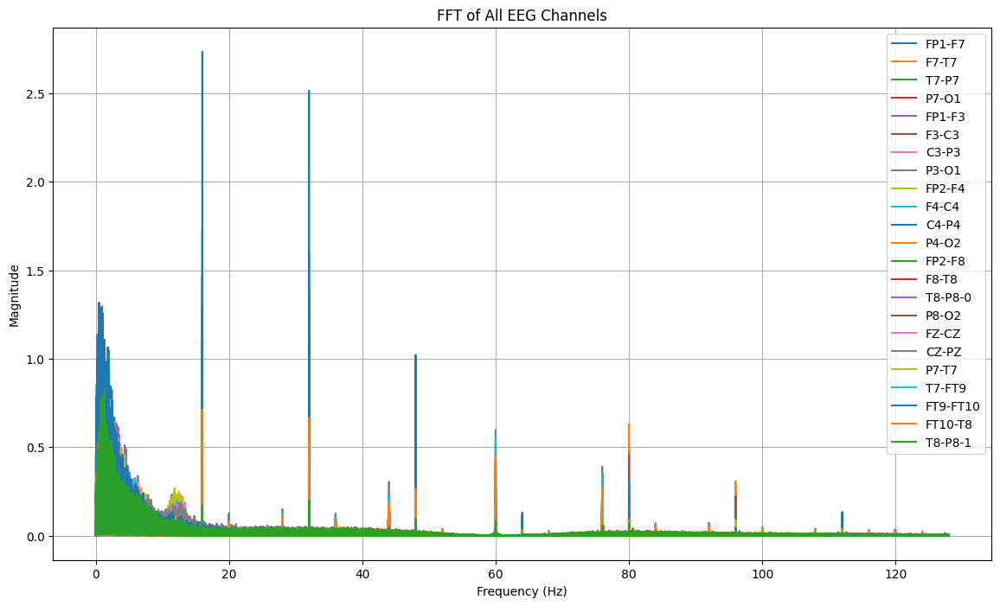

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df18[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv"
df18.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv


In [ ]:
dataTA18 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_21.csv")
dataTA18

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,-2.793651e-05,-6.837607e-06,-1.504274e-05,9.768010e-07,-7.482295e-05,-2.930403e-06,-2.363858e-05,4.200244e-05,-5.450549e-05,...,-2.637363e-05,-3.770452e-05,-5.528694e-05,-5.997558e-05,7.228327e-06,-6.192918e-05,3.926740e-05,7.912088e-05,-2.637363e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,-9.768010e-07,-5.860806e-07,-1.758242e-06,1.953602e-07,-1.758242e-06,9.768010e-07,1.758242e-06,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.442002e-05,3.418803e-05,-1.894994e-05,2.832723e-05,-2.793651e-05,8.459096e-05,-4.317460e-05,5.274725e-06,-1.855922e-05,-4.630037e-05,...,-3.184371e-05,2.207570e-05,-2.051282e-05,2.871795e-05,1.934066e-05,-1.113553e-05,5.880342e-05,-4.864469e-05,-3.184371e-05,3599.980469
921596,-2.676435e-05,4.043956e-05,-1.934066e-05,2.090354e-05,-2.598291e-05,8.654457e-05,-4.630037e-05,1.367521e-06,-1.308913e-05,-3.770452e-05,...,-2.676435e-05,1.816850e-05,-1.582418e-05,3.536020e-05,1.973138e-05,-1.504274e-05,4.864469e-05,-4.200244e-05,-2.676435e-05,3599.984375
921597,-3.536020e-05,3.887668e-05,-1.934066e-05,1.582418e-05,-3.418803e-05,8.654457e-05,-4.942613e-05,-2.148962e-06,-1.191697e-05,-3.262515e-05,...,-2.481074e-05,2.090354e-05,-2.090354e-05,4.551893e-05,1.973138e-05,-1.426129e-05,4.122100e-05,-4.278388e-05,-2.481074e-05,3599.988281
921598,-1.816850e-05,4.434676e-05,-2.402930e-05,1.191697e-05,-1.269841e-05,8.771673e-05,-5.255189e-05,-6.837607e-06,-7.619048e-06,-2.559219e-05,...,-2.246642e-05,1.894994e-05,-2.324786e-05,4.747253e-05,2.442002e-05,-2.168498e-05,3.887668e-05,-3.965812e-05,-2.246642e-05,3599.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA18[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA18[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA18[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data18, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 2.735199, Time: 3368.500000 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.727905, Time: 2560.089844 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.476151, Time: 502.542969 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 1.463940, Time: 3100.468750 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.360162, Time: 394.386719 s
Channel: P8-O2, Max Frequency: 32.00 Hz, Magnitude: 1.284700, Time: 3382.476562 s
Channel: FP1-F7, Max Frequency: 1.05 Hz, Magnitude: 1.211112, Time: 3391.187500 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 1.110596, Time: 3264.859375 s
Channel: FP1-F3, Max Frequency: 1.05 Hz, Magnitude: 1.090232, Time: 398.371094 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 1.038733, Time: 3382.460938 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.970485, Time: 502.542969 s
Channel: P7-O1, Max

In [ ]:
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 1.360162, Time: 394.386719 s
Channel: FP1-F3, Max Frequency: 1.05 Hz, Magnitude: 1.090232, Time: 398.371094 s
Channel: F7-T7, Max Frequency: 0.69 Hz, Magnitude: 0.833245, Time: 403.535156 s
Channel: T8-P8-0, Max Frequency: 1.33 Hz, Magnitude: 0.834622, Time: 434.074219 s
Channel: T8-P8-1, Max Frequency: 1.33 Hz, Magnitude: 0.834622, Time: 434.074219 s
Channel: F3-C3, Max Frequency: 16.00 Hz, Magnitude: 1.476151, Time: 502.542969 s
Channel: C3-P3, Max Frequency: 16.00 Hz, Magnitude: 0.970485, Time: 502.542969 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.727905, Time: 2560.089844 s
Channel: CZ-PZ, Max Frequency: 0.65 Hz, Magnitude: 0.776857, Time: 2602.855469 s
Channel: FZ-CZ, Max Frequency: 1.59 Hz, Magnitude: 0.720069, Time: 2602.859375 s
Channel: FP2-F4, Max Frequency: 1.05 Hz, Magnitude: 0.900553, Time: 3089.80078

In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 207   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 540    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut18 = dataTA18.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut18.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_21.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA18 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_21.csv")
TA18.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000011,-0.000016,-0.000033,0.000017,-0.000007,-0.000012,-0.000014,-0.000010,0.000041,-0.000008,...,-0.000009,-0.000012,0.000021,-0.000033,0.000034,0.000008,0.000020,8.791209e-06,-0.000009,207.000000
1,-0.000011,-0.000017,-0.000036,0.000019,-0.000008,-0.000013,-0.000013,-0.000008,0.000041,-0.000011,...,-0.000010,-0.000013,0.000023,-0.000041,0.000037,0.000005,0.000024,8.791209e-06,-0.000010,207.003906
2,-0.000013,-0.000022,-0.000037,0.000024,-0.000012,-0.000015,-0.000014,-0.000004,0.000038,-0.000015,...,-0.000009,-0.000008,0.000020,-0.000040,0.000037,0.000009,0.000022,4.102564e-06,-0.000009,207.007812
3,-0.000014,-0.000025,-0.000037,0.000029,-0.000015,-0.000019,-0.000013,0.000001,0.000034,-0.000019,...,-0.000006,-0.000005,0.000013,-0.000039,0.000037,0.000013,0.000018,1.953602e-07,-0.000006,207.011719
4,-0.000013,-0.000025,-0.000038,0.000037,-0.000013,-0.000021,-0.000013,0.000008,0.000031,-0.000024,...,-0.000005,-0.000002,0.000008,-0.000037,0.000038,0.000010,0.000017,5.860806e-07,-0.000005,207.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA18.shape

(85248, 24)

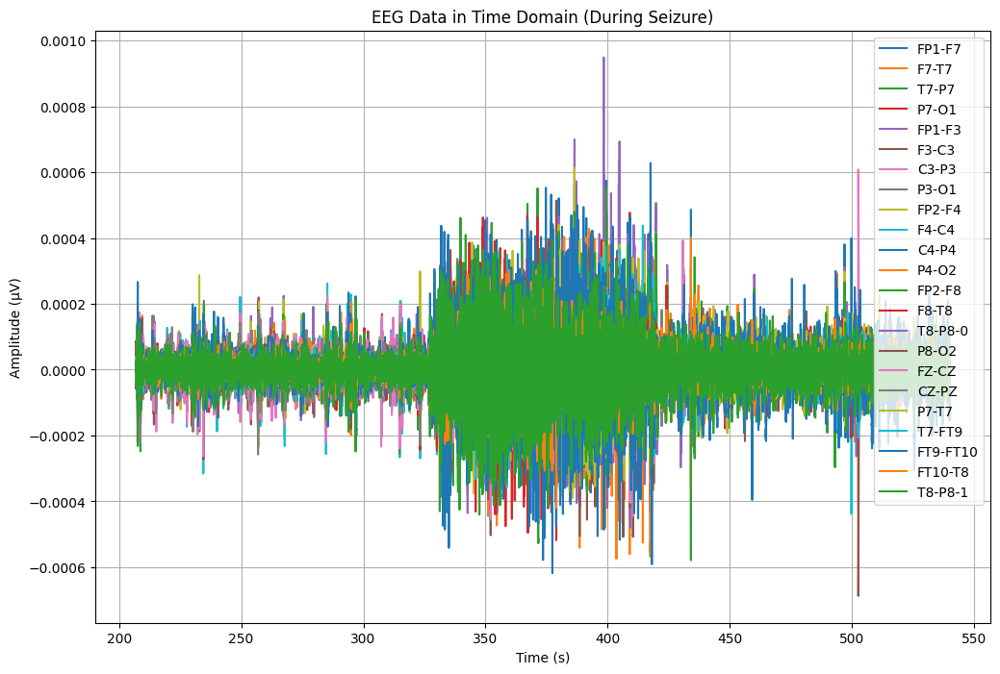

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA18['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA18.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA18[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


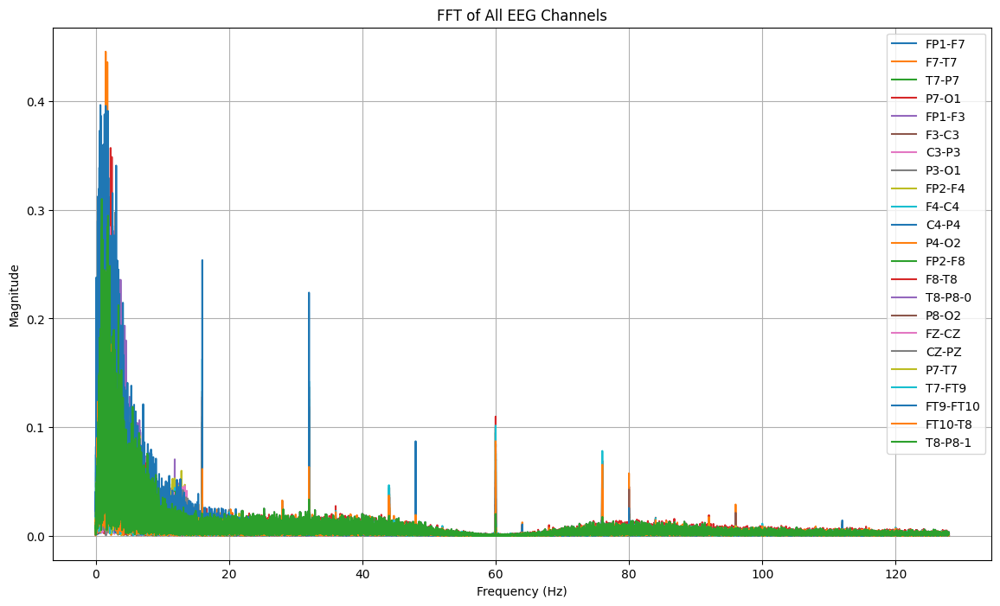

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA18[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 327:
        return "tidak kejang"
    elif 327 <= row['Time'] < 420:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_18 = TA18.copy()
TA_18['seizure'] = TA_18.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_18[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  207.000000  tidak kejang -0.000011 -0.000016 -0.000033  0.000017 -0.000007   
1  207.003906  tidak kejang -0.000011 -0.000017 -0.000036  0.000019 -0.000008   
2  207.007812  tidak kejang -0.000013 -0.000022 -0.000037  0.000024 -0.000012   
3  207.011719  tidak kejang -0.000014 -0.000025 -0.000037  0.000029 -0.000015   
4  207.015625  tidak kejang -0.000013 -0.000025 -0.000038  0.000037 -0.000013   

      F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2     FZ-CZ  \
0 -0.000012 -0.000014 -0.000010  ... -0.000021 -0.000009 -0.000012  0.000021   
1 -0.000013 -0.000013 -0.000008  ... -0.000019 -0.000010 -0.000013  0.000023   
2 -0.000015 -0.000014 -0.000004  ... -0.000029 -0.000009 -0.000008  0.000020   
3 -0.000019 -0.000013  0.000001  ... -0.000033 -0.000006 -0.000005  0.000013   
4 -0.000021 -0.000013  0.000008  ... -0.000031 -0.000005 -0.000002  0.000008   

      CZ-PZ     P7-T7    T7-FT9 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_18['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,23808


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_18)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 333.0 detik


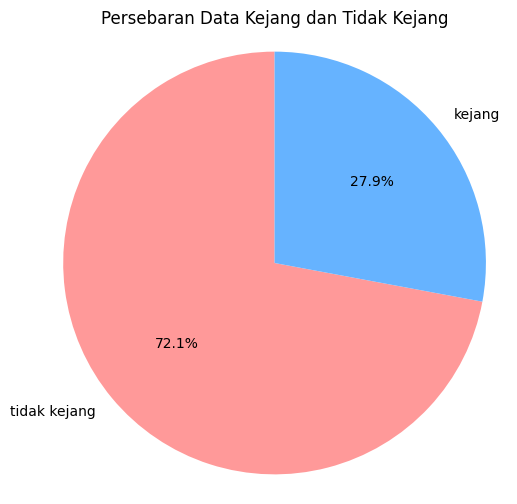

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_18['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_18.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_21.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_18.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_18['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4817
tidak kejang       0.98      1.00      0.99     12233

    accuracy                           0.98     17050
   macro avg       0.98      0.97      0.98     17050
weighted avg       0.98      0.98      0.98     17050

Akurasi: 0.9825219941348974
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.95      0.97      4817
tidak kejang       0.98      1.00      0.99     12233

    accuracy                           0.98     17050
   macro avg       0.98      0.97      0.98     17050
weighted avg       0.98      0.98      0.98     17050



# DATA 19 (chb01_26)

In [ ]:
file19 = "/content/drive/MyDrive/TA/EDF/chb01_26.edf"
data19 = mne.io.read_raw_edf(file19) # membaca file edf dan menyimpannya di data
data19

Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb01_26.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-223-4d5279880260>:2: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data19 = mne.io.read_raw_edf(file19) # membaca file edf dan menyimpannya di data


<RawEDF | chb01_26.edf, 23 x 595200 (2325.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data19.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data19.ch_names  # Mendapatkan nama channel

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df19 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df19['Time'] = times  # Menambahkan kolom waktu
df19.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,1.181929e-04,1.619536e-04,4.278388e-05,1.330403e-04,-2.139194e-04,3.119902e-04,4.122100e-05,5.684982e-05,-2.148962e-06,...,-3.106227e-05,9.357753e-05,1.582418e-05,2.832723e-05,-1.615629e-04,-2.754579e-05,2.291575e-04,-2.930403e-06,-3.106227e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-2.539683e-06,2.148962e-06,-1.953602e-07,9.768010e-07,-9.768010e-07,...,-3.711844e-06,1.953602e-07,-5.860806e-07,-3.321123e-06,5.860806e-07,-5.860806e-07,1.758242e-06,9.768010e-07,-3.711844e-06,0.015625


In [ ]:
channels = data19.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

Bipolar montage mengukur perbedaan tegangan antara dua titik elektroda yang berdekatan di kulit kepala. Nama-nama kanal seperti 'FP1-F7' menunjukkan bahwa tegangan yang diukur adalah perbedaan antara elektroda di posisi FP1 (Frontal Pole 1) dan F7 (Frontal 7).
Bipolar montage digunakan untuk meningkatkan resolusi spasial dari data EEG. Dengan mengukur perbedaan tegangan antara dua elektroda yang berdekatan, aktivitas listrik otak lokal bisa lebih jelas terlihat, karena setiap pengukuran lebih berfokus pada area kecil dari otak.

pelajari bipolar montage!!

In [ ]:
print(df19.shape) #23 baris dan 921600 kolom

(595200, 24)


In [ ]:
df19.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,...,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,5.952000e+05,595200.000000
mean,2.006007e-07,1.818465e-07,1.731222e-07,1.891160e-07,1.845104e-07,1.825259e-07,1.971891e-07,1.941648e-07,2.085168e-07,1.661310e-07,...,1.777535e-07,1.777325e-07,1.706001e-07,2.040497e-07,2.175982e-07,1.901250e-07,2.129708e-07,2.200940e-07,1.777535e-07,1162.498047
std,5.597364e-05,4.557905e-05,3.812132e-05,3.678945e-05,6.121230e-05,5.861786e-05,4.758908e-05,3.833102e-05,5.544189e-05,4.491906e-05,...,5.734014e-05,5.676751e-05,5.002744e-05,6.275893e-05,3.812132e-05,3.316304e-05,6.362798e-05,3.131797e-05,5.734014e-05,671.170252
min,-7.281074e-04,-6.179243e-04,-4.042002e-04,-3.401221e-04,-6.433211e-04,-8.039072e-04,-7.109158e-04,-3.850549e-04,-8.812698e-04,-5.370452e-04,...,-1.278242e-03,-1.048889e-03,-5.276679e-04,-1.024274e-03,-5.647863e-04,-7.320147e-04,-5.944811e-04,-2.901099e-04,-1.278242e-03,0.000000
25%,-1.973138e-05,-1.777778e-05,-1.738706e-05,-1.777778e-05,-2.402930e-05,-2.520147e-05,-2.129426e-05,-2.051282e-05,-2.129426e-05,-1.973138e-05,...,-2.481074e-05,-2.402930e-05,-2.207570e-05,-2.715507e-05,-1.777778e-05,-1.387057e-05,-2.676435e-05,-1.426129e-05,-2.481074e-05,581.249023
50%,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,9.768010e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,9.768010e-07,1162.498047
75%,1.973138e-05,1.816850e-05,1.816850e-05,1.855922e-05,2.363858e-05,2.637363e-05,2.090354e-05,2.090354e-05,2.051282e-05,2.129426e-05,...,2.637363e-05,2.520147e-05,2.363858e-05,2.637363e-05,1.777778e-05,1.426129e-05,2.559219e-05,1.426129e-05,2.637363e-05,1743.747070
max,8.136752e-04,4.385836e-04,5.651770e-04,4.350672e-04,1.059438e-03,8.648596e-04,7.980464e-04,3.448107e-04,1.003956e-03,3.526252e-04,...,9.937973e-04,1.110623e-03,3.842735e-04,1.008254e-03,4.045910e-04,5.976068e-04,5.905739e-04,3.409035e-04,9.937973e-04,2324.996094


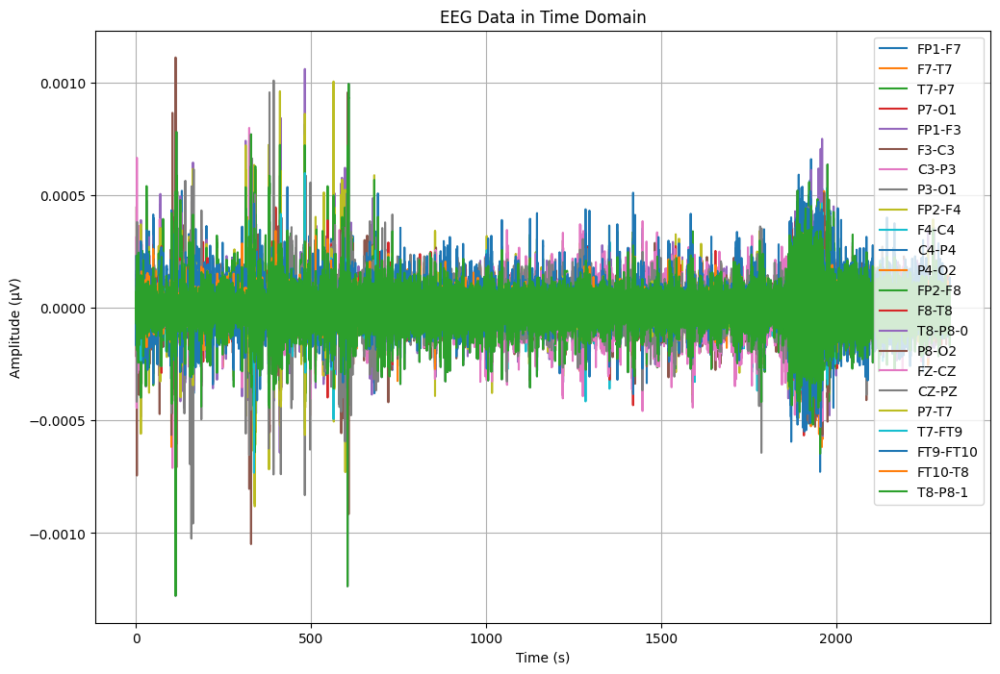

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df19['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df19[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()

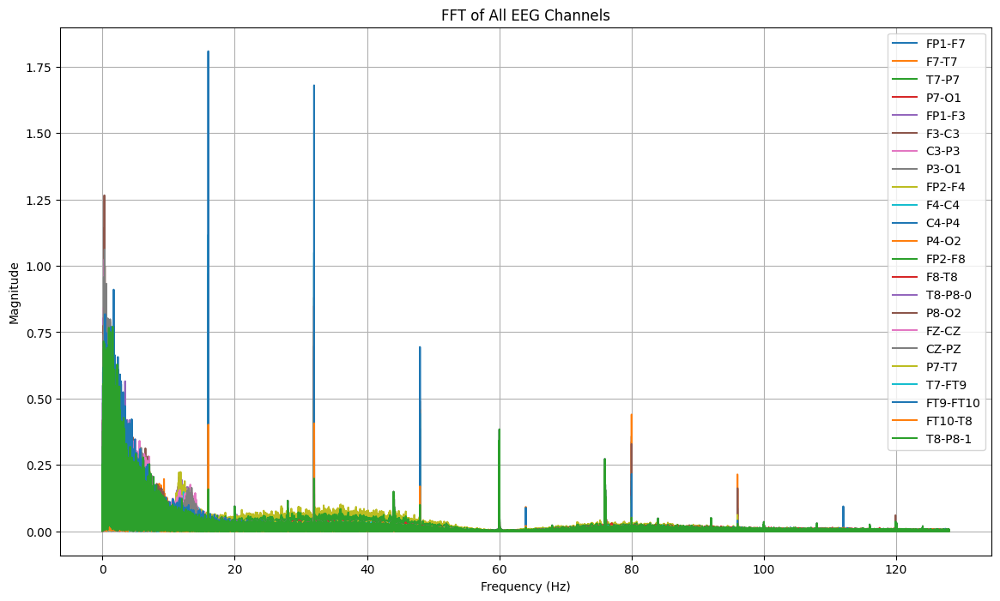

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df19[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv"
df19.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")

Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv


In [ ]:
dataTA19 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb01_26.csv")
dataTA19

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.059829e-05,1.181929e-04,1.619536e-04,4.278388e-05,1.330403e-04,-2.139194e-04,3.119902e-04,4.122100e-05,5.684982e-05,-2.148962e-06,...,-3.106227e-05,9.357753e-05,1.582418e-05,2.832723e-05,-1.615629e-04,-2.754579e-05,2.291575e-04,-2.930403e-06,-3.106227e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,9.768010e-07,0.011719
4,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,-2.539683e-06,2.148962e-06,-1.953602e-07,9.768010e-07,-9.768010e-07,...,-3.711844e-06,1.953602e-07,-5.860806e-07,-3.321123e-06,5.860806e-07,-5.860806e-07,1.758242e-06,9.768010e-07,-3.711844e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595195,3.731380e-05,1.152625e-05,-7.619048e-06,1.816850e-05,4.122100e-05,3.711844e-06,-9.572650e-06,2.442002e-05,1.035409e-05,6.056166e-06,...,2.989011e-05,1.387057e-05,2.989011e-05,-4.551893e-05,8.009768e-06,-2.871795e-05,-5.645910e-05,-4.493284e-06,2.989011e-05,2324.980469
595196,2.754579e-05,9.963370e-06,-8.400488e-06,1.308913e-05,3.692308e-05,1.953602e-07,-1.035409e-05,1.504274e-05,1.347985e-05,5.860806e-07,...,2.793651e-05,1.934066e-05,2.481074e-05,-4.903541e-05,8.791209e-06,-2.559219e-05,-6.427350e-05,-8.791209e-06,2.793651e-05,2324.984375
595197,2.715507e-05,4.884005e-06,-1.113553e-05,1.426129e-05,3.692308e-05,5.860806e-07,-1.426129e-05,1.152625e-05,3.321123e-06,1.953602e-07,...,4.630037e-05,2.598291e-05,1.582418e-05,-3.887668e-05,1.152625e-05,-1.855922e-05,-7.755800e-05,-1.777778e-05,4.630037e-05,2324.988281
595198,2.910867e-05,2.539683e-06,-1.191697e-05,1.113553e-05,4.161172e-05,2.930403e-06,-1.777778e-05,3.321123e-06,-5.860806e-07,2.148962e-06,...,6.427350e-05,2.832723e-05,9.963370e-06,-3.223443e-05,1.230769e-05,-1.660562e-05,-8.693529e-05,-2.324786e-05,6.427350e-05,2324.992188


In [ ]:
import numpy as np
import pandas as pd

# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA19[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA19[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA19[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data19, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 16.00 Hz, Magnitude: 1.807812, Time: 1871.886719 s
Channel: F3-C3, Max Frequency: 0.29 Hz, Magnitude: 1.265265, Time: 103.851562 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.117001, Time: 336.890625 s
Channel: CZ-PZ, Max Frequency: 0.32 Hz, Magnitude: 1.061271, Time: 157.816406 s
Channel: C3-P3, Max Frequency: 0.29 Hz, Magnitude: 1.024314, Time: 323.156250 s
Channel: P3-O1, Max Frequency: 32.00 Hz, Magnitude: 0.992431, Time: 1895.035156 s
Channel: F8-T8, Max Frequency: 16.00 Hz, Magnitude: 0.874661, Time: 1908.007812 s
Channel: P8-O2, Max Frequency: 0.42 Hz, Magnitude: 0.835980, Time: 112.785156 s
Channel: FP1-F3, Max Frequency: 0.31 Hz, Magnitude: 0.820747, Time: 482.039062 s
Channel: FP1-F7, Max Frequency: 0.21 Hz, Magnitude: 0.818818, Time: 482.019531 s
Channel: T8-P8-0, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: T8-P8-1, Max Freq

In [ ]:
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F3-C3, Max Frequency: 0.29 Hz, Magnitude: 1.265265, Time: 103.851562 s
Channel: T8-P8-0, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: P8-O2, Max Frequency: 0.42 Hz, Magnitude: 0.835980, Time: 112.785156 s
Channel: T8-P8-1, Max Frequency: 1.55 Hz, Magnitude: 0.771022, Time: 112.785156 s
Channel: P4-O2, Max Frequency: 32.00 Hz, Magnitude: 0.739442, Time: 113.593750 s
Channel: CZ-PZ, Max Frequency: 0.32 Hz, Magnitude: 1.061271, Time: 157.816406 s
Channel: C3-P3, Max Frequency: 0.29 Hz, Magnitude: 1.024314, Time: 323.156250 s
Channel: T7-FT9, Max Frequency: 16.00 Hz, Magnitude: 1.117001, Time: 336.890625 s
Channel: FT10-T8, Max Frequency: 1.70 Hz, Magnitude: 0.436432, Time: 398.589844 s
Channel: FP2-F8, Max Frequency: 1.01 Hz, Magnitude: 0.712306, Time: 410.925781 s
Channel: FP1-F7, Max Frequency: 0.21 Hz, Magnitude: 0.818818, Time: 482.019531 s


In [ ]:
import pandas as pd

# Load data into a DataFrame (asuming it's loaded already)
# df = pd.read_csv("eeg_data.csv")  # Contoh jika data dalam bentuk CSV

# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1742   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2083    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut19 = dataTA19.iloc[start_index:end_index]



In [ ]:
# Simpan data yang sudah dipotong
df_cut19.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_26.csv", index=False)

In [ ]:
# import data yang sudah dipotong
TA19 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb01_26.csv")
TA19.head()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000043,6.446886e-06,-0.000010,-0.000028,0.000060,-0.000004,-0.000032,-0.000011,0.000028,0.000017,...,0.000012,-0.000007,0.000028,-0.000034,0.000010,-0.000005,-0.000037,9.768010e-07,0.000012,1742.000000
1,0.000044,1.953602e-07,-0.000015,-0.000030,0.000058,-0.000008,-0.000035,-0.000016,0.000028,0.000014,...,-0.000002,0.000001,0.000031,-0.000043,0.000016,-0.000006,-0.000045,3.321123e-06,-0.000002,1742.003906
2,0.000043,-4.884005e-06,-0.000022,-0.000033,0.000053,-0.000009,-0.000037,-0.000024,0.000024,0.000009,...,-0.000017,0.000006,0.000032,-0.000049,0.000022,-0.000008,-0.000053,6.837607e-06,-0.000017,1742.007812
3,0.000038,-9.181929e-06,-0.000025,-0.000036,0.000040,-0.000005,-0.000037,-0.000030,0.000013,0.000008,...,0.000005,-0.000015,0.000025,-0.000049,0.000025,-0.000004,-0.000060,9.768010e-07,0.000005,1742.011719
4,0.000029,-1.113553e-05,-0.000026,-0.000040,0.000024,-0.000003,-0.000035,-0.000035,0.000001,0.000006,...,0.000013,-0.000022,0.000020,-0.000040,0.000026,-0.000004,-0.000062,-2.930403e-06,0.000013,1742.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA19.shape

(87296, 24)

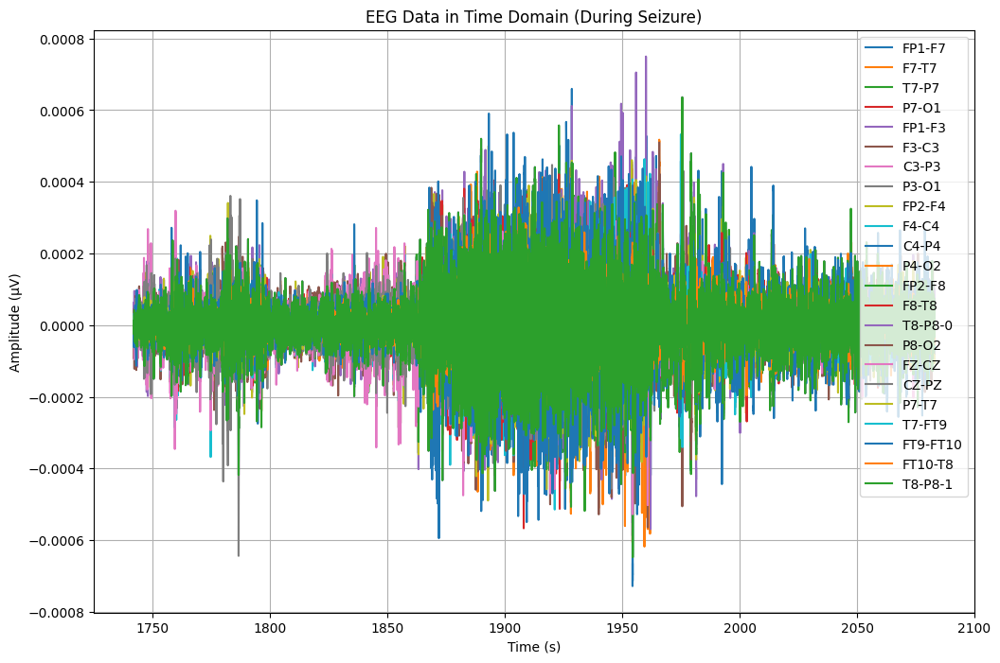

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time


# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA19['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA19.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA19[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


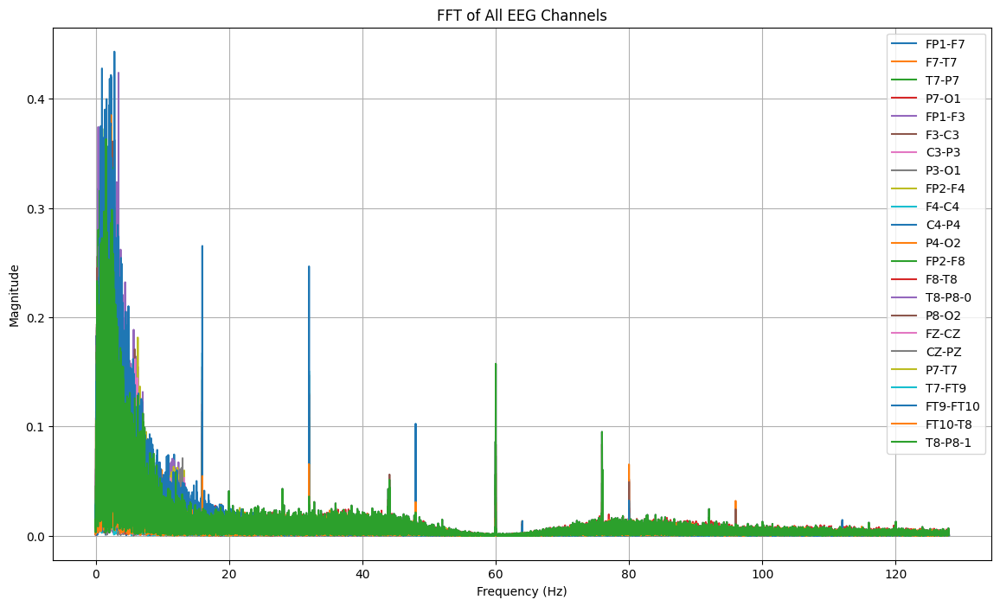

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA19[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang

# Misalkan df adalah dataframe yang Anda miliki
# Contoh data:
# df = pd.read_csv('data.csv')

# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1862:
        return "tidak kejang"
    elif 1862 <= row['Time'] < 1963:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_19 = TA19.copy()
TA_19['seizure'] = TA_19.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_19[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7         F7-T7     T7-P7     P7-O1  \
0  1742.000000  tidak kejang  0.000043  6.446886e-06 -0.000010 -0.000028   
1  1742.003906  tidak kejang  0.000044  1.953602e-07 -0.000015 -0.000030   
2  1742.007812  tidak kejang  0.000043 -4.884005e-06 -0.000022 -0.000033   
3  1742.011719  tidak kejang  0.000038 -9.181929e-06 -0.000025 -0.000036   
4  1742.015625  tidak kejang  0.000029 -1.113553e-05 -0.000026 -0.000040   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0  0.000060 -0.000004 -0.000032 -0.000011  ...  0.000001  0.000012 -0.000007   
1  0.000058 -0.000008 -0.000035 -0.000016  ...  0.000002 -0.000002  0.000001   
2  0.000053 -0.000009 -0.000037 -0.000024  ...  0.000002 -0.000017  0.000006   
3  0.000040 -0.000005 -0.000037 -0.000030  ... -0.000003  0.000005 -0.000015   
4  0.000024 -0.000003 -0.000035 -0.000035  ... -0.000007  0.000013 -0.000022   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10       FT10

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_19['seizure'].value_counts()

,count
seizure,
tidak kejang,61440
kejang,25856


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_19)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")

Durasi total rekaman EEG: 341.0 detik


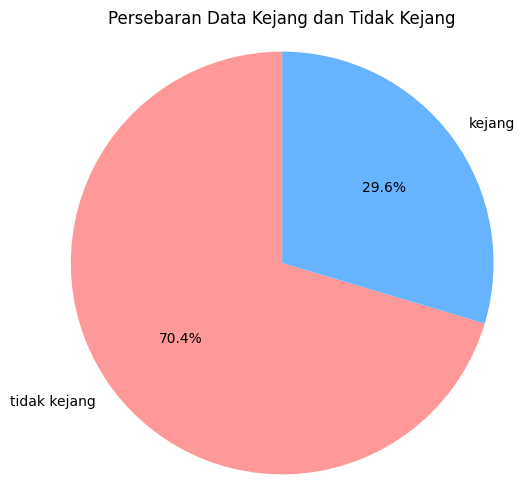

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang

# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_19['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()

In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_19.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb01_26.csv", index=False)

In [ ]:
# mengklasifikasikan menggunakan random forest

import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Misalkan df adalah dataframe yang Anda miliki, dengan kolom 'seizure' yang berisi label "kejang" dan "tidak kejang"
# Contoh data:
# df = pd.read_csv('data.csv')

# Menentukan fitur (X) dan label (y)
X = TA_19.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_19['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.99      0.93      0.96      5221
tidak kejang       0.97      0.99      0.98     12239

    accuracy                           0.97     17460
   macro avg       0.98      0.96      0.97     17460
weighted avg       0.97      0.97      0.97     17460

Akurasi: 0.9742268041237113
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.99      0.93      0.96      5221
tidak kejang       0.97      0.99      0.98     12239

    accuracy                           0.97     17460
   macro avg       0.98      0.96      0.97     17460
weighted avg       0.97      0.97      0.97     17460



# DATA 20 (chb02_19)

In [ ]:
# mengimport file edf
file20 = "/content/drive/MyDrive/TA/EDF/chb02_19.edf"
data20 = mne.io.read_raw_edf(file20) # membaca file edf dan menyimpannya di data
data20


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb02_19.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-247-4bf89b2b0610>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data20 = mne.io.read_raw_edf(file20) # membaca file edf dan menyimpannya di data


<RawEDF | chb02_19.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data20.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data20.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data20.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df20 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df20['Time'] = times  # Menambahkan kolom waktu
df20.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-2.949939e-05,-9.572650e-06,1.013919e-04,-3.223443e-05,-3.262515e-05,3.731380e-05,9.435897e-05,-6.896215e-05,4.884005e-06,1.035409e-05,...,2.871795e-05,1.367521e-06,2.754579e-05,1.103785e-04,-1.010012e-04,5.724054e-05,3.536020e-05,-5.333333e-05,2.871795e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,-9.768010e-07,1.953602e-07,5.860806e-07,9.768010e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df20.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df20.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.836733e-07,2.777078e-07,1.168680e-07,1.687962e-07,2.655139e-07,2.033823e-07,1.899607e-07,1.932841e-07,3.010671e-07,2.097574e-07,...,1.086750e-07,1.796979e-07,2.098956e-07,1.827690e-07,2.738523e-07,1.405555e-07,1.963099e-07,2.443686e-07,1.086750e-07,1799.998047
std,7.060445e-05,4.669756e-05,5.303388e-05,4.497394e-05,6.599013e-05,4.404182e-05,5.315197e-05,4.944983e-05,1.206243e-04,2.700399e-05,...,5.523045e-05,3.769038e-05,4.080256e-05,9.436798e-05,5.303388e-05,4.875871e-05,5.047455e-05,4.645920e-05,5.523045e-05,1039.231048
min,-1.780317e-03,-8.550916e-04,-1.212991e-03,-8.535287e-04,-1.532991e-03,-9.172161e-04,-1.846740e-03,-9.090110e-04,-1.711551e-03,-4.491331e-04,...,-1.132503e-03,-5.796337e-04,-1.263785e-03,-1.475946e-03,-6.241758e-04,-1.050842e-03,-7.054457e-04,-5.612698e-04,-1.132503e-03,0.000000
25%,-2.442002e-05,-1.894994e-05,-1.894994e-05,-1.855922e-05,-2.402930e-05,-1.855922e-05,-1.894994e-05,-1.816850e-05,-3.028083e-05,-1.465201e-05,...,-1.699634e-05,-1.426129e-05,-1.543346e-05,-2.129426e-05,-2.129426e-05,-1.543346e-05,-1.621490e-05,-1.543346e-05,-1.699634e-05,899.999023
50%,-1.367521e-06,-5.860806e-07,9.768010e-07,5.860806e-07,-1.367521e-06,-1.953602e-07,1.953602e-07,1.953602e-07,-1.758242e-06,1.953602e-07,...,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1799.998047
75%,2.012210e-05,1.738706e-05,2.168498e-05,1.934066e-05,2.051282e-05,1.855922e-05,1.894994e-05,1.894994e-05,2.481074e-05,1.465201e-05,...,1.934066e-05,1.465201e-05,1.543346e-05,2.168498e-05,1.934066e-05,1.738706e-05,1.699634e-05,1.465201e-05,1.934066e-05,2699.997070
max,1.408352e-03,9.910623e-04,6.245665e-04,7.601465e-04,1.606447e-03,1.217680e-03,1.672479e-03,8.461050e-04,1.626374e-03,4.292063e-04,...,6.976313e-04,9.953602e-04,1.666227e-03,1.867057e-03,1.213382e-03,6.784860e-04,6.007326e-04,1.018803e-03,6.976313e-04,3599.996094


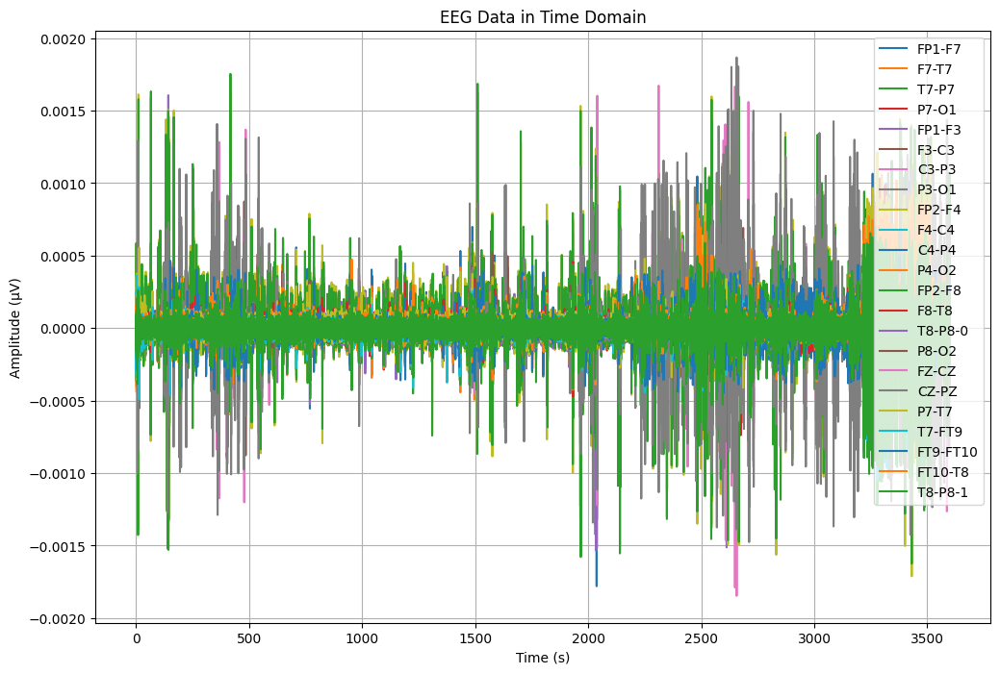

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df20['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df20[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


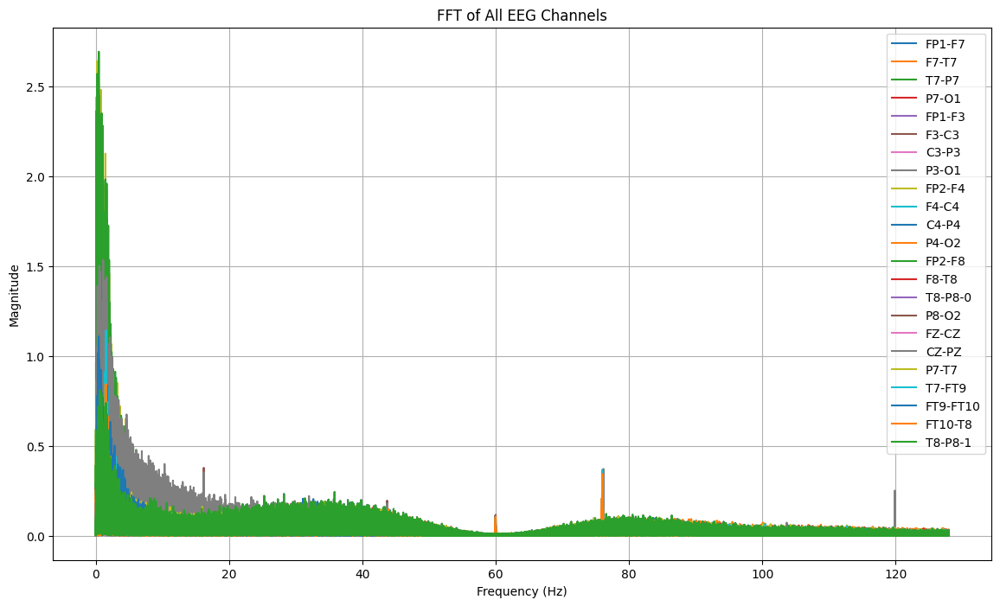

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df20[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv"
df20.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv


In [ ]:
#Import Data CSV
dataTA20 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_19.csv")
dataTA20


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-2.949939e-05,-9.572650e-06,1.013919e-04,-3.223443e-05,-3.262515e-05,3.731380e-05,9.435897e-05,-6.896215e-05,4.884005e-06,1.035409e-05,...,2.871795e-05,1.367521e-06,2.754579e-05,1.103785e-04,-1.010012e-04,5.724054e-05,3.536020e-05,-5.333333e-05,2.871795e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,9.768010e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,-9.768010e-07,1.953602e-07,5.860806e-07,9.768010e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,-5.860806e-07,1.367521e-06,1.953602e-07,5.860806e-07,-1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.949939e-05,-2.012210e-05,-8.791209e-06,-1.387057e-05,-3.379731e-05,-6.271062e-05,1.074481e-05,1.074481e-05,1.269841e-05,-3.848596e-05,...,-1.699634e-05,-2.012210e-05,-3.262515e-05,-3.321123e-06,9.181929e-06,-9.963370e-06,4.102564e-06,2.989011e-05,-1.699634e-05,3599.980469
921596,-1.777778e-05,-1.621490e-05,-1.035409e-05,-1.543346e-05,-2.246642e-05,-5.489621e-05,6.837607e-06,8.009768e-06,4.102564e-06,-2.871795e-05,...,-9.768010e-07,-2.363858e-05,-3.106227e-05,6.446886e-06,1.074481e-05,2.930403e-06,2.539683e-06,7.619048e-06,-9.768010e-07,3599.984375
921597,-5.645910e-05,-1.269841e-05,-1.855922e-05,-5.665446e-06,-5.997558e-05,-5.958486e-05,4.493284e-06,1.934066e-05,-1.953602e-07,-2.246642e-05,...,1.347985e-05,-2.051282e-05,-3.340659e-05,1.191697e-05,1.894994e-05,6.056166e-06,5.860806e-07,-8.791209e-06,1.347985e-05,3599.988281
921598,-3.262515e-05,-5.860806e-07,-3.145299e-05,-6.446886e-06,-4.356532e-05,-4.512821e-05,2.539683e-06,1.308913e-05,9.768010e-07,-1.699634e-05,...,2.598291e-05,-1.738706e-05,-2.989011e-05,2.520147e-05,3.184371e-05,-1.074481e-05,-1.953602e-07,-1.660562e-05,2.598291e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA20[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA20[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA20[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data20, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP2-F8, Max Frequency: 0.48 Hz, Magnitude: 2.691698, Time: 417.292969 s
Channel: FP2-F4, Max Frequency: 0.21 Hz, Magnitude: 2.639032, Time: 3431.414062 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.533803, Time: 2656.785156 s
Channel: FP1-F7, Max Frequency: 0.37 Hz, Magnitude: 1.283179, Time: 2037.324219 s
Channel: FP1-F3, Max Frequency: 0.48 Hz, Magnitude: 1.216813, Time: 142.507812 s
Channel: C3-P3, Max Frequency: 0.28 Hz, Magnitude: 1.160056, Time: 2656.843750 s
Channel: P3-O1, Max Frequency: 0.28 Hz, Magnitude: 1.145087, Time: 2311.765625 s
Channel: T7-FT9, Max Frequency: 1.55 Hz, Magnitude: 1.142266, Time: 3279.183594 s
Channel: FT9-FT10, Max Frequency: 0.45 Hz, Magnitude: 1.108334, Time: 3480.074219 s
Channel: P7-O1, Max Frequency: 0.25 Hz, Magnitude: 1.069789, Time: 2582.160156 s
Channel: C4-P4, Max Frequency: 0.39 Hz, Magnitude: 1.058784, Time: 2595.031250 s
Channel: P4-O2, Max Freq

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 0.48 Hz, Magnitude: 1.216813, Time: 142.507812 s
Channel: FP2-F8, Max Frequency: 0.48 Hz, Magnitude: 2.691698, Time: 417.292969 s
Channel: P4-O2, Max Frequency: 0.24 Hz, Magnitude: 1.001392, Time: 2015.332031 s
Channel: FP1-F7, Max Frequency: 0.37 Hz, Magnitude: 1.283179, Time: 2037.324219 s
Channel: P3-O1, Max Frequency: 0.28 Hz, Magnitude: 1.145087, Time: 2311.765625 s
Channel: P8-O2, Max Frequency: 0.24 Hz, Magnitude: 0.822336, Time: 2569.273438 s
Channel: P7-O1, Max Frequency: 0.25 Hz, Magnitude: 1.069789, Time: 2582.160156 s
Channel: C4-P4, Max Frequency: 0.39 Hz, Magnitude: 1.058784, Time: 2595.031250 s
Channel: FZ-CZ, Max Frequency: 1.57 Hz, Magnitude: 0.511563, Time: 2649.574219 s
Channel: F3-C3, Max Frequency: 0.91 Hz, Magnitude: 0.912018, Time: 2649.585938 s
Channel: CZ-PZ, Max Frequency: 1.13 Hz, Magnitude: 1.533803, Time: 2656.785156 s

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 3245   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3498    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut20 = dataTA20.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut20.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_19.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA20 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_19.csv")
TA20.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000031,-0.000065,1.035409e-05,0.000023,0.000025,-1.035409e-05,-0.000003,-0.000010,0.000594,-4.493284e-06,...,0.000033,-0.000002,1.035409e-05,-0.000004,-9.963370e-06,0.000038,-0.000022,-0.000009,0.000033,3245.000000
1,0.000031,-0.000059,-4.884005e-06,0.000029,0.000023,-1.230769e-05,-0.000008,-0.000005,0.000581,-4.493284e-06,...,0.000011,-0.000010,1.758242e-06,-0.000003,5.274725e-06,0.000054,-0.000043,0.000013,0.000011,3245.003906
2,0.000021,-0.000053,1.953602e-07,0.000025,0.000024,-9.572650e-06,-0.000007,-0.000012,0.000574,-5.860806e-07,...,0.000033,-0.000013,-2.539683e-06,-0.000008,1.953602e-07,0.000032,-0.000003,-0.000008,0.000033,3245.007812
3,0.000026,-0.000046,9.181929e-06,0.000023,0.000034,1.953602e-07,-0.000003,-0.000016,0.000551,4.493284e-06,...,0.000042,-0.000026,9.768010e-07,-0.000006,-8.791209e-06,0.000024,0.000013,-0.000015,0.000042,3245.011719
4,0.000046,-0.000028,6.056166e-06,0.000034,0.000053,1.426129e-05,-0.000002,-0.000005,0.000529,9.572650e-06,...,0.000015,-0.000008,1.074481e-05,0.000012,-5.665446e-06,0.000036,-0.000006,-0.000003,0.000015,3245.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA20.shape

(64768, 24)

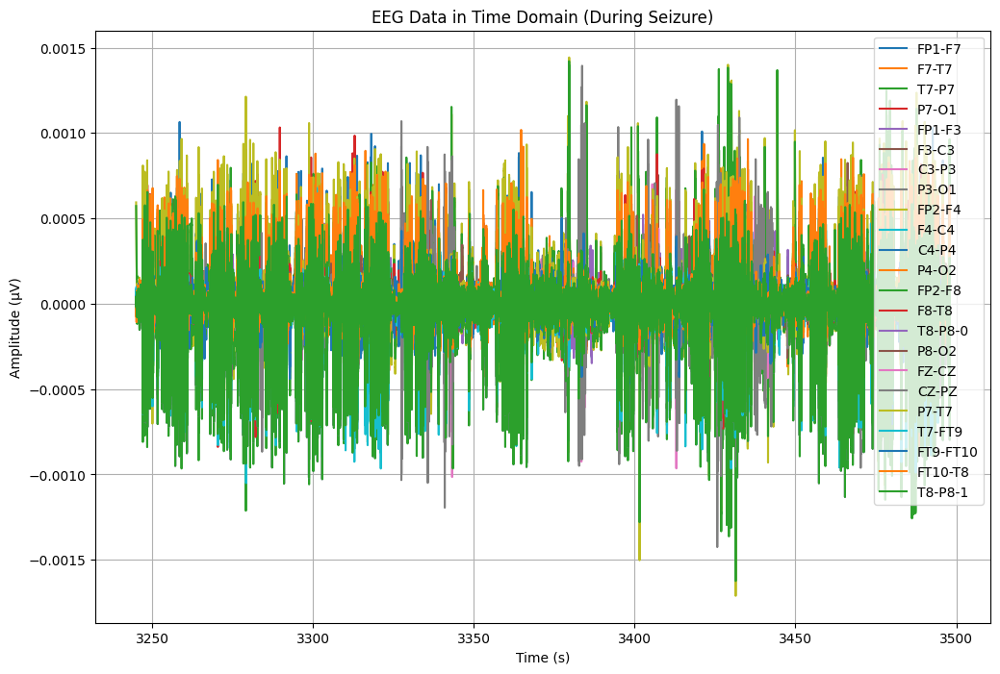

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA20['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA20.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA20[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


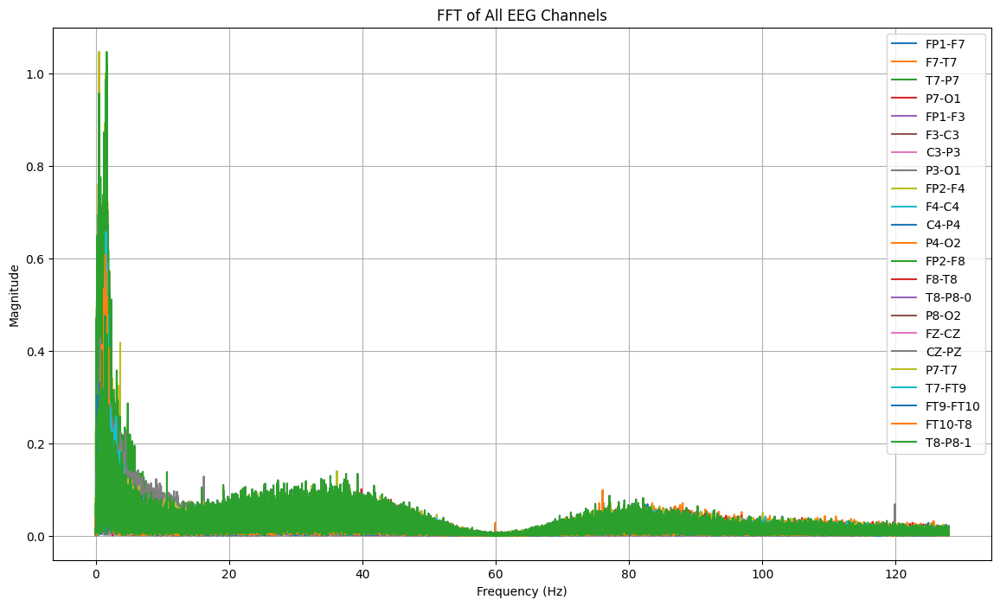

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA20[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 3365:
        return "tidak kejang"
    elif 3365 <= row['Time'] < 3378:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_20 = TA20.copy()
TA_20['seizure'] = TA_20.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_20[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7         T7-P7     P7-O1  \
0  3245.000000  tidak kejang  0.000031 -0.000065  1.035409e-05  0.000023   
1  3245.003906  tidak kejang  0.000031 -0.000059 -4.884005e-06  0.000029   
2  3245.007812  tidak kejang  0.000021 -0.000053  1.953602e-07  0.000025   
3  3245.011719  tidak kejang  0.000026 -0.000046  9.181929e-06  0.000023   
4  3245.015625  tidak kejang  0.000046 -0.000028  6.056166e-06  0.000034   

     FP1-F3         F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0  0.000025 -1.035409e-05 -0.000003 -0.000010  ... -0.000010  0.000033   
1  0.000023 -1.230769e-05 -0.000008 -0.000005  ...  0.000013  0.000011   
2  0.000024 -9.572650e-06 -0.000007 -0.000012  ... -0.000008  0.000033   
3  0.000034  1.953602e-07 -0.000003 -0.000016  ... -0.000006  0.000042   
4  0.000053  1.426129e-05 -0.000002 -0.000005  ...  0.000012  0.000015   

      P8-O2         FZ-CZ     CZ-PZ         P7-T7    T7-FT9  FT9-FT10  \
0 -0.000002  1.035409e-05

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_20['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,3328


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_20)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 253.0 detik


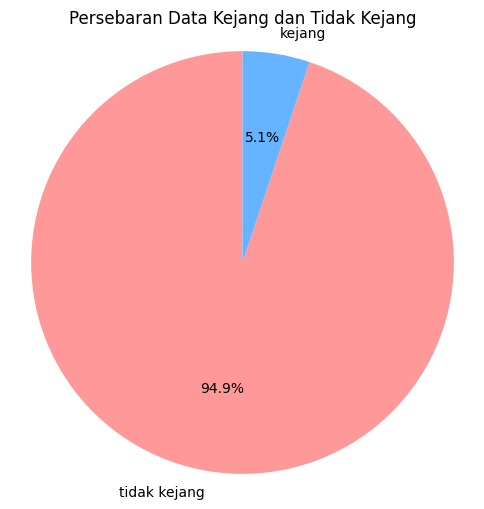

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_20['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_20.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb02_19.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_20.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_20['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       1.00      0.54      0.70       717
tidak kejang       0.97      1.00      0.99     12237

    accuracy                           0.97     12954
   macro avg       0.99      0.77      0.84     12954
weighted avg       0.98      0.97      0.97     12954

Akurasi: 0.9745252431681334
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       1.00      0.54      0.70       717
tidak kejang       0.97      1.00      0.99     12237

    accuracy                           0.97     12954
   macro avg       0.99      0.77      0.84     12954
weighted avg       0.98      0.97      0.97     12954



# DATA 21 (chb02_16+)

In [ ]:
# mengimport file edf
file21 = "/content/drive/MyDrive/TA/EDF/chb02_16+.edf"
data21 = mne.io.read_raw_edf(file21) # membaca file edf dan menyimpannya di data
data21


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb02_16+.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-271-cafab1f99e65>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data21 = mne.io.read_raw_edf(file21) # membaca file edf dan menyimpannya di data


<RawEDF | chb02_16+.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data21.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data21.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data21.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df21 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df21['Time'] = times  # Menambahkan kolom waktu
df21.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000063,-0.000134,0.000015,-1.830525e-04,-0.000376,4.077167e-04,-2.619780e-04,-8.009768e-06,-6.388278e-05,-1.748474e-04,...,-4.065446e-04,0.000652,-1.365568e-04,-1.099878e-04,-0.000014,0.000215,-2.858120e-04,-0.000307,-4.065446e-04,0.000000
1,0.000002,-0.000001,0.000002,5.860806e-07,0.000003,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,0.000001,1.953602e-07,1.953602e-07,-0.000001,0.000002,1.953602e-07,-0.000001,5.860806e-07,0.003906
2,-0.000009,0.000010,-0.000010,-9.768010e-07,-0.000012,1.758242e-06,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-2.148962e-06,-0.000007,5.860806e-07,-1.953602e-07,0.000011,-0.000010,-5.860806e-07,0.000011,-2.148962e-06,0.007812
3,-0.000027,0.000028,-0.000023,-9.963370e-06,-0.000036,1.152625e-05,-5.274725e-06,-2.148962e-06,1.953602e-07,-1.367521e-06,...,-6.837607e-06,-0.000022,5.860806e-07,-1.367521e-06,0.000024,-0.000022,-8.009768e-06,0.000024,-6.837607e-06,0.011719
4,0.000059,-0.000062,0.000068,9.768010e-07,0.000067,-5.860806e-07,3.711844e-06,-4.884005e-06,-2.930403e-06,-1.758242e-06,...,1.152625e-05,0.000057,-7.228327e-06,9.768010e-07,-0.000067,0.000070,1.953602e-07,-0.000077,1.152625e-05,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df21.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df21.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,1.841316e-07,2.309108e-07,1.428563e-07,5.782581e-07,2.012672e-07,-8.908688e-08,-1.124042e-07,6.079285e-07,2.080777e-07,1.520257e-07,...,6.619480e-08,1.355053e-07,2.355727e-07,1.975249e-07,2.478641e-07,1.512969e-07,1.334003e-07,2.164513e-07,6.619480e-08,1799.998047
std,1.399491e-04,1.383175e-04,1.281117e-04,1.097497e-04,1.353201e-04,1.032285e-04,9.024136e-05,9.806553e-05,7.227180e-05,6.619689e-05,...,6.642087e-05,1.639537e-04,6.132116e-05,6.588496e-05,1.281117e-04,1.519580e-04,1.030040e-04,1.317392e-04,6.642087e-05,1039.231048
min,-2.189011e-03,-2.466422e-03,-2.312479e-03,-2.390232e-03,-2.412112e-03,-2.418755e-03,-2.380855e-03,-2.528547e-03,-1.777582e-03,-1.795946e-03,...,-2.024518e-03,-2.770794e-03,-1.752186e-03,-1.818608e-03,-2.299194e-03,-2.416801e-03,-2.333968e-03,-2.661001e-03,-2.024518e-03,0.000000
25%,-6.036630e-05,-5.880342e-05,-5.763126e-05,-6.349206e-05,-5.802198e-05,-4.669109e-05,-2.793651e-05,-3.731380e-05,-3.184371e-05,-2.754579e-05,...,-2.754579e-05,-6.974359e-05,-3.145299e-05,-2.871795e-05,-6.153846e-05,-6.427350e-05,-4.278388e-05,-6.818071e-05,-2.754579e-05,899.999023
50%,-1.367521e-06,-1.953602e-07,1.758242e-06,-5.860806e-07,-2.148962e-06,1.953602e-07,9.768010e-07,-2.148962e-06,-5.860806e-07,1.953602e-07,...,9.768010e-07,9.768010e-07,1.953602e-07,1.953602e-07,-1.367521e-06,1.953602e-07,5.860806e-07,1.367521e-06,9.768010e-07,1799.998047
75%,5.997558e-05,5.684982e-05,6.192918e-05,5.684982e-05,5.528694e-05,4.747253e-05,2.989011e-05,3.340659e-05,3.028083e-05,2.871795e-05,...,2.949939e-05,6.857143e-05,3.223443e-05,2.910867e-05,5.802198e-05,6.349206e-05,4.434676e-05,7.130647e-05,2.949939e-05,2699.997070
max,2.533236e-03,2.299585e-03,2.299585e-03,2.001856e-03,2.355067e-03,2.421099e-03,2.457827e-03,2.100317e-03,1.827595e-03,1.962784e-03,...,1.752967e-03,2.992723e-03,1.946764e-03,1.517753e-03,2.312869e-03,2.381636e-03,2.575824e-03,2.530501e-03,1.752967e-03,3599.996094


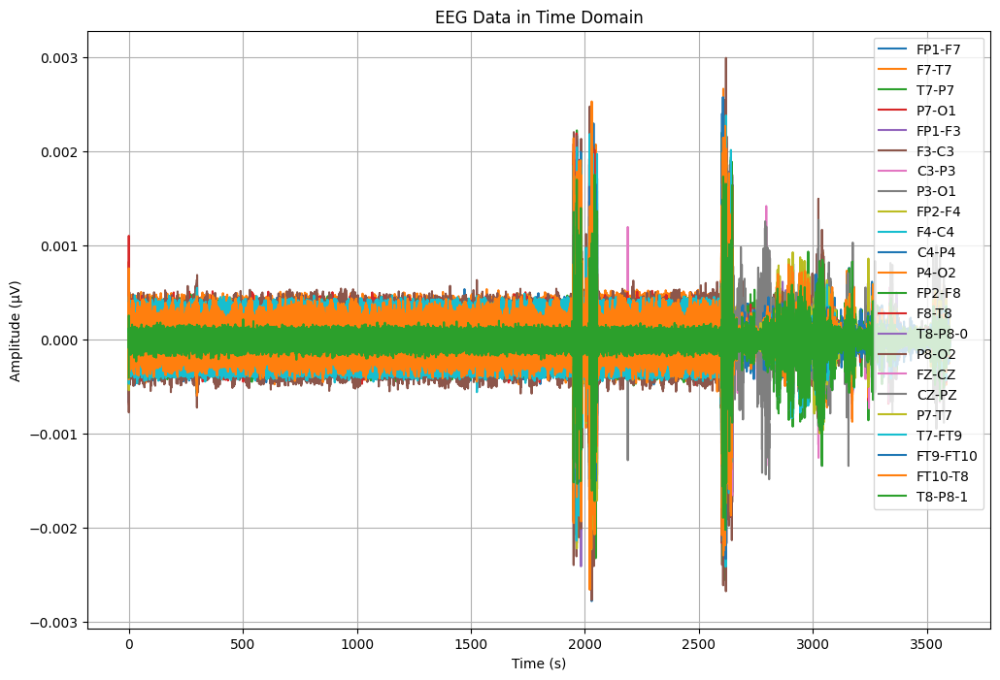

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df21['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df21[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


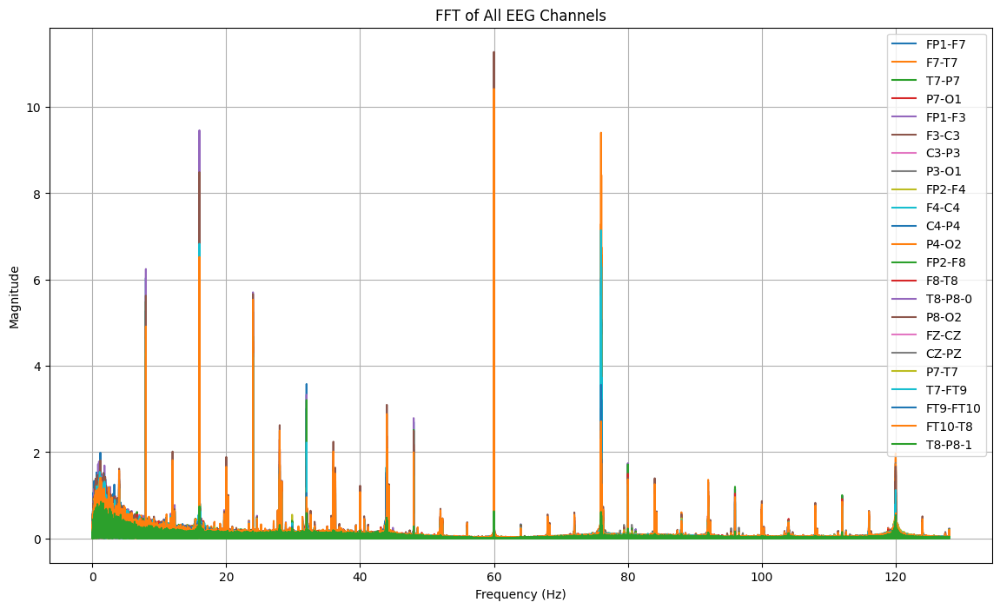

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df21[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv"
df21.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv


In [ ]:
#Import Data CSV
dataTA21 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb02_16+.csv")
dataTA21


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000063,-0.000134,0.000015,-1.830525e-04,-0.000376,4.077167e-04,-2.619780e-04,-8.009768e-06,-6.388278e-05,-1.748474e-04,...,-4.065446e-04,6.515263e-04,-1.365568e-04,-1.099878e-04,-0.000014,2.150916e-04,-2.858120e-04,-0.000307,-4.065446e-04,0.000000
1,0.000002,-0.000001,0.000002,5.860806e-07,0.000003,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,5.860806e-07,1.367521e-06,1.953602e-07,1.953602e-07,-0.000001,1.758242e-06,1.953602e-07,-0.000001,5.860806e-07,0.003906
2,-0.000009,0.000010,-0.000010,-9.768010e-07,-0.000012,1.758242e-06,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-2.148962e-06,-7.228327e-06,5.860806e-07,-1.953602e-07,0.000011,-1.035409e-05,-5.860806e-07,0.000011,-2.148962e-06,0.007812
3,-0.000027,0.000028,-0.000023,-9.963370e-06,-0.000036,1.152625e-05,-5.274725e-06,-2.148962e-06,1.953602e-07,-1.367521e-06,...,-6.837607e-06,-2.168498e-05,5.860806e-07,-1.367521e-06,0.000024,-2.168498e-05,-8.009768e-06,0.000024,-6.837607e-06,0.011719
4,0.000059,-0.000062,0.000068,9.768010e-07,0.000067,-5.860806e-07,3.711844e-06,-4.884005e-06,-2.930403e-06,-1.758242e-06,...,1.152625e-05,5.724054e-05,-7.228327e-06,9.768010e-07,-0.000067,7.013431e-05,1.953602e-07,-0.000077,1.152625e-05,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-0.000001,-0.000013,0.000003,4.102564e-06,-0.000028,2.285714e-05,2.129426e-05,-2.442002e-05,-8.009768e-06,2.168498e-05,...,-4.884005e-06,2.148962e-06,2.989011e-05,4.493284e-06,-0.000003,7.228327e-06,1.894994e-05,0.000013,-4.884005e-06,3599.980469
921596,-0.000009,0.000042,-0.000031,-6.837607e-06,-0.000021,3.418803e-05,1.582418e-05,-3.575092e-05,-5.274725e-06,2.090354e-05,...,-3.711844e-06,-1.367521e-06,2.949939e-05,1.367521e-06,0.000032,-5.059829e-05,3.653236e-05,0.000013,-3.711844e-06,3599.984375
921597,-0.000010,-0.000009,0.000030,-9.572650e-06,-0.000025,4.512821e-05,1.152625e-05,-3.145299e-05,-6.056166e-06,2.090354e-05,...,-1.582418e-05,9.768010e-07,3.223443e-05,-5.860806e-07,-0.000029,2.207570e-05,2.363858e-05,0.000015,-1.582418e-05,3599.988281
921598,-0.000007,-0.000021,0.000031,-8.009768e-06,-0.000029,4.864469e-05,6.446886e-06,-3.028083e-05,-4.493284e-06,1.934066e-05,...,-1.816850e-05,-3.321123e-06,3.184371e-05,2.539683e-06,-0.000031,3.145299e-05,2.715507e-05,0.000013,-1.816850e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA21[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA21[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA21[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data21, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: P8-O2, Max Frequency: 59.99 Hz, Magnitude: 11.278090, Time: 2619.132812 s
Channel: FT10-T8, Max Frequency: 59.99 Hz, Magnitude: 10.422252, Time: 2021.601562 s
Channel: F8-T8, Max Frequency: 59.99 Hz, Magnitude: 10.057232, Time: 2028.800781 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 9.461570, Time: 1983.156250 s
Channel: P4-O2, Max Frequency: 75.99 Hz, Magnitude: 9.406121, Time: 2607.312500 s
Channel: FP1-F7, Max Frequency: 16.00 Hz, Magnitude: 9.074247, Time: 2614.316406 s
Channel: FP2-F8, Max Frequency: 16.00 Hz, Magnitude: 8.261306, Time: 2609.707031 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 8.153494, Time: 2030.125000 s
Channel: F7-T7, Max Frequency: 59.99 Hz, Magnitude: 8.124088, Time: 2614.320312 s
Channel: T7-FT9, Max Frequency: 59.99 Hz, Magnitude: 7.585212, Time: 2617.886719 s
Channel: P7-T7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: T

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP2-F4, Max Frequency: 16.00 Hz, Magnitude: 1.220192, Time: 1950.765625 s
Channel: FZ-CZ, Max Frequency: 59.99 Hz, Magnitude: 1.578107, Time: 1964.914062 s
Channel: CZ-PZ, Max Frequency: 0.83 Hz, Magnitude: 0.968105, Time: 1964.914062 s
Channel: FP1-F3, Max Frequency: 16.00 Hz, Magnitude: 9.461570, Time: 1983.156250 s
Channel: FT10-T8, Max Frequency: 59.99 Hz, Magnitude: 10.422252, Time: 2021.601562 s
Channel: F8-T8, Max Frequency: 59.99 Hz, Magnitude: 10.057232, Time: 2028.800781 s
Channel: C4-P4, Max Frequency: 16.00 Hz, Magnitude: 8.153494, Time: 2030.125000 s
Channel: FT9-FT10, Max Frequency: 75.98 Hz, Magnitude: 3.561822, Time: 2605.730469 s
Channel: T7-P7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: P7-T7, Max Frequency: 59.99 Hz, Magnitude: 6.707974, Time: 2606.554688 s
Channel: F4-C4, Max Frequency: 1.39 Hz, Magnitude: 0.944927, Ti

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2852   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 3173    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut21 = dataTA21.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut21.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_16+.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA21 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb02_16+.csv")
TA21.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000008,1.816850e-05,0.000014,0.000046,0.000015,-0.000019,0.000064,0.000008,0.000006,0.000039,...,0.000058,0.000011,1.953602e-07,0.000056,-0.000014,-0.000053,0.000114,-0.000040,0.000058,2852.000000
1,-0.000025,-1.269841e-05,0.000042,0.000040,-0.000015,-0.000010,0.000063,0.000006,-0.000014,0.000039,...,0.000045,0.000006,1.758242e-06,0.000049,-0.000042,0.000002,0.000117,-0.000054,0.000045,2852.003906
2,-0.000033,-8.791209e-06,0.000045,0.000040,-0.000030,-0.000006,0.000065,0.000015,-0.000019,0.000029,...,0.000048,0.000019,8.009768e-06,0.000042,-0.000045,0.000010,0.000103,-0.000052,0.000048,2852.007812
3,-0.000023,1.934066e-05,0.000011,0.000038,-0.000026,-0.000014,0.000069,0.000017,-0.000032,0.000020,...,0.000065,0.000013,2.539683e-06,0.000031,-0.000010,-0.000036,0.000085,-0.000038,0.000065,2852.011719
4,-0.000024,9.768010e-07,0.000024,0.000035,-0.000038,-0.000013,0.000068,0.000019,-0.000048,0.000021,...,0.000068,0.000008,1.758242e-06,0.000022,-0.000023,-0.000020,0.000081,-0.000034,0.000068,2852.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA21.shape

(82176, 24)

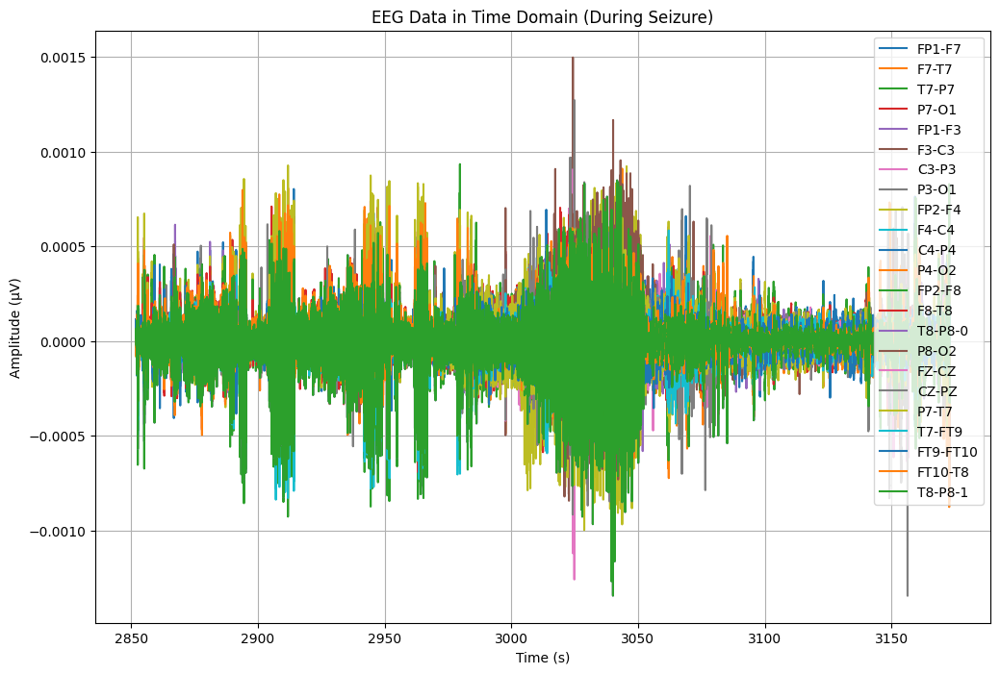

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA21['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA21.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA21[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


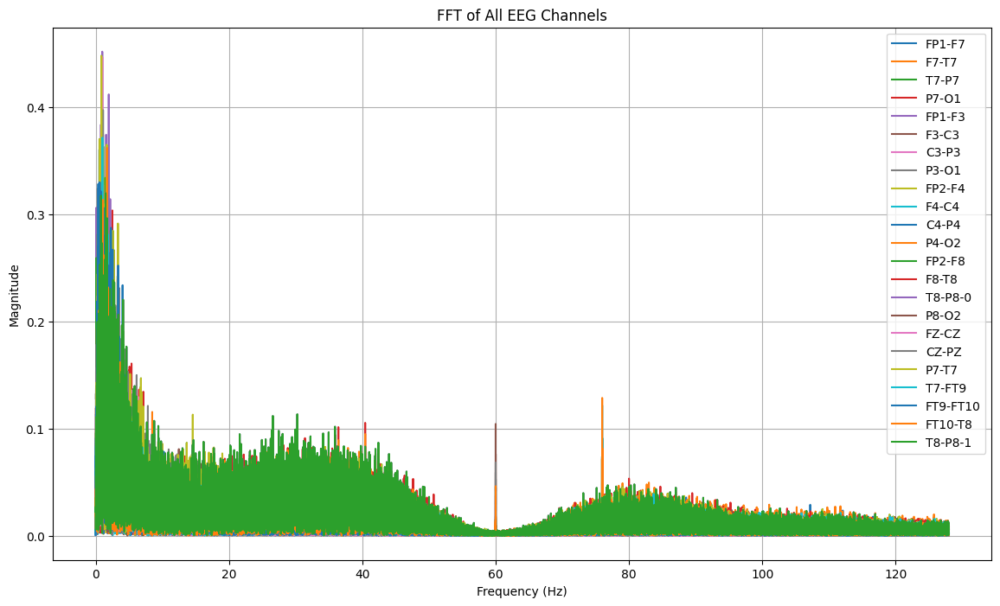

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA21[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2972:
        return "tidak kejang"
    elif 2972 <= row['Time'] < 3053:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_21 = TA21.copy()
TA_21['seizure'] = TA_21.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_21[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7         F7-T7     T7-P7     P7-O1  \
0  2852.000000  tidak kejang -0.000008  1.816850e-05  0.000014  0.000046   
1  2852.003906  tidak kejang -0.000025 -1.269841e-05  0.000042  0.000040   
2  2852.007812  tidak kejang -0.000033 -8.791209e-06  0.000045  0.000040   
3  2852.011719  tidak kejang -0.000023  1.934066e-05  0.000011  0.000038   
4  2852.015625  tidak kejang -0.000024  9.768010e-07  0.000024  0.000035   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...         F8-T8   T8-P8-0  \
0  0.000015 -0.000019  0.000064  0.000008  ... -5.665446e-06  0.000058   
1 -0.000015 -0.000010  0.000063  0.000006  ... -9.768010e-07  0.000045   
2 -0.000030 -0.000006  0.000065  0.000015  ... -4.884005e-06  0.000048   
3 -0.000026 -0.000014  0.000069  0.000017  ... -2.168498e-05  0.000065   
4 -0.000038 -0.000013  0.000068  0.000019  ... -2.129426e-05  0.000068   

      P8-O2         FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0  0.000011  1.9536

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_21['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,20736


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_21)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 321.0 detik


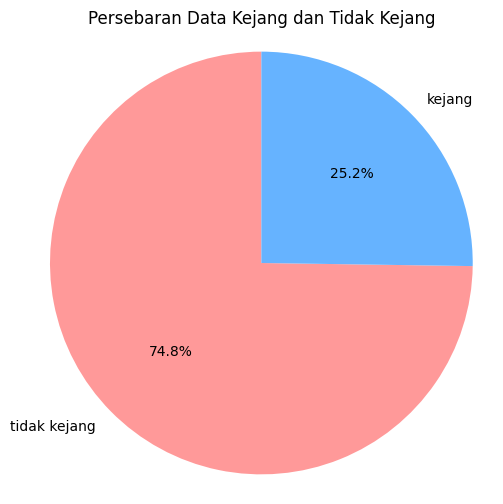

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_21['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_21.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb02_16+.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_21.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_21['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.98      0.85      0.91      4251
tidak kejang       0.95      0.99      0.97     12185

    accuracy                           0.96     16436
   macro avg       0.96      0.92      0.94     16436
weighted avg       0.96      0.96      0.95     16436

Akurasi: 0.9559503528839134
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.85      0.91      4251
tidak kejang       0.95      0.99      0.97     12185

    accuracy                           0.96     16436
   macro avg       0.96      0.92      0.94     16436
weighted avg       0.96      0.96      0.95     16436



# DATA 22 (chb03_01)

In [ ]:
# mengimport file edf
file22 = "/content/drive/MyDrive/TA/EDF/chb03_01.edf"
data22 = mne.io.read_raw_edf(file22) # membaca file edf dan menyimpannya di data
data22


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-295-3a8085e769bc>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data22 = mne.io.read_raw_edf(file22) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_01.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data22.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data22.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data22.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df22 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df22['Time'] = times  # Menambahkan kolom waktu
df22.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.200244e-05,1.934066e-05,6.056166e-06,-1.426129e-05,3.106227e-05,-1.699634e-05,3.340659e-05,5.665446e-06,1.953602e-07,-4.864469e-05,...,2.148962e-06,-6.056166e-06,-2.324786e-05,2.676435e-05,-5.665446e-06,-5.665446e-06,-1.035409e-05,-1.308913e-05,2.148962e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df22.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df22.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.509849e-07,2.478734e-07,1.343110e-07,2.072382e-07,2.727691e-07,2.164585e-07,1.975550e-07,2.035837e-07,2.776553e-07,2.244883e-07,...,1.427991e-07,2.124300e-07,2.427876e-07,1.950808e-07,2.564094e-07,1.596531e-07,1.987760e-07,2.332341e-07,1.427991e-07,1799.998047
std,8.803233e-05,7.081758e-05,3.241781e-05,2.348533e-05,7.974790e-05,3.606677e-05,2.720907e-05,2.104380e-05,7.619692e-05,3.188271e-05,...,2.981836e-05,1.872055e-05,2.825703e-05,2.004083e-05,3.241781e-05,3.297355e-05,5.890299e-05,3.235178e-05,2.981836e-05,1039.231048
min,-2.330061e-03,-1.617778e-03,-1.525177e-03,-1.887375e-03,-2.640293e-03,-1.706471e-03,-2.437509e-03,-1.749060e-03,-8.097680e-04,-1.647473e-03,...,-9.551160e-04,-1.383346e-03,-1.514628e-03,-7.210745e-04,-1.356777e-03,-1.643565e-03,-1.829939e-03,-1.559170e-03,-9.551160e-04,0.000000
25%,-1.973138e-05,-1.973138e-05,-9.963370e-06,-7.619048e-06,-2.090354e-05,-1.074481e-05,-6.446886e-06,-5.665446e-06,-1.973138e-05,-9.181929e-06,...,-9.572650e-06,-6.837607e-06,-9.572650e-06,-7.228327e-06,-1.113553e-05,-9.963370e-06,-1.543346e-05,-9.572650e-06,-9.572650e-06,899.999023
50%,-5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,-9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.738706e-05,1.777778e-05,1.152625e-05,8.009768e-06,1.621490e-05,1.035409e-05,6.837607e-06,6.056166e-06,1.543346e-05,8.791209e-06,...,1.074481e-05,7.228327e-06,8.791209e-06,7.619048e-06,1.035409e-05,1.113553e-05,1.582418e-05,9.181929e-06,1.074481e-05,2699.997070
max,1.563858e-03,1.826813e-03,1.357167e-03,1.954188e-03,1.563858e-03,2.786813e-03,1.627546e-03,1.907692e-03,1.415775e-03,2.517998e-03,...,1.480635e-03,1.660366e-03,1.101636e-03,1.391160e-03,1.525568e-03,1.628718e-03,1.726789e-03,1.695140e-03,1.480635e-03,3599.996094


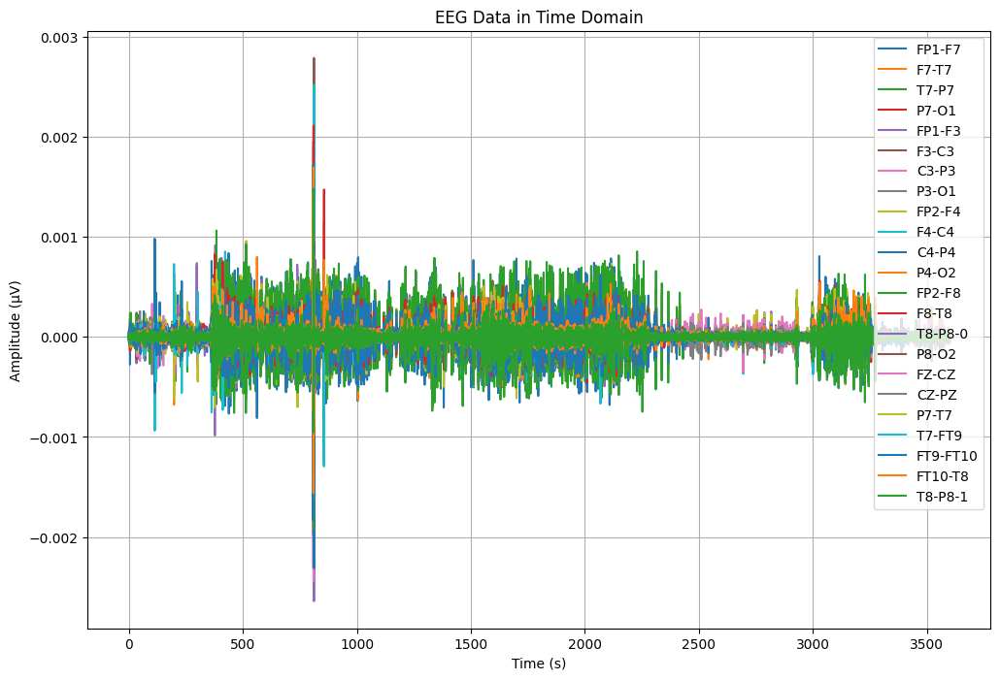

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df22['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df22[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


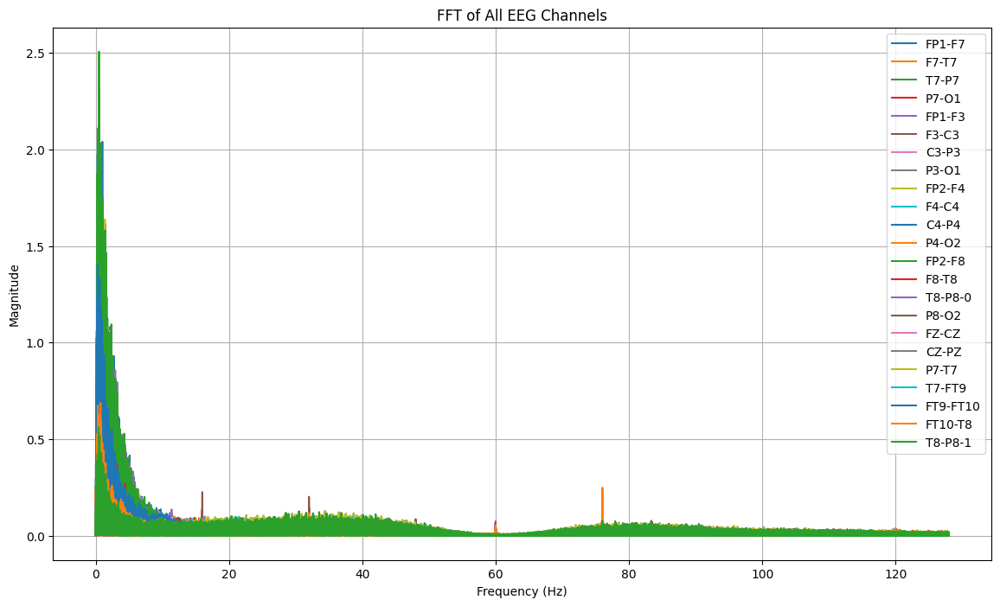

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df22[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv"
df22.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv


In [ ]:
#Import Data CSV
dataTA22 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_01.csv")
dataTA22


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.200244e-05,1.934066e-05,6.056166e-06,-1.426129e-05,3.106227e-05,-1.699634e-05,3.340659e-05,5.665446e-06,1.953602e-07,-4.864469e-05,...,2.148962e-06,-6.056166e-06,-2.324786e-05,2.676435e-05,-5.665446e-06,-5.665446e-06,-1.035409e-05,-1.308913e-05,2.148962e-06,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,2.051282e-05,-1.308913e-05,-2.442002e-05,-1.191697e-05,1.308913e-05,-1.113553e-05,-1.621490e-05,-1.465201e-05,-1.426129e-05,1.308913e-05,...,1.953602e-07,2.539683e-06,5.665446e-06,-3.321123e-06,2.481074e-05,-4.884005e-06,-2.520147e-05,-2.539683e-06,1.953602e-07,3599.980469
921596,1.816850e-05,-9.181929e-06,-2.481074e-05,-1.269841e-05,9.963370e-06,-1.269841e-05,-1.191697e-05,-1.426129e-05,-8.400488e-06,8.400488e-06,...,-5.860806e-07,6.056166e-06,2.930403e-06,-1.758242e-06,2.520147e-05,-1.035409e-05,-3.067155e-05,-1.953602e-07,-5.860806e-07,3599.984375
921597,1.582418e-05,-2.148962e-06,-3.028083e-05,-1.230769e-05,8.009768e-06,-1.152625e-05,-4.884005e-06,-2.051282e-05,5.860806e-07,3.321123e-06,...,1.953602e-07,4.493284e-06,1.953602e-07,-1.758242e-06,3.067155e-05,-1.504274e-05,-3.536020e-05,2.930403e-06,1.953602e-07,3599.988281
921598,1.582418e-05,1.758242e-06,-2.676435e-05,-1.582418e-05,4.493284e-06,-6.446886e-06,-2.930403e-06,-1.973138e-05,3.711844e-06,1.367521e-06,...,2.148962e-06,4.884005e-06,-9.768010e-07,-1.758242e-06,2.715507e-05,-1.191697e-05,-3.536020e-05,-3.711844e-06,2.148962e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA22[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA22[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA22[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data22, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP2-F8, Max Frequency: 0.49 Hz, Magnitude: 2.506845, Time: 810.093750 s
Channel: FP1-F7, Max Frequency: 0.52 Hz, Magnitude: 2.309519, Time: 812.093750 s
Channel: FP2-F4, Max Frequency: 0.49 Hz, Magnitude: 1.987210, Time: 809.734375 s
Channel: FP1-F3, Max Frequency: 0.49 Hz, Magnitude: 1.825145, Time: 812.097656 s
Channel: F7-T7, Max Frequency: 0.74 Hz, Magnitude: 1.561799, Time: 810.375000 s
Channel: FT9-FT10, Max Frequency: 0.29 Hz, Magnitude: 1.403873, Time: 807.164062 s
Channel: F8-T8, Max Frequency: 0.57 Hz, Magnitude: 1.272776, Time: 810.093750 s
Channel: F3-C3, Max Frequency: 1.00 Hz, Magnitude: 0.711357, Time: 812.101562 s
Channel: T7-FT9, Max Frequency: 0.73 Hz, Magnitude: 0.702479, Time: 810.078125 s
Channel: FT10-T8, Max Frequency: 0.72 Hz, Magnitude: 0.687750, Time: 810.105469 s
Channel: F4-C4, Max Frequency: 1.00 Hz, Magnitude: 0.642365, Time: 812.105469 s
Channel: FZ-CZ, Max Frequency: 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT9-FT10, Max Frequency: 0.29 Hz, Magnitude: 1.403873, Time: 807.164062 s
Channel: FZ-CZ, Max Frequency: 1.00 Hz, Magnitude: 0.582803, Time: 809.718750 s
Channel: T8-P8-0, Max Frequency: 0.45 Hz, Magnitude: 0.560924, Time: 809.730469 s
Channel: T8-P8-1, Max Frequency: 0.45 Hz, Magnitude: 0.560924, Time: 809.730469 s
Channel: FP2-F4, Max Frequency: 0.49 Hz, Magnitude: 1.987210, Time: 809.734375 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.225984, Time: 809.765625 s
Channel: P7-O1, Max Frequency: 0.73 Hz, Magnitude: 0.372440, Time: 809.792969 s
Channel: P4-O2, Max Frequency: 0.47 Hz, Magnitude: 0.241514, Time: 809.792969 s
Channel: T7-P7, Max Frequency: 0.73 Hz, Magnitude: 0.519310, Time: 810.058594 s
Channel: P7-T7, Max Frequency: 0.73 Hz, Magnitude: 0.519310, Time: 810.058594 s
Channel: CZ-PZ, Max Frequency: 1.08 Hz, Magnitude: 0.321159, Time: 810.066406 s
Ch

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 242   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 534    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut22 = dataTA22.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut22.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_01.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA22 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_01.csv")
TA22.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000015,1.953602e-07,0.000006,-1.367521e-06,-5.860806e-07,-0.000013,-0.000003,0.000008,-0.000004,-2.539683e-06,...,-0.000019,0.000032,-0.000013,0.000008,-0.000006,-5.274725e-06,6.056166e-06,0.000013,-0.000019,242.000000
1,-0.000009,-1.777778e-05,0.000035,-4.102564e-06,5.860806e-07,-0.000008,0.000003,0.000007,-0.000002,1.758242e-06,...,-0.000004,0.000030,-0.000011,0.000013,-0.000035,6.446886e-06,1.230769e-05,0.000004,-0.000004,242.003906
2,-0.000007,-7.619048e-06,0.000024,-1.953602e-07,9.768010e-07,-0.000008,0.000007,0.000009,-0.000004,5.860806e-07,...,-0.000004,0.000031,-0.000011,0.000016,-0.000024,1.953602e-07,-1.953602e-07,0.000009,-0.000004,242.007812
3,-0.000007,-3.321123e-06,0.000010,1.035409e-05,-1.758242e-06,-0.000010,0.000009,0.000011,-0.000008,1.953602e-07,...,0.000014,0.000029,-0.000011,0.000015,-0.000010,5.274725e-06,-1.230769e-05,-0.000014,0.000014,242.011719
4,-0.000004,-7.228327e-06,0.000013,8.009768e-06,-2.148962e-06,-0.000010,0.000011,0.000009,-0.000010,9.768010e-07,...,0.000021,0.000019,-0.000010,0.000014,-0.000012,1.426129e-05,-1.582418e-05,-0.000029,0.000021,242.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA22.shape

(74752, 24)

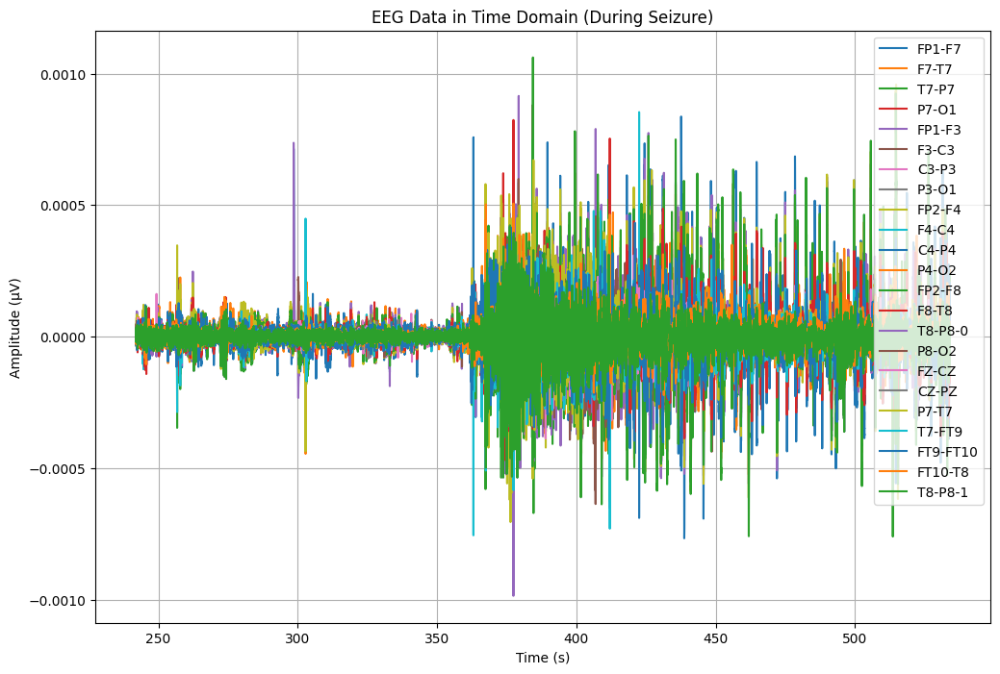

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA22['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA22.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA22[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


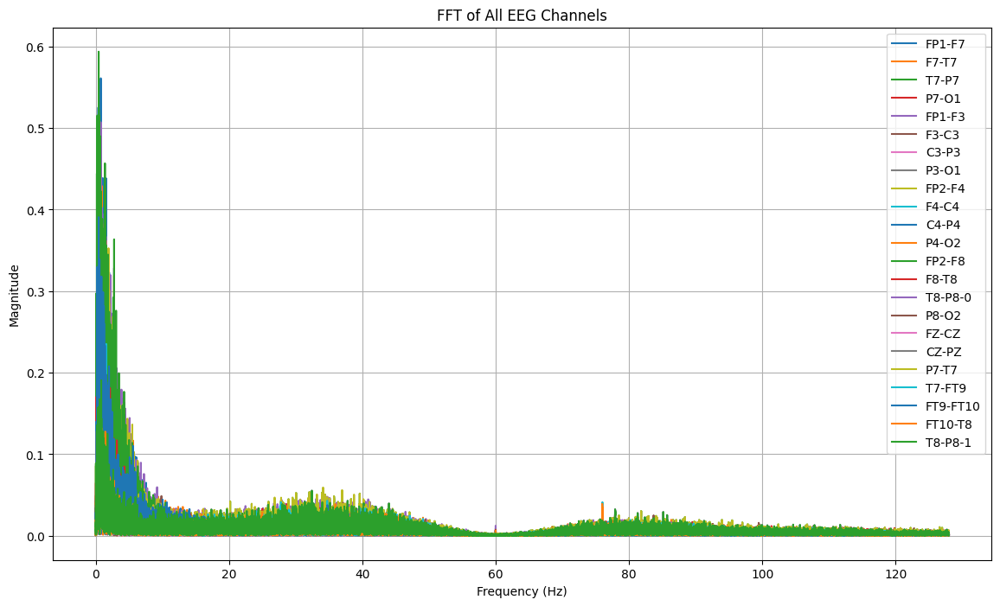

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA22[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 362:
        return "tidak kejang"
    elif 362 <= row['Time'] < 414:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_22 = TA22.copy()
TA_22['seizure'] = TA_22.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_22[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7         F7-T7     T7-P7         P7-O1  \
0  242.000000  tidak kejang -0.000015  1.953602e-07  0.000006 -1.367521e-06   
1  242.003906  tidak kejang -0.000009 -1.777778e-05  0.000035 -4.102564e-06   
2  242.007812  tidak kejang -0.000007 -7.619048e-06  0.000024 -1.953602e-07   
3  242.011719  tidak kejang -0.000007 -3.321123e-06  0.000010  1.035409e-05   
4  242.015625  tidak kejang -0.000004 -7.228327e-06  0.000013  8.009768e-06   

         FP1-F3     F3-C3     C3-P3     P3-O1  ...         F8-T8   T8-P8-0  \
0 -5.860806e-07 -0.000013 -0.000003  0.000008  ...  7.228327e-06 -0.000019   
1  5.860806e-07 -0.000008  0.000003  0.000007  ...  2.148962e-06 -0.000004   
2  9.768010e-07 -0.000008  0.000007  0.000009  ...  9.768010e-07 -0.000004   
3 -1.758242e-06 -0.000010  0.000009  0.000011  ... -2.051282e-05  0.000014   
4 -2.148962e-06 -0.000010  0.000011  0.000009  ... -2.871795e-05  0.000021   

      P8-O2     FZ-CZ     CZ-PZ     P7-T7        T7-FT9 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_22['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13312


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_22)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 292.0 detik


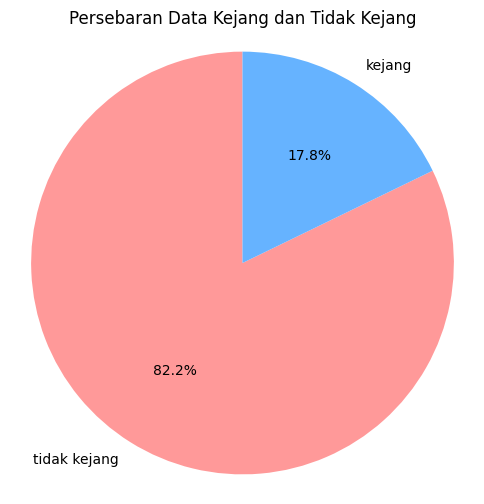

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_22['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_22.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_01.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_22.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_22['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.95      0.90      0.92      2717
tidak kejang       0.98      0.99      0.98     12234

    accuracy                           0.97     14951
   macro avg       0.96      0.94      0.95     14951
weighted avg       0.97      0.97      0.97     14951

Akurasi: 0.9734465922011906
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.95      0.90      0.92      2717
tidak kejang       0.98      0.99      0.98     12234

    accuracy                           0.97     14951
   macro avg       0.96      0.94      0.95     14951
weighted avg       0.97      0.97      0.97     14951



# DATA 23 (chb03_02)

In [ ]:
# mengimport file edf
file23 = "/content/drive/MyDrive/TA/EDF/chb03_02.edf"
data23 = mne.io.read_raw_edf(file23) # membaca file edf dan menyimpannya di data
data23


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-319-fc346c8e9a60>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data23 = mne.io.read_raw_edf(file23) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_02.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data23.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data23.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data23.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df23 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df23['Time'] = times  # Menambahkan kolom waktu
df23.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,8.967033e-05,-1.953602e-07,-8.791209e-06,-5.333333e-05,-4.239316e-05,4.786325e-05,1.934066e-05,2.539683e-06,-1.248352e-04,1.699634e-05,...,2.402930e-05,-5.860806e-07,-5.274725e-06,6.036630e-05,9.181929e-06,-3.301587e-05,-2.598291e-05,-4.043956e-05,2.402930e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df23.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df23.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.331273e-07,2.564649e-07,9.586004e-08,2.083215e-07,2.319296e-07,1.975444e-07,1.843610e-07,1.973337e-07,2.316595e-07,2.166421e-07,...,1.005376e-07,1.854608e-07,2.118191e-07,1.892497e-07,2.948603e-07,1.276082e-07,2.045940e-07,2.673789e-07,1.005376e-07,1799.998047
std,8.651438e-05,7.206590e-05,5.520981e-05,2.433464e-05,7.610802e-05,3.443067e-05,2.755506e-05,2.037945e-05,7.606942e-05,2.824241e-05,...,5.797878e-05,2.230675e-05,2.593456e-05,1.855425e-05,5.520981e-05,5.426199e-05,6.221896e-05,6.492074e-05,5.797878e-05,1039.231048
min,-9.547253e-04,-7.773382e-04,-1.425543e-03,-6.034676e-04,-8.996337e-04,-5.499389e-04,-5.819780e-04,-4.889866e-04,-9.097924e-04,-5.155556e-04,...,-1.242295e-03,-5.405617e-04,-3.549695e-04,-2.483028e-04,-9.027595e-04,-1.153211e-03,-8.558730e-04,-5.792430e-04,-1.242295e-03,0.000000
25%,-1.855922e-05,-2.090354e-05,-1.113553e-05,-8.400488e-06,-2.090354e-05,-1.347985e-05,-6.837607e-06,-6.056166e-06,-2.090354e-05,-1.113553e-05,...,-1.074481e-05,-7.619048e-06,-9.963370e-06,-7.619048e-06,-1.426129e-05,-1.191697e-05,-1.621490e-05,-1.191697e-05,-1.074481e-05,899.999023
50%,-1.953602e-07,-5.860806e-07,9.768010e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,-1.953602e-07,5.860806e-07,1799.998047
75%,1.738706e-05,1.855922e-05,1.465201e-05,9.181929e-06,1.777778e-05,1.308913e-05,7.619048e-06,6.446886e-06,1.855922e-05,1.074481e-05,...,1.387057e-05,8.400488e-06,9.572650e-06,8.400488e-06,1.152625e-05,1.426129e-05,1.621490e-05,1.074481e-05,1.387057e-05,2699.997070
max,1.543932e-03,1.000830e-03,9.031502e-04,5.448596e-04,8.851770e-04,6.011233e-04,8.562637e-04,7.015385e-04,9.406593e-04,4.061538e-04,...,7.902320e-04,5.620513e-04,2.510379e-04,2.162637e-04,1.425934e-03,7.128694e-04,6.640293e-04,1.201661e-03,7.902320e-04,3599.996094


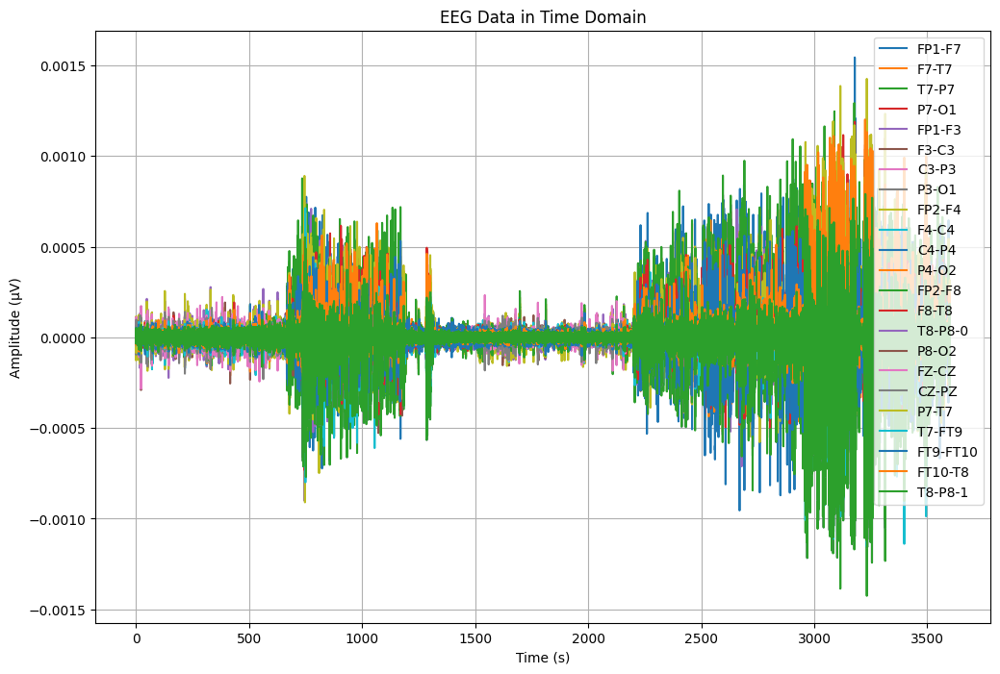

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df23['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df23[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


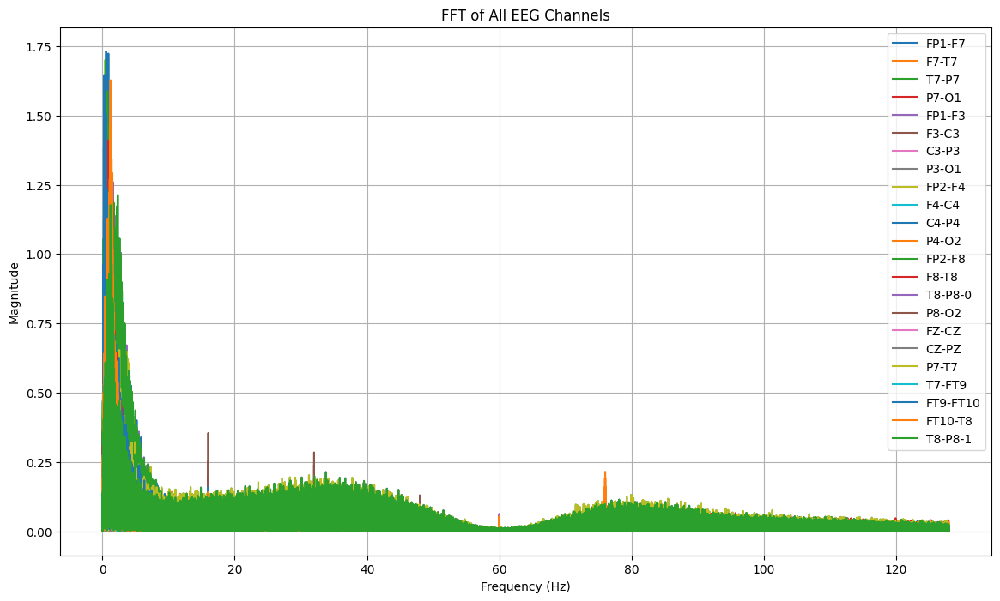

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df23[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv"
df23.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv


In [ ]:
#Import Data CSV
dataTA23 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_02.csv")
dataTA23


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,8.967033e-05,-1.953602e-07,-8.791209e-06,-5.333333e-05,-4.239316e-05,4.786325e-05,1.934066e-05,2.539683e-06,-1.248352e-04,1.699634e-05,...,2.402930e-05,-5.860806e-07,-5.274725e-06,6.036630e-05,9.181929e-06,-3.301587e-05,-2.598291e-05,-4.043956e-05,2.402930e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,4.278388e-05,-6.036630e-05,6.056166e-06,4.102564e-06,-6.446886e-06,-8.009768e-06,8.791209e-06,-1.953602e-07,2.930403e-06,1.191697e-05,...,6.583639e-05,-2.324786e-05,1.113553e-05,2.539683e-06,-5.665446e-06,4.473748e-05,-1.504274e-05,-3.692308e-05,6.583639e-05,3599.980469
921596,1.347985e-05,-1.543346e-05,1.777778e-05,1.953602e-07,-1.953602e-07,1.816850e-05,-2.539683e-06,5.860806e-07,4.884005e-06,1.621490e-05,...,6.974359e-05,3.321123e-06,1.308913e-05,4.493284e-06,-1.738706e-05,-4.102564e-06,1.973138e-05,-3.418803e-05,6.974359e-05,3599.984375
921597,7.228327e-06,1.230769e-05,-3.379731e-05,1.973138e-05,-1.934066e-05,7.619048e-06,1.758242e-06,1.543346e-05,-9.181929e-06,5.860806e-07,...,5.059829e-05,1.426129e-05,1.074481e-05,2.539683e-06,3.418803e-05,-1.699634e-05,1.934066e-05,-5.645910e-05,5.059829e-05,3599.988281
921598,2.148962e-06,-2.148962e-06,7.619048e-06,1.035409e-05,-2.012210e-05,3.418803e-05,-2.930403e-06,7.619048e-06,3.711844e-06,1.660562e-05,...,3.457875e-05,2.285714e-05,1.699634e-05,4.102564e-06,-7.228327e-06,-1.426129e-05,1.426129e-05,-3.887668e-05,3.457875e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA23[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA23[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA23[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data23, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.731759, Time: 3179.398438 s
Channel: FP2-F8, Max Frequency: 0.44 Hz, Magnitude: 1.700656, Time: 3177.253906 s
Channel: FT9-FT10, Max Frequency: 0.28 Hz, Magnitude: 1.646446, Time: 3179.433594 s
Channel: FT10-T8, Max Frequency: 1.21 Hz, Magnitude: 1.627248, Time: 3225.011719 s
Channel: FP2-F4, Max Frequency: 1.33 Hz, Magnitude: 1.468505, Time: 3011.042969 s
Channel: F7-T7, Max Frequency: 0.28 Hz, Magnitude: 1.446811, Time: 3494.750000 s
Channel: FP1-F3, Max Frequency: 1.33 Hz, Magnitude: 1.445375, Time: 744.402344 s
Channel: F8-T8, Max Frequency: 0.80 Hz, Magnitude: 1.410716, Time: 3179.429688 s
Channel: T7-FT9, Max Frequency: 1.15 Hz, Magnitude: 1.255282, Time: 3232.003906 s
Channel: T8-P8-0, Max Frequency: 1.21 Hz, Magnitude: 1.176548, Time: 3255.558594 s
Channel: T8-P8-1, Max Frequency: 1.21 Hz, Magnitude: 1.176548, Time: 3255.558594 s
Channel: P7-T7, M

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 1.33 Hz, Magnitude: 1.445375, Time: 744.402344 s
Channel: FZ-CZ, Max Frequency: 1.30 Hz, Magnitude: 0.493772, Time: 766.671875 s
Channel: CZ-PZ, Max Frequency: 1.36 Hz, Magnitude: 0.333129, Time: 781.570312 s
Channel: FP2-F4, Max Frequency: 1.33 Hz, Magnitude: 1.468505, Time: 3011.042969 s
Channel: P3-O1, Max Frequency: 1.15 Hz, Magnitude: 0.241946, Time: 3038.113281 s
Channel: P4-O2, Max Frequency: 1.39 Hz, Magnitude: 0.322332, Time: 3038.113281 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.354941, Time: 3038.113281 s
Channel: F3-C3, Max Frequency: 0.40 Hz, Magnitude: 0.608901, Time: 3069.511719 s
Channel: F4-C4, Max Frequency: 0.32 Hz, Magnitude: 0.536517, Time: 3108.621094 s
Channel: FP2-F8, Max Frequency: 0.44 Hz, Magnitude: 1.700656, Time: 3177.253906 s
Channel: FP1-F7, Max Frequency: 0.56 Hz, Magnitude: 1.731759, Time: 3179.398438 

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 611   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 916    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut23 = dataTA23.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut23.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_02.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA23 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_02.csv")
TA23.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000003,-0.000046,0.000022,0.000006,0.000037,-0.000045,-8.009768e-06,2.539683e-06,0.000023,-0.000030,...,-0.000024,0.000010,-0.000014,-0.000029,-0.000022,0.000028,0.000013,-0.000020,-0.000024,611.000000
1,-0.000002,-0.000042,0.000024,0.000008,0.000037,-0.000046,1.953602e-07,-5.860806e-07,0.000022,-0.000027,...,-0.000022,0.000008,-0.000016,-0.000026,-0.000023,0.000023,0.000014,-0.000013,-0.000022,611.003906
2,-0.000003,-0.000042,0.000029,0.000011,0.000037,-0.000046,3.711844e-06,-1.953602e-07,0.000025,-0.000027,...,-0.000020,0.000007,-0.000019,-0.000023,-0.000028,0.000024,0.000016,-0.000012,-0.000020,611.007812
3,-0.000004,-0.000043,0.000032,0.000013,0.000037,-0.000046,3.711844e-06,3.321123e-06,0.000027,-0.000032,...,-0.000019,0.000010,-0.000021,-0.000021,-0.000032,0.000024,0.000017,-0.000013,-0.000019,611.011719
4,-0.000008,-0.000040,0.000032,0.000013,0.000037,-0.000049,6.056166e-06,2.148962e-06,0.000028,-0.000037,...,-0.000019,0.000009,-0.000026,-0.000017,-0.000032,0.000017,0.000018,-0.000006,-0.000019,611.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA23.shape

(78080, 24)

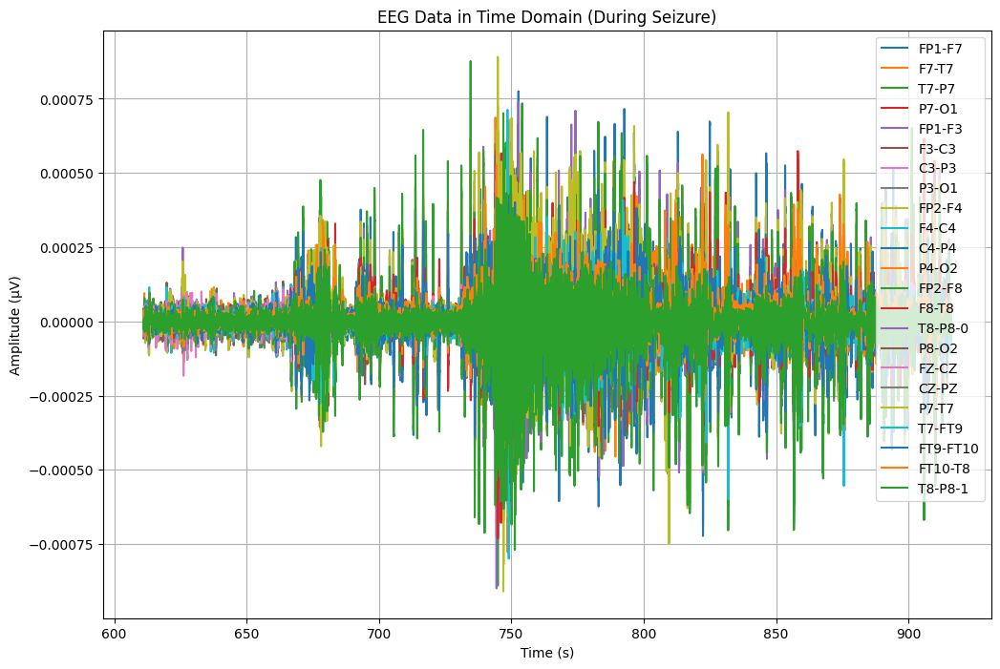

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA23['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA23.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA23[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


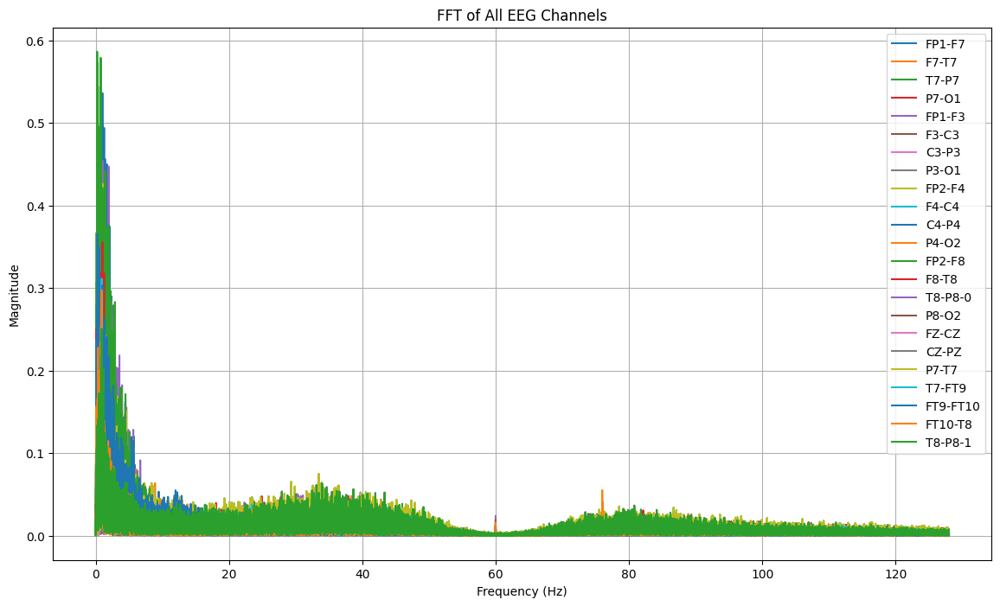

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA23[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 731:
        return "tidak kejang"
    elif 731 <= row['Time'] < 796:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_23 = TA23.copy()
TA_23['seizure'] = TA_23.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_23[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1    FP1-F3  \
0  611.000000  tidak kejang  0.000003 -0.000046  0.000022  0.000006  0.000037   
1  611.003906  tidak kejang -0.000002 -0.000042  0.000024  0.000008  0.000037   
2  611.007812  tidak kejang -0.000003 -0.000042  0.000029  0.000011  0.000037   
3  611.011719  tidak kejang -0.000004 -0.000043  0.000032  0.000013  0.000037   
4  611.015625  tidak kejang -0.000008 -0.000040  0.000032  0.000013  0.000037   

      F3-C3         C3-P3         P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000045 -8.009768e-06  2.539683e-06  ... -0.000045 -0.000024  0.000010   
1 -0.000046  1.953602e-07 -5.860806e-07  ... -0.000045 -0.000022  0.000008   
2 -0.000046  3.711844e-06 -1.953602e-07  ... -0.000044 -0.000020  0.000007   
3 -0.000046  3.711844e-06  3.321123e-06  ... -0.000044 -0.000019  0.000010   
4 -0.000049  6.056166e-06  2.148962e-06  ... -0.000044 -0.000019  0.000009   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  F

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_23['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,16640


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_23)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 305.0 detik


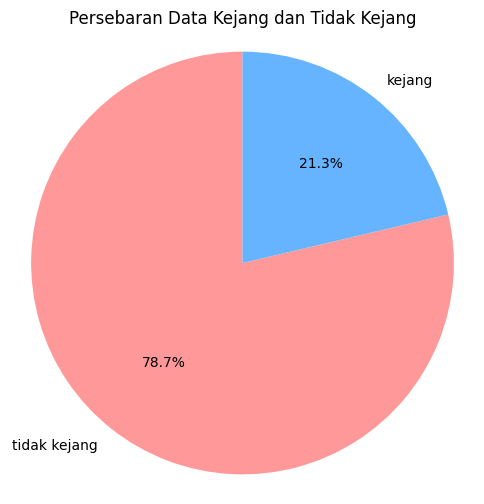

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_23['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_23.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_02.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_23.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_23['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.87      0.91      3433
tidak kejang       0.96      0.99      0.98     12183

    accuracy                           0.96     15616
   macro avg       0.96      0.93      0.94     15616
weighted avg       0.96      0.96      0.96     15616

Akurasi: 0.9620901639344263
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.87      0.91      3433
tidak kejang       0.96      0.99      0.98     12183

    accuracy                           0.96     15616
   macro avg       0.96      0.93      0.94     15616
weighted avg       0.96      0.96      0.96     15616



# DATA 24 (chb03_03)

In [ ]:
# mengimport file edf
file24 = "/content/drive/MyDrive/TA/EDF/chb03_03.edf"
data24 = mne.io.read_raw_edf(file24) # membaca file edf dan menyimpannya di data
data24


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-343-b36d0199dac4>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data24 = mne.io.read_raw_edf(file24) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_03.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data24.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data24.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data24.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df24 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df24['Time'] = times  # Menambahkan kolom waktu
df24.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.880342e-05,1.855922e-05,4.122100e-05,-1.953602e-07,-2.207570e-05,-1.934066e-05,3.731380e-05,4.884005e-06,-4.590965e-05,7.619048e-06,...,3.340659e-05,1.973138e-05,-2.246642e-05,2.989011e-05,-4.083028e-05,-4.102564e-06,-2.207570e-05,1.582418e-05,3.340659e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,0.011719
4,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df24.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df24.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.475109e-07,3.398008e-07,1.737595e-08,1.833851e-07,2.831311e-07,1.602229e-07,1.418948e-07,1.787927e-07,2.987536e-07,1.924832e-07,...,1.275014e-08,1.520740e-07,2.194050e-07,1.721099e-07,3.733444e-07,8.866080e-08,1.981719e-07,3.036219e-07,1.275014e-08,1799.998047
std,8.546639e-05,7.848231e-05,7.886638e-05,2.849821e-05,8.204562e-05,3.608752e-05,3.771188e-05,2.569033e-05,8.050491e-05,2.844311e-05,...,8.162632e-05,2.560236e-05,2.330957e-05,1.724482e-05,7.886638e-05,7.790976e-05,6.089271e-05,9.905901e-05,8.162632e-05,1039.231048
min,-7.843712e-04,-7.992186e-04,-1.370842e-03,-5.335287e-04,-8.285226e-04,-8.785348e-04,-6.780952e-04,-4.350672e-04,-8.515751e-04,-6.464469e-04,...,-1.363028e-03,-7.769475e-04,-3.178510e-04,-2.865934e-04,-8.711111e-04,-1.202442e-03,-7.636630e-04,-4.917216e-04,-1.363028e-03,0.000000
25%,-2.324786e-05,-2.481074e-05,-1.035409e-05,-6.446886e-06,-2.676435e-05,-1.191697e-05,-5.274725e-06,-4.884005e-06,-2.481074e-05,-9.572650e-06,...,-9.963370e-06,-6.446886e-06,-8.400488e-06,-6.446886e-06,-1.582418e-05,-1.269841e-05,-1.426129e-05,-1.465201e-05,-9.963370e-06,899.999023
50%,-5.860806e-07,-2.148962e-06,1.758242e-06,1.953602e-07,-2.148962e-06,1.953602e-07,5.860806e-07,1.953602e-07,-2.148962e-06,1.953602e-07,...,1.758242e-06,5.860806e-07,1.953602e-07,1.953602e-07,-1.367521e-06,9.768010e-07,1.953602e-07,-5.860806e-07,1.758242e-06,1799.998047
75%,1.934066e-05,1.738706e-05,1.621490e-05,7.619048e-06,1.934066e-05,1.230769e-05,7.228327e-06,5.665446e-06,1.660562e-05,9.572650e-06,...,1.582418e-05,7.619048e-06,8.009768e-06,7.619048e-06,1.074481e-05,1.621490e-05,1.465201e-05,1.152625e-05,1.582418e-05,2699.997070
max,1.065690e-03,1.142662e-03,8.715018e-04,8.851770e-04,8.695482e-04,4.928938e-04,8.250061e-04,8.324298e-04,7.589744e-04,4.475702e-04,...,1.028571e-03,9.082295e-04,2.307204e-04,1.893040e-04,1.371233e-03,5.081319e-04,7.394383e-04,1.352088e-03,1.028571e-03,3599.996094


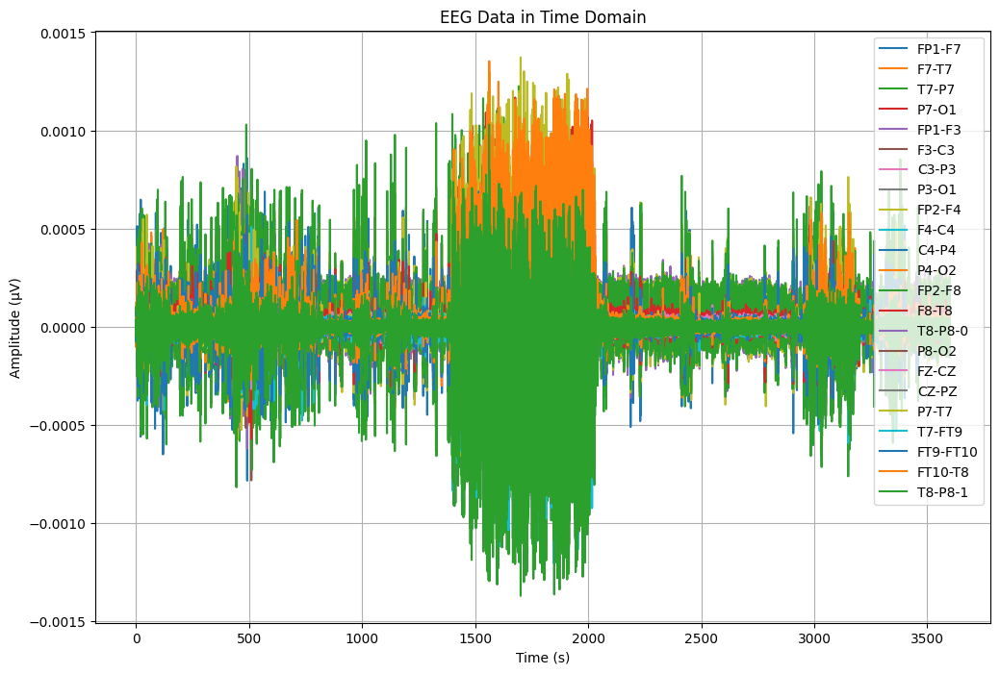

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df24['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df24[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


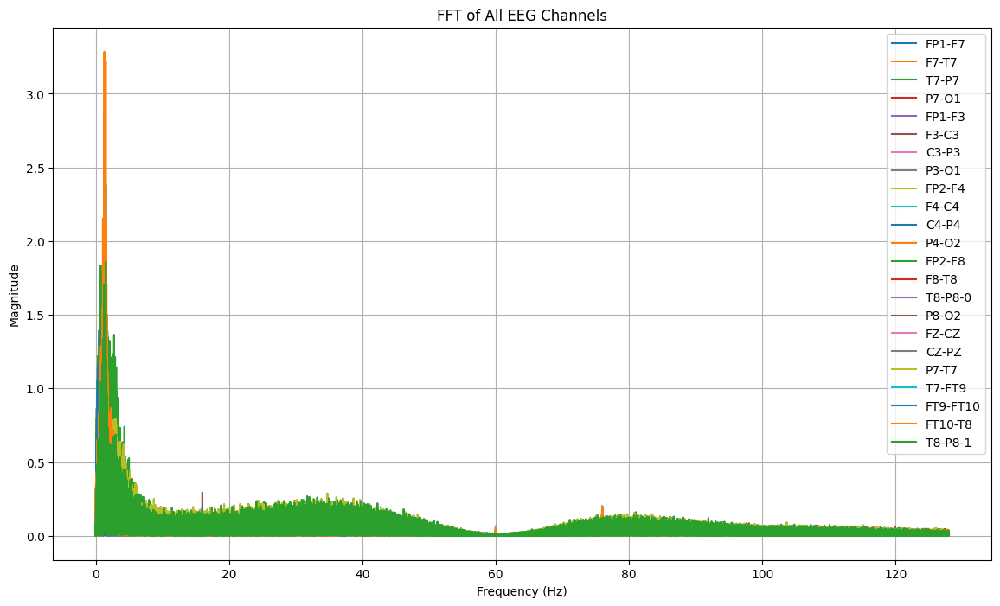

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df24[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv"
df24.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv


In [ ]:
#Import Data CSV
dataTA24 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_03.csv")
dataTA24


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.880342e-05,1.855922e-05,4.122100e-05,-1.953602e-07,-2.207570e-05,-1.934066e-05,3.731380e-05,4.884005e-06,-4.590965e-05,7.619048e-06,...,3.340659e-05,1.973138e-05,-2.246642e-05,2.989011e-05,-4.083028e-05,-4.102564e-06,-2.207570e-05,1.582418e-05,3.340659e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,0.011719
4,1.953602e-07,-1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,9.768010e-07,1.953602e-07,-5.860806e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-2.363858e-05,1.367521e-06,1.953602e-07,6.837607e-06,-1.855922e-05,2.539683e-06,3.711844e-06,-2.148962e-06,-1.113553e-05,1.465201e-05,...,1.465201e-05,3.711844e-06,4.884005e-06,1.953602e-07,1.953602e-07,-1.758242e-06,6.446886e-06,-5.274725e-06,1.465201e-05,3599.980469
921596,-5.860806e-07,-1.699634e-05,1.113553e-05,1.465201e-05,1.367521e-06,2.539683e-06,1.953602e-07,3.321123e-06,-9.181929e-06,1.699634e-05,...,1.660562e-05,1.953602e-07,5.665446e-06,-5.860806e-07,-1.074481e-05,2.090354e-05,5.665446e-06,-9.181929e-06,1.660562e-05,3599.984375
921597,8.400488e-06,-2.676435e-05,1.738706e-05,1.738706e-05,2.285714e-05,-8.400488e-06,-4.102564e-06,7.228327e-06,9.963370e-06,1.738706e-05,...,1.777778e-05,1.367521e-06,7.228327e-06,-1.367521e-06,-1.699634e-05,2.871795e-05,6.056166e-06,-5.274725e-06,1.777778e-05,3599.988281
921598,9.768010e-07,-2.285714e-05,1.230769e-05,1.191697e-05,2.520147e-05,-1.699634e-05,-2.148962e-06,-9.768010e-07,2.285714e-05,8.400488e-06,...,-3.321123e-06,-2.148962e-06,4.493284e-06,-3.321123e-06,-1.191697e-05,2.285714e-05,8.400488e-06,1.347985e-05,-3.321123e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA24[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA24[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA24[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data24, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT10-T8, Max Frequency: 1.29 Hz, Magnitude: 3.286121, Time: 1562.289062 s
Channel: T7-FT9, Max Frequency: 1.51 Hz, Magnitude: 2.380135, Time: 1846.570312 s
Channel: FP2-F8, Max Frequency: 1.51 Hz, Magnitude: 2.379991, Time: 1692.769531 s
Channel: F8-T8, Max Frequency: 1.29 Hz, Magnitude: 2.118198, Time: 1677.179688 s
Channel: T8-P8-0, Max Frequency: 1.51 Hz, Magnitude: 1.860859, Time: 1850.027344 s
Channel: T8-P8-1, Max Frequency: 1.51 Hz, Magnitude: 1.860859, Time: 1850.027344 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.830261, Time: 1993.679688 s
Channel: FP1-F3, Max Frequency: 1.37 Hz, Magnitude: 1.659769, Time: 447.710938 s
Channel: FP2-F4, Max Frequency: 1.37 Hz, Magnitude: 1.640429, Time: 1442.222656 s
Channel: T7-P7, Max Frequency: 1.51 Hz, Magnitude: 1.566094, Time: 1701.183594 s
Channel: P7-T7, Max Frequency: 1.51 Hz, Magnitude: 1.566094, Time: 1701.183594 s
Channel: FP1-F7, Max 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FP1-F3, Max Frequency: 1.37 Hz, Magnitude: 1.659769, Time: 447.710938 s
Channel: CZ-PZ, Max Frequency: 1.51 Hz, Magnitude: 0.396855, Time: 485.531250 s
Channel: FZ-CZ, Max Frequency: 1.45 Hz, Magnitude: 0.502698, Time: 509.894531 s
Channel: FP2-F4, Max Frequency: 1.37 Hz, Magnitude: 1.640429, Time: 1442.222656 s
Channel: F4-C4, Max Frequency: 1.16 Hz, Magnitude: 0.470995, Time: 1540.367188 s
Channel: FT10-T8, Max Frequency: 1.29 Hz, Magnitude: 3.286121, Time: 1562.289062 s
Channel: P7-O1, Max Frequency: 1.81 Hz, Magnitude: 0.357197, Time: 1614.800781 s
Channel: P3-O1, Max Frequency: 1.51 Hz, Magnitude: 0.395415, Time: 1614.800781 s
Channel: P4-O2, Max Frequency: 1.51 Hz, Magnitude: 0.506197, Time: 1614.800781 s
Channel: P8-O2, Max Frequency: 1.26 Hz, Magnitude: 0.332841, Time: 1614.800781 s
Channel: FT9-FT10, Max Frequency: 0.62 Hz, Magnitude: 1.393132, Time: 1617.71093

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 312   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 621    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut24 = dataTA24.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut24.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_03.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA24 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_03.csv")
TA24.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-5.860806e-07,-0.000029,1.347985e-05,1.953602e-07,0.000014,-0.000028,-1.367521e-06,5.860806e-07,0.000010,-0.000022,...,-1.347985e-05,1.953602e-07,-0.000018,-0.000006,-1.308913e-05,0.000028,0.000013,-1.113553e-05,-1.347985e-05,312.000000
1,-1.504274e-05,0.000003,-1.543346e-05,-1.758242e-06,0.000006,-0.000033,-1.953602e-07,-1.367521e-06,0.000007,-0.000008,...,-1.816850e-05,-3.711844e-06,-0.000015,-0.000006,1.582418e-05,-0.000004,0.000011,1.953602e-07,-1.816850e-05,312.003906
2,-3.379731e-05,0.000024,-3.536020e-05,-2.148962e-06,-0.000029,-0.000018,-5.860806e-07,1.367521e-06,-0.000008,0.000004,...,-2.012210e-05,-4.102564e-06,-0.000014,-0.000004,3.575092e-05,-0.000025,0.000013,-9.768010e-07,-2.012210e-05,312.007812
3,-4.004884e-05,0.000010,-2.442002e-05,-5.860806e-07,-0.000039,-0.000017,-1.367521e-06,3.321123e-06,-0.000026,0.000002,...,1.953602e-07,-6.446886e-06,-0.000010,-0.000002,2.481074e-05,-0.000016,0.000014,-1.934066e-05,1.953602e-07,312.011719
4,-9.572650e-06,-0.000019,5.860806e-07,2.148962e-06,-0.000010,-0.000017,1.953602e-07,1.367521e-06,-0.000028,-0.000003,...,3.711844e-06,-5.665446e-06,-0.000010,-0.000001,-1.953602e-07,0.000006,0.000012,-1.738706e-05,3.711844e-06,312.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA24.shape

(79104, 24)

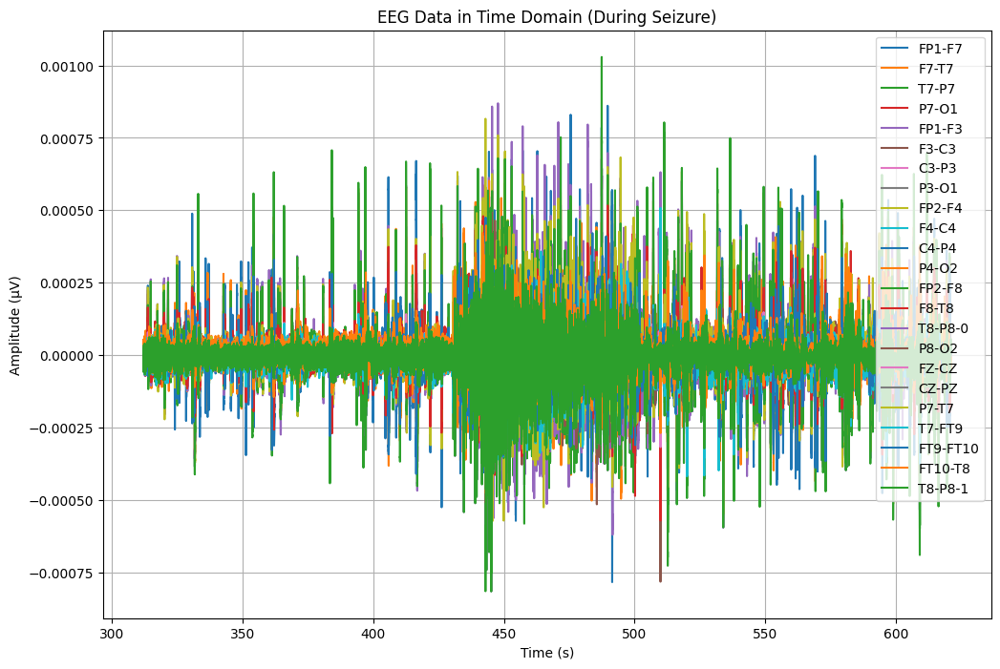

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA24['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA24.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA24[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


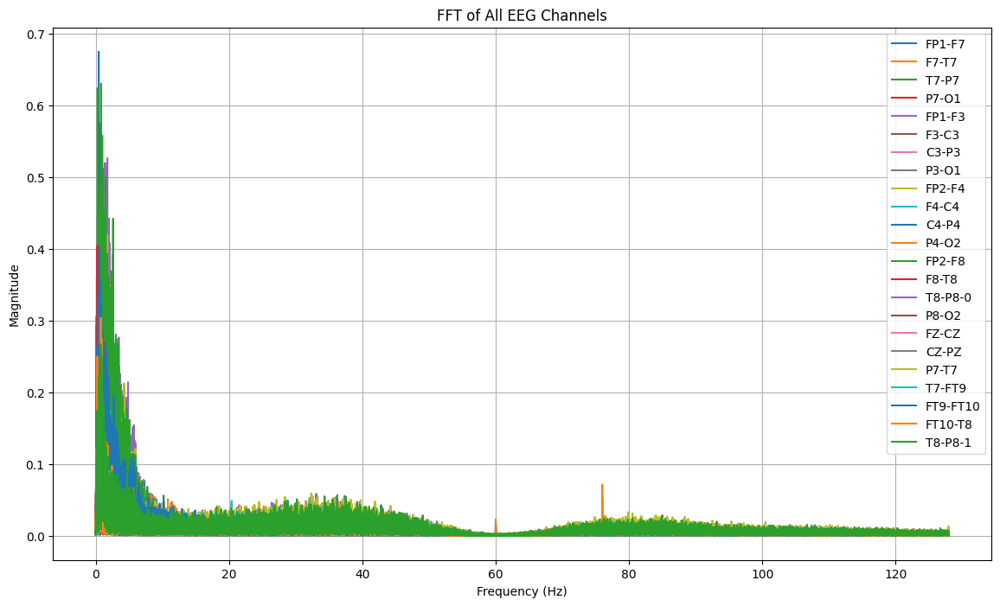

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA24[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 432:
        return "tidak kejang"
    elif 432 <= row['Time'] < 501:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_24 = TA24.copy()
TA_24['seizure'] = TA_24.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_24[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


         Time       seizure        FP1-F7     F7-T7         T7-P7  \
0  312.000000  tidak kejang -5.860806e-07 -0.000029  1.347985e-05   
1  312.003906  tidak kejang -1.504274e-05  0.000003 -1.543346e-05   
2  312.007812  tidak kejang -3.379731e-05  0.000024 -3.536020e-05   
3  312.011719  tidak kejang -4.004884e-05  0.000010 -2.442002e-05   
4  312.015625  tidak kejang -9.572650e-06 -0.000019  5.860806e-07   

          P7-O1    FP1-F3     F3-C3         C3-P3         P3-O1  ...  \
0  1.953602e-07  0.000014 -0.000028 -1.367521e-06  5.860806e-07  ...   
1 -1.758242e-06  0.000006 -0.000033 -1.953602e-07 -1.367521e-06  ...   
2 -2.148962e-06 -0.000029 -0.000018 -5.860806e-07  1.367521e-06  ...   
3 -5.860806e-07 -0.000039 -0.000017 -1.367521e-06  3.321123e-06  ...   
4  2.148962e-06 -0.000010 -0.000017  1.953602e-07  1.367521e-06  ...   

      F8-T8       T8-P8-0         P8-O2     FZ-CZ     CZ-PZ         P7-T7  \
0 -0.000020 -1.347985e-05  1.953602e-07 -0.000018 -0.000006 -1.308913e-05  

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_24['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,17664


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_24)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 309.0 detik


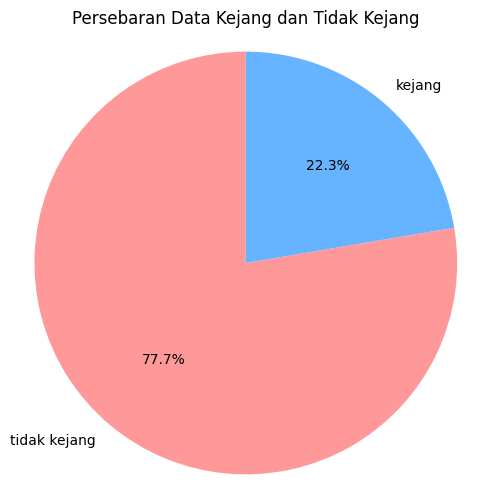

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_24['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_24.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_03.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_24.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_24['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.96      0.96      3631
tidak kejang       0.99      0.99      0.99     12190

    accuracy                           0.98     15821
   macro avg       0.97      0.98      0.98     15821
weighted avg       0.98      0.98      0.98     15821

Akurasi: 0.982428417925542
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.96      0.96      3631
tidak kejang       0.99      0.99      0.99     12190

    accuracy                           0.98     15821
   macro avg       0.97      0.98      0.98     15821
weighted avg       0.98      0.98      0.98     15821



# DATA 25 (chb03_04)

In [ ]:
# mengimport file edf
file25 = "/content/drive/MyDrive/TA/EDF/chb03_04.edf"
data25 = mne.io.read_raw_edf(file25) # membaca file edf dan menyimpannya di data
data25


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-367-c9b5be9492ba>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data25 = mne.io.read_raw_edf(file25) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_04.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data25.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data25.ch_names  # Mendapatkan nama Channel



In [ ]:
# melihat channel pada data
channels = data25.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels


['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df25 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df25['Time'] = times  # Menambahkan kolom waktu
df25.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,9.181929e-06,-1.347985e-05,-1.426129e-05,2.148962e-06,-2.246642e-05,-8.009768e-06,2.539683e-06,-5.274725e-06,-2.676435e-05,...,-4.395604e-05,-1.543346e-05,-2.481074e-05,-7.619048e-06,1.387057e-05,-7.228327e-06,2.012210e-05,2.832723e-05,-4.395604e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df25.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df25.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.333507e-07,2.734135e-07,1.356253e-07,2.041056e-07,2.377260e-07,2.014364e-07,2.060749e-07,1.932124e-07,2.434884e-07,2.377925e-07,...,1.194593e-07,1.933311e-07,2.327351e-07,2.044681e-07,2.550951e-07,1.448175e-07,2.042989e-07,2.588667e-07,1.194593e-07,1799.998047
std,5.934635e-05,4.772490e-05,1.978461e-05,1.446144e-05,6.044245e-05,2.459552e-05,1.162464e-05,9.659314e-06,5.908849e-05,1.828432e-05,...,1.899296e-05,1.254842e-05,1.876034e-05,1.297622e-05,1.978461e-05,2.100780e-05,3.638499e-05,1.962121e-05,1.899296e-05,1039.231048
min,-6.273016e-04,-4.479609e-04,-5.417338e-04,-2.811233e-04,-5.159463e-04,-5.210256e-04,-2.342369e-04,-2.678388e-04,-5.413431e-04,-3.123810e-04,...,-4.589011e-04,-3.819292e-04,-2.400977e-04,-2.084493e-04,-3.178510e-04,-8.988523e-04,-4.210012e-04,-2.803419e-04,-4.589011e-04,0.000000
25%,-1.699634e-05,-1.582418e-05,-8.400488e-06,-5.665446e-06,-1.973138e-05,-1.074481e-05,-4.493284e-06,-4.102564e-06,-1.816850e-05,-8.009768e-06,...,-8.400488e-06,-5.665446e-06,-7.228327e-06,-5.665446e-06,-8.791209e-06,-9.181929e-06,-9.963370e-06,-9.181929e-06,-8.400488e-06,899.999023
50%,-5.860806e-07,-5.860806e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.465201e-05,1.387057e-05,9.181929e-06,6.056166e-06,1.660562e-05,9.963370e-06,4.884005e-06,4.493284e-06,1.504274e-05,7.619048e-06,...,9.572650e-06,6.056166e-06,6.837607e-06,6.056166e-06,8.791209e-06,9.963370e-06,9.963370e-06,9.181929e-06,9.572650e-06,2699.997070
max,7.382662e-04,6.147985e-04,3.182418e-04,3.358242e-04,7.949206e-04,4.999267e-04,2.537729e-04,8.007814e-04,6.589499e-04,6.073748e-04,...,2.815140e-04,4.280342e-04,6.288645e-04,1.783639e-04,5.421245e-04,3.026129e-04,7.871062e-04,3.209768e-04,2.815140e-04,3599.996094


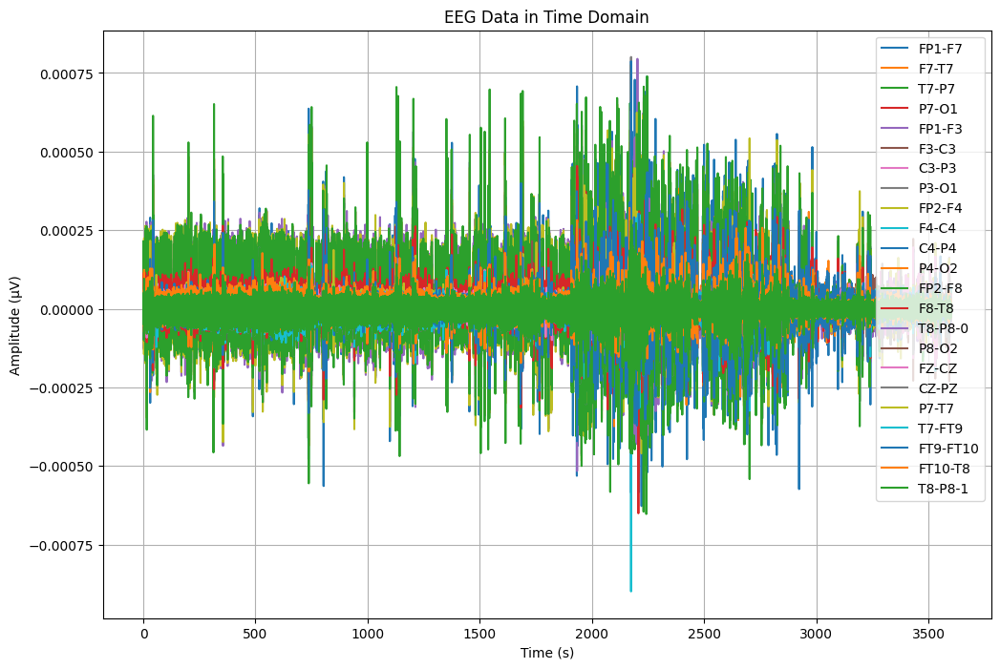

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df25['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df25[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


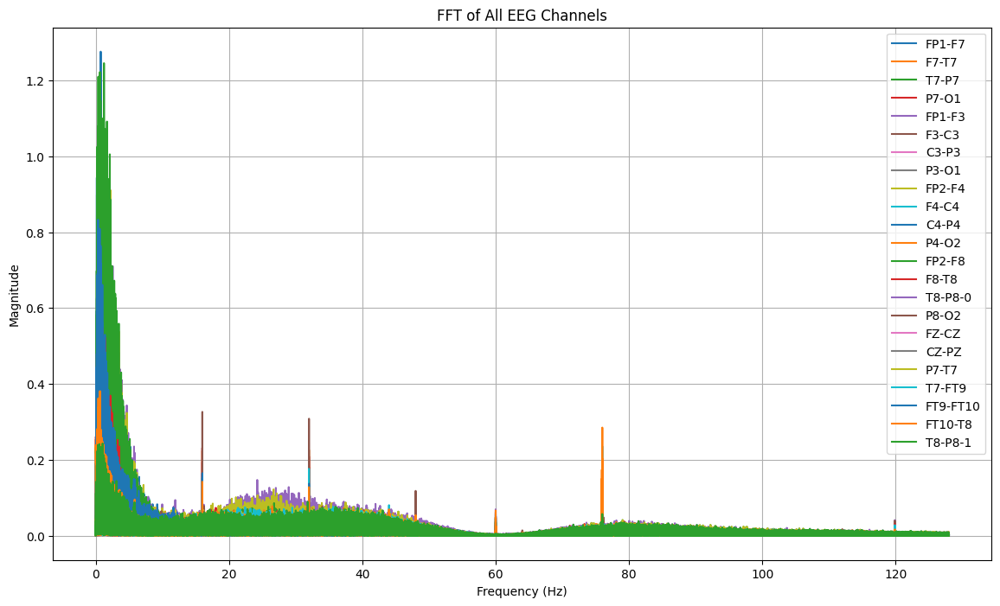

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df25[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv"
df25.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv


In [ ]:
#Import Data CSV
dataTA25 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_04.csv")
dataTA25


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-7.228327e-06,9.181929e-06,-1.347985e-05,-1.426129e-05,2.148962e-06,-2.246642e-05,-8.009768e-06,2.539683e-06,-5.274725e-06,-2.676435e-05,...,-4.395604e-05,-1.543346e-05,-2.481074e-05,-7.619048e-06,1.387057e-05,-7.228327e-06,2.012210e-05,2.832723e-05,-4.395604e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.953602e-07,0.011719
4,9.768010e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.367521e-06,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,-1.953602e-07,-1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.035409e-05,2.148962e-06,-4.884005e-06,-1.347985e-05,-2.676435e-05,1.758242e-06,5.860806e-07,-4.102564e-06,-2.832723e-05,-6.056166e-06,...,-9.572650e-06,-1.758242e-06,-9.572650e-06,9.963370e-06,5.274725e-06,1.758242e-06,4.102564e-06,-1.738706e-05,-9.572650e-06,3599.980469
921596,-9.181929e-06,6.056166e-06,-4.884005e-06,-1.660562e-05,-2.402930e-05,3.711844e-06,1.758242e-06,-7.619048e-06,-2.559219e-05,-3.321123e-06,...,-8.400488e-06,-3.321123e-06,-9.572650e-06,6.446886e-06,5.274725e-06,1.953602e-07,3.711844e-06,-1.465201e-05,-8.400488e-06,3599.984375
921597,-7.228327e-06,6.056166e-06,-1.367521e-06,-1.543346e-05,-2.324786e-05,9.181929e-06,2.539683e-06,-6.837607e-06,-2.520147e-05,-9.768010e-07,...,-6.056166e-06,5.860806e-07,-6.837607e-06,6.446886e-06,1.758242e-06,3.711844e-06,7.228327e-06,-2.090354e-05,-6.056166e-06,3599.988281
921598,-8.791209e-06,9.181929e-06,-9.768010e-07,-1.269841e-05,-2.832723e-05,1.582418e-05,3.711844e-06,-6.056166e-06,-2.324786e-05,-2.148962e-06,...,-5.274725e-06,6.837607e-06,-6.056166e-06,1.113553e-05,1.367521e-06,1.953602e-07,9.572650e-06,-1.894994e-05,-5.274725e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA25[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA25[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA25[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data25, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FP1-F7, Max Frequency: 0.76 Hz, Magnitude: 1.275716, Time: 2244.203125 s
Channel: FP2-F8, Max Frequency: 1.25 Hz, Magnitude: 1.245335, Time: 2246.386719 s
Channel: FP2-F4, Max Frequency: 0.77 Hz, Magnitude: 1.037994, Time: 2231.015625 s
Channel: FP1-F3, Max Frequency: 0.66 Hz, Magnitude: 1.030489, Time: 2202.925781 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 0.940299, Time: 2209.449219 s
Channel: FT9-FT10, Max Frequency: 0.35 Hz, Magnitude: 0.832658, Time: 2174.453125 s
Channel: F8-T8, Max Frequency: 0.40 Hz, Magnitude: 0.657704, Time: 2207.031250 s
Channel: F3-C3, Max Frequency: 0.18 Hz, Magnitude: 0.493660, Time: 2207.031250 s
Channel: F4-C4, Max Frequency: 0.22 Hz, Magnitude: 0.383403, Time: 2231.769531 s
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.381186, Time: 2167.156250 s
Channel: T7-FT9, Max Frequency: 0.86 Hz, Magnitude: 0.377603, Time: 2174.453125 s
Channel: FZ-CZ, Max 

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT10-T8, Max Frequency: 0.64 Hz, Magnitude: 0.381186, Time: 2167.156250 s
Channel: P3-O1, Max Frequency: 0.00 Hz, Magnitude: 0.178065, Time: 2174.453125 s
Channel: C4-P4, Max Frequency: 0.00 Hz, Magnitude: 0.188146, Time: 2174.453125 s
Channel: P4-O2, Max Frequency: 0.00 Hz, Magnitude: 0.181126, Time: 2174.453125 s
Channel: FZ-CZ, Max Frequency: 1.22 Hz, Magnitude: 0.342825, Time: 2174.453125 s
Channel: T7-FT9, Max Frequency: 0.86 Hz, Magnitude: 0.377603, Time: 2174.453125 s
Channel: FT9-FT10, Max Frequency: 0.35 Hz, Magnitude: 0.832658, Time: 2174.453125 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.243363, Time: 2174.496094 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.243363, Time: 2174.496094 s
Channel: P8-O2, Max Frequency: 16.00 Hz, Magnitude: 0.326434, Time: 2180.031250 s
Channel: P7-O1, Max Frequency: 1.11 Hz, Magnitude: 0.224141, Time: 218

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2042   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2334    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut25 = dataTA25.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut25.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_04.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA25 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_04.csv")
TA25.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000008,-0.000026,-0.000010,-7.619048e-06,-0.000020,-0.000011,-3.321123e-06,-5.860806e-07,-0.000006,5.860806e-07,...,0.000012,-0.000019,-9.181929e-06,0.000004,0.000011,-5.860806e-07,-0.000020,0.000016,0.000012,2042.000000
1,0.000012,-0.000026,-0.000023,-9.768010e-07,-0.000018,-0.000010,-4.493284e-06,-4.102564e-06,-0.000003,1.953602e-07,...,0.000015,-0.000010,-6.837607e-06,0.000007,0.000024,8.009768e-06,-0.000038,0.000015,0.000015,2042.003906
2,0.000010,-0.000033,-0.000013,1.953602e-07,-0.000017,-0.000012,-3.321123e-06,-1.758242e-06,-0.000003,1.953602e-07,...,0.000012,-0.000003,-3.321123e-06,0.000006,0.000013,9.572650e-06,-0.000023,0.000006,0.000012,2042.007812
3,0.000008,-0.000027,-0.000005,2.148962e-06,-0.000017,-0.000008,1.953602e-07,4.884005e-06,-0.000003,-1.953602e-07,...,0.000015,0.000020,-1.953602e-07,0.000012,0.000005,2.930403e-06,-0.000031,0.000010,0.000015,2042.011719
4,0.000003,-0.000024,-0.000004,1.953602e-07,-0.000018,-0.000006,1.953602e-07,1.953602e-07,-0.000002,-5.860806e-07,...,0.000012,0.000004,9.768010e-07,0.000009,0.000005,1.953602e-07,-0.000021,0.000016,0.000012,2042.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA25.shape

(74752, 24)

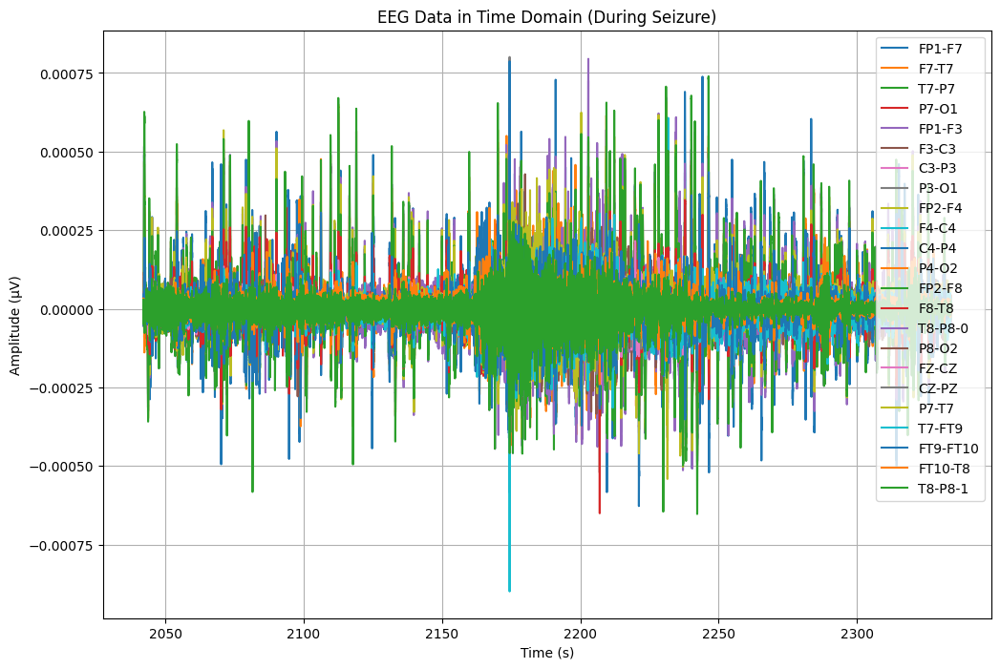

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA25['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA25.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA25[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


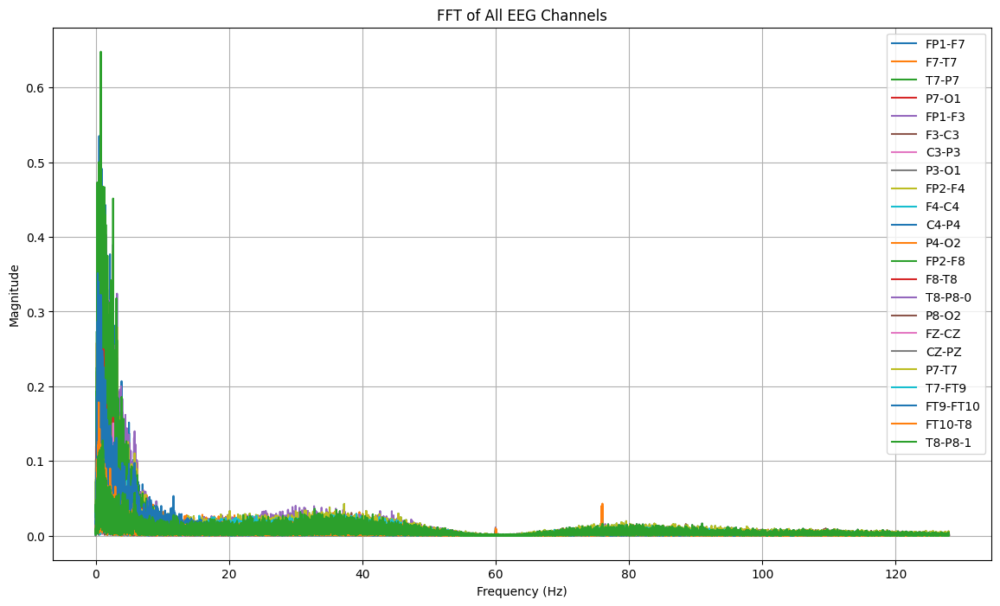

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA25[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2162:
        return "tidak kejang"
    elif 2162 <= row['Time'] < 2214:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_25 = TA25.copy()
TA_25['seizure'] = TA_25.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_25[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7         P7-O1  \
0  2042.000000  tidak kejang  0.000008 -0.000026 -0.000010 -7.619048e-06   
1  2042.003906  tidak kejang  0.000012 -0.000026 -0.000023 -9.768010e-07   
2  2042.007812  tidak kejang  0.000010 -0.000033 -0.000013  1.953602e-07   
3  2042.011719  tidak kejang  0.000008 -0.000027 -0.000005  2.148962e-06   
4  2042.015625  tidak kejang  0.000003 -0.000024 -0.000004  1.953602e-07   

     FP1-F3     F3-C3         C3-P3         P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000020 -0.000011 -3.321123e-06 -5.860806e-07  ...  0.000051  0.000012   
1 -0.000018 -0.000010 -4.493284e-06 -4.102564e-06  ...  0.000043  0.000015   
2 -0.000017 -0.000012 -3.321123e-06 -1.758242e-06  ...  0.000040  0.000012   
3 -0.000017 -0.000008  1.953602e-07  4.884005e-06  ...  0.000035  0.000015   
4 -0.000018 -0.000006  1.953602e-07  1.953602e-07  ...  0.000028  0.000012   

      P8-O2         FZ-CZ     CZ-PZ     P7-T7        T7-FT9  FT9-FT10  \
0

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_25['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13312


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_25)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 292.0 detik


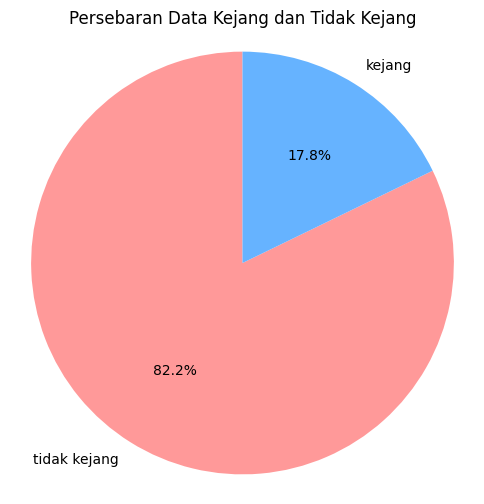

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_25['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_25.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_04.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_25.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_25['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.91      0.93      2717
tidak kejang       0.98      0.99      0.99     12234

    accuracy                           0.98     14951
   macro avg       0.97      0.95      0.96     14951
weighted avg       0.98      0.98      0.98     14951

Akurasi: 0.9763895391612601
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.91      0.93      2717
tidak kejang       0.98      0.99      0.99     12234

    accuracy                           0.98     14951
   macro avg       0.97      0.95      0.96     14951
weighted avg       0.98      0.98      0.98     14951



# DATA 26 (chb03_34)

In [ ]:
# mengimport file edf
file26 = "/content/drive/MyDrive/TA/EDF/chb03_34.edf"
data26 = mne.io.read_raw_edf(file26) # membaca file edf dan menyimpannya di data
data26


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_34.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-391-095119b44043>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data26 = mne.io.read_raw_edf(file26) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_34.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data26.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data26.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data26.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df26= pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df26['Time'] = times  # Menambahkan kolom waktu
df26.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.473748e-05,-8.009768e-06,6.544567e-05,1.758242e-06,7.521368e-05,-7.638584e-05,4.590965e-05,-3.028083e-05,3.379731e-05,4.083028e-05,...,6.896215e-05,-3.614164e-05,1.269841e-05,2.318926e-04,-6.505495e-05,1.615629e-04,-1.408547e-04,2.285714e-05,6.896215e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,...,5.860806e-07,1.953602e-07,9.768010e-07,5.665446e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.539683e-06,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df26.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df26.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.142705e-07,2.008191e-07,1.040636e-07,2.927406e-07,1.236056e-07,2.847078e-07,1.858245e-07,2.276786e-07,2.106749e-07,1.979463e-07,...,1.727857e-07,2.128561e-07,1.991466e-07,1.892073e-07,2.866567e-07,1.584063e-07,2.163059e-07,1.945551e-07,1.727857e-07,1799.998047
std,4.936661e-05,4.861904e-05,4.406845e-05,4.959530e-05,5.116416e-05,4.332370e-05,2.682343e-05,4.496633e-05,4.622006e-05,7.857988e-05,...,3.189693e-05,2.630969e-05,4.125162e-05,7.787424e-05,4.406845e-05,4.104697e-05,3.736968e-05,3.054710e-05,3.189693e-05,1039.231048
min,-1.067253e-03,-8.027350e-04,-9.812943e-04,-1.347009e-03,-1.071160e-03,-1.157118e-03,-4.897680e-04,-1.388425e-03,-9.488645e-04,-1.515800e-03,...,-7.957021e-04,-9.734799e-04,-1.233700e-03,-1.723272e-03,-1.145788e-03,-9.594139e-04,-1.066862e-03,-5.108669e-04,-7.957021e-04,0.000000
25%,-1.074481e-05,-1.465201e-05,-1.347985e-05,-1.543346e-05,-1.621490e-05,-1.777778e-05,-9.181929e-06,-9.572650e-06,-1.426129e-05,-1.426129e-05,...,-9.963370e-06,-9.572650e-06,-1.465201e-05,-2.442002e-05,-1.543346e-05,-1.035409e-05,-1.191697e-05,-8.400488e-06,-9.963370e-06,899.999023
50%,1.953602e-07,1.953602e-07,9.768010e-07,-9.768010e-07,9.768010e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.074481e-05,1.465201e-05,1.582418e-05,1.347985e-05,1.777778e-05,1.582418e-05,9.572650e-06,9.572650e-06,1.426129e-05,1.504274e-05,...,1.074481e-05,9.572650e-06,1.504274e-05,2.520147e-05,1.387057e-05,1.152625e-05,1.230769e-05,8.791209e-06,1.074481e-05,2699.997070
max,9.601954e-04,9.633211e-04,1.146178e-03,1.230183e-03,1.157509e-03,1.137973e-03,9.621490e-04,1.365372e-03,1.060611e-03,1.541978e-03,...,5.425153e-04,9.293284e-04,1.318486e-03,1.657241e-03,9.816850e-04,1.058266e-03,8.062515e-04,8.558730e-04,5.425153e-04,3599.996094


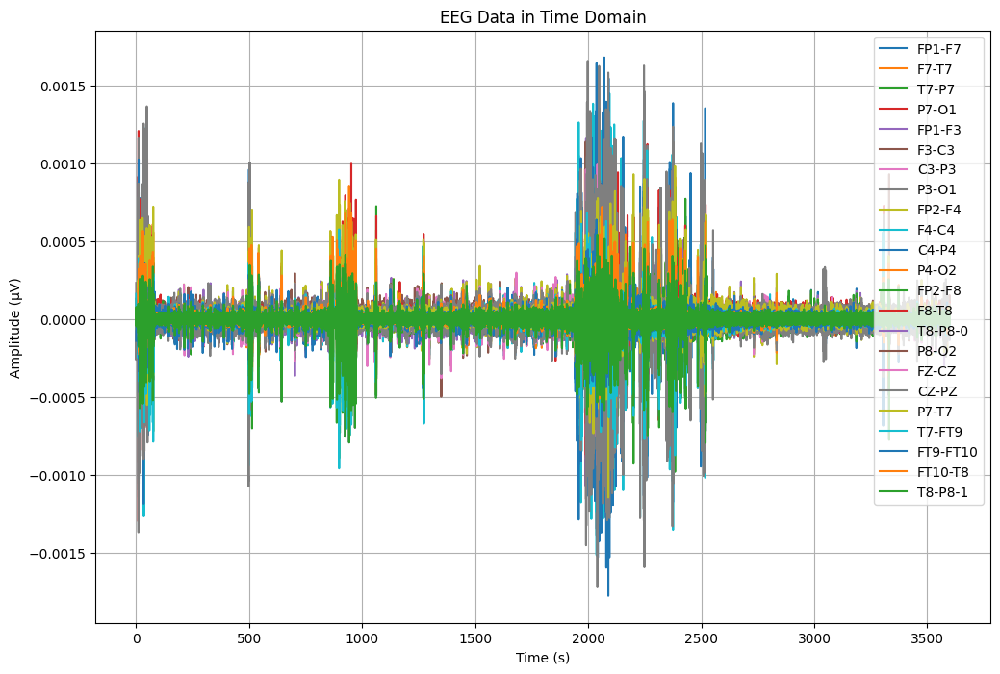

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya

time = df26['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df26[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


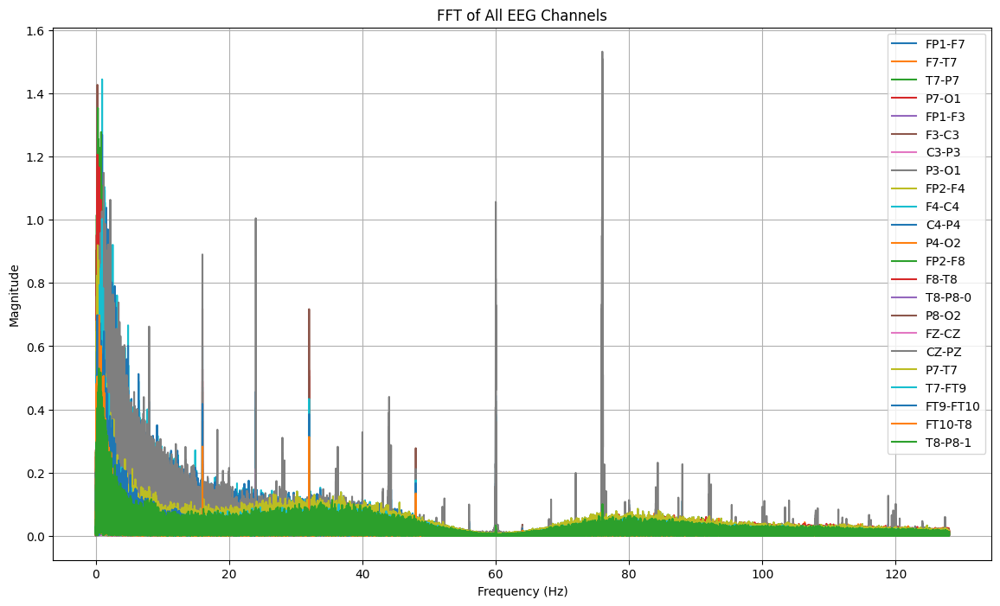

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df26[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv"
df26.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv


In [ ]:
#Import Data CSV
dataTA26 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_34.csv")
dataTA26


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-4.473748e-05,-8.009768e-06,6.544567e-05,1.758242e-06,7.521368e-05,-7.638584e-05,4.590965e-05,-3.028083e-05,3.379731e-05,4.083028e-05,...,6.896215e-05,-3.614164e-05,1.269841e-05,2.318926e-04,-6.505495e-05,1.615629e-04,-1.408547e-04,2.285714e-05,6.896215e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,...,5.860806e-07,1.953602e-07,9.768010e-07,5.665446e-06,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,0.011719
4,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.539683e-06,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-9.768010e-07,1.152625e-05,-2.930403e-06,-1.660562e-05,6.349206e-05,-5.020757e-05,-7.619048e-06,-1.426129e-05,4.825397e-05,-4.942613e-05,...,1.074481e-05,-1.855922e-05,-3.184371e-05,-8.771673e-05,3.321123e-06,-2.989011e-05,8.791209e-06,9.768010e-07,1.074481e-05,3599.980469
921596,-6.446886e-06,1.230769e-05,-7.619048e-06,-1.934066e-05,5.450549e-05,-4.981685e-05,-9.572650e-06,-1.582418e-05,4.356532e-05,-2.910867e-05,...,1.074481e-05,-2.285714e-05,-1.660562e-05,9.768010e-07,8.009768e-06,-2.949939e-05,1.308913e-05,-1.953602e-07,1.074481e-05,3599.984375
921597,-8.791209e-06,5.665446e-06,-9.572650e-06,-1.269841e-05,4.473748e-05,-5.137973e-05,-1.074481e-05,-7.619048e-06,2.949939e-05,-1.699634e-05,...,8.400488e-06,-1.621490e-05,-1.387057e-05,3.028083e-05,9.963370e-06,-2.598291e-05,1.269841e-05,1.953602e-07,8.400488e-06,3599.988281
921598,-9.181929e-06,5.274725e-06,-4.884005e-06,-1.582418e-05,3.575092e-05,-4.708181e-05,-5.274725e-06,-7.228327e-06,1.855922e-05,-2.324786e-05,...,8.791209e-06,-2.051282e-05,-2.871795e-05,1.347985e-05,5.274725e-06,-2.207570e-05,1.387057e-05,-9.768010e-07,8.791209e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA26[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA26[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA26[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data26, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 75.99 Hz, Magnitude: 1.532156, Time: 2040.523438 s
Channel: F4-C4, Max Frequency: 0.95 Hz, Magnitude: 1.444332, Time: 2040.359375 s
Channel: F3-C3, Max Frequency: 0.25 Hz, Magnitude: 1.427214, Time: 1990.507812 s
Channel: FP2-F8, Max Frequency: 0.32 Hz, Magnitude: 1.353743, Time: 1997.683594 s
Channel: C4-P4, Max Frequency: 0.95 Hz, Magnitude: 1.269256, Time: 2089.101562 s
Channel: F8-T8, Max Frequency: 0.25 Hz, Magnitude: 1.206076, Time: 951.996094 s
Channel: P7-O1, Max Frequency: 0.40 Hz, Magnitude: 1.149650, Time: 2036.972656 s
Channel: FP1-F3, Max Frequency: 0.32 Hz, Magnitude: 1.111533, Time: 1990.507812 s
Channel: T7-FT9, Max Frequency: 0.93 Hz, Magnitude: 1.002980, Time: 1953.351562 s
Channel: FP1-F7, Max Frequency: 0.35 Hz, Magnitude: 0.984828, Time: 2056.566406 s
Channel: P3-O1, Max Frequency: 1.06 Hz, Magnitude: 0.949817, Time: 2036.976562 s
Channel: P7-T7, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: FT10-T8, Max Frequency: 0.54 Hz, Magnitude: 0.697410, Time: 942.441406 s
Channel: F8-T8, Max Frequency: 0.25 Hz, Magnitude: 1.206076, Time: 951.996094 s
Channel: T7-FT9, Max Frequency: 0.93 Hz, Magnitude: 1.002980, Time: 1953.351562 s
Channel: FT9-FT10, Max Frequency: 0.24 Hz, Magnitude: 0.698443, Time: 1953.355469 s
Channel: F7-T7, Max Frequency: 0.40 Hz, Magnitude: 0.912188, Time: 1986.488281 s
Channel: FP1-F3, Max Frequency: 0.32 Hz, Magnitude: 1.111533, Time: 1990.507812 s
Channel: F3-C3, Max Frequency: 0.25 Hz, Magnitude: 1.427214, Time: 1990.507812 s
Channel: FP2-F8, Max Frequency: 0.32 Hz, Magnitude: 1.353743, Time: 1997.683594 s
Channel: P7-O1, Max Frequency: 0.40 Hz, Magnitude: 1.149650, Time: 2036.972656 s
Channel: P3-O1, Max Frequency: 1.06 Hz, Magnitude: 0.949817, Time: 2036.976562 s
Channel: F4-C4, Max Frequency: 0.95 Hz, Magnitude: 1.444332, Time: 2040.359

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1822   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2149    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut26 = dataTA26.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut26.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_34.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA26 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_34.csv")
TA26.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000009,2.539683e-06,1.953602e-07,-1.308913e-05,0.000011,-0.000015,0.000008,-0.000004,0.000018,-1.504274e-05,...,-0.000008,-0.000008,-0.000015,-0.000053,1.953602e-07,-0.000002,-4.102564e-06,0.000015,-0.000008,1822.000000
1,0.000006,1.465201e-05,-6.446886e-06,-1.230769e-05,0.000013,-0.000015,0.000012,-0.000008,0.000016,-9.768010e-07,...,-0.000008,-0.000012,-0.000003,-0.000005,6.837607e-06,-0.000014,5.860806e-07,0.000019,-0.000008,1822.003906
2,0.000006,1.113553e-05,2.930403e-06,-1.035409e-05,0.000018,-0.000012,0.000015,-0.000011,0.000021,1.621490e-05,...,-0.000010,-0.000014,0.000006,0.000042,-2.539683e-06,-0.000009,3.711844e-06,0.000024,-0.000010,1822.007812
3,0.000003,1.953602e-07,1.465201e-05,5.860806e-07,0.000016,-0.000009,0.000017,-0.000003,0.000021,2.539683e-06,...,-0.000008,-0.000009,-0.000003,-0.000007,-1.426129e-05,0.000001,4.884005e-06,0.000027,-0.000008,1822.011719
4,0.000003,9.768010e-07,2.207570e-05,3.711844e-06,0.000017,-0.000003,0.000021,-0.000003,0.000024,-6.837607e-06,...,-0.000011,-0.000004,-0.000004,-0.000022,-2.168498e-05,0.000001,7.228327e-06,0.000029,-0.000011,1822.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA26.shape

(83712, 24)

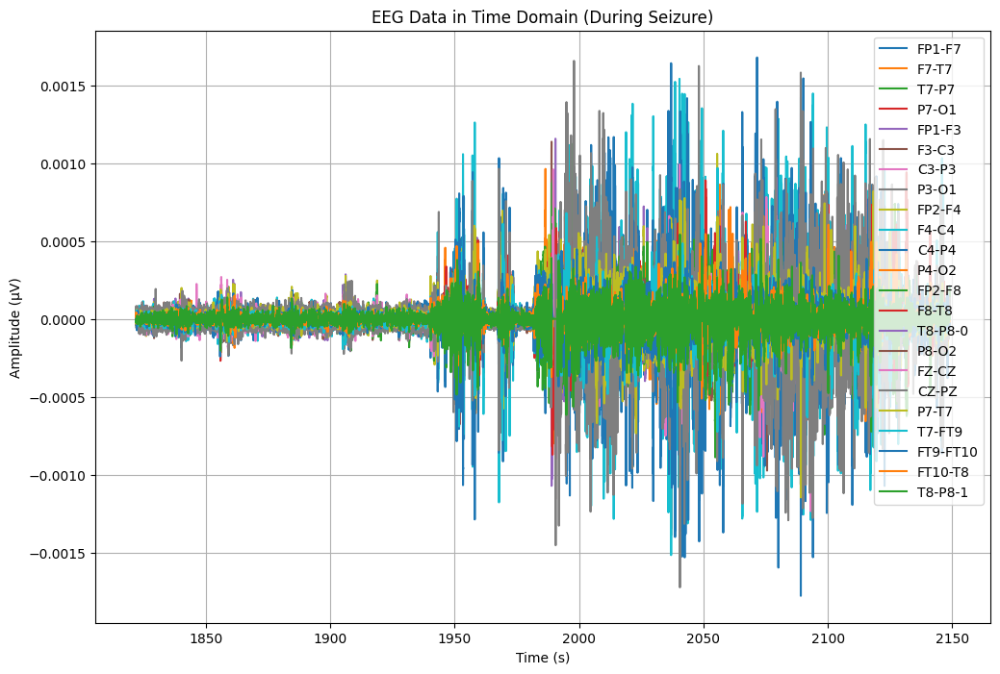

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA26['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA26.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA26[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


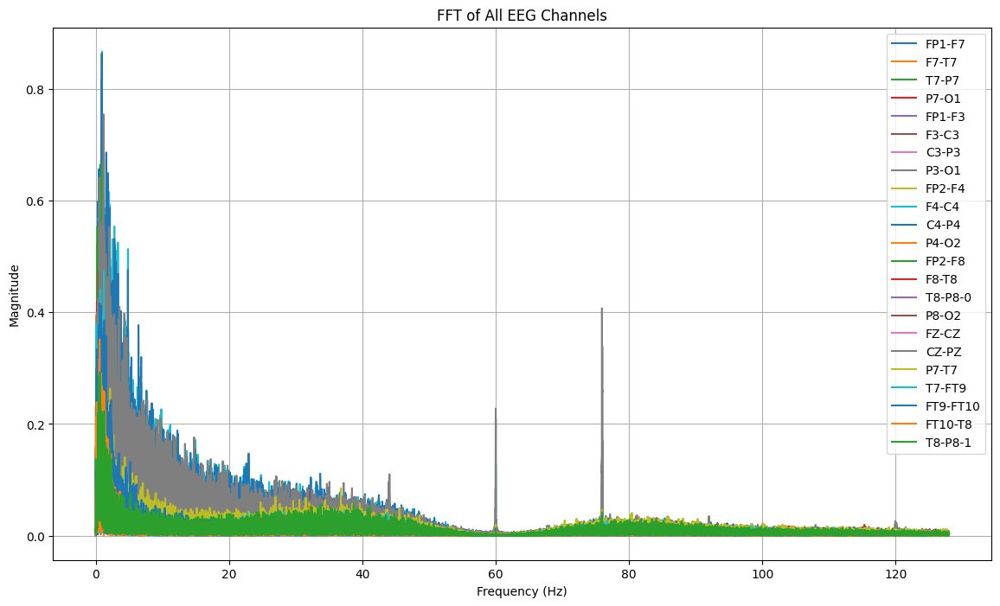

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA26[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1982:
        return "tidak kejang"
    elif 1982 <= row['Time'] < 2029:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_26 = TA26.copy()
TA_26['seizure'] = TA_26.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_26[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7         F7-T7         T7-P7  \
0  1822.000000  tidak kejang  0.000009  2.539683e-06  1.953602e-07   
1  1822.003906  tidak kejang  0.000006  1.465201e-05 -6.446886e-06   
2  1822.007812  tidak kejang  0.000006  1.113553e-05  2.930403e-06   
3  1822.011719  tidak kejang  0.000003  1.953602e-07  1.465201e-05   
4  1822.015625  tidak kejang  0.000003  9.768010e-07  2.207570e-05   

          P7-O1    FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8  \
0 -1.308913e-05  0.000011 -0.000015  0.000008 -0.000004  ...  0.000020   
1 -1.230769e-05  0.000013 -0.000015  0.000012 -0.000008  ...  0.000025   
2 -1.035409e-05  0.000018 -0.000012  0.000015 -0.000011  ...  0.000031   
3  5.860806e-07  0.000016 -0.000009  0.000017 -0.000003  ...  0.000034   
4  3.711844e-06  0.000017 -0.000003  0.000021 -0.000003  ...  0.000035   

    T8-P8-0     P8-O2     FZ-CZ     CZ-PZ         P7-T7    T7-FT9  \
0 -0.000008 -0.000008 -0.000015 -0.000053  1.953602e-07 -0.000002

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_26['seizure'].value_counts()


,count
seizure,
tidak kejang,71680
kejang,12032


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_26)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 327.0 detik


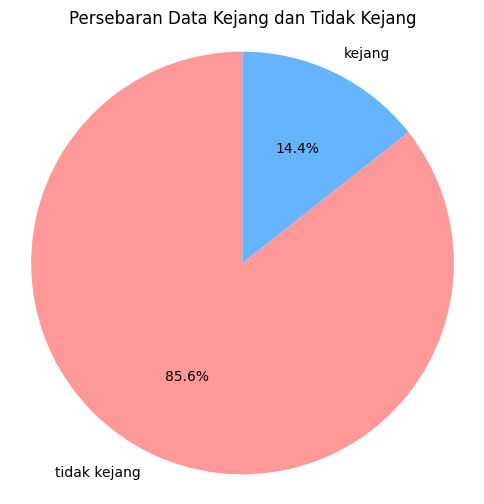

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_26['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_26.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_34.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_26.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_26['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.98      0.60      0.75      2430
tidak kejang       0.94      1.00      0.97     14313

    accuracy                           0.94     16743
   macro avg       0.96      0.80      0.86     16743
weighted avg       0.94      0.94      0.93     16743

Akurasi: 0.9407513587768023
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.98      0.60      0.75      2430
tidak kejang       0.94      1.00      0.97     14313

    accuracy                           0.94     16743
   macro avg       0.96      0.80      0.86     16743
weighted avg       0.94      0.94      0.93     16743



# DATA 27 (chb03_35)

In [ ]:
# mengimport file edf
file27 = "/content/drive/MyDrive/TA/EDF/chb03_35.edf"
data27 = mne.io.read_raw_edf(file27) # membaca file edf dan menyimpannya di data
data27


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_35.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-415-e248f049c79b>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data27 = mne.io.read_raw_edf(file27) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_35.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data27.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data27.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data27.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df27 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df27['Time'] = times  # Menambahkan kolom waktu
df27.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.493284e-06,-1.504274e-05,1.699634e-05,-8.654457e-05,-1.230769e-05,-4.493284e-06,-5.489621e-05,-8.400488e-06,-9.963370e-06,-5.372405e-05,...,-3.731380e-05,4.825397e-05,1.582418e-05,-1.611722e-04,-1.660562e-05,-4.864469e-05,-3.457875e-05,4.630037e-05,-3.731380e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,...,1.953602e-07,1.953602e-07,-5.860806e-07,-4.102564e-06,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-9.768010e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-4.493284e-06,...,1.953602e-07,5.860806e-07,-2.539683e-06,-1.347985e-05,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,2.148962e-06,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,8.400488e-06,...,5.860806e-07,-9.768010e-07,5.665446e-06,2.676435e-05,-1.758242e-06,1.953602e-07,-1.953602e-07,5.860806e-07,5.860806e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df27.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df27.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.172704e-07,2.083974e-07,1.246210e-07,2.700185e-07,1.963544e-07,2.175591e-07,2.076486e-07,1.970013e-07,2.113362e-07,2.099185e-07,...,1.830251e-07,2.030394e-07,1.939442e-07,2.046428e-07,2.660994e-07,1.594869e-07,1.973363e-07,2.060618e-07,1.830251e-07,1799.998047
std,5.079673e-05,4.932996e-05,4.877081e-05,4.293701e-05,5.003014e-05,4.219873e-05,2.752505e-05,3.148684e-05,5.213646e-05,6.889772e-05,...,3.846530e-05,2.749159e-05,4.868721e-05,8.168052e-05,4.877081e-05,3.887911e-05,3.466835e-05,3.519029e-05,3.846530e-05,1039.231048
min,-7.714774e-04,-7.136508e-04,-1.237998e-03,-1.058266e-03,-7.562393e-04,-5.897924e-04,-5.374359e-04,-7.652259e-04,-1.291526e-03,-1.450940e-03,...,-9.992674e-04,-7.585836e-04,-1.572845e-03,-1.701392e-03,-1.208303e-03,-7.644444e-04,-8.957265e-04,-7.992186e-04,-9.992674e-04,0.000000
25%,-1.387057e-05,-1.855922e-05,-1.699634e-05,-1.894994e-05,-1.894994e-05,-1.894994e-05,-1.035409e-05,-1.035409e-05,-1.894994e-05,-1.738706e-05,...,-1.308913e-05,-1.191697e-05,-1.855922e-05,-3.067155e-05,-2.012210e-05,-1.191697e-05,-1.426129e-05,-1.113553e-05,-1.308913e-05,899.999023
50%,1.953602e-07,1.953602e-07,1.367521e-06,-9.768010e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.387057e-05,1.855922e-05,2.051282e-05,1.660562e-05,1.894994e-05,1.894994e-05,1.074481e-05,1.074481e-05,1.855922e-05,1.777778e-05,...,1.426129e-05,1.191697e-05,1.894994e-05,3.106227e-05,1.738706e-05,1.347985e-05,1.465201e-05,1.074481e-05,1.426129e-05,2699.997070
max,9.281563e-04,8.382906e-04,1.208694e-03,1.034823e-03,1.050452e-03,4.690598e-04,6.034676e-04,1.078584e-03,8.718926e-04,1.821343e-03,...,7.183394e-04,6.886447e-04,1.311062e-03,1.951844e-03,1.238388e-03,5.784615e-04,6.905983e-04,8.504029e-04,7.183394e-04,3599.996094


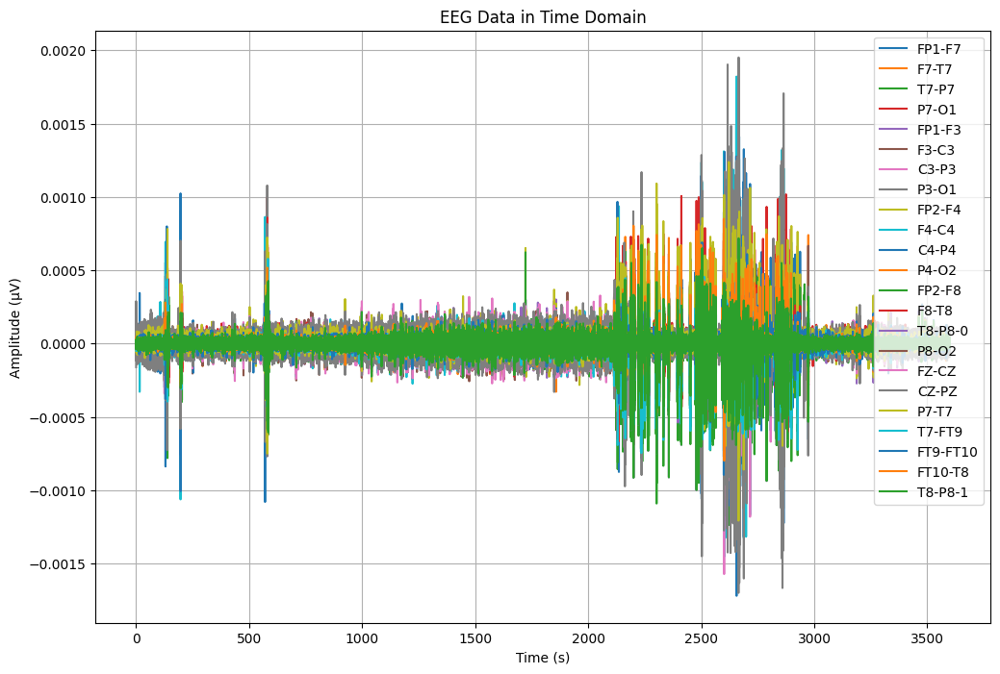

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df27['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df27[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


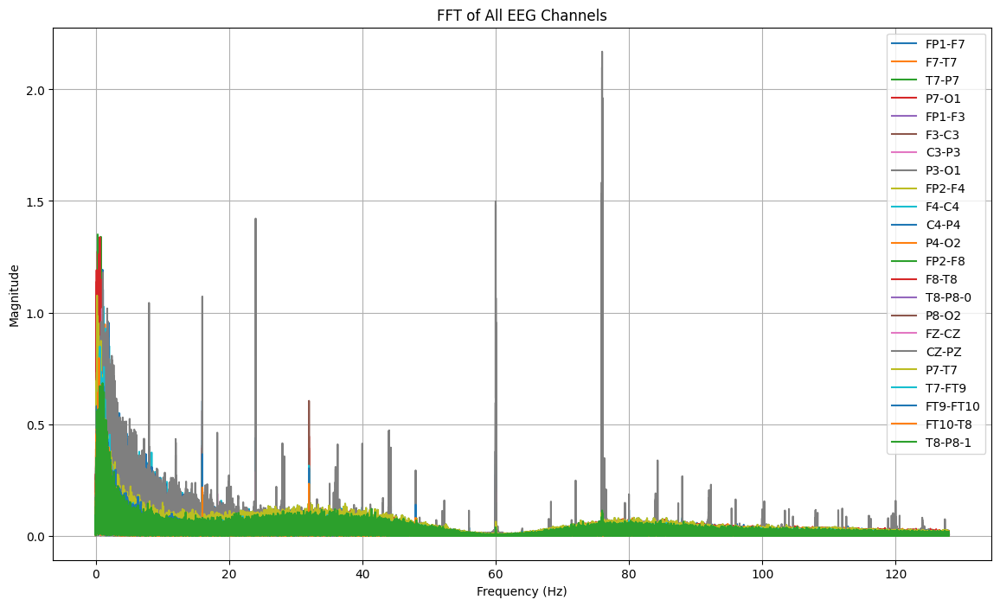

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df27[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv"
df27.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv


In [ ]:
#Import Data CSV
dataTA27 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_35.csv")
dataTA27


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,4.493284e-06,-1.504274e-05,1.699634e-05,-8.654457e-05,-1.230769e-05,-4.493284e-06,-5.489621e-05,-8.400488e-06,-9.963370e-06,-5.372405e-05,...,-3.731380e-05,4.825397e-05,1.582418e-05,-1.611722e-04,-1.660562e-05,-4.864469e-05,-3.457875e-05,4.630037e-05,-3.731380e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,...,1.953602e-07,1.953602e-07,-5.860806e-07,-4.102564e-06,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,-9.768010e-07,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,-4.493284e-06,...,1.953602e-07,5.860806e-07,-2.539683e-06,-1.347985e-05,1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,2.148962e-06,-1.367521e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.758242e-06,8.400488e-06,...,5.860806e-07,-9.768010e-07,5.665446e-06,2.676435e-05,-1.758242e-06,1.953602e-07,-1.953602e-07,5.860806e-07,5.860806e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-8.791209e-06,-2.930403e-06,-1.953602e-07,-3.321123e-06,-1.113553e-05,-5.860806e-07,-5.860806e-07,-2.930403e-06,-5.665446e-06,2.539683e-06,...,-1.504274e-05,-1.973138e-05,-2.989011e-05,-1.035409e-05,5.860806e-07,7.619048e-06,2.207570e-05,6.056166e-06,-1.504274e-05,3599.980469
921596,-5.665446e-06,-2.930403e-06,1.953602e-07,-2.539683e-06,-1.230769e-05,2.930403e-06,5.860806e-07,-3.711844e-06,-4.102564e-06,5.860806e-07,...,-1.152625e-05,-2.012210e-05,-2.442002e-05,-9.768010e-07,1.953602e-07,9.572650e-06,2.442002e-05,4.884005e-06,-1.152625e-05,3599.984375
921597,-6.056166e-06,-3.321123e-06,-9.768010e-07,1.758242e-06,-1.504274e-05,9.768010e-07,1.758242e-06,1.758242e-06,-4.884005e-06,1.543346e-05,...,-5.665446e-06,-1.660562e-05,-1.426129e-05,2.442002e-05,1.367521e-06,8.009768e-06,2.129426e-05,5.665446e-06,-5.665446e-06,3599.988281
921598,-7.228327e-06,-6.056166e-06,-9.768010e-07,7.228327e-06,-1.660562e-05,-9.768010e-07,9.768010e-07,8.400488e-06,-9.572650e-06,7.228327e-06,...,-4.884005e-06,-6.446886e-06,-2.285714e-05,-1.855922e-05,1.367521e-06,7.619048e-06,1.855922e-05,6.446886e-06,-4.884005e-06,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA27[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA27[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA27[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data27, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 75.98 Hz, Magnitude: 2.169183, Time: 2665.648438 s
Channel: FP2-F8, Max Frequency: 0.31 Hz, Magnitude: 1.350210, Time: 2603.699219 s
Channel: F8-T8, Max Frequency: 0.62 Hz, Magnitude: 1.337853, Time: 2875.347656 s
Channel: P7-O1, Max Frequency: 0.28 Hz, Magnitude: 1.274769, Time: 2665.292969 s
Channel: FP2-F4, Max Frequency: 0.33 Hz, Magnitude: 1.271642, Time: 2600.097656 s
Channel: C4-P4, Max Frequency: 1.04 Hz, Magnitude: 1.192014, Time: 2656.460938 s
Channel: F4-C4, Max Frequency: 1.02 Hz, Magnitude: 1.104471, Time: 2656.457031 s
Channel: T7-P7, Max Frequency: 0.21 Hz, Magnitude: 1.076194, Time: 2622.566406 s
Channel: P7-T7, Max Frequency: 0.21 Hz, Magnitude: 1.076194, Time: 2622.566406 s
Channel: F7-T7, Max Frequency: 1.04 Hz, Magnitude: 1.058799, Time: 2702.699219 s
Channel: FP1-F3, Max Frequency: 0.22 Hz, Magnitude: 1.024851, Time: 2600.078125 s
Channel: FZ-CZ, Max Freque

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: P3-O1, Max Frequency: 0.98 Hz, Magnitude: 0.667766, Time: 579.921875 s
Channel: F3-C3, Max Frequency: 1.01 Hz, Magnitude: 0.945632, Time: 581.500000 s
Channel: C3-P3, Max Frequency: 0.92 Hz, Magnitude: 0.580012, Time: 581.515625 s
Channel: P8-O2, Max Frequency: 32.00 Hz, Magnitude: 0.604456, Time: 2235.921875 s
Channel: T8-P8-0, Max Frequency: 1.04 Hz, Magnitude: 0.683837, Time: 2479.078125 s
Channel: T8-P8-1, Max Frequency: 1.04 Hz, Magnitude: 0.683837, Time: 2479.078125 s
Channel: T7-FT9, Max Frequency: 0.63 Hz, Magnitude: 0.848138, Time: 2488.921875 s
Channel: FT10-T8, Max Frequency: 0.50 Hz, Magnitude: 0.796206, Time: 2599.769531 s
Channel: FT9-FT10, Max Frequency: 1.13 Hz, Magnitude: 0.670742, Time: 2599.777344 s
Channel: FP1-F7, Max Frequency: 0.45 Hz, Magnitude: 0.996172, Time: 2600.078125 s
Channel: FP1-F3, Max Frequency: 0.22 Hz, Magnitude: 1.024851, Time: 2600

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 2472   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2776    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut27 = dataTA27.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut27.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_35.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA27 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_35.csv")
TA27.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,0.000019,-0.000022,-0.000004,-0.000002,3.711844e-06,-0.000010,-0.000005,2.148962e-06,-5.860806e-07,0.000003,...,-0.000021,0.000022,-7.619048e-06,-0.000012,0.000004,5.860806e-07,-0.000038,-0.000008,-0.000021,2472.000000
1,0.000004,-0.000010,0.000002,-0.000008,1.953602e-07,-0.000005,-0.000003,-2.148962e-06,-9.181929e-06,0.000004,...,-0.000032,0.000023,1.953602e-07,0.000040,-0.000001,8.009768e-06,-0.000026,-0.000017,-0.000032,2472.003906
2,0.000002,-0.000007,-0.000001,-0.000003,-2.930403e-06,-0.000003,-0.000003,5.860806e-07,-2.402930e-05,-0.000003,...,-0.000036,0.000019,-4.102564e-06,0.000012,0.000002,4.102564e-06,-0.000021,-0.000010,-0.000036,2472.007812
3,-0.000005,0.000003,-0.000003,-0.000004,-3.711844e-06,-0.000002,-0.000002,1.953602e-07,-2.168498e-05,-0.000019,...,-0.000043,0.000022,-1.660562e-05,-0.000037,0.000003,5.860806e-07,-0.000010,-0.000017,-0.000043,2472.011719
4,-0.000005,0.000013,0.000003,-0.000012,9.768010e-07,0.000003,0.000002,-6.446886e-06,-8.009768e-06,-0.000003,...,-0.000081,0.000004,-7.619048e-06,0.000024,-0.000003,-9.572650e-06,-0.000014,0.000056,-0.000081,2472.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA27.shape

(77824, 24)

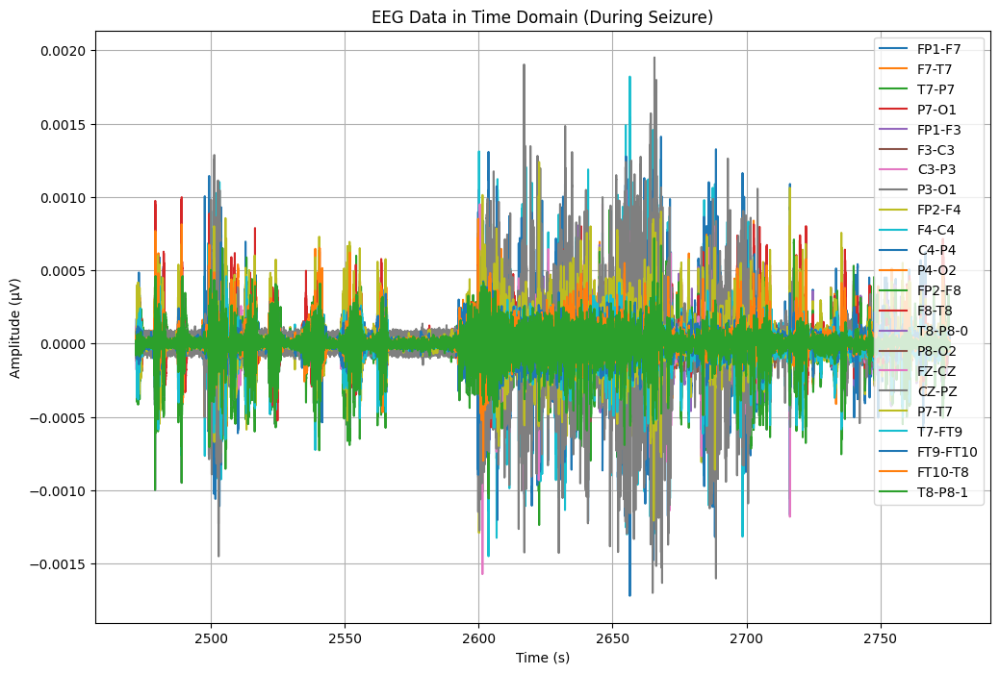

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA27['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA27.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA27[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


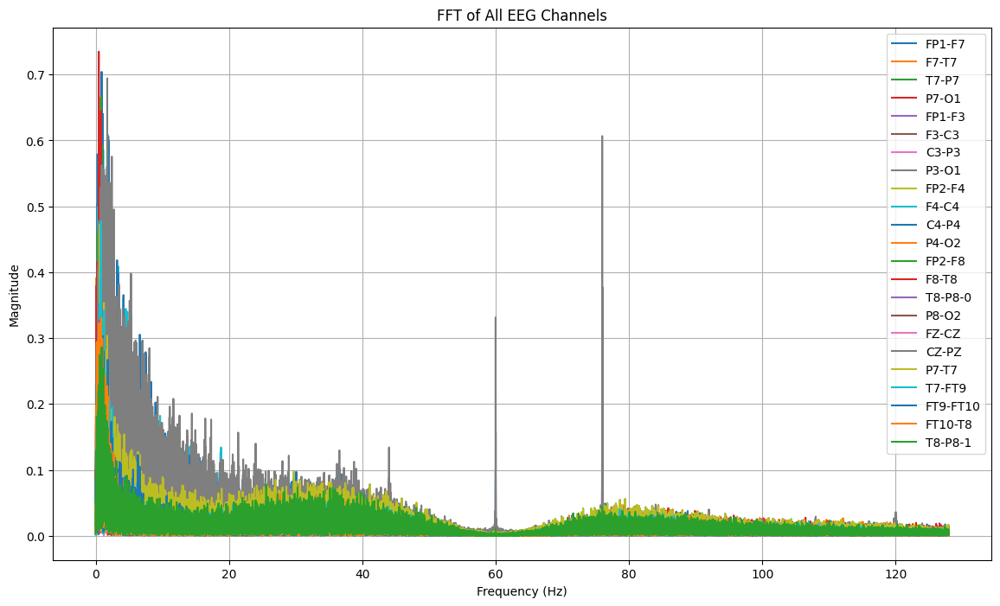

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA27[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2592:
        return "tidak kejang"
    elif 2592 <= row['Time'] < 2656:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_27 = TA27.copy()
TA_27['seizure'] = TA_27.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_27[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  2472.000000  tidak kejang  0.000019 -0.000022 -0.000004 -0.000002   
1  2472.003906  tidak kejang  0.000004 -0.000010  0.000002 -0.000008   
2  2472.007812  tidak kejang  0.000002 -0.000007 -0.000001 -0.000003   
3  2472.011719  tidak kejang -0.000005  0.000003 -0.000003 -0.000004   
4  2472.015625  tidak kejang -0.000005  0.000013  0.000003 -0.000012   

         FP1-F3     F3-C3     C3-P3         P3-O1  ...         F8-T8  \
0  3.711844e-06 -0.000010 -0.000005  2.148962e-06  ... -4.493284e-06   
1  1.953602e-07 -0.000005 -0.000003 -2.148962e-06  ...  1.758242e-06   
2 -2.930403e-06 -0.000003 -0.000003  5.860806e-07  ... -4.884005e-06   
3 -3.711844e-06 -0.000002 -0.000002  1.953602e-07  ... -1.953602e-07   
4  9.768010e-07  0.000003  0.000002 -6.446886e-06  ...  5.177045e-05   

    T8-P8-0     P8-O2         FZ-CZ     CZ-PZ     P7-T7        T7-FT9  \
0 -0.000021  0.000022 -7.619048e-06 -0.000012  0.000004  5.86

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_27['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,16384


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_27)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 304.0 detik


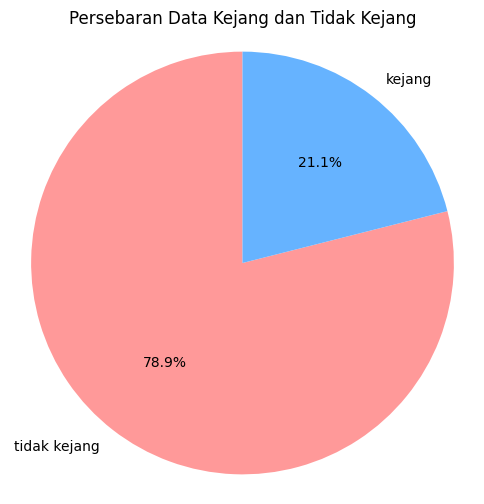

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_27['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_27.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_35.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_27.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_27['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.88      0.92      3377
tidak kejang       0.97      0.99      0.98     12188

    accuracy                           0.96     15565
   macro avg       0.96      0.93      0.95     15565
weighted avg       0.96      0.96      0.96     15565

Akurasi: 0.9648570510761324
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.88      0.92      3377
tidak kejang       0.97      0.99      0.98     12188

    accuracy                           0.96     15565
   macro avg       0.96      0.93      0.95     15565
weighted avg       0.96      0.96      0.96     15565



# DATA 28 (chb03_36)

In [ ]:
# mengimport file edf
file28 = "/content/drive/MyDrive/TA/EDF/chb03_36.edf"
data28 = mne.io.read_raw_edf(file28) # membaca file edf dan menyimpannya di data
data28


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb03_36.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-439-7af6d2db691a>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data28 = mne.io.read_raw_edf(file28) # membaca file edf dan menyimpannya di data


<RawEDF | chb03_36.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data28.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data28.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data28.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df28 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df28['Time'] = times  # Menambahkan kolom waktu
df28.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.738706e-05,-8.068376e-05,1.248352e-04,3.223443e-05,-9.181929e-06,9.553114e-05,-5.880342e-05,3.145299e-05,6.192918e-05,9.084249e-05,...,1.582418e-05,-1.035409e-05,4.551893e-05,1.467155e-04,-1.244444e-04,8.341880e-05,-1.973138e-05,6.427350e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,...,1.953602e-07,1.953602e-07,1.367521e-06,7.228327e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.930403e-06,...,1.953602e-07,1.953602e-07,-2.539683e-06,-8.791209e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df28.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df28.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.727403e-07,2.256911e-07,1.518048e-07,2.239579e-07,2.345815e-07,2.011031e-07,2.294779e-07,2.238727e-07,2.205582e-07,2.057468e-07,...,2.049298e-07,1.947175e-07,1.820746e-07,1.934570e-07,2.389156e-07,1.524903e-07,1.813640e-07,2.152930e-07,2.049298e-07,1799.998047
std,5.338790e-05,5.107524e-05,4.682578e-05,4.505983e-05,4.308981e-05,3.342880e-05,3.297056e-05,3.865227e-05,5.026193e-05,8.040608e-05,...,3.580196e-05,2.974376e-05,4.850510e-05,9.196463e-05,4.682578e-05,4.086165e-05,4.264270e-05,3.600288e-05,3.580196e-05,1039.231048
min,-8.121123e-04,-1.062173e-03,-7.656166e-04,-9.625397e-04,-8.175824e-04,-8.437607e-04,-1.119609e-03,-7.585836e-04,-1.168840e-03,-1.502515e-03,...,-8.937729e-04,-1.053968e-03,-1.488059e-03,-1.736557e-03,-9.703541e-04,-7.488156e-04,-7.804640e-04,-5.776801e-04,-8.937729e-04,0.000000
25%,-1.816850e-05,-1.934066e-05,-1.387057e-05,-1.426129e-05,-1.269841e-05,-1.113553e-05,-8.400488e-06,-9.181929e-06,-1.582418e-05,-1.816850e-05,...,-1.230769e-05,-1.035409e-05,-1.543346e-05,-4.043956e-05,-1.582418e-05,-9.181929e-06,-1.582418e-05,-9.181929e-06,-1.230769e-05,899.999023
50%,-9.768010e-07,-1.953602e-07,5.860806e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1799.998047
75%,1.660562e-05,1.855922e-05,1.621490e-05,1.387057e-05,1.152625e-05,1.152625e-05,8.400488e-06,9.572650e-06,1.504274e-05,1.816850e-05,...,1.269841e-05,1.074481e-05,1.543346e-05,4.043956e-05,1.426129e-05,1.074481e-05,1.621490e-05,8.791209e-06,1.269841e-05,2699.997070
max,1.007473e-03,7.804640e-04,9.707448e-04,9.984860e-04,8.468864e-04,7.417827e-04,1.122344e-03,1.227448e-03,1.103199e-03,1.852210e-03,...,1.161416e-03,1.064518e-03,1.593162e-03,1.960440e-03,7.660073e-04,8.328205e-04,8.367277e-04,8.429792e-04,1.161416e-03,3599.996094


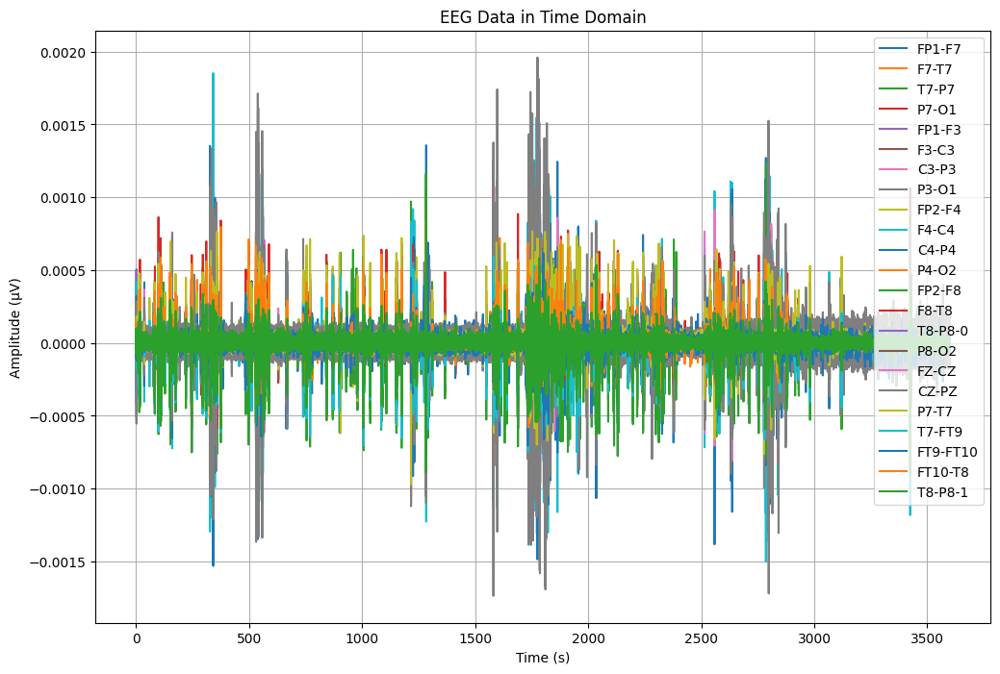

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df28['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df28[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


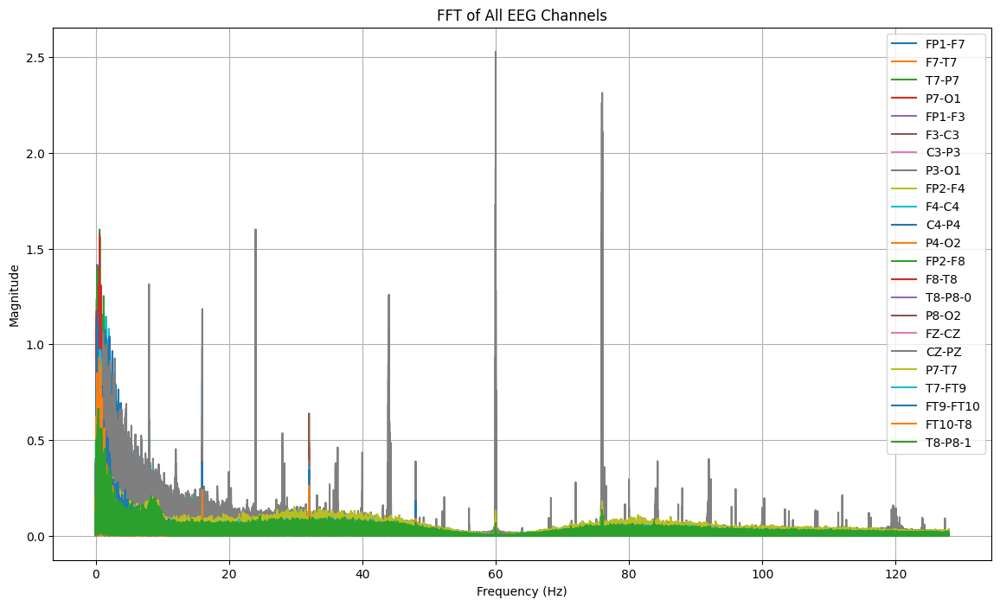

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df28[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv"
df28.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv


In [ ]:
#Import Data CSV
dataTA28 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb03_36.csv")
dataTA28


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-1.738706e-05,-8.068376e-05,1.248352e-04,3.223443e-05,-9.181929e-06,9.553114e-05,-5.880342e-05,3.145299e-05,6.192918e-05,9.084249e-05,...,1.582418e-05,-1.035409e-05,4.551893e-05,1.467155e-04,-1.244444e-04,8.341880e-05,-1.973138e-05,6.427350e-05,1.582418e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,5.860806e-07,2.148962e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,2.539683e-06,...,1.953602e-07,1.953602e-07,1.367521e-06,7.228327e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.011719
4,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-2.930403e-06,...,1.953602e-07,1.953602e-07,-2.539683e-06,-8.791209e-06,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.367521e-06,1.953602e-07,2.539683e-06,-1.953602e-07,-1.113553e-05,-8.791209e-06,1.347985e-05,7.228327e-06,-5.665446e-06,-1.973138e-05,...,5.860806e-07,-2.930403e-06,-2.324786e-05,2.207570e-05,-2.148962e-06,4.884005e-06,-7.228327e-06,2.930403e-06,5.860806e-07,3599.980469
921596,5.274725e-06,2.930403e-06,-9.768010e-07,-6.837607e-06,-4.884005e-06,-6.056166e-06,1.660562e-05,-2.930403e-06,-3.321123e-06,-2.246642e-05,...,-1.953602e-07,-8.791209e-06,-2.148962e-06,-1.973138e-05,1.367521e-06,4.493284e-06,-6.056166e-06,2.930403e-06,-1.953602e-07,3599.984375
921597,1.367521e-06,-4.884005e-06,-6.446886e-06,7.228327e-06,-6.446886e-06,-1.347985e-05,1.035409e-05,7.228327e-06,-8.400488e-06,1.953602e-07,...,2.930403e-06,-5.860806e-07,5.860806e-07,-5.137973e-05,6.837607e-06,5.665446e-06,-1.230769e-05,3.321123e-06,2.930403e-06,3599.988281
921598,1.367521e-06,-1.035409e-05,-1.621490e-05,1.816850e-05,-8.400488e-06,-1.660562e-05,4.493284e-06,1.387057e-05,-1.582418e-05,-3.887668e-05,...,1.953602e-07,8.009768e-06,-4.903541e-05,-8.537241e-05,1.660562e-05,4.102564e-06,-1.152625e-05,2.930403e-06,1.953602e-07,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA28[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA28[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA28[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data28, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: CZ-PZ, Max Frequency: 60.01 Hz, Magnitude: 2.528758, Time: 1775.808594 s
Channel: FP2-F8, Max Frequency: 0.58 Hz, Magnitude: 1.600398, Time: 2786.988281 s
Channel: F8-T8, Max Frequency: 0.58 Hz, Magnitude: 1.577474, Time: 1689.257812 s
Channel: FP1-F7, Max Frequency: 0.22 Hz, Magnitude: 1.415741, Time: 1804.628906 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 1.369207, Time: 1216.097656 s
Channel: FP2-F4, Max Frequency: 0.18 Hz, Magnitude: 1.231380, Time: 2786.695312 s
Channel: C4-P4, Max Frequency: 0.60 Hz, Magnitude: 1.187349, Time: 341.144531 s
Channel: F4-C4, Max Frequency: 0.71 Hz, Magnitude: 1.180021, Time: 341.144531 s
Channel: FT9-FT10, Max Frequency: 0.33 Hz, Magnitude: 1.165196, Time: 1283.558594 s
Channel: FZ-CZ, Max Frequency: 75.98 Hz, Magnitude: 1.004468, Time: 538.625000 s
Channel: T7-FT9, Max Frequency: 0.65 Hz, Magnitude: 0.971777, Time: 1216.093750 s
Channel: FT10-T8, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: F4-C4, Max Frequency: 0.71 Hz, Magnitude: 1.180021, Time: 341.144531 s
Channel: C4-P4, Max Frequency: 0.60 Hz, Magnitude: 1.187349, Time: 341.144531 s
Channel: FZ-CZ, Max Frequency: 75.98 Hz, Magnitude: 1.004468, Time: 538.625000 s
Channel: C3-P3, Max Frequency: 0.54 Hz, Magnitude: 0.666246, Time: 540.152344 s
Channel: T7-FT9, Max Frequency: 0.65 Hz, Magnitude: 0.971777, Time: 1216.093750 s
Channel: F7-T7, Max Frequency: 0.31 Hz, Magnitude: 1.369207, Time: 1216.097656 s
Channel: T7-P7, Max Frequency: 0.78 Hz, Magnitude: 0.878311, Time: 1216.097656 s
Channel: P7-T7, Max Frequency: 0.78 Hz, Magnitude: 0.878311, Time: 1216.097656 s
Channel: FT10-T8, Max Frequency: 0.54 Hz, Magnitude: 0.932931, Time: 1281.964844 s
Channel: T8-P8-0, Max Frequency: 0.40 Hz, Magnitude: 0.663232, Time: 1282.960938 s
Channel: T8-P8-1, Max Frequency: 0.40 Hz, Magnitude: 0.663232, Time: 1282.96093

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1605   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 1898    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut28 = dataTA28.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut28.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_36.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA28 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb03_36.csv")
TA28.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000071,-0.000062,-0.000096,0.000051,-0.000110,0.000028,-0.000045,-0.000049,-0.000034,-0.000077,...,-0.000026,-1.387057e-05,0.000011,-0.000006,0.000096,-0.000057,0.000117,-0.000038,-0.000026,1605.000000
1,0.000003,-0.000262,0.000133,0.000019,-0.000104,0.000097,-0.000050,-0.000047,-0.000013,-0.000051,...,-0.000045,2.637363e-05,0.000013,-0.000057,-0.000133,0.000041,0.000129,-0.000001,-0.000045,1605.003906
2,0.000028,-0.000185,0.000042,0.000027,-0.000081,0.000077,-0.000035,-0.000047,-0.000009,-0.000048,...,-0.000060,1.777778e-05,0.000021,-0.000033,-0.000041,-0.000003,0.000137,-0.000009,-0.000060,1605.007812
3,-0.000042,-0.000117,0.000026,0.000043,-0.000055,0.000087,-0.000072,-0.000049,-0.000010,-0.000037,...,-0.000055,1.855922e-05,0.000037,0.000035,-0.000026,-0.000005,0.000137,-0.000016,-0.000055,1605.011719
4,-0.000088,-0.000055,0.000065,-0.000015,-0.000023,0.000066,-0.000047,-0.000087,-0.000010,-0.000027,...,-0.000055,1.953602e-07,0.000015,-0.000056,-0.000065,-0.000014,0.000129,-0.000013,-0.000055,1605.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA28.shape

(75008, 24)

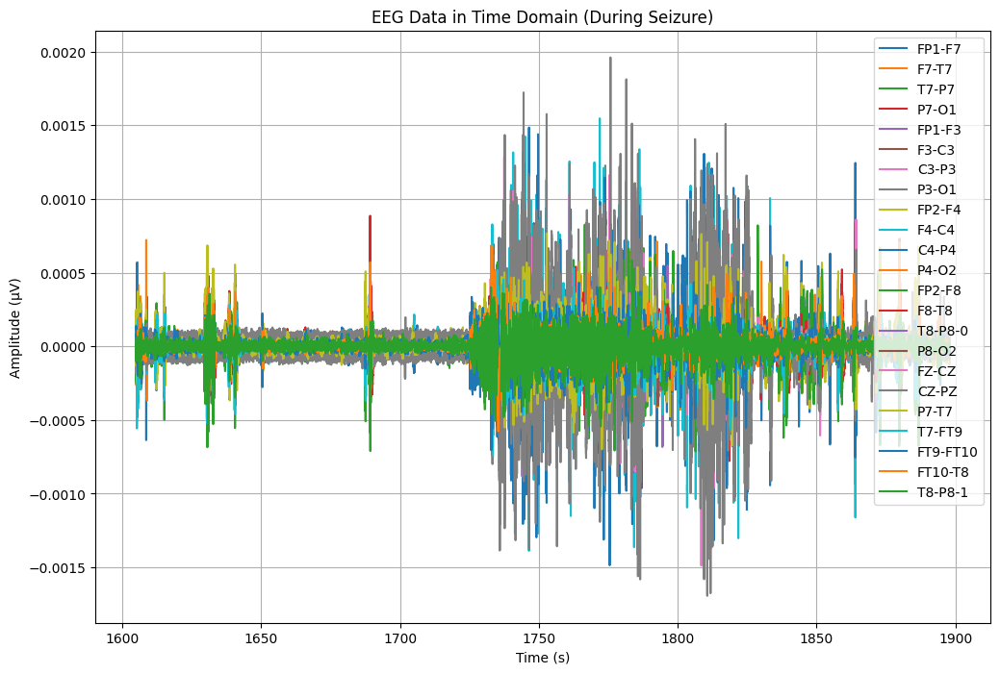

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA28['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA28.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA28[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


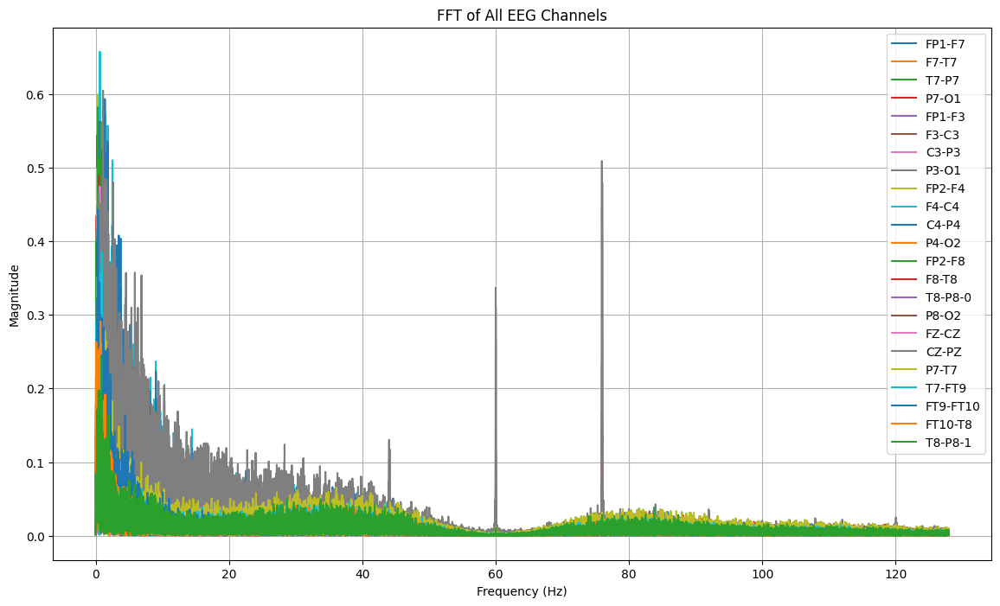

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA28[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 1725:
        return "tidak kejang"
    elif 1725 <= row['Time'] < 1778:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_28 = TA28.copy()
TA_28['seizure'] = TA_28.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_28[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1605.000000  tidak kejang -0.000071 -0.000062 -0.000096  0.000051   
1  1605.003906  tidak kejang  0.000003 -0.000262  0.000133  0.000019   
2  1605.007812  tidak kejang  0.000028 -0.000185  0.000042  0.000027   
3  1605.011719  tidak kejang -0.000042 -0.000117  0.000026  0.000043   
4  1605.015625  tidak kejang -0.000088 -0.000055  0.000065 -0.000015   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0  \
0 -0.000110  0.000028 -0.000045 -0.000049  ... -0.000024 -0.000026   
1 -0.000104  0.000097 -0.000050 -0.000047  ...  0.000002 -0.000045   
2 -0.000081  0.000077 -0.000035 -0.000047  ...  0.000007 -0.000060   
3 -0.000055  0.000087 -0.000072 -0.000049  ... -0.000017 -0.000055   
4 -0.000023  0.000066 -0.000047 -0.000087  ... -0.000008 -0.000055   

          P8-O2     FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8  \
0 -1.387057e-05  0.000011 -0.000006  0.000096 -0.000057  0.000117 -

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_28['seizure'].value_counts()


,count
seizure,
tidak kejang,61440
kejang,13568


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_28)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 293.0 detik


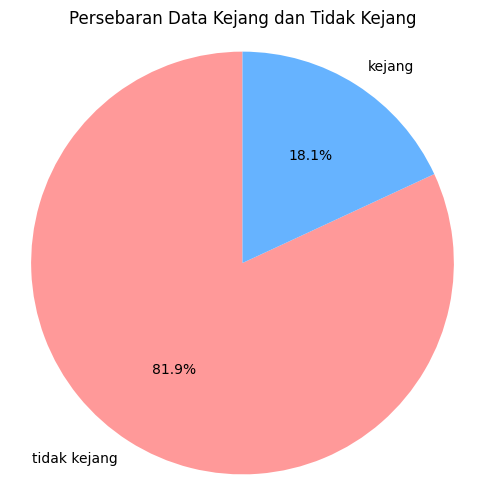

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_28['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_28.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb03_36.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_28.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_28['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.96      0.90      0.93      2804
tidak kejang       0.98      0.99      0.98     12198

    accuracy                           0.98     15002
   macro avg       0.97      0.95      0.96     15002
weighted avg       0.98      0.98      0.98     15002

Akurasi: 0.975403279562725
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.96      0.90      0.93      2804
tidak kejang       0.98      0.99      0.98     12198

    accuracy                           0.98     15002
   macro avg       0.97      0.95      0.96     15002
weighted avg       0.98      0.98      0.98     15002



# DATA 29 (chb08_21)

In [ ]:
# mengimport file edf
file29 = "/content/drive/MyDrive/TA/EDF/chb08_21.edf"
data29 = mne.io.read_raw_edf(file29) # membaca file edf dan menyimpannya di data
data29


Extracting EDF parameters from /content/drive/MyDrive/TA/EDF/chb08_21.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-463-2d1375caa9a4>:3: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  data29 = mne.io.read_raw_edf(file29) # membaca file edf dan menyimpannya di data


<RawEDF | chb08_21.edf, 23 x 921600 (3600.0 s), ~27 kB, data not loaded>

In [ ]:
# Mendapatkan data dan informasi dari file EDF
data, times = data29.get_data(return_times=True)  # Mengambil data EEG dan waktu
channel_names = data29.ch_names  # Mendapatkan nama Channel


In [ ]:
# melihat channel pada data
channels = data29.ch_names #mengembalikan daftar nama-nama kanal (channel) yang ada dalam dataset EEG.
channels

['FP1-F7',
 'F7-T7',
 'T7-P7',
 'P7-O1',
 'FP1-F3',
 'F3-C3',
 'C3-P3',
 'P3-O1',
 'FP2-F4',
 'F4-C4',
 'C4-P4',
 'P4-O2',
 'FP2-F8',
 'F8-T8',
 'T8-P8-0',
 'P8-O2',
 'FZ-CZ',
 'CZ-PZ',
 'P7-T7',
 'T7-FT9',
 'FT9-FT10',
 'FT10-T8',
 'T8-P8-1']

In [ ]:
# Membuat DataFrame dengan data EEG dan waktu
df29 = pd.DataFrame(data.T, columns=channel_names)  # Transpose data sehingga sesuai dengan format DataFrame
df29['Time'] = times  # Menambahkan kolom waktu
df29.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.123321e-04,-8.459096e-05,6.857143e-05,-7.208791e-05,5.841270e-05,-2.090354e-05,2.832723e-05,-4.161172e-05,1.426129e-05,8.732601e-05,...,-6.231990e-05,1.467155e-04,-1.152625e-05,6.896215e-05,-6.818071e-05,4.395604e-05,-2.654945e-04,2.147009e-04,-6.231990e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.367521e-06,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-1.758242e-06,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.758242e-06,0.015625


In [ ]:
# melihat bentuk data kita (kolom, baris)
print(df29.shape)

(921600, 24)


In [ ]:
# mendeskripsikan data
df29.describe()

,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
count,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,...,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,9.216000e+05,921600.000000
mean,2.364732e-07,2.566947e-07,1.428970e-07,2.238888e-07,2.248486e-07,1.870370e-07,2.012032e-07,1.970420e-07,2.422030e-07,1.845145e-07,...,1.653244e-07,2.038008e-07,1.876297e-07,1.805280e-07,2.478234e-07,1.080535e-07,1.728722e-07,2.563077e-07,1.653244e-07,1799.998047
std,1.053965e-04,7.904019e-05,8.693799e-05,8.174784e-05,1.071778e-04,6.266178e-05,5.618378e-05,7.090911e-05,9.232203e-05,5.474596e-05,...,7.918807e-05,7.702430e-05,5.156143e-05,5.180599e-05,8.693799e-05,6.313818e-05,8.575314e-05,5.188747e-05,7.918807e-05,1039.231048
min,-1.504078e-03,-1.232137e-03,-8.695482e-04,-1.044591e-03,-1.495092e-03,-1.037167e-03,-8.965079e-04,-1.086789e-03,-8.429792e-04,-6.386325e-04,...,-7.722589e-04,-9.797314e-04,-1.205568e-03,-9.949695e-04,-9.187790e-04,-1.121563e-03,-8.738462e-04,-6.816117e-04,-7.722589e-04,0.000000
25%,-3.418803e-05,-4.200244e-05,-4.981685e-05,-4.278388e-05,-4.122100e-05,-3.262515e-05,-2.754579e-05,-3.653236e-05,-3.262515e-05,-2.363858e-05,...,-4.043956e-05,-4.004884e-05,-2.363858e-05,-2.559219e-05,-5.137973e-05,-3.106227e-05,-3.028083e-05,-2.559219e-05,-4.043956e-05,899.999023
50%,-9.768010e-07,-9.768010e-07,1.367521e-06,1.953602e-07,-9.768010e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.953602e-07,...,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,-9.768010e-07,1.758242e-06,9.768010e-07,-5.860806e-07,5.860806e-07,1799.998047
75%,2.910867e-05,4.043956e-05,5.177045e-05,4.356532e-05,3.575092e-05,3.340659e-05,2.754579e-05,3.731380e-05,2.754579e-05,2.442002e-05,...,4.161172e-05,4.004884e-05,2.402930e-05,2.598291e-05,5.020757e-05,3.418803e-05,3.223443e-05,2.481074e-05,4.161172e-05,2699.997070
max,1.165714e-03,1.138364e-03,9.191697e-04,8.910379e-04,1.147741e-03,7.722589e-04,9.922344e-04,9.301099e-04,1.191111e-03,7.070085e-04,...,7.871062e-04,9.672283e-04,1.450159e-03,6.124542e-04,8.699389e-04,1.152039e-03,8.152381e-04,8.085958e-04,7.871062e-04,3599.996094


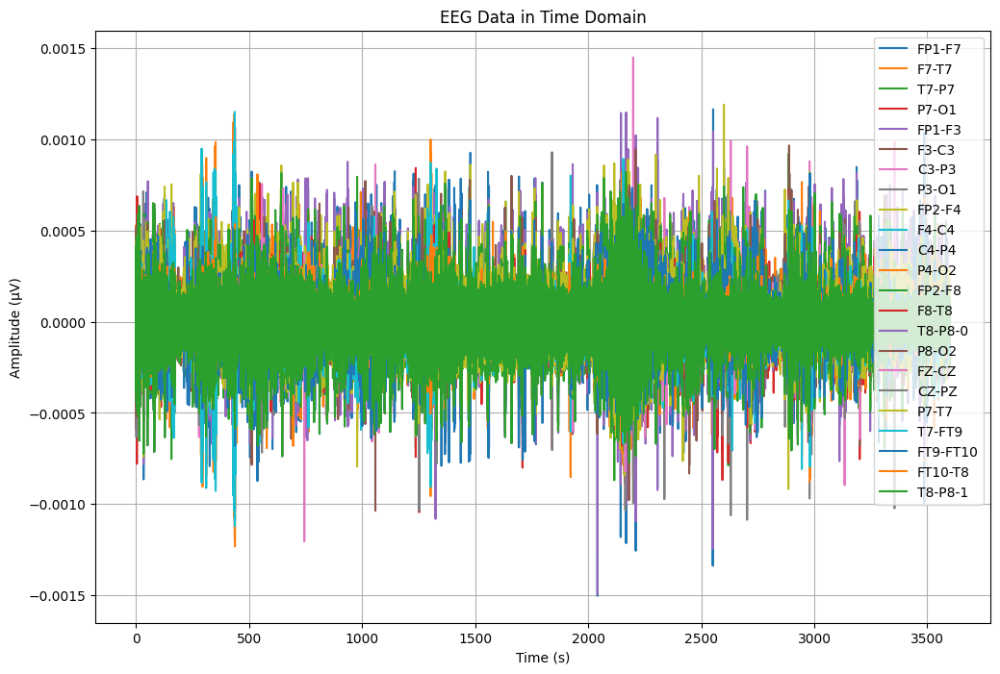

In [ ]:
# Time Domain
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']  # Anda bisa memilih saluran lainnya
time = df29['Time']  # Kolom waktu

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran
for channel in channels:
    plt.plot(time, df29[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


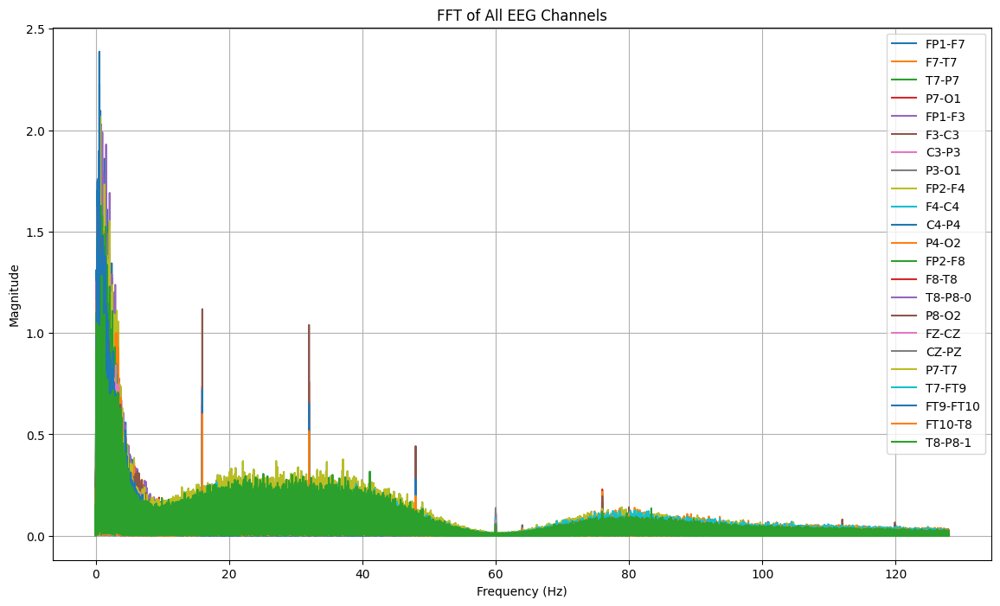

In [ ]:
# Domain Frekuensi
# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = df29[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# Menyimpan ke file CSV
csv_file = "/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv"
df29.to_csv(csv_file, index=False)

print(f"Data berhasil disimpan dalam file CSV: {csv_file}")


Data berhasil disimpan dalam file CSV: /content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv


In [ ]:
#Import Data CSV
dataTA29 = pd.read_csv("/content/drive/MyDrive/TA/EKSTRAK CSV/ekstrak_chb08_21.csv")
dataTA29


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,1.123321e-04,-8.459096e-05,6.857143e-05,-7.208791e-05,5.841270e-05,-2.090354e-05,2.832723e-05,-4.161172e-05,1.426129e-05,8.732601e-05,...,-6.231990e-05,1.467155e-04,-1.152625e-05,6.896215e-05,-6.818071e-05,4.395604e-05,-2.654945e-04,2.147009e-04,-6.231990e-05,0.000000
1,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.003906
2,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,1.953602e-07,0.007812
3,-1.953602e-07,-5.860806e-07,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,5.860806e-07,1.953602e-07,1.953602e-07,5.860806e-07,...,1.953602e-07,1.953602e-07,1.953602e-07,-1.953602e-07,-1.367521e-06,1.758242e-06,1.953602e-07,-1.953602e-07,1.953602e-07,0.011719
4,5.860806e-07,9.768010e-07,-1.953602e-07,-1.953602e-07,1.953602e-07,1.953602e-07,-5.860806e-07,5.860806e-07,1.953602e-07,1.953602e-07,...,-1.758242e-06,1.953602e-07,1.953602e-07,1.953602e-07,5.860806e-07,-1.367521e-06,1.953602e-07,2.148962e-06,-1.758242e-06,0.015625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921595,-1.699634e-05,2.520147e-05,-6.466422e-05,1.230769e-05,-8.302808e-05,5.802198e-05,2.539683e-06,-2.324786e-05,-1.347985e-05,4.903541e-05,...,-6.114774e-05,-2.402930e-05,2.324786e-05,-6.837607e-06,6.505495e-05,-5.372405e-05,3.770452e-05,6.935287e-05,-6.114774e-05,3599.980469
921596,-1.738706e-05,-2.871795e-05,-3.418803e-05,3.223443e-05,-8.302808e-05,5.997558e-05,5.274725e-06,-3.223443e-05,-1.894994e-05,5.411477e-05,...,-2.168498e-05,-2.715507e-05,2.598291e-05,-9.963370e-06,3.457875e-05,1.758242e-06,3.770452e-05,2.520147e-05,-2.168498e-05,3599.984375
921597,-5.860806e-07,-9.787546e-05,6.837607e-06,5.684982e-05,-6.388278e-05,5.724054e-05,-4.102564e-06,-2.442002e-05,-3.457875e-05,5.059829e-05,...,-2.148962e-06,-1.035409e-05,1.934066e-05,-9.963370e-06,-6.446886e-06,6.935287e-05,3.184371e-05,-5.274725e-06,-2.148962e-06,3599.988281
921598,5.528694e-05,-7.013431e-05,9.045177e-05,-5.450549e-05,4.200244e-05,8.009768e-06,-7.619048e-06,-2.207570e-05,-4.473748e-05,5.137973e-05,...,1.269841e-05,-1.465201e-05,1.816850e-05,-7.228327e-06,-9.006105e-05,4.903541e-05,2.559219e-05,-2.285714e-05,1.269841e-05,3599.992188


In [ ]:
# Frekuensi MAX & Magnitude
# Fungsi untuk mendapatkan frekuensi terbesar dari FFT
def get_max_frequency(signal, sampling_rate):
    N = len(signal)
    T = 1.0 / sampling_rate
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(N, T)
    fft_vals = np.abs(fft_vals[:N // 2])
    fft_freqs = fft_freqs[:N // 2]

    max_freq_index = np.argmax(fft_vals)
    return fft_freqs[max_freq_index], fft_vals[max_freq_index]

# Fungsi untuk mendeteksi waktu ketika magnitudo maksimum terjadi
def get_time_of_max_magnitude(channel, max_magnitude, data, time_column):
    # Cari baris di mana magnitudo terbesar muncul di data asli
    channel_signal = dataTA29[channel].values
    max_index = np.argmax(np.abs(channel_signal))  # Index dengan nilai maksimum
    time_of_max = dataTA29[time_column].iloc[max_index]  # Waktu saat magnitudo maksimum
    return time_of_max

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih saluran EEG yang akan dianalisis
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat dictionary untuk menyimpan hasil
max_frequencies = {}

# Loop untuk menghitung frekuensi terbesar dan waktu magnitudo terbesar untuk setiap saluran
for channel in channels:
    signal = dataTA29[channel].values  # Ambil sinyal dari setiap saluran EEG
    max_freq, max_magnitude = get_max_frequency(signal, sampling_rate)  # Dapatkan frekuensi dan magnitudo terbesar

    # Mendapatkan waktu ketika magnitudo terbesar terjadi
    time_of_max = get_time_of_max_magnitude(channel, max_magnitude, data29, 'Time')

    # Menyimpan hasil ke dictionary
    max_frequencies[channel] = {
        'Max Frequency (Hz)': max_freq,
        'Max Magnitude': max_magnitude,
        'Time of Max Magnitude (s)': time_of_max
    }

# Menampilkan hasil saluran dengan frekuensi terbesar dan waktu magnitudo maksimum
sorted_max_freq = sorted(max_frequencies.items(), key=lambda x: x[1]['Max Magnitude'], reverse=True)

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:")
for channel, info in sorted_max_freq:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum:
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062 s
Channel: FP2-F4, Max Frequency: 0.71 Hz, Magnitude: 2.067120, Time: 2600.257812 s
Channel: FP1-F3, Max Frequency: 0.81 Hz, Magnitude: 2.019904, Time: 2041.539062 s
Channel: P3-O1, Max Frequency: 0.83 Hz, Magnitude: 1.638892, Time: 2702.996094 s
Channel: FP2-F8, Max Frequency: 0.84 Hz, Magnitude: 1.627379, Time: 2167.023438 s
Channel: P4-O2, Max Frequency: 0.30 Hz, Magnitude: 1.600402, Time: 2979.292969 s
Channel: P8-O2, Max Frequency: 0.83 Hz, Magnitude: 1.474255, Time: 2180.042969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Fr

In [ ]:
# Urutan Time
# Mengurutkan hasil berdasarkan waktu dari yang tercepat hingga yang terlama
sorted_by_time = sorted(max_frequencies.items(), key=lambda x: x[1]['Time of Max Magnitude (s)'])

# Menampilkan hasil akhir
print("Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):")
for channel, info in sorted_by_time:
    print(f"Channel: {channel}, Max Frequency: {info['Max Frequency (Hz)']:.2f} Hz, "
          f"Magnitude: {info['Max Magnitude']:.6f}, Time: {info['Time of Max Magnitude (s)']:.6f} s")


Saluran EEG dengan frekuensi terbesar dan waktu terjadinya magnitudo maksimum (diurutkan berdasarkan waktu):
Channel: T7-FT9, Max Frequency: 0.47 Hz, Magnitude: 0.891269, Time: 436.414062 s
Channel: F7-T7, Max Frequency: 1.26 Hz, Magnitude: 1.338749, Time: 437.101562 s
Channel: T8-P8-0, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: T8-P8-1, Max Frequency: 0.89 Hz, Magnitude: 1.282767, Time: 511.468750 s
Channel: F8-T8, Max Frequency: 0.51 Hz, Magnitude: 1.206019, Time: 536.609375 s
Channel: FT9-FT10, Max Frequency: 0.55 Hz, Magnitude: 2.387162, Time: 536.652344 s
Channel: FT10-T8, Max Frequency: 0.43 Hz, Magnitude: 0.774595, Time: 536.671875 s
Channel: C4-P4, Max Frequency: 0.80 Hz, Magnitude: 1.194796, Time: 542.144531 s
Channel: F3-C3, Max Frequency: 0.55 Hz, Magnitude: 1.107217, Time: 1058.417969 s
Channel: P7-O1, Max Frequency: 0.48 Hz, Magnitude: 1.433452, Time: 1252.289062 s
Channel: FP1-F7, Max Frequency: 0.57 Hz, Magnitude: 2.226245, Time: 2041.539062

In [ ]:
# potong data (potong dulu datanya)
# Menentukan sample rate (misalkan 256 Hz)
sample_rate = 256  # Sesuaikan dengan sample rate data kamu

# Konversi waktu ke indeks data (dalam sampel)
start_time_seconds = 1963   # Waktu mulai (15:05:00) dalam detik dari 14:43:12
end_time_seconds = 2467    # Waktu akhir (15:10:00) dalam detik dari 14:43:12

start_index = int(start_time_seconds * sample_rate)
end_index = int(end_time_seconds * sample_rate)

# Potong data berdasarkan rentang waktu
df_cut29 = dataTA29.iloc[start_index:end_index]


In [ ]:
# Simpan data yang sudah dipotong
df_cut29.to_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv", index=False)


In [ ]:
# import data yang sudah dipotong
TA29 = pd.read_csv("/content/drive/MyDrive/TA/CSV CUT DATA TA/datacutTA_chb08_21.csv")
TA29.head()


,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,F4-C4,...,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,Time
0,-0.000049,-0.000045,-0.000031,-0.000015,-0.000134,0.000051,-0.000032,-0.000027,-0.000003,0.000010,...,0.000017,-0.000063,0.000053,-0.000035,0.000032,0.000035,-0.000020,-0.000051,0.000017,1963.000000
1,-0.000060,-0.000067,0.000007,-0.000031,-0.000132,0.000048,-0.000036,-0.000032,0.000004,0.000021,...,-0.000006,-0.000074,0.000066,-0.000049,-0.000006,0.000064,-0.000022,-0.000015,-0.000006,1963.003906
2,-0.000057,-0.000048,-0.000003,-0.000042,-0.000105,0.000027,-0.000031,-0.000042,0.000008,0.000029,...,-0.000004,-0.000075,0.000070,-0.000061,0.000003,0.000047,-0.000017,-0.000017,-0.000004,1963.007812
3,-0.000039,-0.000055,-0.000015,-0.000023,-0.000065,0.000004,-0.000043,-0.000028,0.000012,0.000030,...,-0.000025,-0.000071,0.000070,-0.000064,0.000015,0.000053,-0.000018,-0.000004,-0.000025,1963.011719
4,-0.000042,-0.000096,0.000011,-0.000009,-0.000074,0.000012,-0.000053,-0.000021,0.000023,0.000033,...,-0.000055,-0.000074,0.000072,-0.000069,-0.000011,0.000097,-0.000029,0.000044,-0.000055,1963.015625


In [ ]:
# melihat ukuran file yang sudah dipotong
TA29.shape

(129024, 24)

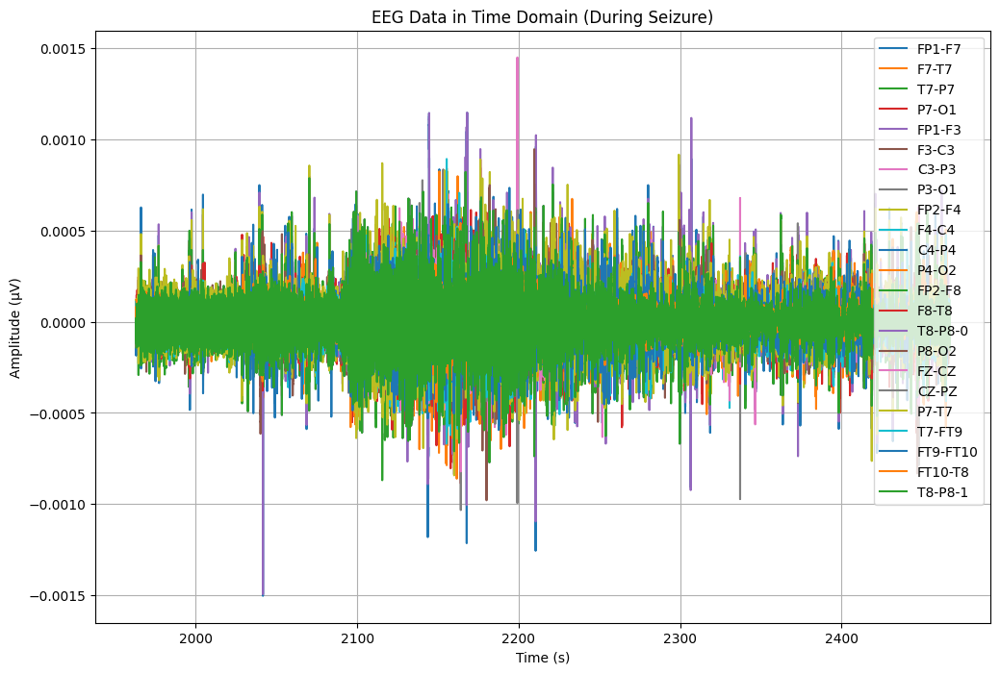

In [ ]:
# menampilkan data yang sudah dipotong dalam domain time
# Menentukan saluran EEG yang akan ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Mengambil data waktu dari kolom 'Time'
time = TA29['Time']

# Membuat plot
plt.figure(figsize=(12, 8))

# Looping untuk menampilkan masing-masing saluran EEG yang dipilih
for channel in channels:
    if channel in TA29.columns:  # Memastikan saluran ada dalam data
        plt.plot(time, TA29[channel], label=channel)

# Menambahkan judul dan label
plt.title('EEG Data in Time Domain (During Seizure)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude (µV)')
plt.legend(loc='upper right')

# Menampilkan grid dan plot
plt.grid(True)
plt.show()


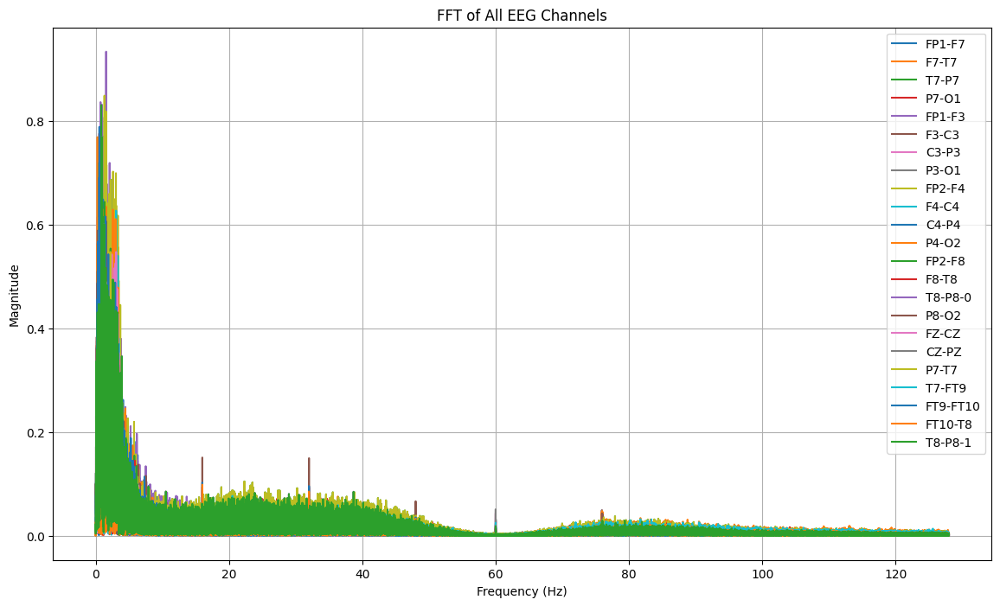

In [ ]:
# menampilkan data yang sudah dipotong dalam domain frekuensi

# Fungsi untuk melakukan FFT dan mengembalikan frekuensi serta magnitude
def compute_fft(signal, sampling_rate):
    N = len(signal)  # Panjang sinyal
    T = 1.0 / sampling_rate  # Interval sampling
    fft_vals = np.fft.fft(signal)  # Menghitung FFT
    fft_freqs = np.fft.fftfreq(N, T)  # Frekuensi
    fft_vals = np.abs(fft_vals[:N // 2])  # Magnitude (frekuensi positif saja)
    fft_freqs = fft_freqs[:N // 2]  # Frekuensi positif saja
    return fft_freqs, fft_vals

# Sampling rate
sampling_rate = 256  # Misal 256 Hz

# Pilih beberapa atau semua saluran EEG untuk ditampilkan
channels = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1',
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2',
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

# Membuat plot untuk semua saluran EEG dalam satu gambar
plt.figure(figsize=(14, 8))

for channel in channels:
    signal = TA29[channel].values  # Mengambil sinyal dari saluran EEG
    fft_freqs, fft_vals = compute_fft(signal, sampling_rate)  # Menghitung FFT
    plt.plot(fft_freqs, fft_vals, label=channel)  # Menambahkan ke plot

# Memberikan judul dan label pada plot
plt.title('FFT of All EEG Channels')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.legend(loc='upper right')  # Menampilkan legenda untuk setiap saluran
plt.grid(True)
plt.show()


In [ ]:
# melabeli data dengan kejang dan tidak kejang
# Fungsi untuk menentukan label kejang atau tidak
def label_seizure(row):
    if row['Time'] < 2083:
        return "tidak kejang"
    elif 2083 <= row['Time'] < 2347:
        return "kejang"
    else:
        return "tidak kejang"

# Menyalin data1 ke df1 dan menambahkan kolom 'seizure' berdasarkan fungsi di atas
TA_29 = TA29.copy()
TA_29['seizure'] = TA_29.apply(label_seizure, axis=1)

# Menampilkan hasil
print(TA_29[['Time', 'seizure', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
           'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
           'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']].head())


          Time       seizure    FP1-F7     F7-T7     T7-P7     P7-O1  \
0  1963.000000  tidak kejang -0.000049 -0.000045 -0.000031 -0.000015   
1  1963.003906  tidak kejang -0.000060 -0.000067  0.000007 -0.000031   
2  1963.007812  tidak kejang -0.000057 -0.000048 -0.000003 -0.000042   
3  1963.011719  tidak kejang -0.000039 -0.000055 -0.000015 -0.000023   
4  1963.015625  tidak kejang -0.000042 -0.000096  0.000011 -0.000009   

     FP1-F3     F3-C3     C3-P3     P3-O1  ...     F8-T8   T8-P8-0     P8-O2  \
0 -0.000134  0.000051 -0.000032 -0.000027  ... -0.000076  0.000017 -0.000063   
1 -0.000132  0.000048 -0.000036 -0.000032  ... -0.000050 -0.000006 -0.000074   
2 -0.000105  0.000027 -0.000031 -0.000042  ... -0.000040 -0.000004 -0.000075   
3 -0.000065  0.000004 -0.000043 -0.000028  ... -0.000035 -0.000025 -0.000071   
4 -0.000074  0.000012 -0.000053 -0.000021  ...  0.000004 -0.000055 -0.000074   

      FZ-CZ     CZ-PZ     P7-T7    T7-FT9  FT9-FT10   FT10-T8   T8-P8-1  
0  0.000053 

In [ ]:
# menghitung jumlah data kejang dan tidak kejang
TA_29['seizure'].value_counts()


,count
seizure,
kejang,67584
tidak kejang,61440


In [ ]:
# menghitung durasi data
# Hitung jumlah sampel
jumlah_sampel = len(TA_29)

# Frekuensi sampling (misal, 256 Hz)
fs = 256  # Sesuaikan dengan frekuensi sampling EEG Anda

# Menghitung durasi waktu total
durasi_total = jumlah_sampel / fs
print(f"Durasi total rekaman EEG: {durasi_total} detik")


Durasi total rekaman EEG: 504.0 detik


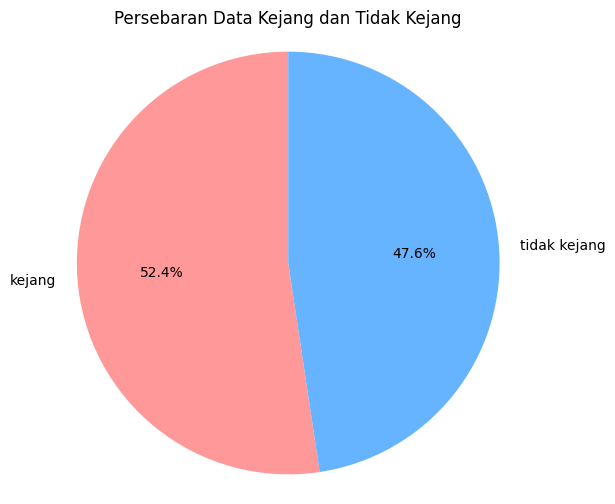

In [ ]:
# membuat plot perseberan data kejang dan tidak kejang
# Menghitung jumlah data untuk setiap kategori (kejang dan tidak kejang)
seizure_counts = TA_29['seizure'].value_counts()

# Membuat pie chart
plt.figure(figsize=(6, 6))
plt.pie(seizure_counts, labels=seizure_counts.index, autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])

# Menambahkan judul
plt.title('Persebaran Data Kejang dan Tidak Kejang')

# Menampilkan pie chart
plt.axis('equal')  # Menjaga chart tetap berbentuk lingkaran
plt.show()


In [ ]:
# Simpan data yang sudah dilabel jadi kejang dan tidak kejang
TA_29.to_csv("/content/drive/MyDrive/TA/SEIZURE/seizure_chb08_21.csv", index=False)


In [ ]:
# mengklasifikasikan menggunakan random forest
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier # Make sure to import RandomForestClassifier
from sklearn.model_selection import train_test_split # Import the function from the correct module

# Menentukan fitur (X) dan label (y)
X = TA_29.drop(['Time', 'seizure'], axis=1)  # Menghapus kolom 'Time' dan 'seizure' dari fitur
y = TA_29['seizure']  # Label target

# Membagi data menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Membuat dan melatih model Random Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Memprediksi label pada data pengujian
y_pred = model.predict(X_test)

# Import the necessary module
from sklearn.metrics import classification_report, accuracy_score
print(classification_report(y_test,y_pred))


# Evaluasi model
print("Akurasi:", accuracy_score(y_test, y_pred))
print("Laporan Klasifikasi:\n", classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805

Akurasi: 0.9568300716915327
Laporan Klasifikasi:
               precision    recall  f1-score   support

      kejang       0.97      0.94      0.96     13709
tidak kejang       0.94      0.97      0.95     12096

    accuracy                           0.96     25805
   macro avg       0.96      0.96      0.96     25805
weighted avg       0.96      0.96      0.96     25805

